In [1]:
!pip install wfdb

In [2]:
#!wget -r -N -c -np https://physionet.org/files/ptb-xl/1.0.3/

In [1]:
PATH = './data/'
SAMPLING_RATE = 100

In [2]:
import pandas as pd
import numpy as np
import wfdb
import ast
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt


In [3]:
def load_raw_data(df, sampling_rate, path):
    if sampling_rate == 100:
        data = [wfdb.rdsamp(path+f) for f in df.filename_lr]
    else:
        data = [wfdb.rdsamp(path+f) for f in df.filename_hr]
    data = np.array([signal for signal, meta in data])
    return data

path = PATH
sampling_rate=SAMPLING_RATE

# load and convert annotation data
Y = pd.read_csv(path+'ptbxl_database.csv', index_col='ecg_id')
Y.scp_codes = Y.scp_codes.apply(lambda x: ast.literal_eval(x))

# Load raw signal data
#X = load_raw_data(Y, sampling_rate, path)

# Load scp_statements.csv for diagnostic aggregation
agg_df = pd.read_csv(path+'scp_statements.csv', index_col=0)
agg_df = agg_df[agg_df.diagnostic == 1]

def aggregate_diagnostic(y_dic):
    tmp = []
    for key in y_dic.keys():
        if key in agg_df.index:
            tmp.append(agg_df.loc[key].diagnostic_class)
    return list(set(tmp))

# Apply diagnostic superclass
Y['diagnostic_superclass'] = Y.scp_codes.apply(aggregate_diagnostic)

# Split data into train and test
#test_fold = 10
# Train
#X_train = X[np.where(Y.strat_fold != test_fold)]
#y_train = Y[(Y.strat_fold != test_fold)].diagnostic_superclass
# Test
#X_test = X[np.where(Y.strat_fold == test_fold)]
#y_test = Y[Y.strat_fold == test_fold].diagnostic_superclass

In [4]:
class PTBDataset(Dataset):

    def __init__(self, df, path, sampling_rate):
        self.df = df
        self.path = path
        self.sampling_rate = sampling_rate
        if sampling_rate == 100:
            self.data = [wfdb.rdsamp(path+f) for f in df.filename_lr]
        else:
            self.data = [wfdb.rdsamp(path+f) for f in df.filename_hr]
        self.data = np.array([signal for signal, meta in self.data])
        #print(self.data[0])
        print(self.data.shape)
        

    def __getitem__(self, idx):
        signal = torch.FloatTensor(np.transpose(self.data[idx]))[0:1, :].clone()         
        #signal = torch.FloatTensor(np.transpose(self.data[idx]))[:, :].clone()         
        target = torch.LongTensor(1)
        return signal, target

    def __len__(self):
        return len(self.df)

In [5]:
dataset = PTBDataset(Y, path, 100)
    

(21799, 1000, 12)


In [6]:
print(len(dataset))
x = dataset[0]


21799


In [7]:
dataloader = DataLoader(dataset=dataset, batch_size=128, num_workers=0)
print(len(dataloader))
x,y = next(iter(dataloader))
x.shape, y.shape

171


(torch.Size([128, 1, 1000]), torch.Size([128, 1]))

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#device = "cpu"

In [9]:

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.fc1 = nn.Linear(1000, 256)
        self.fc2 = nn.Linear(256, 256)
        self.fc3 = nn.Linear(256, 1000)
#         self.rnn_layer = nn.LSTM(
#                 input_size=1000,
#                 hidden_size=128,
#                 num_layers=1,
#                 bidirectional=True,
#                 batch_first=True,
#             )
    def forward(self, x):
        #x,_ = self.rnn_layer(x)
        #x = x.view(-1,256)
        x = F.leaky_relu(self.fc1(x))
        x = F.leaky_relu(self.fc2(x))
        x = F.dropout(x, p=0.2)
        x = self.fc3(x)
        #return x.unsqueeze(1)
        return F.leaky_relu(x)


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
#         self.rnn_layer = nn.LSTM(
#                 input_size=1000,
#                 hidden_size=256,
#                 num_layers=1,
#                 bidirectional=True,
#                 batch_first=True,
#             )
        self.fc1 = nn.Linear(1000, 512)
        self.fc2 = nn.Linear(512, 384) 
        self.fc3 = nn.Linear(384, 1)

    def forward(self, x):
       # x,_ = self.rnn_layer(x)
       # x = x.view(-1, 512)
        x = F.leaky_relu(self.fc1(x))
        x = F.leaky_relu(self.fc2(x))
        x = F.dropout(x, p=0.2)
        x = torch.sigmoid(self.fc3(x))
        return x

In [10]:
# если не взлетит unflatten
import torch.nn as nn

class Reshape(nn.Module):
    def __init__(self, *args):
        super(Reshape, self).__init__()
        self.shape = args

    def forward(self, x):
        return x.view(self.shape)

In [11]:
class ConvGenerator(nn.Module):
    def __init__(self):
        super(ConvGenerator, self).__init__()
        self.model = nn.Sequential(
            
            nn.Linear(1000, 1000, bias=False),
            #nn.BatchNorm1d(num_features=12),
            nn.BatchNorm1d(num_features=1),
            nn.LeakyReLU(inplace=False),
            
            #Reshape([1000, 12]),
            
            #nn.ConvTranspose1d(12, 128, 5, stride=1, bias=False, padding=2),
            nn.ConvTranspose1d(1, 128, 5, stride=1, bias=False, padding=2),
            nn.BatchNorm1d(num_features=128),
            nn.LeakyReLU(inplace=False),

            nn.ConvTranspose1d(128, 64, 5, stride=1, bias=False, padding=2),
            nn.BatchNorm1d(num_features=64),
            nn.LeakyReLU(inplace=False),

            #nn.ConvTranspose1d(64, 12, 5, stride=1, bias=False, padding=2),
            nn.ConvTranspose1d(64, 1, 5, stride=1, bias=False, padding=2),
#64 -> 1
            nn.Tanh(),
            )

    def forward(self, input):
        output = self.model(input)
        return output

In [12]:
# This is an unofficial PyTorch implementation by Ignacio Oguiza - oguiza@gmail.com based on:

# Fawaz, H. I., Lucas, B., Forestier, G., Pelletier, C., Schmidt, D. F., Weber, J., ... & Petitjean, F. (2019). InceptionTime: Finding AlexNet for Time Series Classification. arXiv preprint arXiv:1909.04939.
# Official InceptionTime tensorflow implementation: https://github.com/hfawaz/InceptionTime

import torch
import torch.nn as nn

def noop(x):
    return x

def shortcut(c_in, c_out):
    return nn.Sequential(*[nn.Conv1d(c_in, c_out, kernel_size=1), 
                           nn.BatchNorm1d(c_out)])

class Inception(nn.Module):
    def __init__(self, c_in, bottleneck=32, ks=40, nb_filters=32):

        super().__init__()
        self.bottleneck = nn.Conv1d(c_in, bottleneck, 1) if bottleneck and c_in > 1 else noop
        mts_feat = bottleneck or c_in
        conv_layers = []
        kss = [ks // (2**i) for i in range(3)]
        # ensure odd kss until nn.Conv1d with padding='same' is available in pytorch 1.3
        kss = [ksi if ksi % 2 != 0 else ksi - 1 for ksi in kss]  
        for i in range(len(kss)):
            conv_layers.append(
                nn.Conv1d(mts_feat, nb_filters, kernel_size=kss[i], padding=kss[i] // 2))
        self.conv_layers = nn.ModuleList(conv_layers)
        self.maxpool = nn.MaxPool1d(3, stride=1, padding=1)
        self.conv = nn.Conv1d(c_in, nb_filters, kernel_size=1)
        self.bn = nn.BatchNorm1d(nb_filters * 4)
        self.act = self.my_relu

    def forward(self, x):
        input_tensor = x
        x = self.bottleneck(input_tensor)
        for i in range(3):
            out_ = self.conv_layers[i](x)
            if i == 0: out = out_
            else: out = torch.cat((out, out_), 1)
        mp = self.conv(self.maxpool(input_tensor))
        inc_out = torch.cat((out, mp), 1)
        return self.act(self.bn(inc_out))
    
    def my_relu(self, x):
        return torch.maximum(x, torch.zeros_like(x))


class InceptionBlock(nn.Module):
    def __init__(self,c_in,bottleneck=32,ks=40,nb_filters=32,residual=True,depth=6):

        super().__init__()

        self.residual = residual
        self.depth = depth

        #inception & residual layers
        inc_mods = []
        res_layers = []
        res = 0
        for d in range(depth):
            inc_mods.append(
                Inception(c_in if d == 0 else nb_filters * 4, bottleneck=bottleneck if d > 0 else 0,ks=ks,
                          nb_filters=nb_filters))
            if self.residual and d % 3 == 2:
                res_layers.append(shortcut(c_in if res == 0 else nb_filters * 4, nb_filters * 4))
                res += 1
            else: res_layer = res_layers.append(None)
        self.inc_mods = nn.ModuleList(inc_mods)
        self.res_layers = nn.ModuleList(res_layers)
        self.act = self.my_relu

    def my_relu(self, x):
        return torch.maximum(x, torch.zeros_like(x))
    
    def forward(self, x):
        res = x
        for d, l in enumerate(range(self.depth)):
            x = self.inc_mods[d](x)
            if self.residual and d % 3 == 2:
                res = self.res_layers[d](res)
                x += res
                res = x
                x = self.act(x)
        return x

class InterDiscriminator(nn.Module): #InceptionTime
    def __init__(self,c_in,c_out,bottleneck=32,ks=40,nb_filters=32,residual=True,depth=6):
        super().__init__()
        self.block = InceptionBlock(c_in,bottleneck=bottleneck,ks=ks,nb_filters=nb_filters,
                                    residual=residual,depth=depth)
        self.gap = nn.AdaptiveAvgPool1d(1)
        #self.fc = nn.Linear(nb_filters*4, 12)
        self.fc = nn.Linear(nb_filters*4, 1)
        self.act = nn.Sigmoid()
        
    def my_relu(self, x):
        return torch.maximum(x, torch.zeros_like(x))

    def forward(self, x):
        x = self.block(x)
        x = self.gap(x).squeeze(-1)
        x = self.fc(x)
        x = self.act(x)
        return x

In [56]:
g = ConvGenerator()
#g.load_state_dict(torch.load("./generator_5.pth"))
#g.eval()
#g = Generator()
#d = InterDiscriminator(12, 1000)
d = InterDiscriminator(1, 1000)
#d.load_state_dict(torch.load("discriminator_5.pth"))
#d.eval()
#d = Discriminator()
#torch.autograd.set_detect_anomaly(False)

In [58]:
class Trainer:
    def __init__(
        self,
        generator,
        discriminator,
        batch_size,
        num_epochs,
        label
    ):
        self.netG = generator.to(device)
        self.netD = discriminator.to(device)
        
        self.init_lr_desc = 0.0000002
        self.init_lr_gen = 0.0000004
        
        self.optimizerD = torch.optim.Adam(self.netD.parameters(), lr=self.init_lr_desc,  betas=(0.5, 0.999))
        self.optimizerG = torch.optim.Adam(self.netG.parameters(), lr=self.init_lr_gen,  betas=(0.5, 0.999))
        self.criterion = nn.BCELoss()
        
        self.batch_size = batch_size
        #self.signal_dim = [self.batch_size, 12, 1000]
        self.signal_dim = [self.batch_size, 1, 1000]
        self.num_epochs = num_epochs
        self.dataloader = DataLoader(dataset=dataset, batch_size=self.batch_size, num_workers=0)
        #self.fixed_noise = torch.randn(self.batch_size, 12, 1000,device=device)
        self.fixed_noise = torch.randn(self.batch_size, 1, 1000,device=device)
        self.g_errors = []
        self.d_errors = []
        
    def _one_epoch(self):
        real_label = 1
        fake_label = 0
        
        for i, data in enumerate(self.dataloader, 0):
            ##### Update Discriminator: maximize log(D(x)) + log(1 - D(G(z))) #####
            ## train with real data
            self.netD.zero_grad()
            real_data = data[0].to(device)
            # dim for noise
            batch_size = real_data.size(0)
            self.signal_dim[0] = batch_size
            
            #label = torch.full((batch_size * 12,), real_label,dtype=real_data.dtype, device=device)
            label = torch.full((batch_size * 1,), real_label,dtype=real_data.dtype, device=device)
            
            output = self.netD(real_data)
            #print(output)
            output = output.view(-1)
            
            
            errD_real = self.criterion(output, label)
           # errD_real = errD_real.requires_grad_()
            errD_real.backward()
            D_x = output.mean().item()
            
            ## train with fake data
            noise = torch.randn(self.signal_dim, device=device)
            fake = self.netG(noise)
            label.fill_(fake_label)
            
            output = self.netD(fake.detach())
            output = output.view(-1)
            #output = output.detach()

            
            errD_fake = self.criterion(output, label)
           # errD_fake = errD_fake.requires_grad_()

            errD_fake.backward()
            D_G_z1 = output.mean().item()
            errD = errD_real + errD_fake 
            self.optimizerD.step()
            
            ##### Update Generator: maximaze log(D(G(z)))  
            self.netG.zero_grad()
            label.fill_(real_label) 
            output = self.netD(fake)
            output = output.view(-1)
            #output = output.detach()
        
            
            errG = self.criterion(output, label)
          #  errG = errG.requires_grad_()

            errG.backward()
            D_G_z2 = output.mean().item()
            self.optimizerG.step()
            
        return errD.item(), errG.item()
        
    def run(self):
        for epoch in range(self.num_epochs):
            errD_, errG_ = self._one_epoch()
            self.d_errors.append(errD_)
            self.g_errors.append(errG_)
            #print(errD_, errG_)
            if epoch % 5 == 0:
                print(f"Epoch: {epoch} | Loss_D: {errD_} | Loss_G: {errG_} ")
   
                fake = self.netG(self.fixed_noise)
                #print(fake.shape)
                #print( fake.detach().cpu().squeeze(1).numpy()[:, 0, :])
    
                synthetic_samples = fake.detach().cpu().squeeze(1).numpy()
                synthetic_samples = synthetic_samples.transpose()
    
                plt.plot(synthetic_samples)
                plt.show()
            if epoch % 5 == 0:
                self.init_lr_desc = self.init_lr_desc/2
                self.init_lr_gen = self.init_lr_gen/2
                self.optimizerD.lr = self.init_lr_desc
                self.optimizerG.lr = self.init_lr_gen
            if epoch % 20 == 0:
                torch.save(self.netG.state_dict(), "generator_7_p_" + str(epoch) +"_.pth")
                torch.save(self.netD.state_dict(), "discriminator_7_p_" + str(epoch) +"_.pth")
            
        torch.save(self.netG.state_dict(), f"generator_7.pth")
        torch.save(self.netD.state_dict(), f"discriminator_7.pth")

Epoch: 0 | Loss_D: 0.6699879765510559 | Loss_G: 1.2501840591430664 


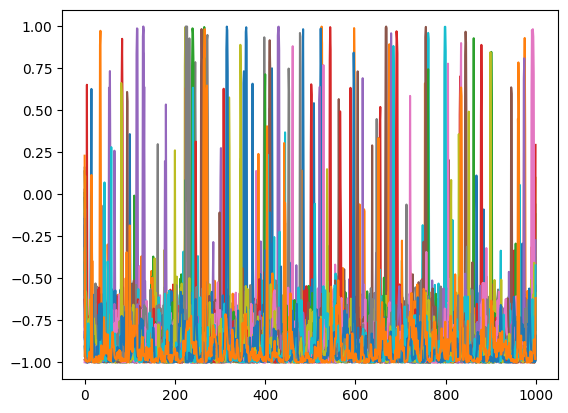

Epoch: 5 | Loss_D: 0.04993108659982681 | Loss_G: 3.9144060611724854 


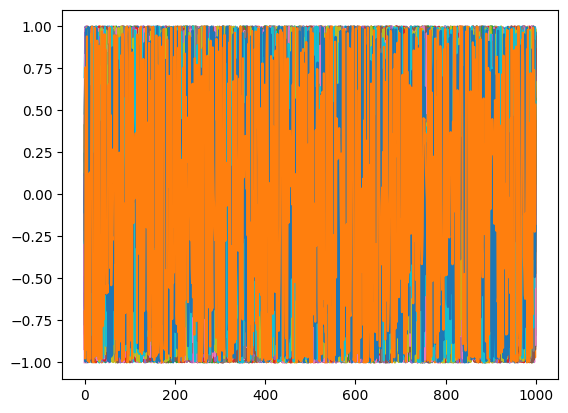

Epoch: 10 | Loss_D: 0.01278859842568636 | Loss_G: 5.397462368011475 


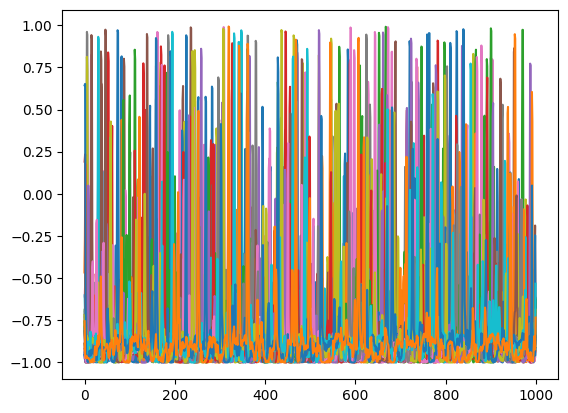

Epoch: 15 | Loss_D: 0.0023751400876790285 | Loss_G: 7.318528652191162 


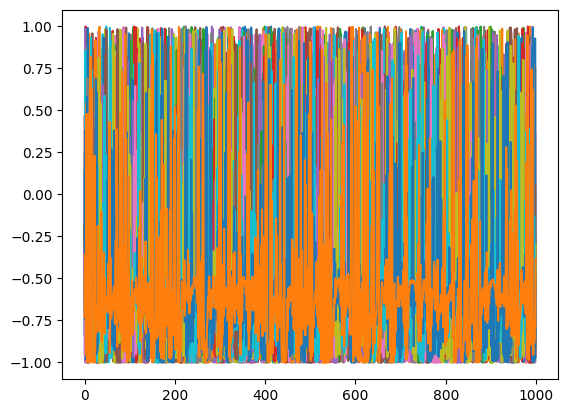

Epoch: 20 | Loss_D: 0.004322944674640894 | Loss_G: 6.644266605377197 


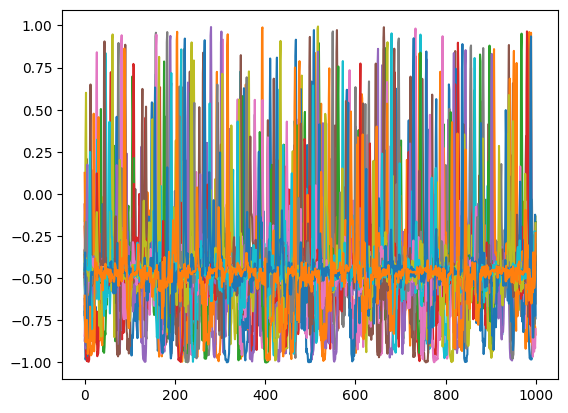

Epoch: 25 | Loss_D: 0.004185141995549202 | Loss_G: 6.9667863845825195 


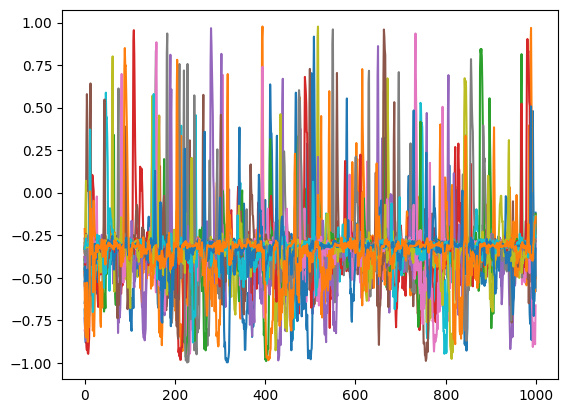

Epoch: 30 | Loss_D: 0.001267207320779562 | Loss_G: 8.382440567016602 


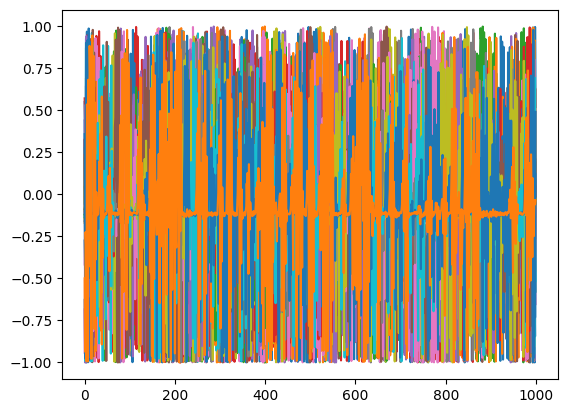

Epoch: 35 | Loss_D: 0.0006676006596535444 | Loss_G: 8.815814971923828 


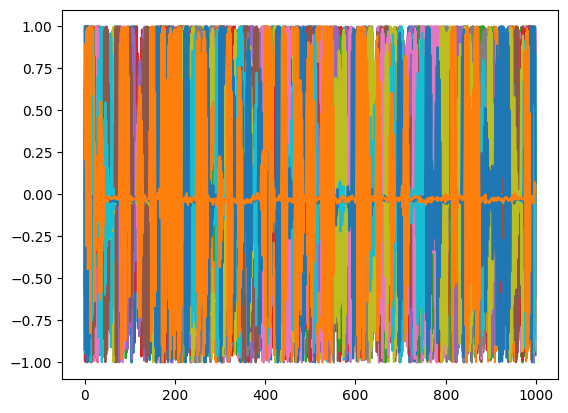

Epoch: 40 | Loss_D: 0.00032979121897369623 | Loss_G: 9.692964553833008 


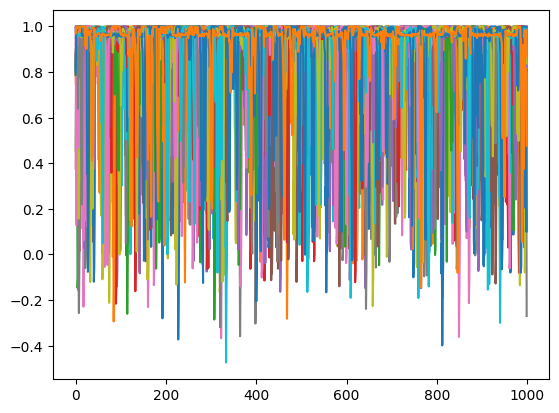

Epoch: 45 | Loss_D: 0.002358820755034685 | Loss_G: 8.082542419433594 


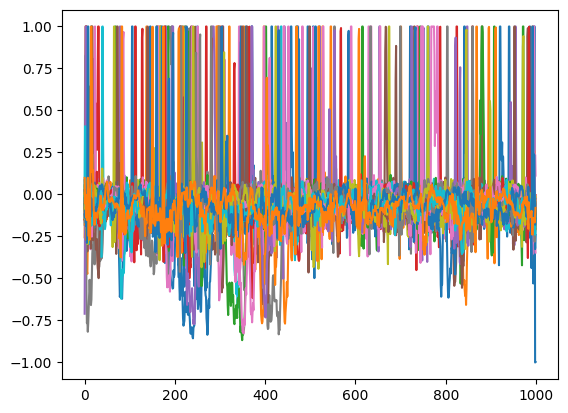

Epoch: 50 | Loss_D: 0.0008474161732010543 | Loss_G: 8.659235000610352 


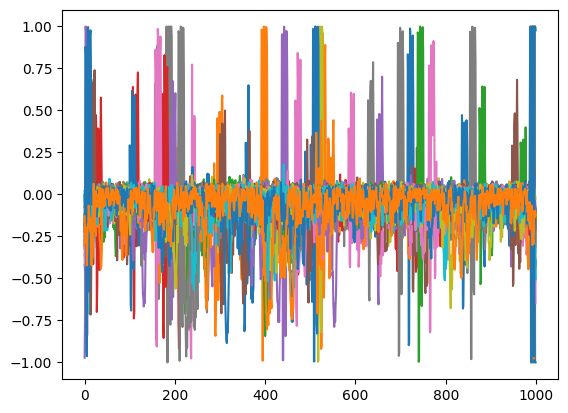

Epoch: 55 | Loss_D: 0.0005105311283841729 | Loss_G: 9.327253341674805 


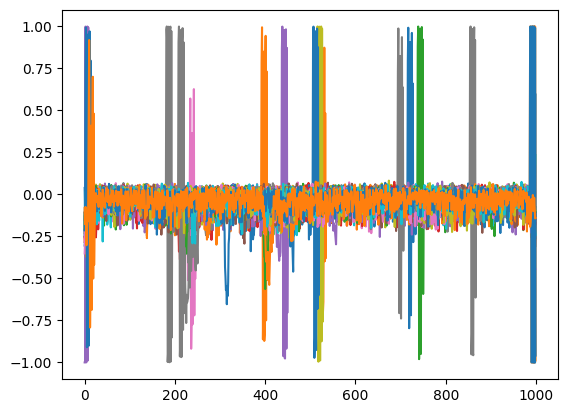

Epoch: 60 | Loss_D: 0.00020201950974296778 | Loss_G: 10.85312557220459 


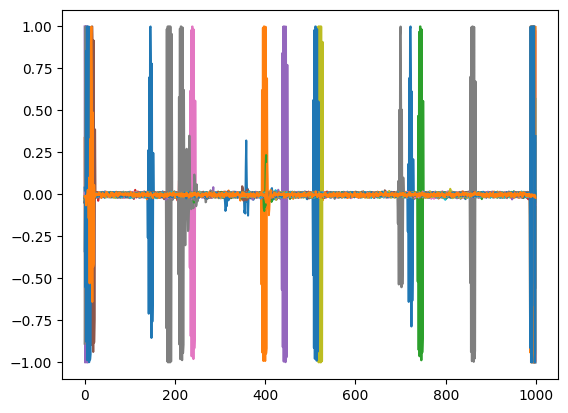

Epoch: 65 | Loss_D: 6.929649680387229e-05 | Loss_G: 11.182400703430176 


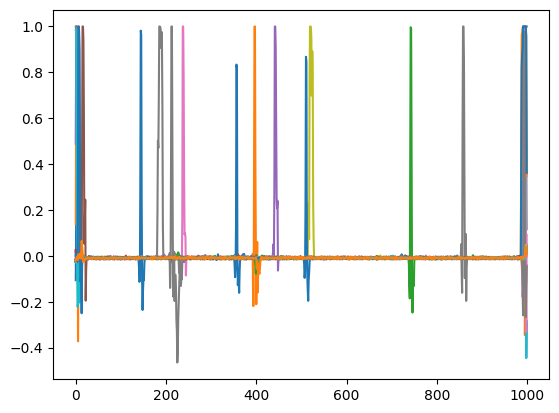

Epoch: 70 | Loss_D: 9.01736621017335e-06 | Loss_G: 14.007349014282227 


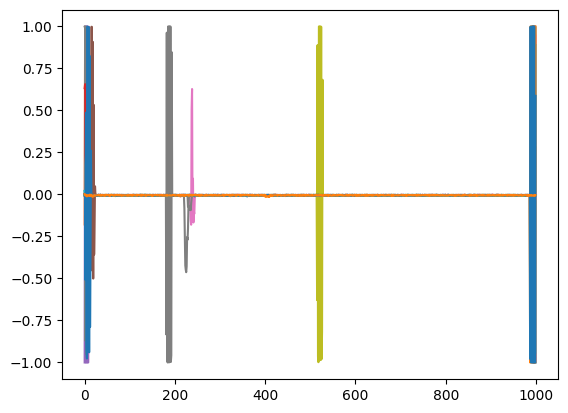

Epoch: 75 | Loss_D: 0.000130055210320279 | Loss_G: 9.444717407226562 


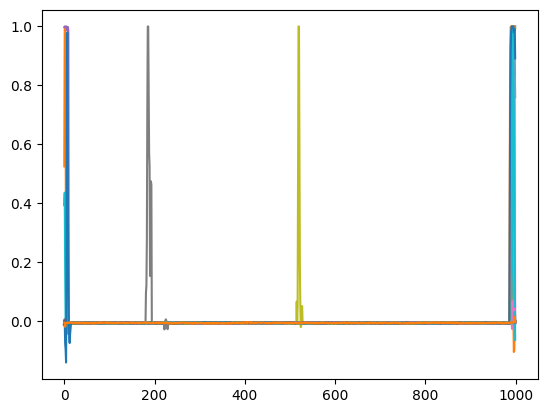

Epoch: 80 | Loss_D: 3.836951145785861e-05 | Loss_G: 12.152396202087402 


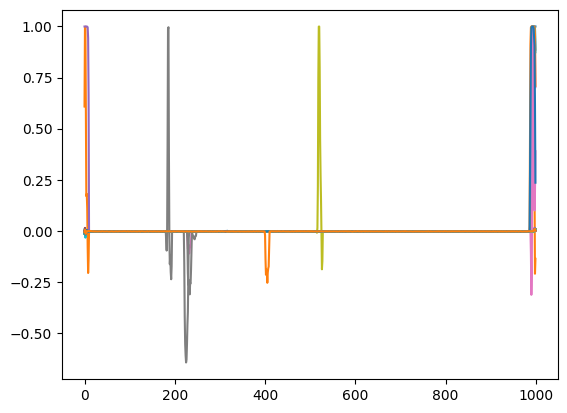

Epoch: 85 | Loss_D: 2.120242061209865e-05 | Loss_G: 12.55203628540039 


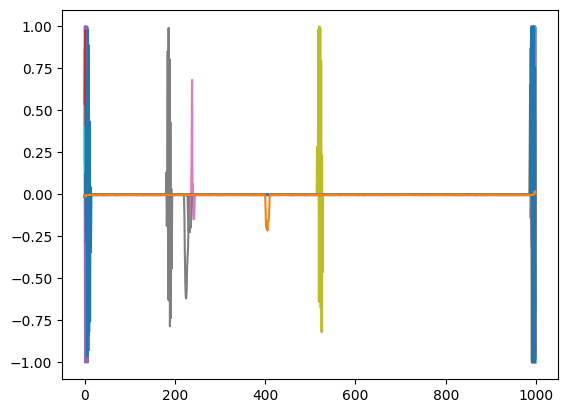

Epoch: 90 | Loss_D: 1.1324938895995729e-05 | Loss_G: 14.207344055175781 


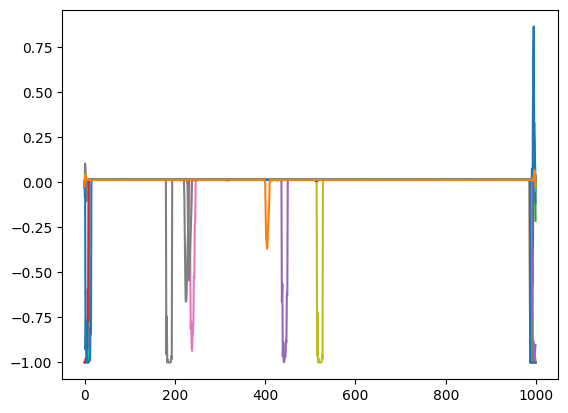

Epoch: 95 | Loss_D: 6.837522050773259e-06 | Loss_G: 14.04232120513916 


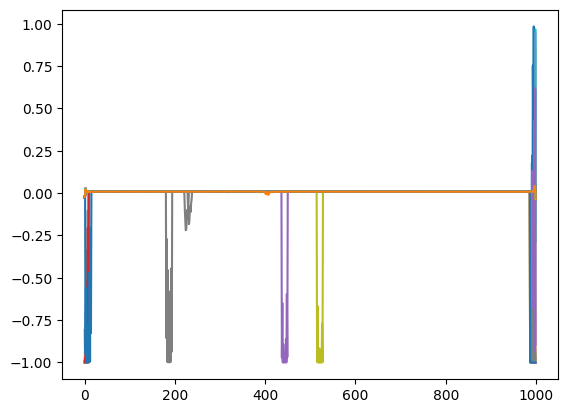

Epoch: 100 | Loss_D: 2.3416130261466606e-06 | Loss_G: 14.88158130645752 


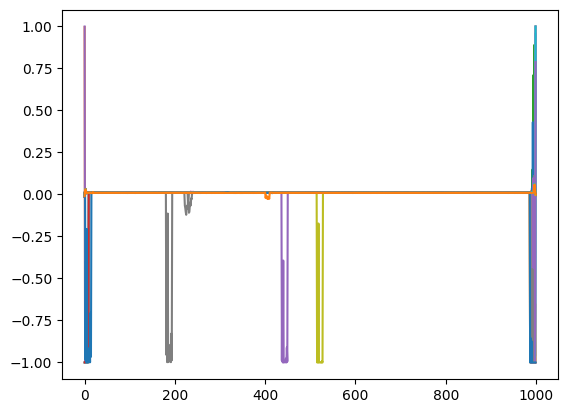

Epoch: 105 | Loss_D: 7.237708814500365e-07 | Loss_G: 15.416646003723145 


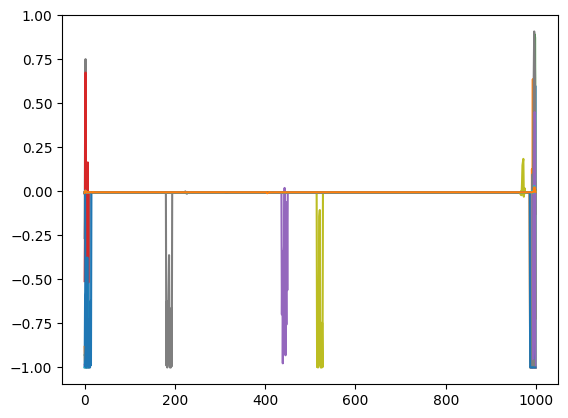

Epoch: 110 | Loss_D: 7.3484352469677106e-06 | Loss_G: 14.783513069152832 


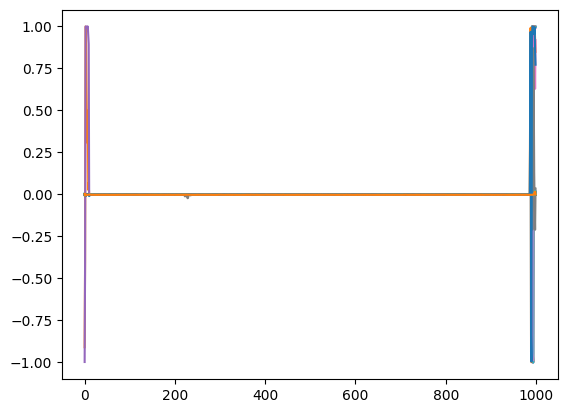

Epoch: 115 | Loss_D: 1.4134825505607296e-06 | Loss_G: 15.689384460449219 


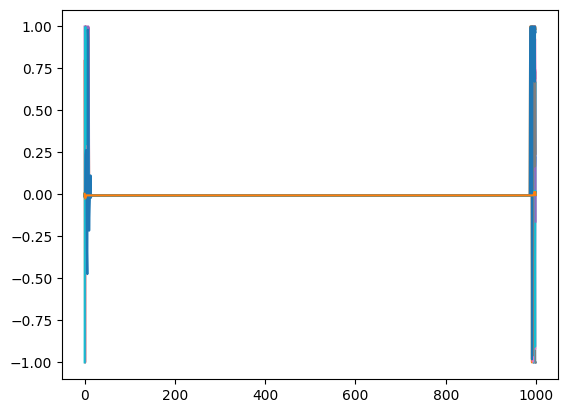

Epoch: 120 | Loss_D: 5.705016974388855e-07 | Loss_G: 16.000276565551758 


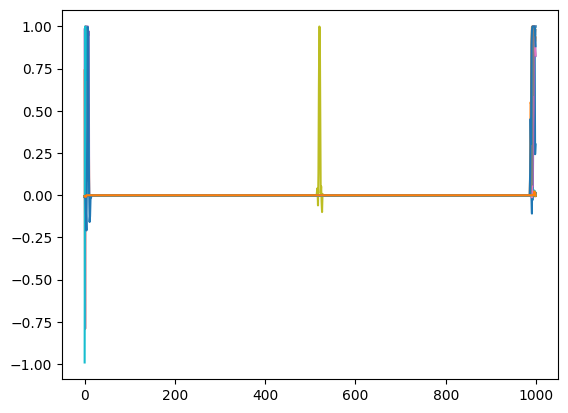

Epoch: 125 | Loss_D: 4.002027083060966e-07 | Loss_G: 16.944339752197266 


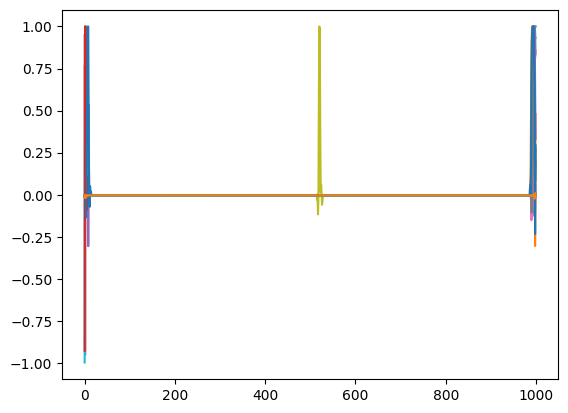

Epoch: 130 | Loss_D: 2.554485263317474e-07 | Loss_G: 21.705198287963867 


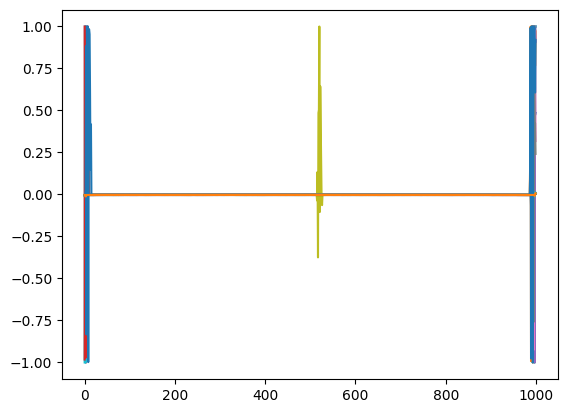

Epoch: 135 | Loss_D: 1.3623922257011145e-07 | Loss_G: 18.66196632385254 


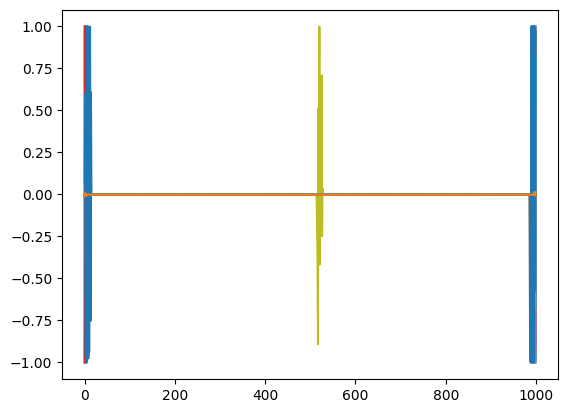

Epoch: 140 | Loss_D: 1.1920931797249068e-07 | Loss_G: 19.197662353515625 


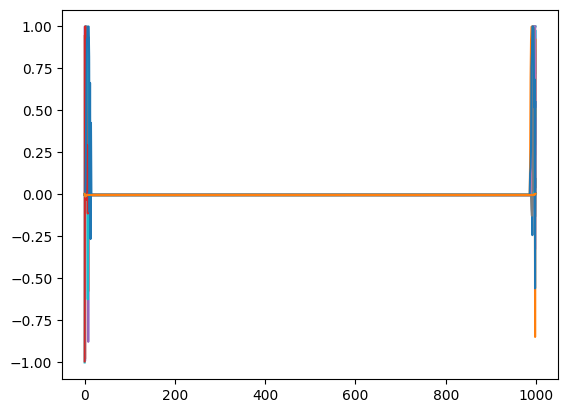

Epoch: 145 | Loss_D: 1.0217941337486991e-07 | Loss_G: 21.512950897216797 


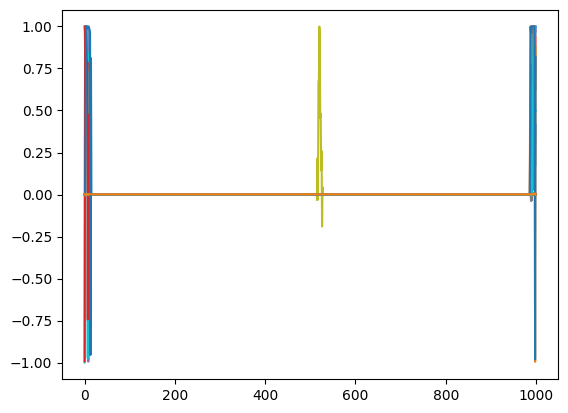

Epoch: 150 | Loss_D: 1.0217941337486991e-07 | Loss_G: 21.13880157470703 


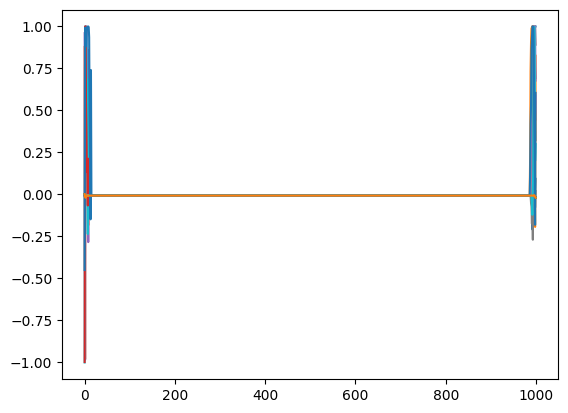

Epoch: 155 | Loss_D: 1.7029901044907092e-08 | Loss_G: 22.356977462768555 


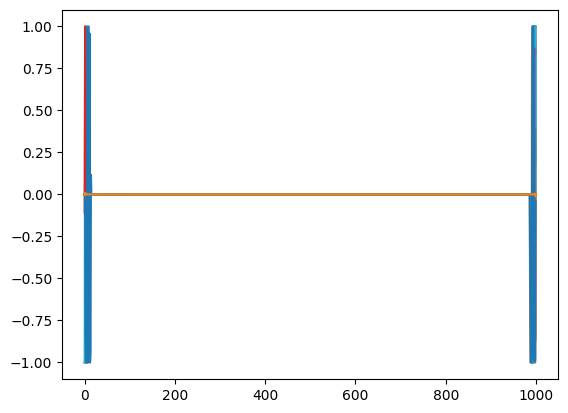

Epoch: 160 | Loss_D: 5.1089706687434955e-08 | Loss_G: 20.92732048034668 


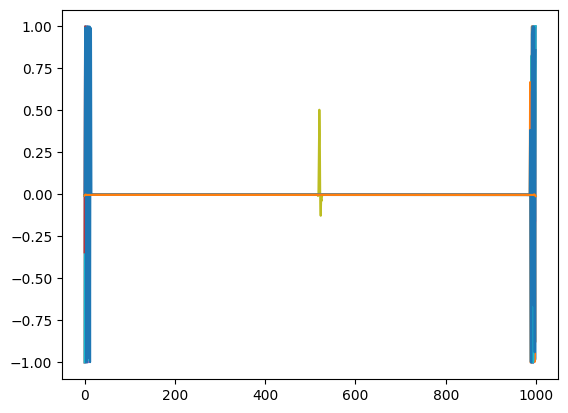

Epoch: 165 | Loss_D: 1.7029901044907092e-08 | Loss_G: 21.228612899780273 


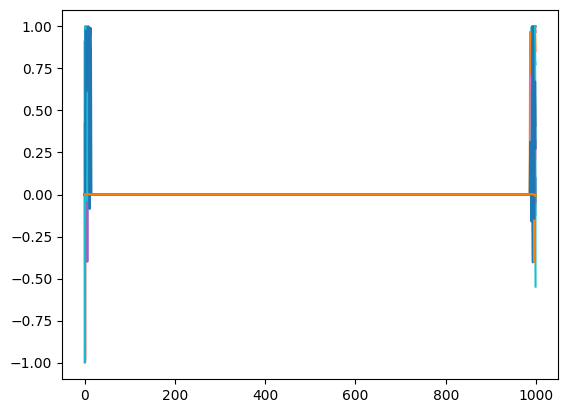

Epoch: 170 | Loss_D: 0.0 | Loss_G: 21.466571807861328 


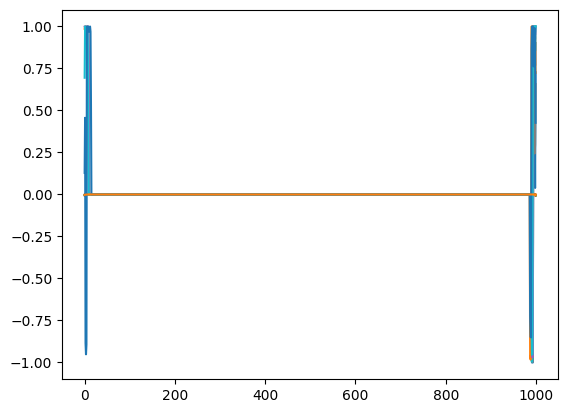

Epoch: 175 | Loss_D: 0.0 | Loss_G: 21.9094181060791 


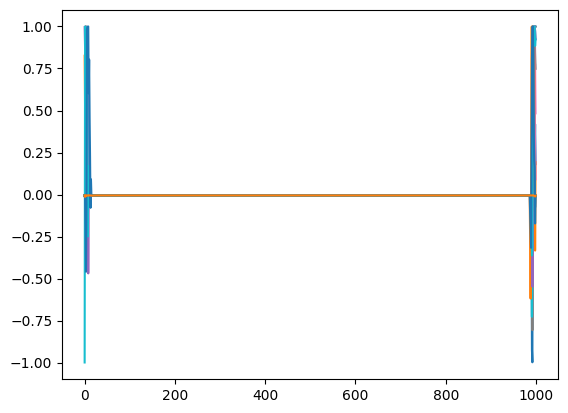

Epoch: 180 | Loss_D: 1.7029901044907092e-08 | Loss_G: 21.86953353881836 


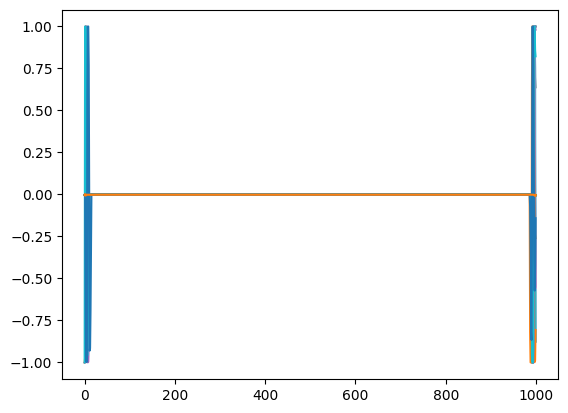

Epoch: 185 | Loss_D: 0.0 | Loss_G: 23.679933547973633 


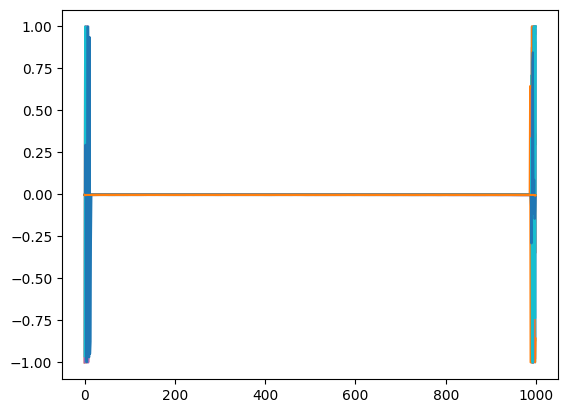

Epoch: 190 | Loss_D: 7.517256744904444e-05 | Loss_G: 10.467763900756836 


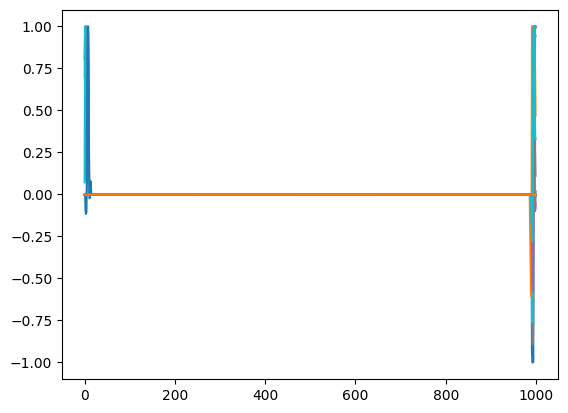

Epoch: 195 | Loss_D: 1.857124880189076e-05 | Loss_G: 11.962119102478027 


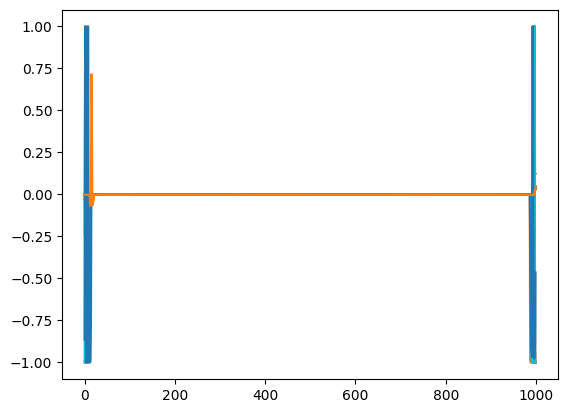

Epoch: 200 | Loss_D: 8.25101051304955e-06 | Loss_G: 12.612326622009277 


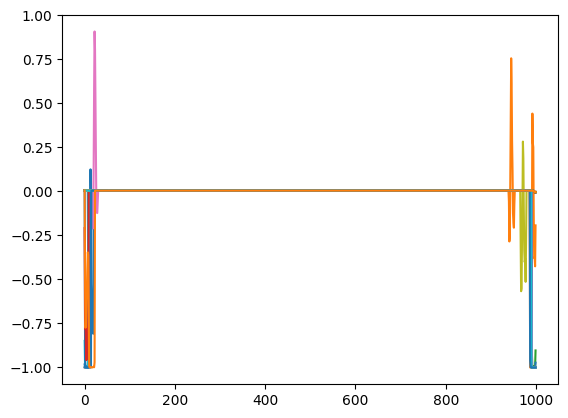

Epoch: 205 | Loss_D: 1.7200217143908958e-06 | Loss_G: 16.50555419921875 


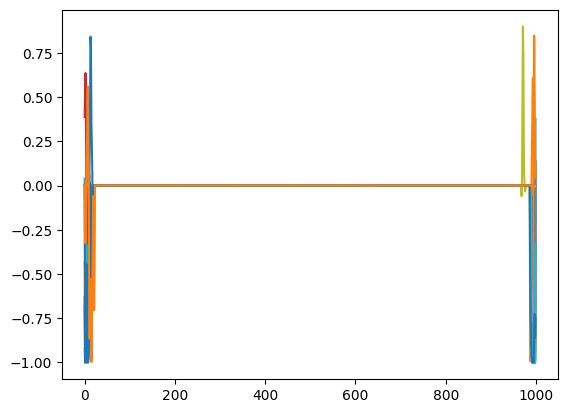

Epoch: 210 | Loss_D: 6.301065127445327e-07 | Loss_G: 17.370187759399414 


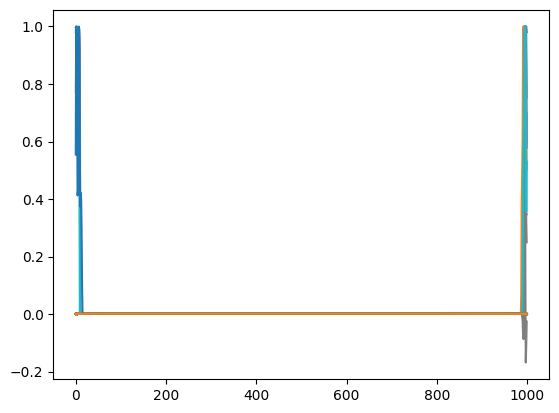

Epoch: 215 | Loss_D: 2.554485263317474e-07 | Loss_G: 19.708038330078125 


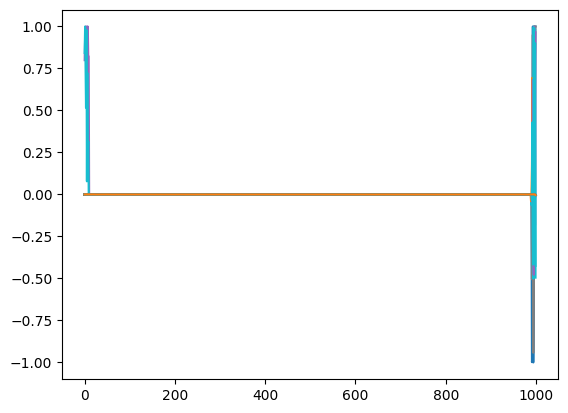

Epoch: 220 | Loss_D: 7.867859494581353e-06 | Loss_G: 18.222759246826172 


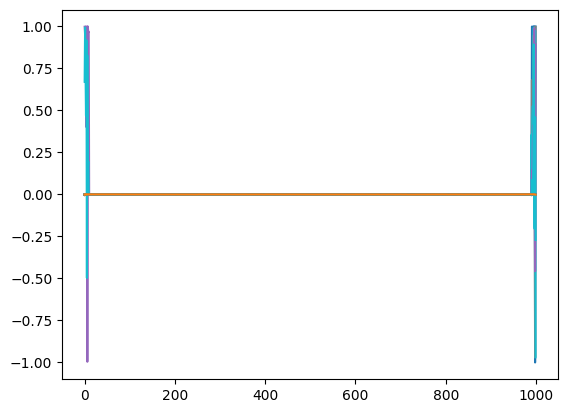

Epoch: 225 | Loss_D: 2.903603672166355e-06 | Loss_G: 17.24413299560547 


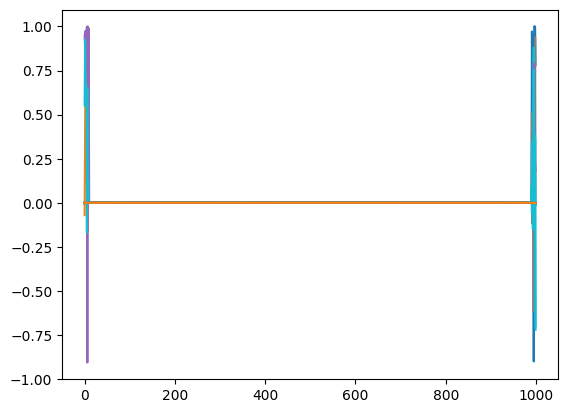

Epoch: 230 | Loss_D: 1.132489046540286e-06 | Loss_G: 17.443614959716797 


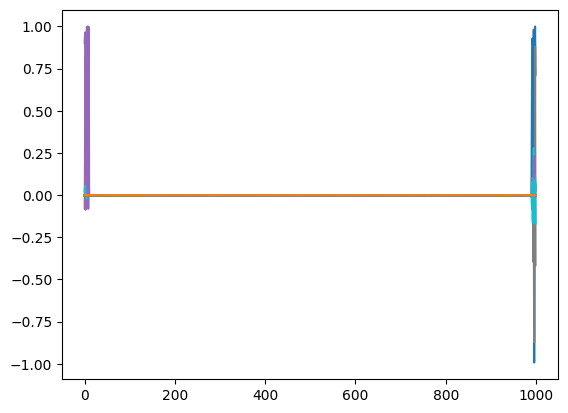

Epoch: 235 | Loss_D: 4.0871765349947964e-07 | Loss_G: 20.8460750579834 


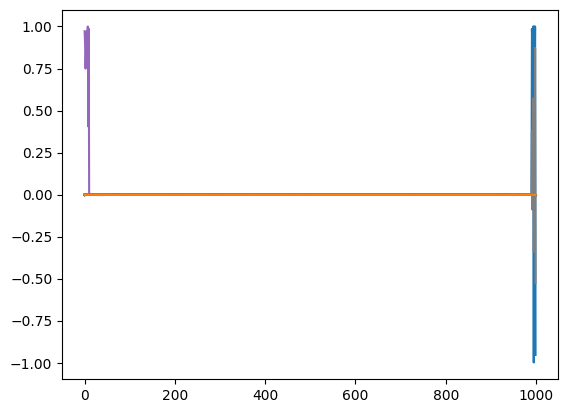

Epoch: 240 | Loss_D: 3.8317284634104e-07 | Loss_G: 17.742395401000977 


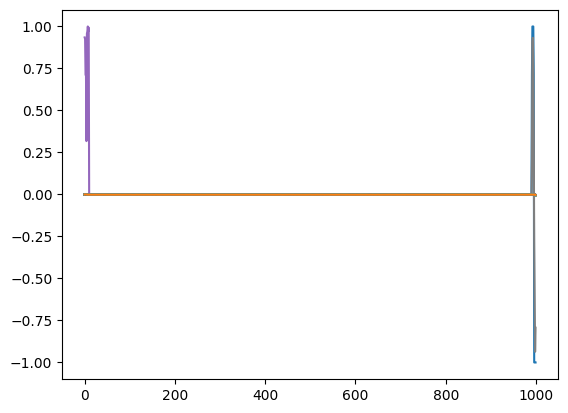

Epoch: 245 | Loss_D: 1.1920931797249068e-07 | Loss_G: 19.229650497436523 


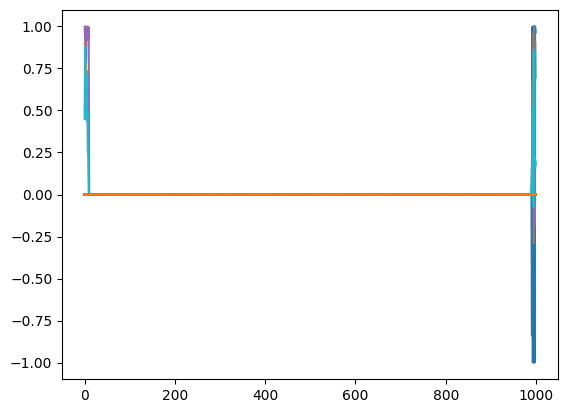

Epoch: 250 | Loss_D: 1.0217941337486991e-07 | Loss_G: 20.41144561767578 


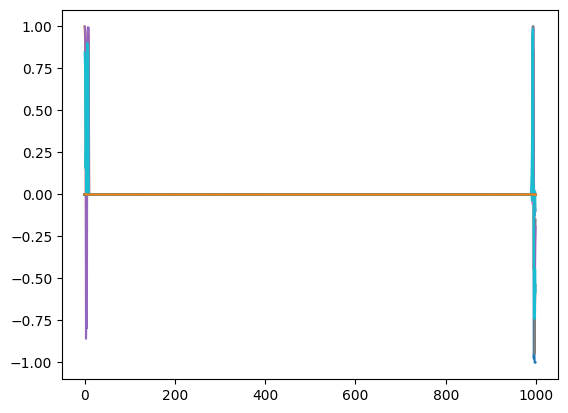

Epoch: 255 | Loss_D: 5.1089706687434955e-08 | Loss_G: 20.78872299194336 


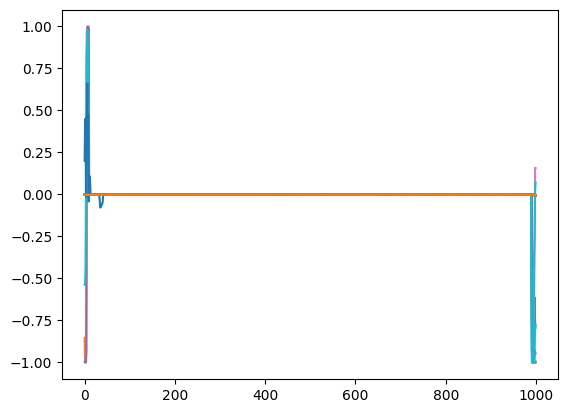

Epoch: 260 | Loss_D: 0.0 | Loss_G: 21.2868595123291 


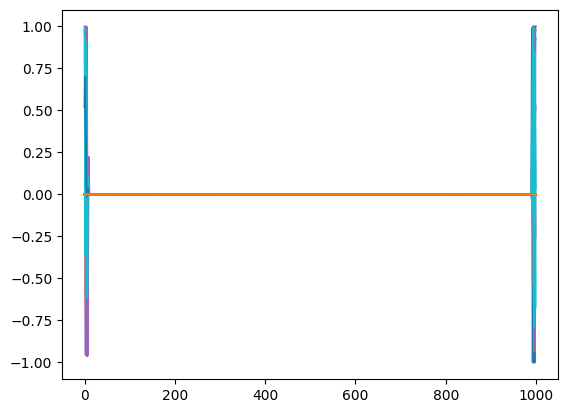

Epoch: 265 | Loss_D: 0.0 | Loss_G: 22.413984298706055 


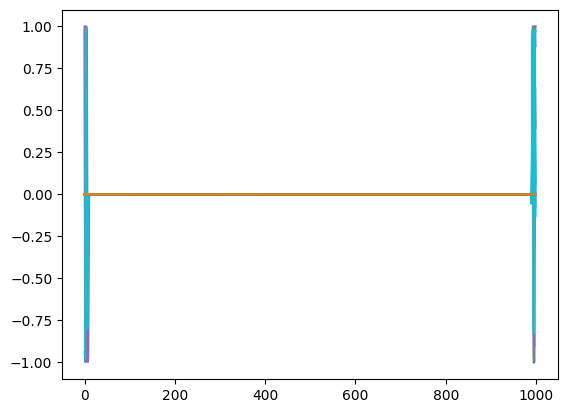

Epoch: 270 | Loss_D: 0.0 | Loss_G: 22.036602020263672 


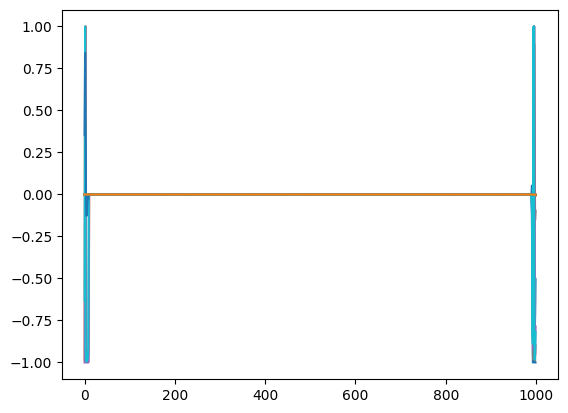

Epoch: 275 | Loss_D: 3.4059802089814184e-08 | Loss_G: 19.79559898376465 


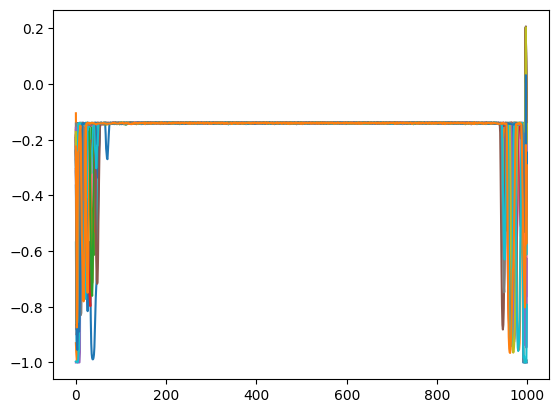

Epoch: 280 | Loss_D: 3.4059802089814184e-08 | Loss_G: 22.93402671813965 


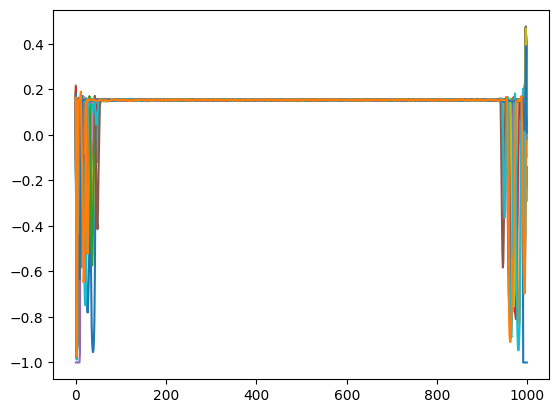

Epoch: 285 | Loss_D: 6.811960417962837e-08 | Loss_G: 22.001569747924805 


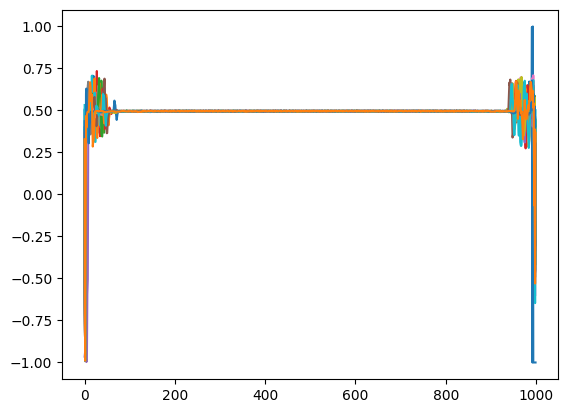

Epoch: 290 | Loss_D: 1.4475416776349448e-07 | Loss_G: 18.03522300720215 


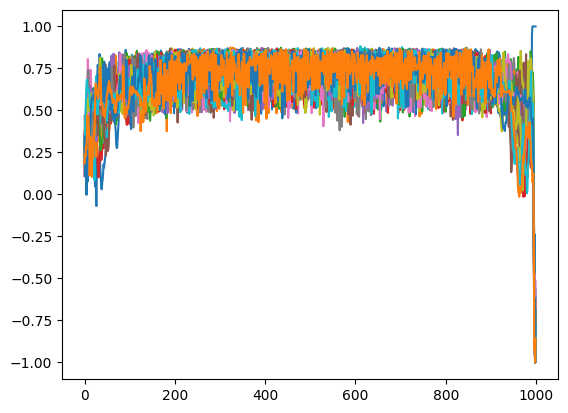

Epoch: 295 | Loss_D: 0.00017736305017024279 | Loss_G: 18.60509490966797 


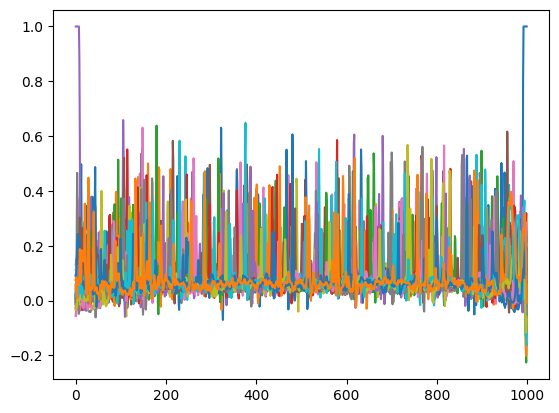

Epoch: 300 | Loss_D: 4.867273673880845e-05 | Loss_G: 11.944347381591797 


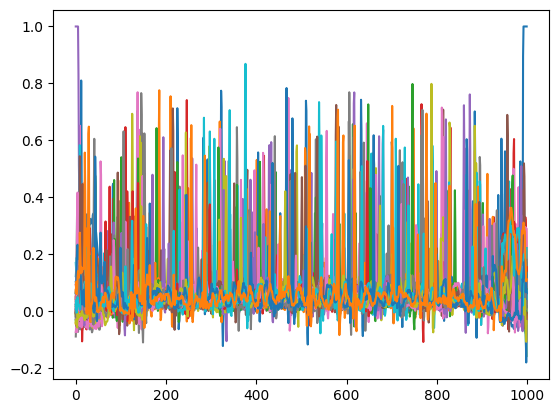

Epoch: 305 | Loss_D: 8.445561252301559e-05 | Loss_G: 18.55134391784668 


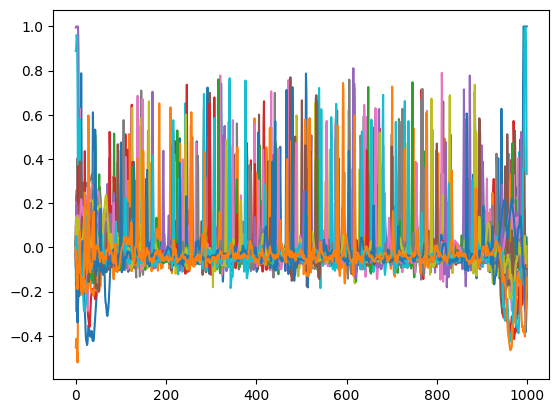

Epoch: 310 | Loss_D: 1.4841688425804023e-05 | Loss_G: 15.066494941711426 


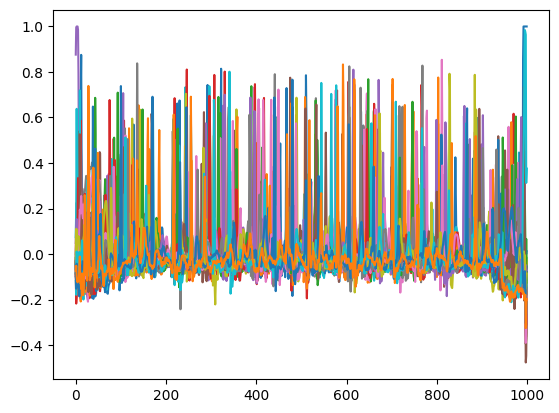

Epoch: 315 | Loss_D: 0.0028831572271883488 | Loss_G: 8.816402435302734 


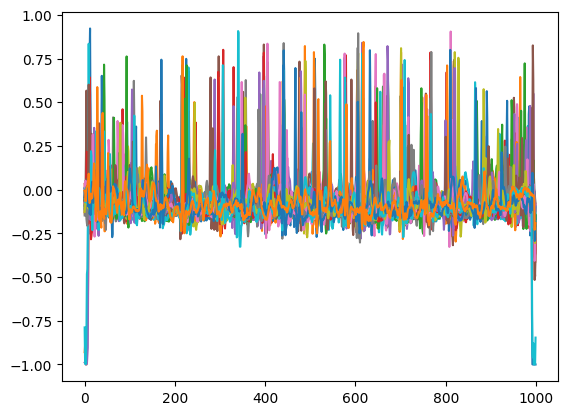

Epoch: 320 | Loss_D: 0.00047425716184079647 | Loss_G: 10.713756561279297 


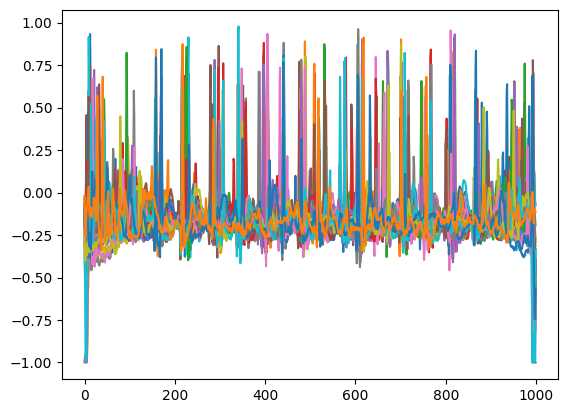

Epoch: 325 | Loss_D: 0.001209057285450399 | Loss_G: 8.260530471801758 


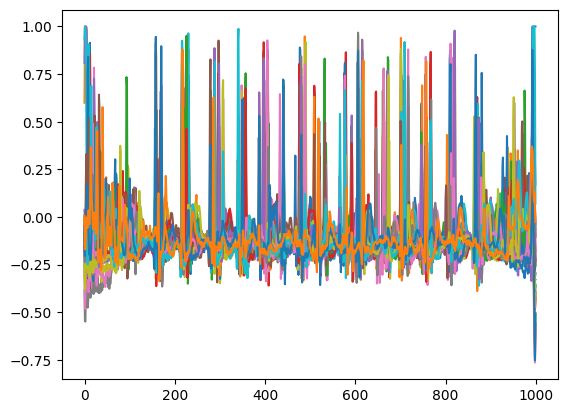

Epoch: 330 | Loss_D: 0.0002648756781127304 | Loss_G: 8.80405330657959 


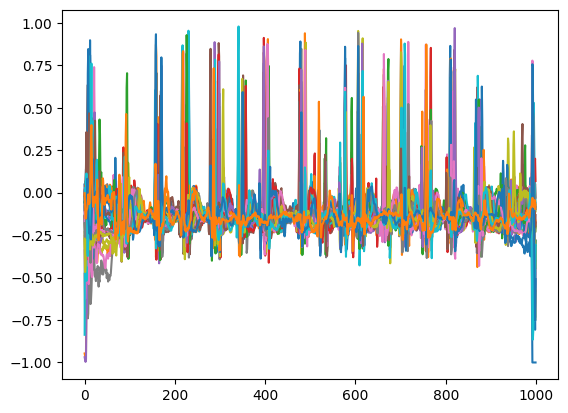

Epoch: 335 | Loss_D: 2.869594572985079e-05 | Loss_G: 18.987972259521484 


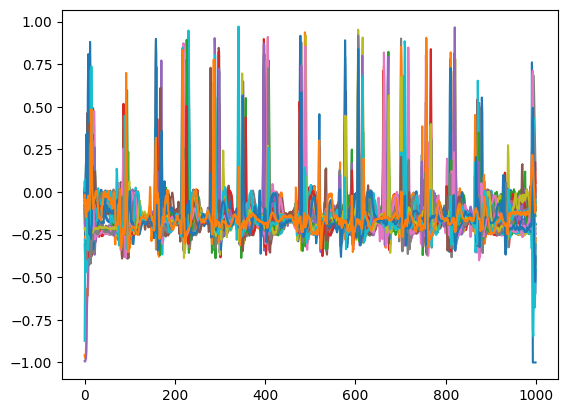

Epoch: 340 | Loss_D: 6.0077822126913816e-05 | Loss_G: 13.58187484741211 


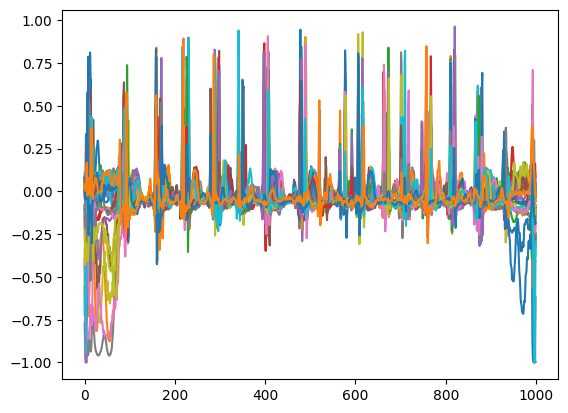

Epoch: 345 | Loss_D: 2.5051209377124906e-05 | Loss_G: 11.91999626159668 


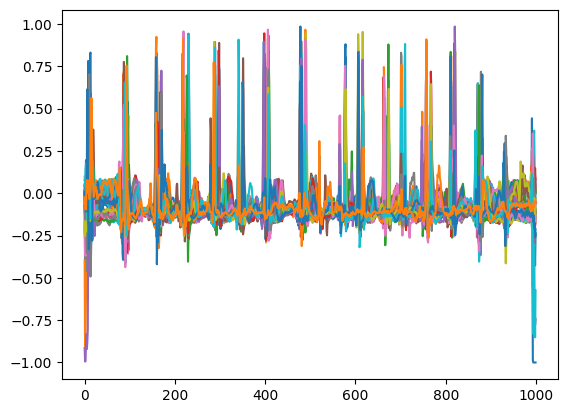

Epoch: 350 | Loss_D: 2.9087719667586498e-05 | Loss_G: 15.564208984375 


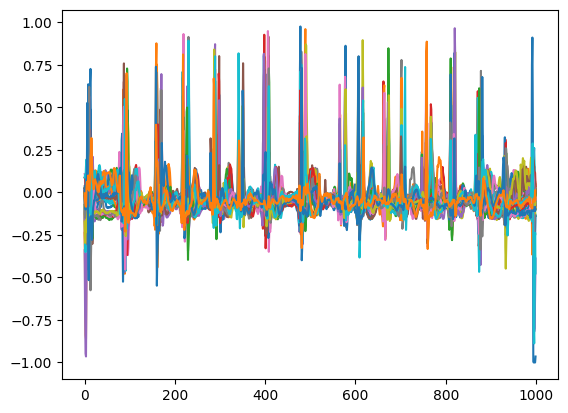

Epoch: 355 | Loss_D: 0.0002938121324405074 | Loss_G: 9.056193351745605 


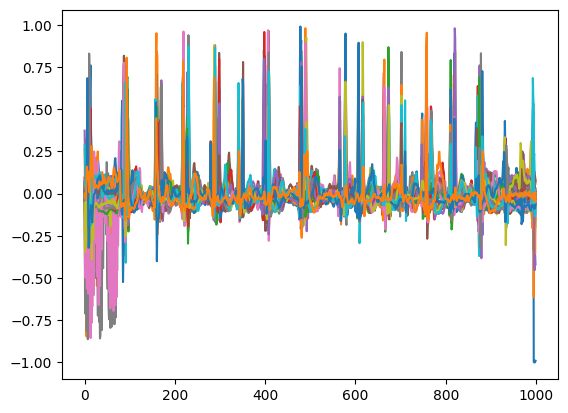

Epoch: 360 | Loss_D: 2.402956670266576e-05 | Loss_G: 14.56974983215332 


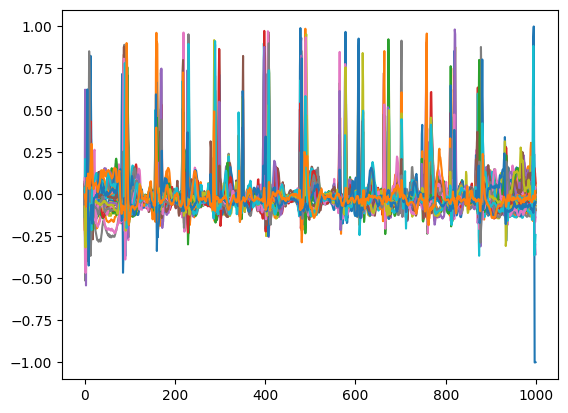

Epoch: 365 | Loss_D: 6.15474782534875e-05 | Loss_G: 10.153627395629883 


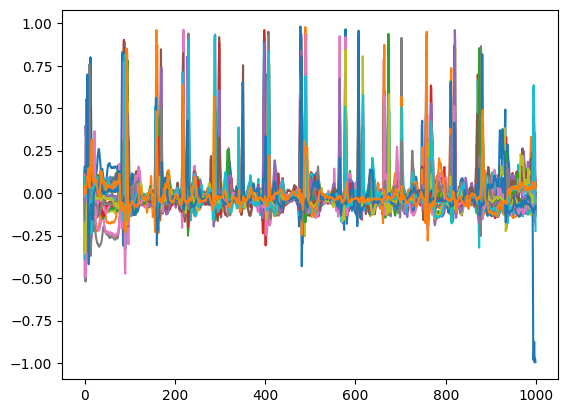

Epoch: 370 | Loss_D: 8.955447992775589e-05 | Loss_G: 14.087137222290039 


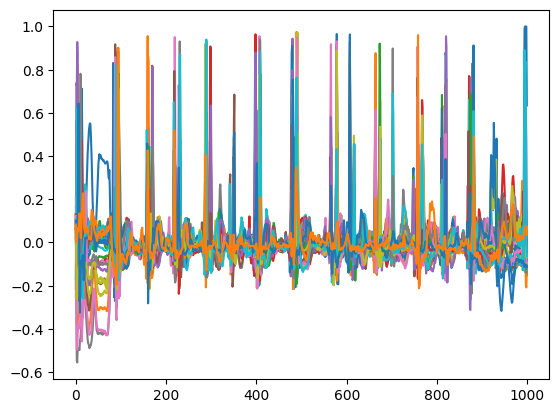

Epoch: 375 | Loss_D: 3.016032133018598e-05 | Loss_G: 11.988129615783691 


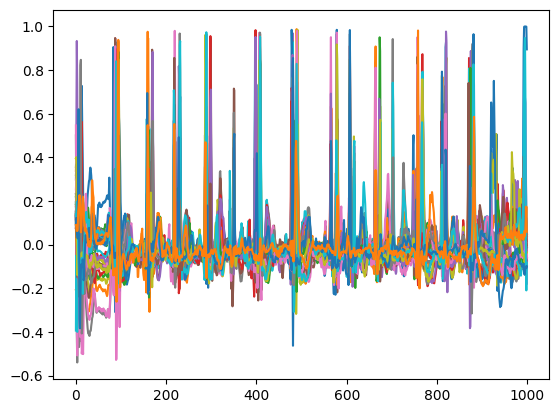

Epoch: 380 | Loss_D: 3.922914038412273e-05 | Loss_G: 10.956812858581543 


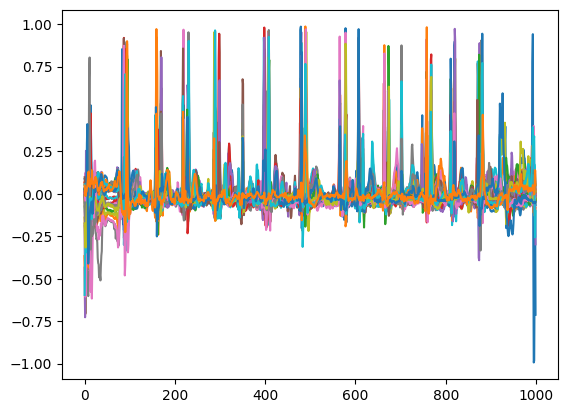

Epoch: 385 | Loss_D: 0.0056663560681045055 | Loss_G: 5.286662578582764 


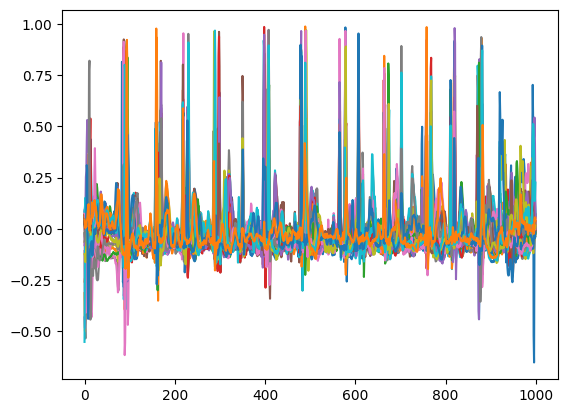

Epoch: 390 | Loss_D: 0.0001578690280439332 | Loss_G: 9.181941032409668 


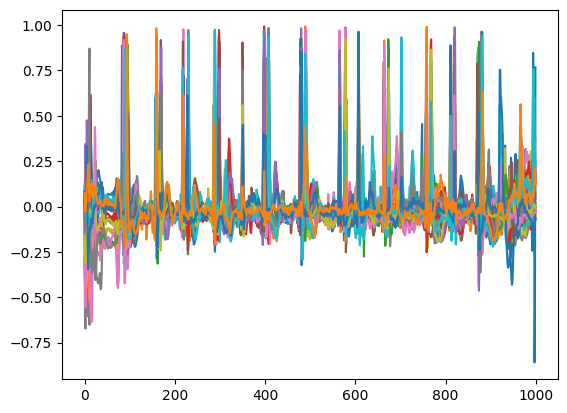

Epoch: 395 | Loss_D: 0.0005468794843181968 | Loss_G: 7.737868309020996 


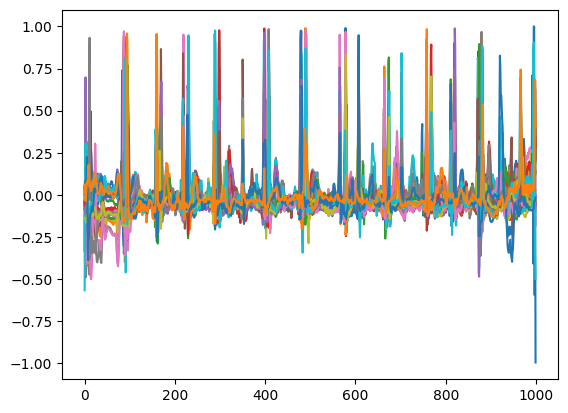

Epoch: 400 | Loss_D: 0.00022975908359512687 | Loss_G: 9.063501358032227 


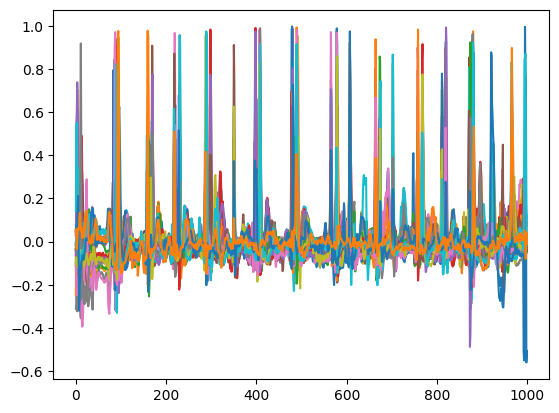

Epoch: 405 | Loss_D: 0.00017164877499453723 | Loss_G: 9.218368530273438 


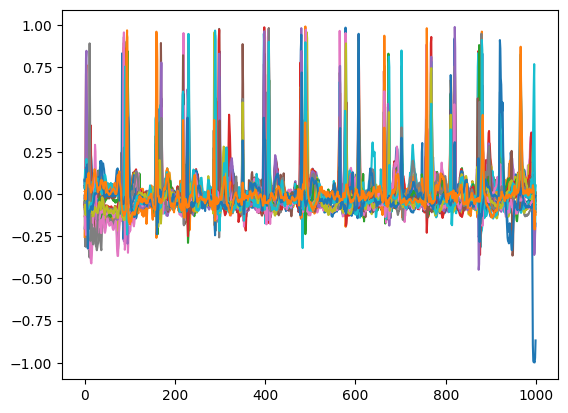

Epoch: 410 | Loss_D: 0.00022507586982101202 | Loss_G: 9.304327964782715 


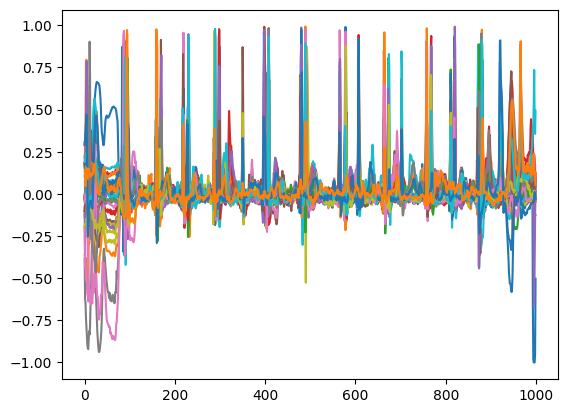

Epoch: 415 | Loss_D: 0.0005239167367108166 | Loss_G: 7.902493476867676 


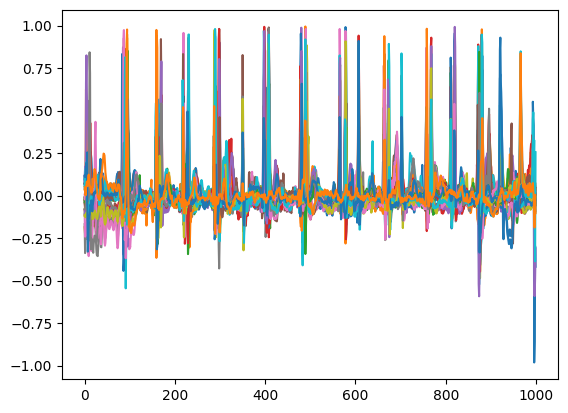

Epoch: 420 | Loss_D: 3.958721936214715e-05 | Loss_G: 15.655383110046387 


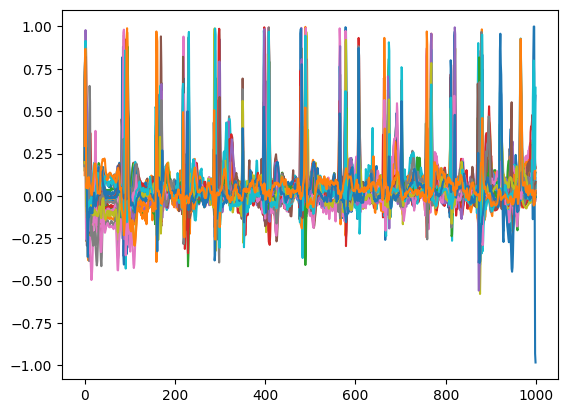

Epoch: 425 | Loss_D: 0.0005184267065487802 | Loss_G: 8.540898323059082 


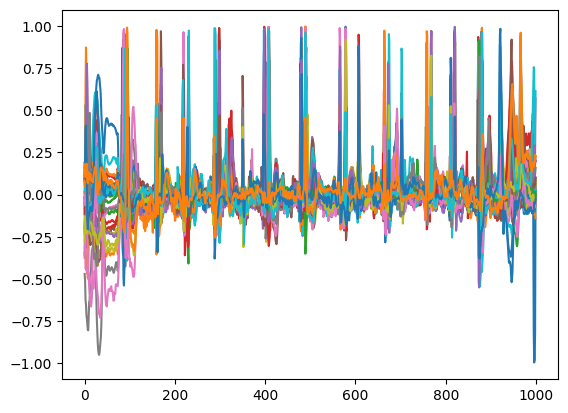

Epoch: 430 | Loss_D: 0.00018195065786130726 | Loss_G: 9.194721221923828 


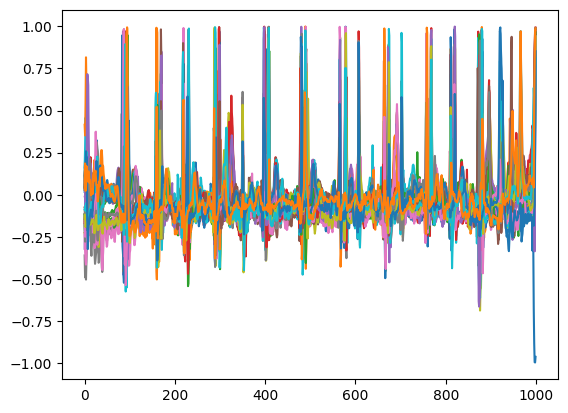

Epoch: 435 | Loss_D: 4.05658247473184e-05 | Loss_G: 11.139199256896973 


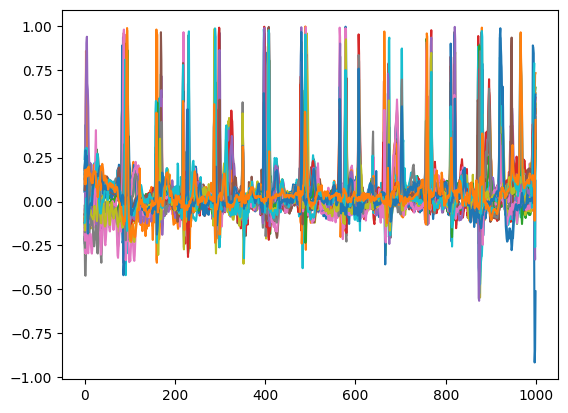

Epoch: 440 | Loss_D: 1.4007181562192272e-05 | Loss_G: 13.05501937866211 


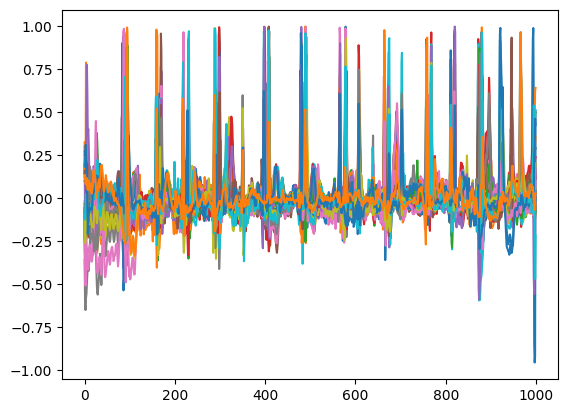

Epoch: 445 | Loss_D: 0.00035465898690745234 | Loss_G: 8.321581840515137 


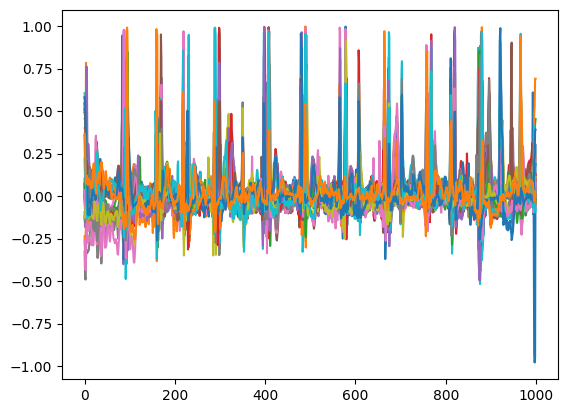

Epoch: 450 | Loss_D: 2.267548188683577e-05 | Loss_G: 11.705453872680664 


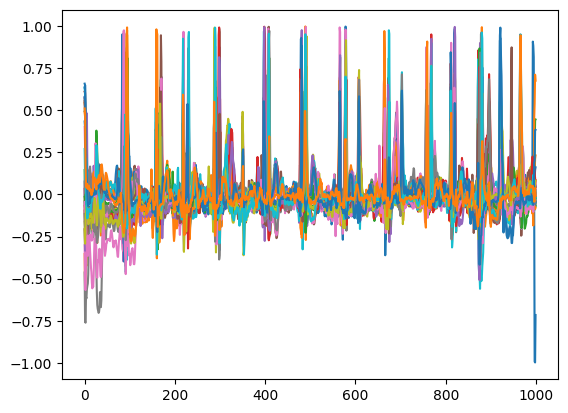

Epoch: 455 | Loss_D: 0.010147892870008945 | Loss_G: 4.859648704528809 


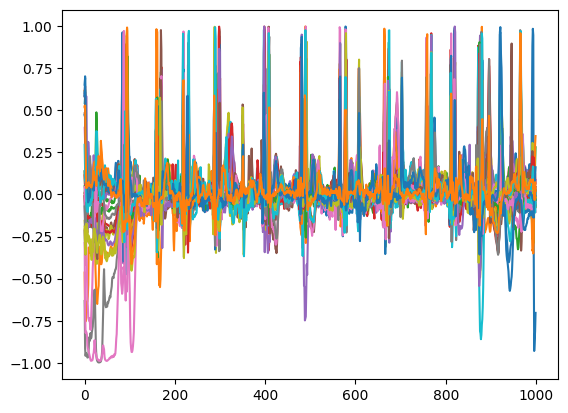

Epoch: 460 | Loss_D: 7.539370562881231e-05 | Loss_G: 9.818418502807617 


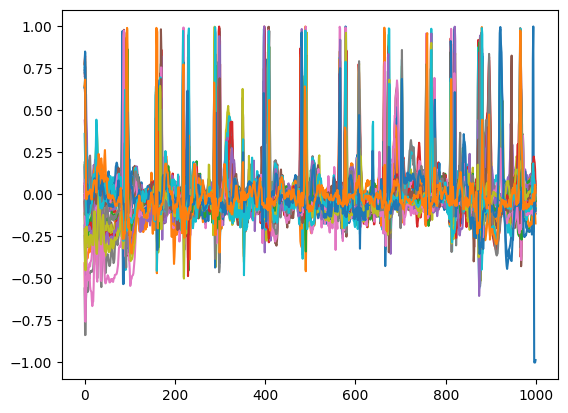

Epoch: 465 | Loss_D: 1.859676922322251e-05 | Loss_G: 11.960391998291016 


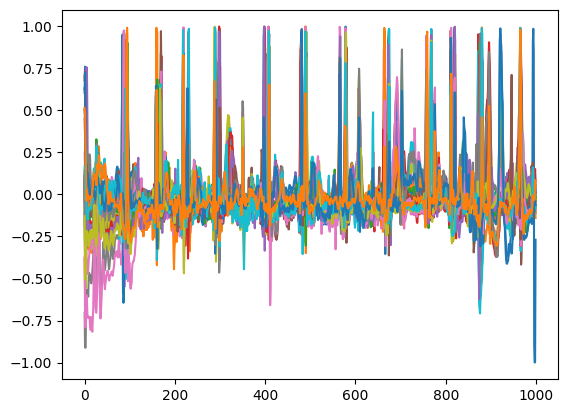

Epoch: 470 | Loss_D: 3.9808124711271375e-05 | Loss_G: 11.14022159576416 


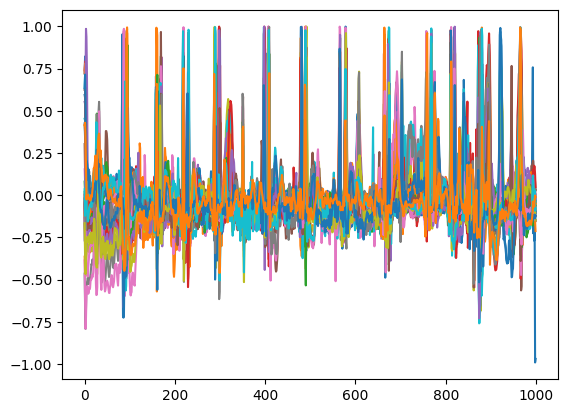

Epoch: 475 | Loss_D: 0.00012831081403419375 | Loss_G: 9.80762767791748 


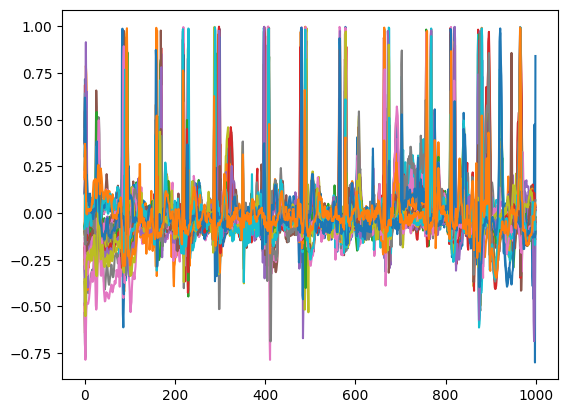

Epoch: 480 | Loss_D: 1.749837610987015e-05 | Loss_G: 12.801041603088379 


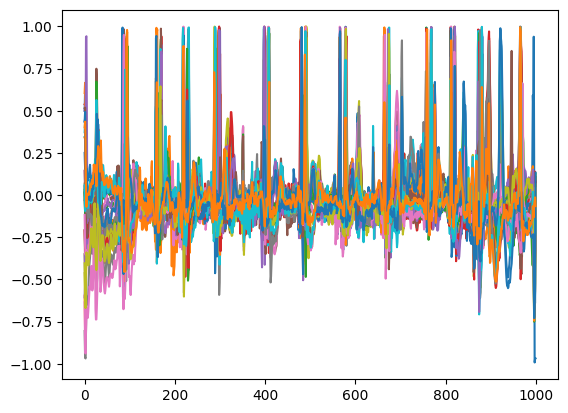

Epoch: 485 | Loss_D: 1.2048706594214309e-05 | Loss_G: 12.741227149963379 


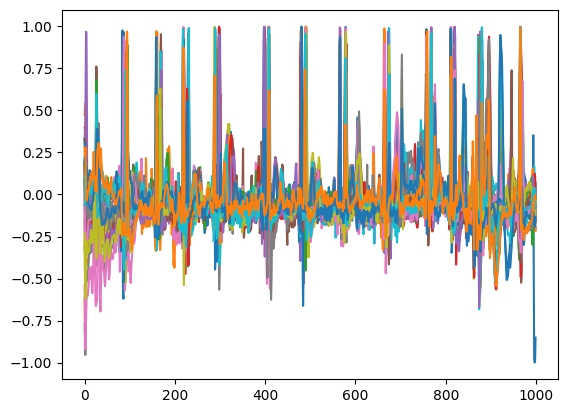

Epoch: 490 | Loss_D: 0.00038495956687256694 | Loss_G: 8.328927993774414 


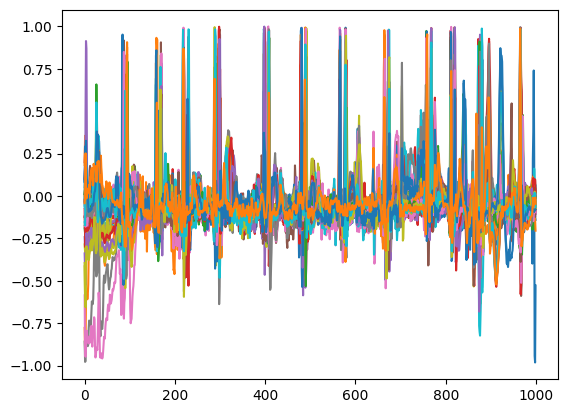

Epoch: 495 | Loss_D: 0.00012596817396115512 | Loss_G: 9.537775039672852 


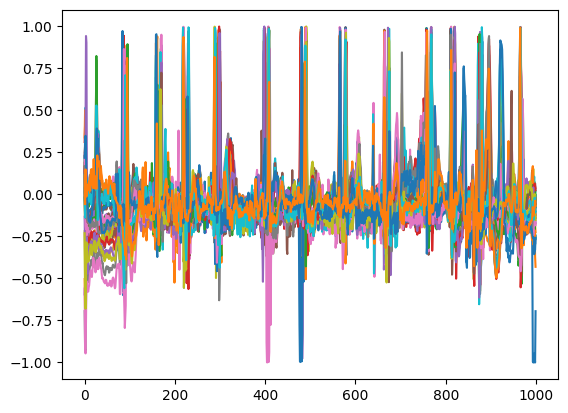

Epoch: 500 | Loss_D: 2.6447800337336957e-05 | Loss_G: 11.157389640808105 


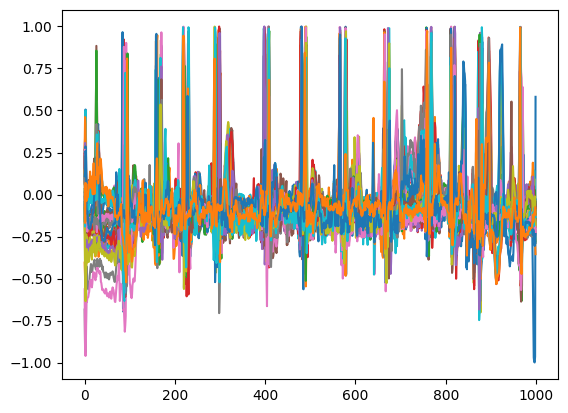

Epoch: 505 | Loss_D: 5.59433192393044e-06 | Loss_G: 13.30848217010498 


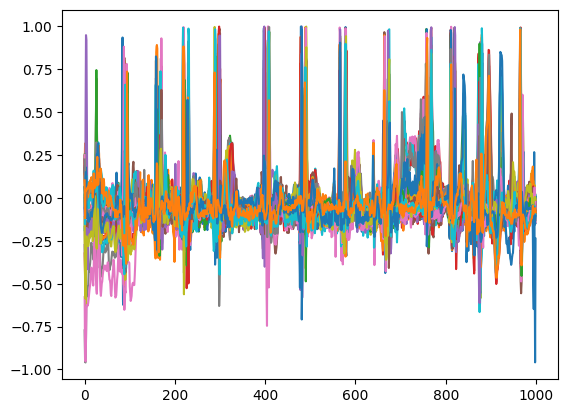

Epoch: 510 | Loss_D: 4.7676243411842734e-05 | Loss_G: 11.752729415893555 


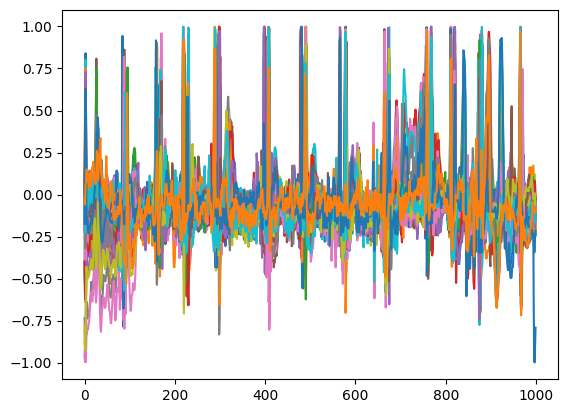

Epoch: 515 | Loss_D: 9.221724212693516e-06 | Loss_G: 13.482769012451172 


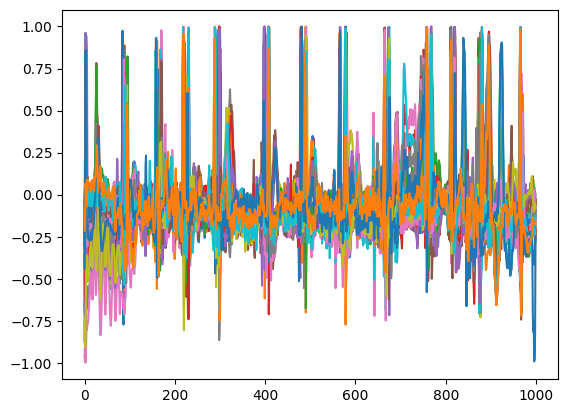

Epoch: 520 | Loss_D: 5.151553068571957e-06 | Loss_G: 13.39742660522461 


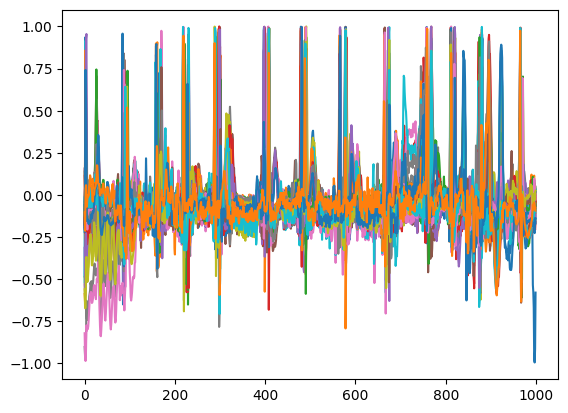

Epoch: 525 | Loss_D: 2.5033978090505116e-06 | Loss_G: 15.17945384979248 


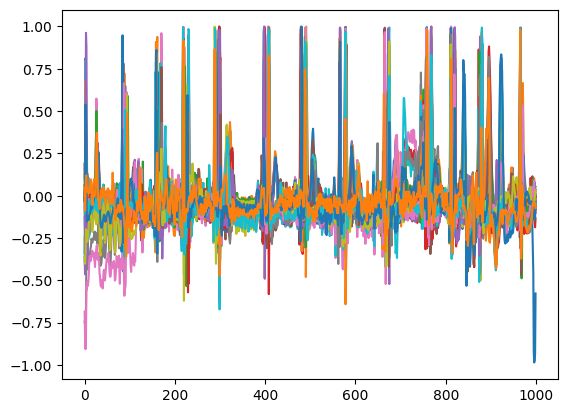

Epoch: 530 | Loss_D: 3.142952482448891e-05 | Loss_G: 14.040470123291016 


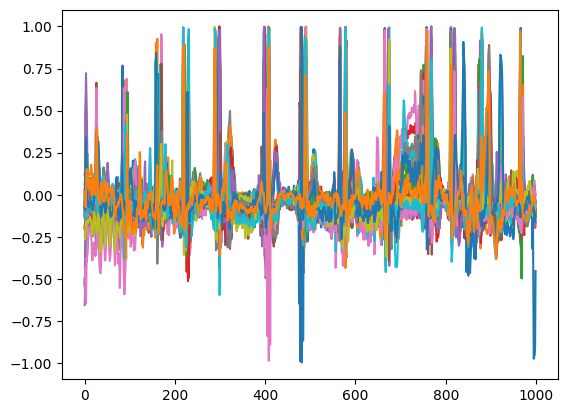

Epoch: 535 | Loss_D: 1.4679857486044057e-05 | Loss_G: 12.378178596496582 


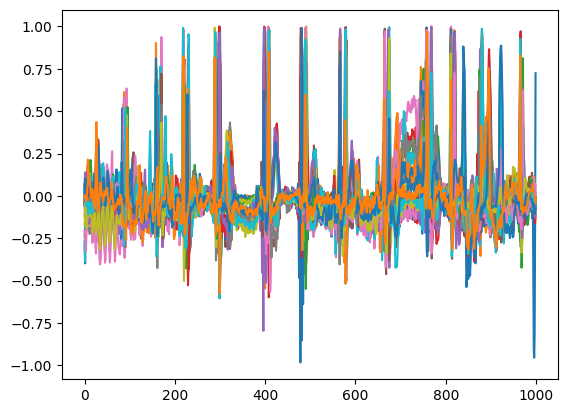

Epoch: 540 | Loss_D: 7.808226655470207e-06 | Loss_G: 12.484610557556152 


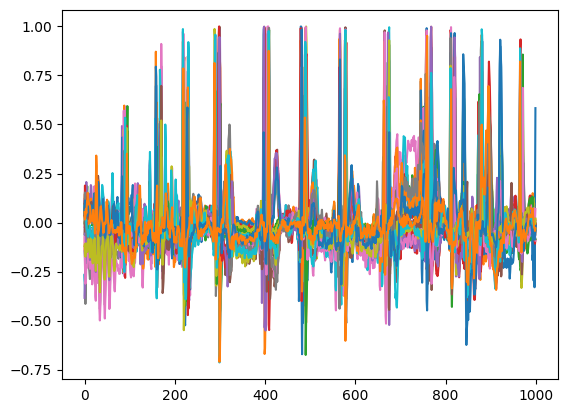

Epoch: 545 | Loss_D: 0.005860133096575737 | Loss_G: 5.581931114196777 


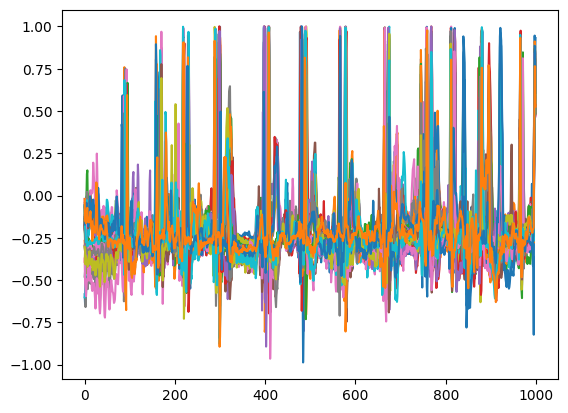

Epoch: 550 | Loss_D: 9.780065011000261e-05 | Loss_G: 9.6249361038208 


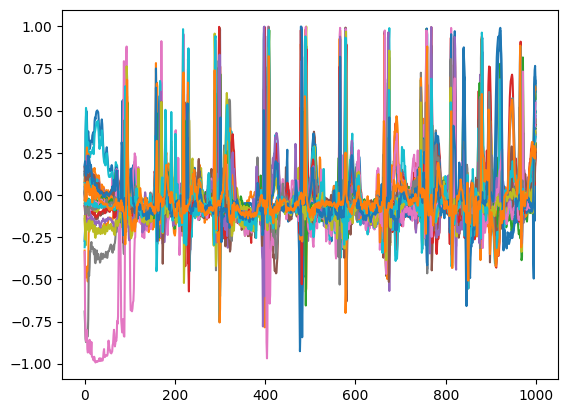

Epoch: 555 | Loss_D: 8.046659786486998e-06 | Loss_G: 13.22350025177002 


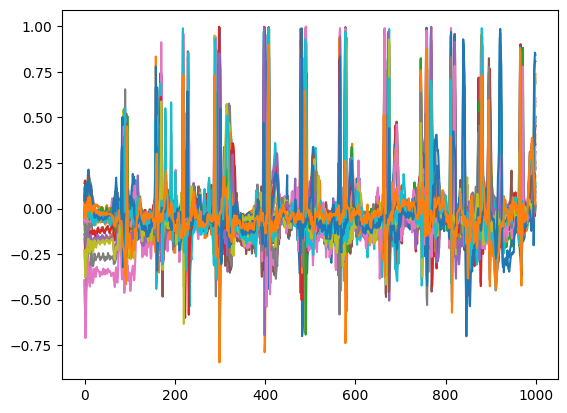

Epoch: 560 | Loss_D: 3.899855073541403e-06 | Loss_G: 14.595727920532227 


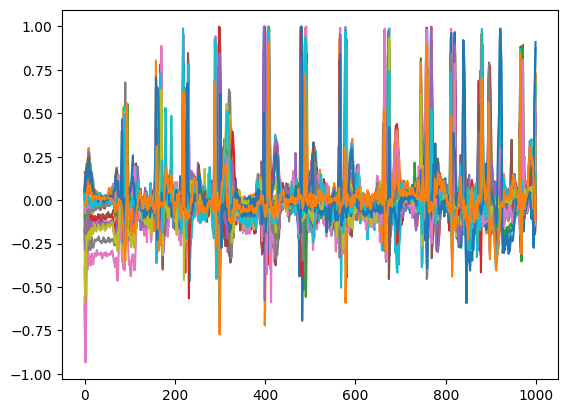

Epoch: 565 | Loss_D: 0.00041663734009489417 | Loss_G: 9.247196197509766 


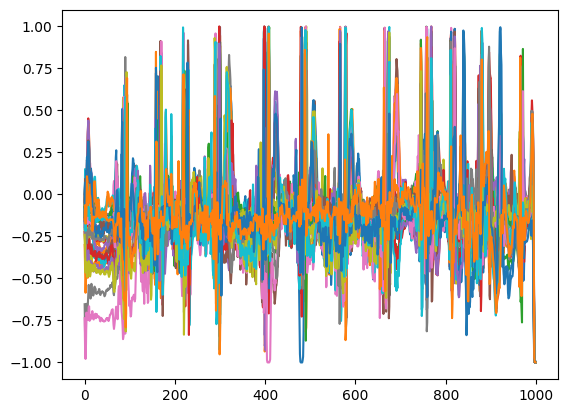

Epoch: 570 | Loss_D: 3.519275560392998e-05 | Loss_G: 11.450871467590332 


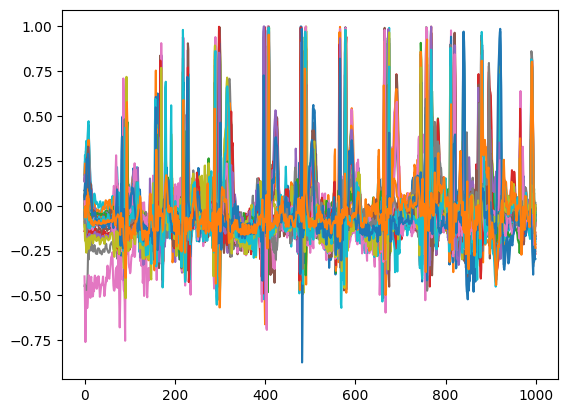

Epoch: 575 | Loss_D: 1.079699541151058e-05 | Loss_G: 12.299772262573242 


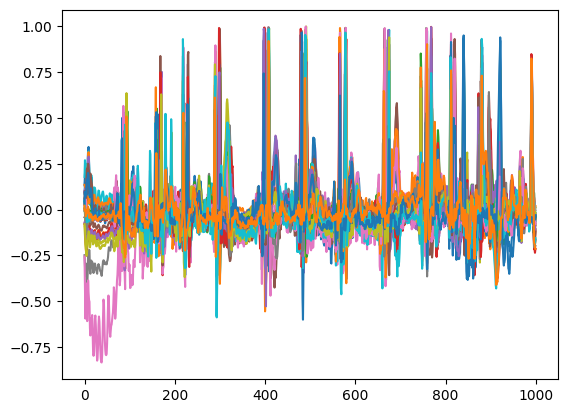

Epoch: 580 | Loss_D: 4.248967343301047e-06 | Loss_G: 13.790871620178223 


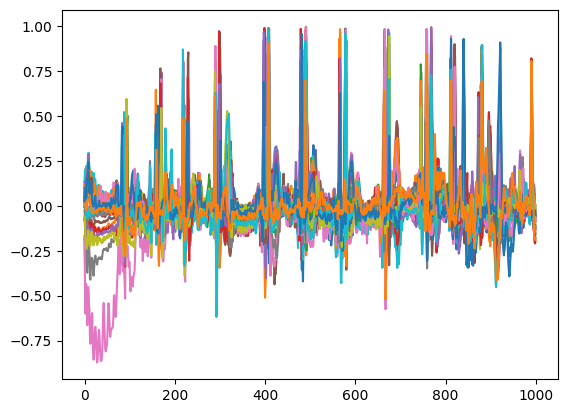

Epoch: 585 | Loss_D: 2.8389194994815625e-05 | Loss_G: 11.82264518737793 


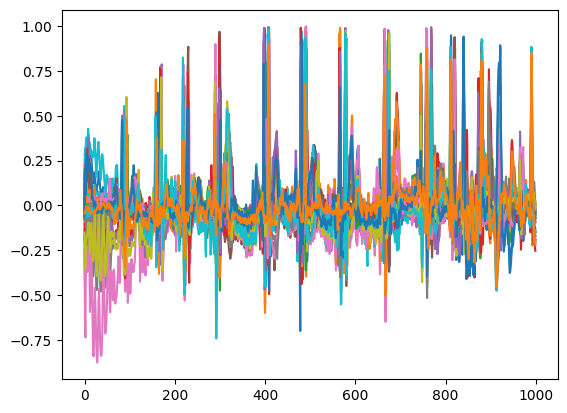

Epoch: 590 | Loss_D: 1.2210492059239186e-05 | Loss_G: 12.156159400939941 


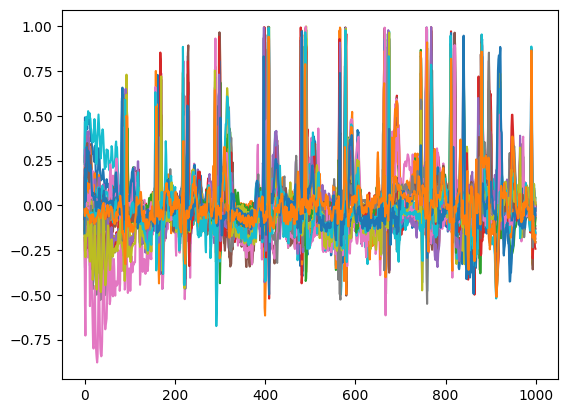

Epoch: 595 | Loss_D: 9.877372576738708e-06 | Loss_G: 11.876209259033203 


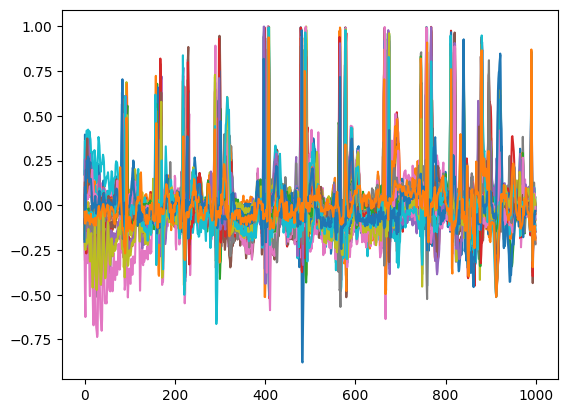

Epoch: 600 | Loss_D: 0.0008310347911901772 | Loss_G: 7.254128932952881 


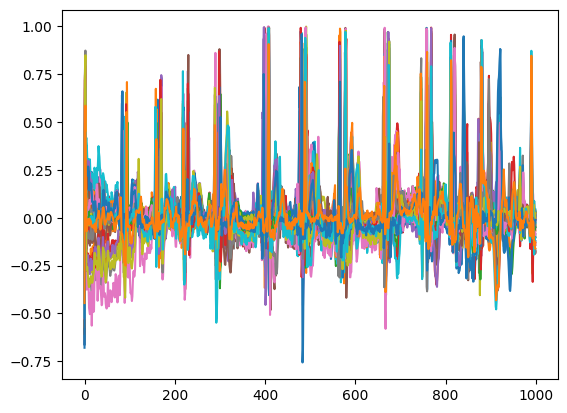

Epoch: 605 | Loss_D: 1.4807632396696135e-05 | Loss_G: 13.430407524108887 


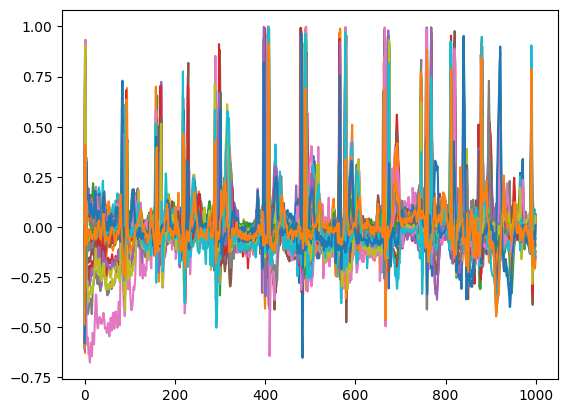

Epoch: 610 | Loss_D: 2.751210195128806e-05 | Loss_G: 10.833975791931152 


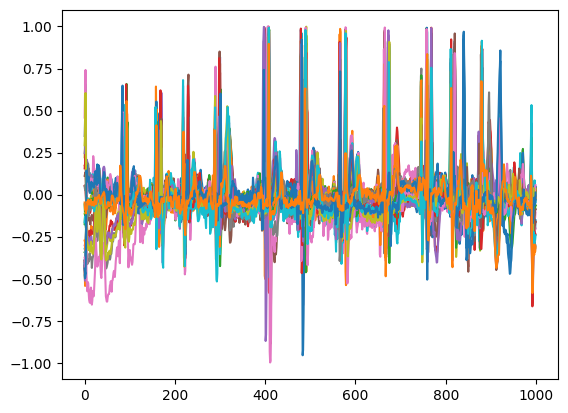

Epoch: 615 | Loss_D: 3.5933130675402936e-06 | Loss_G: 13.919361114501953 


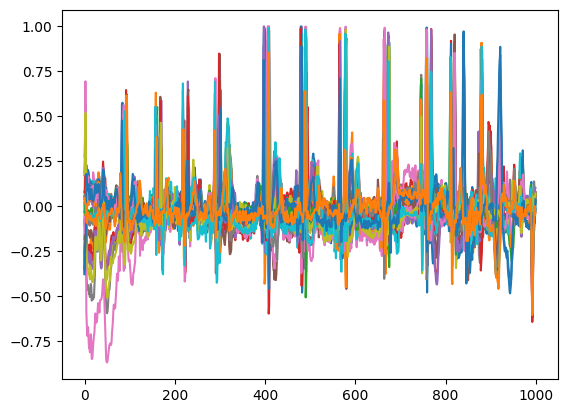

Epoch: 620 | Loss_D: 4.489184357225895e-05 | Loss_G: 10.29779052734375 


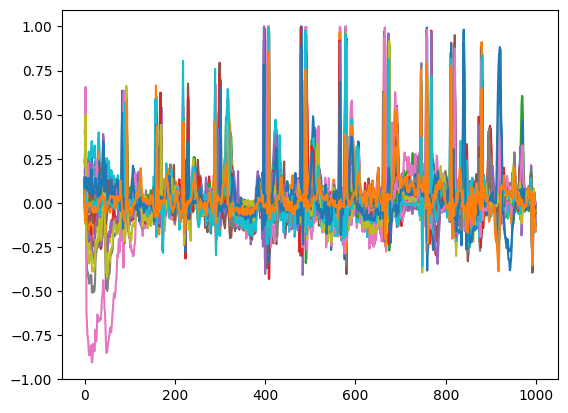

Epoch: 625 | Loss_D: 1.0439393918204587e-05 | Loss_G: 12.185237884521484 


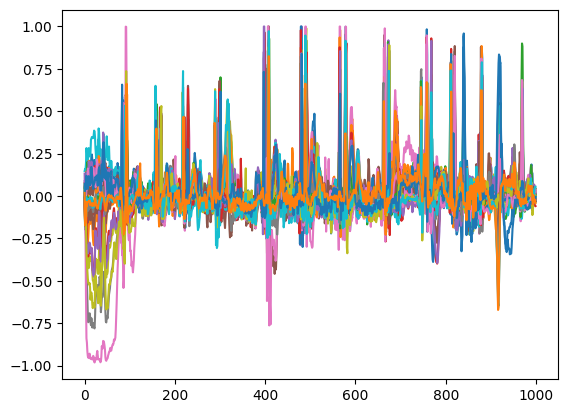

Epoch: 630 | Loss_D: 1.9678323951666243e-05 | Loss_G: 11.299528121948242 


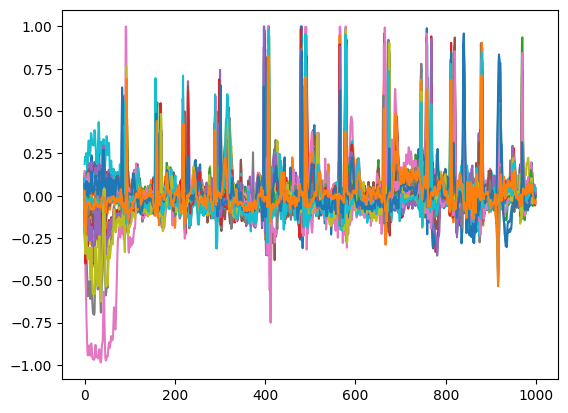

Epoch: 635 | Loss_D: 1.691113538981881e-05 | Loss_G: 13.740398406982422 


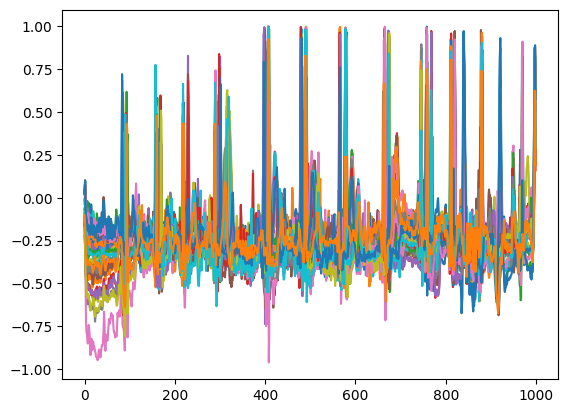

Epoch: 640 | Loss_D: 7.4761533142009284e-06 | Loss_G: 13.446660041809082 


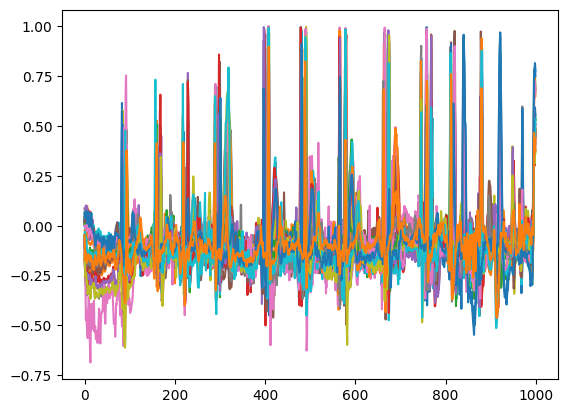

Epoch: 645 | Loss_D: 0.001956375315785408 | Loss_G: 6.648383140563965 


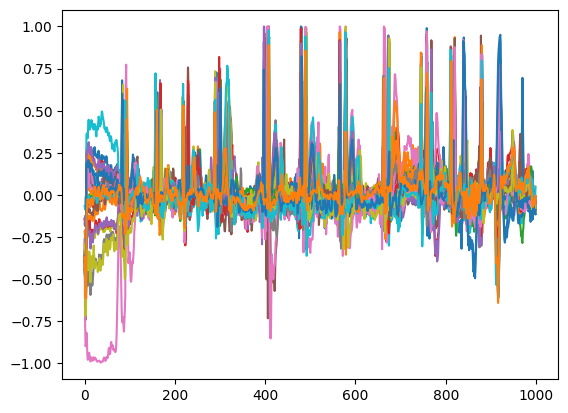

Epoch: 650 | Loss_D: 2.113426489813719e-05 | Loss_G: 11.33858585357666 


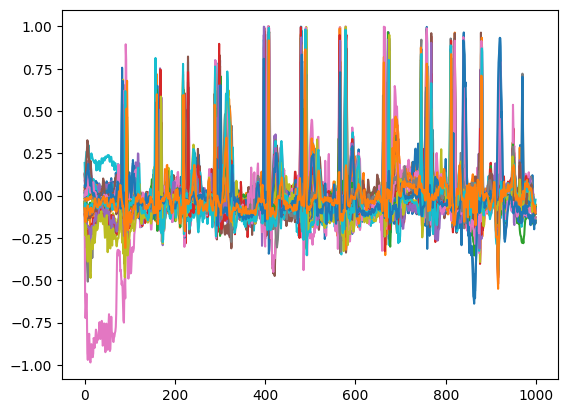

Epoch: 655 | Loss_D: 7.450602424796671e-06 | Loss_G: 12.95422077178955 


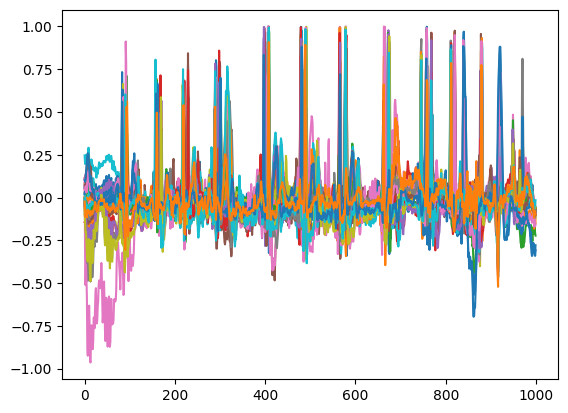

Epoch: 660 | Loss_D: 0.0011958996765315533 | Loss_G: 6.959127426147461 


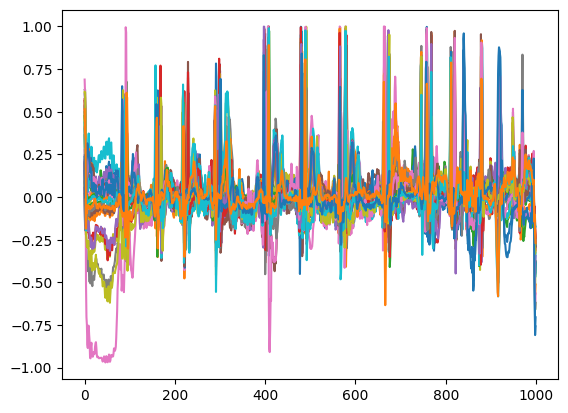

Epoch: 665 | Loss_D: 0.00010996152559528127 | Loss_G: 9.39993953704834 


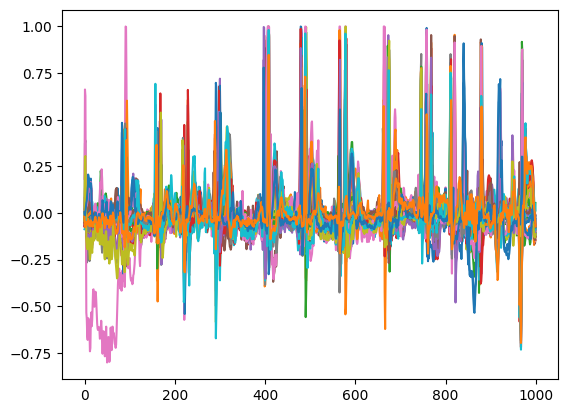

Epoch: 670 | Loss_D: 2.8772414225386456e-05 | Loss_G: 10.926309585571289 


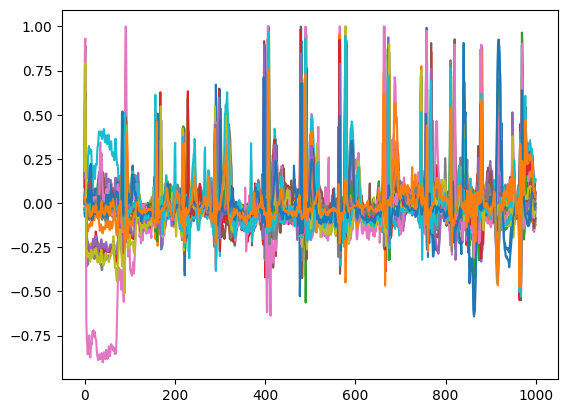

Epoch: 675 | Loss_D: 2.352705087105278e-05 | Loss_G: 10.942922592163086 


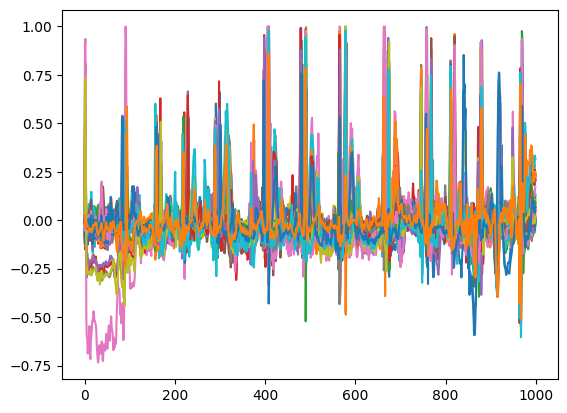

Epoch: 680 | Loss_D: 1.8596998415887356e-05 | Loss_G: 11.6104097366333 


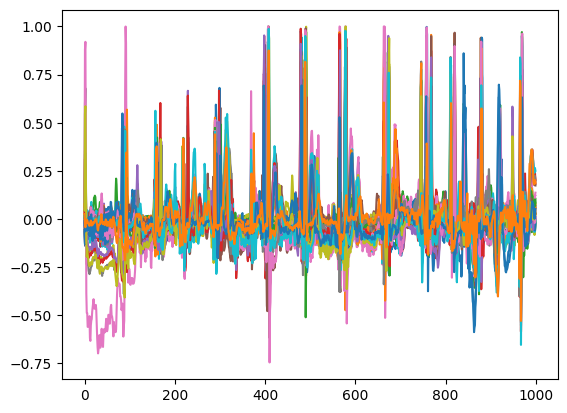

Epoch: 685 | Loss_D: 4.666211680159904e-06 | Loss_G: 13.558920860290527 


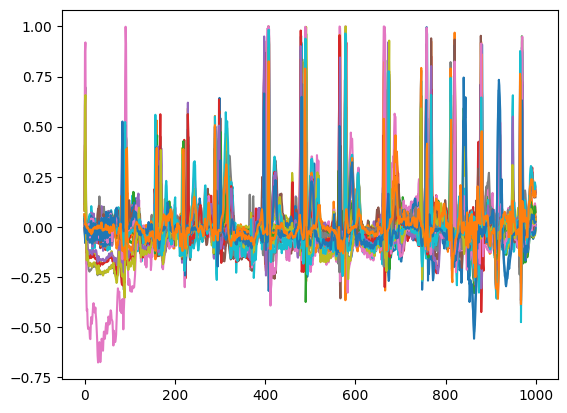

Epoch: 690 | Loss_D: 1.887787766463589e-05 | Loss_G: 11.278021812438965 


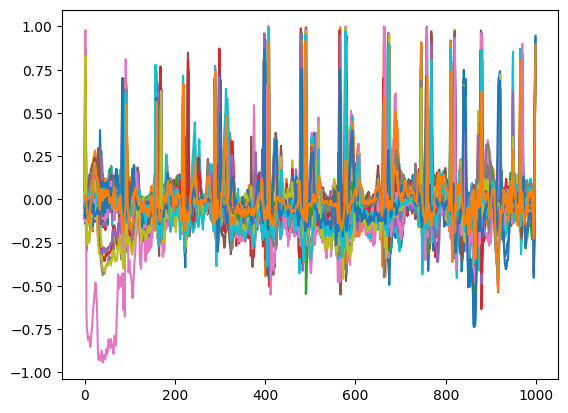

Epoch: 695 | Loss_D: 2.9546927180490457e-06 | Loss_G: 15.54979133605957 


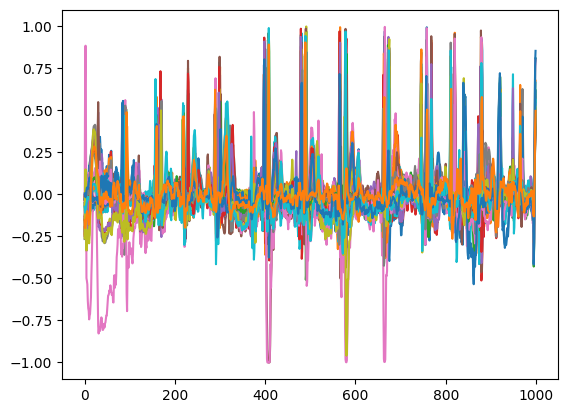

Epoch: 700 | Loss_D: 2.358643996558385e-06 | Loss_G: 15.412114143371582 


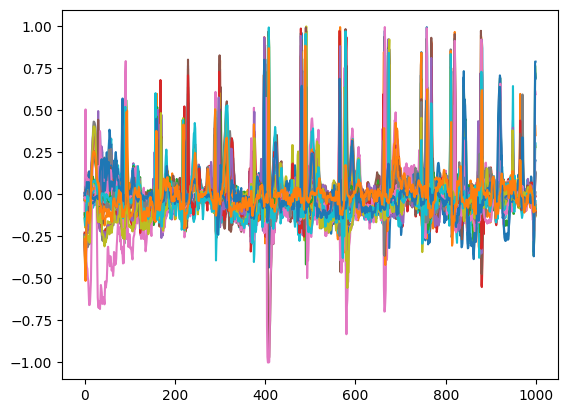

Epoch: 705 | Loss_D: 2.912115633080248e-06 | Loss_G: 13.667856216430664 


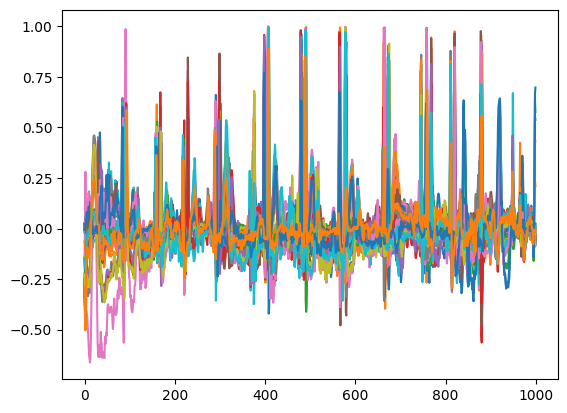

Epoch: 710 | Loss_D: 0.00012449281348381191 | Loss_G: 9.428297996520996 


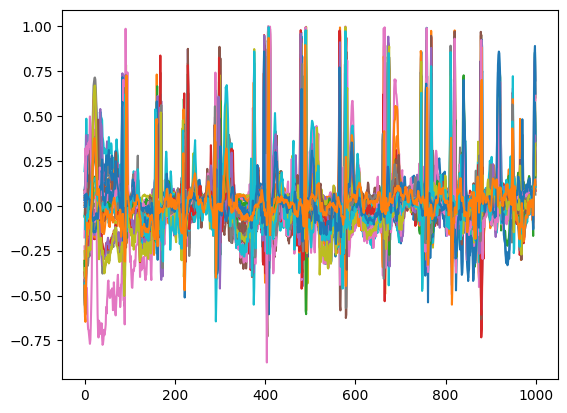

Epoch: 715 | Loss_D: 3.4996498925465858e-06 | Loss_G: 14.736108779907227 


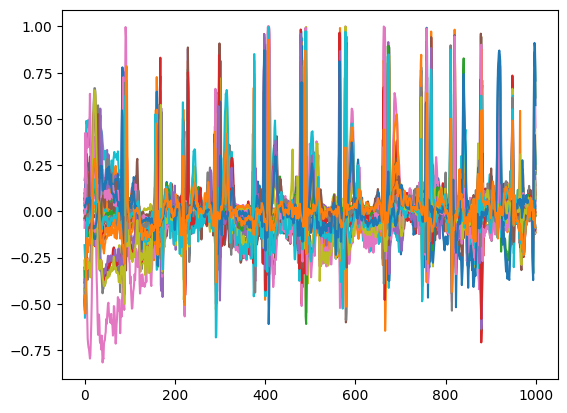

Epoch: 720 | Loss_D: 2.435277565382421e-06 | Loss_G: 14.11610221862793 


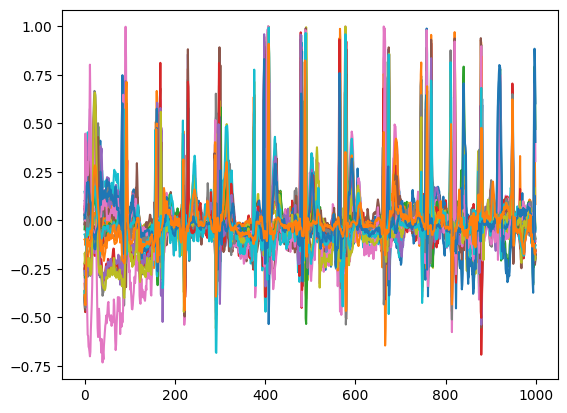

Epoch: 725 | Loss_D: 1.745565896271728e-06 | Loss_G: 14.896957397460938 


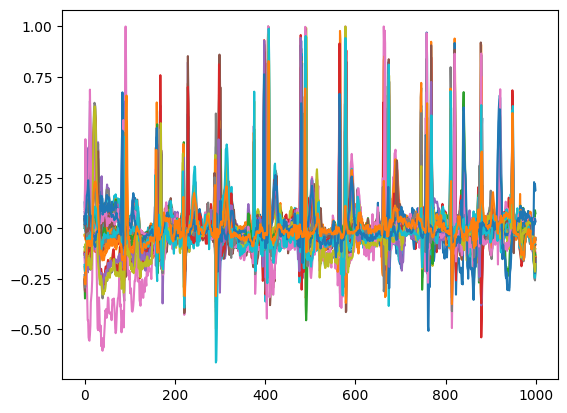

Epoch: 730 | Loss_D: 6.811961839048308e-07 | Loss_G: 15.505786895751953 


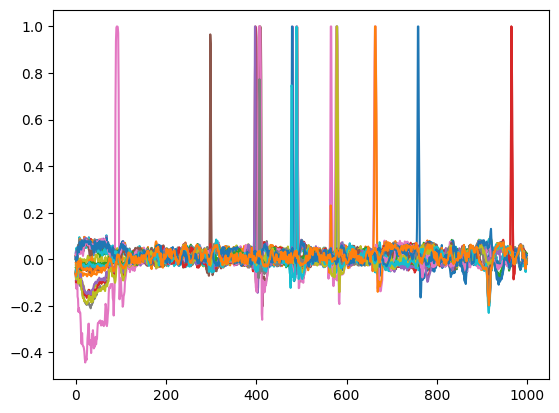

Epoch: 735 | Loss_D: 1.7029901755449828e-07 | Loss_G: 16.714275360107422 


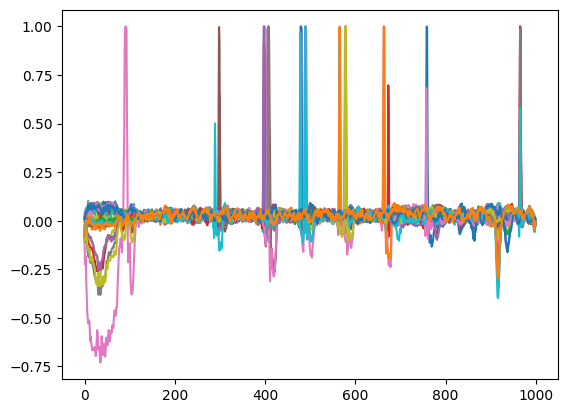

Epoch: 740 | Loss_D: 0.01269541122019291 | Loss_G: 5.062258243560791 


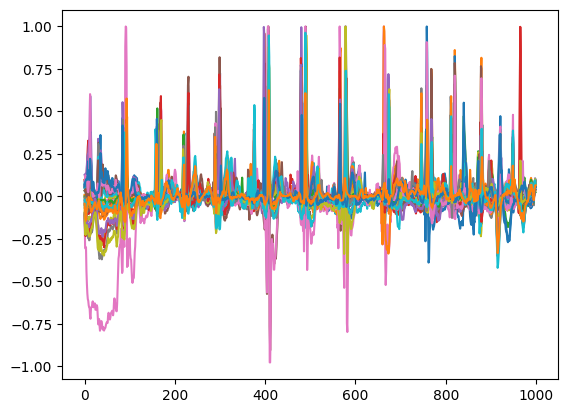

Epoch: 745 | Loss_D: 6.668357673333958e-05 | Loss_G: 10.136186599731445 


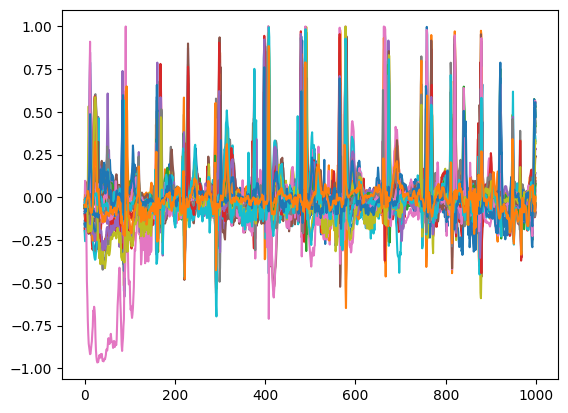

Epoch: 750 | Loss_D: 1.3283329280966427e-06 | Loss_G: 15.238386154174805 


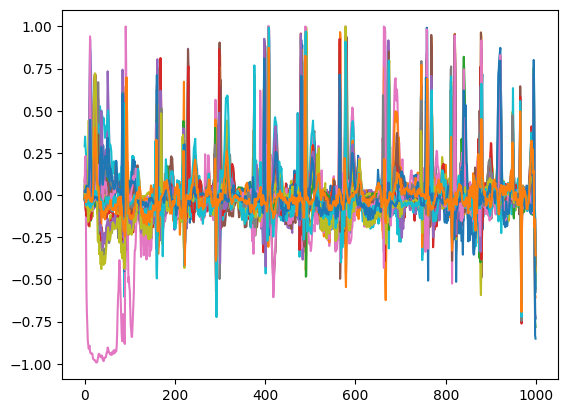

Epoch: 755 | Loss_D: 0.005703958682715893 | Loss_G: 5.3924360275268555 


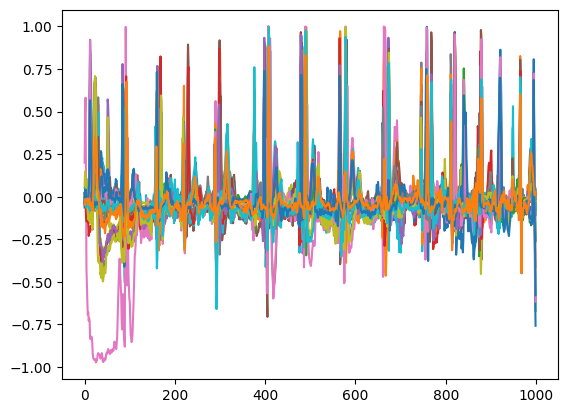

Epoch: 760 | Loss_D: 3.3123210414487403e-06 | Loss_G: 14.335284233093262 


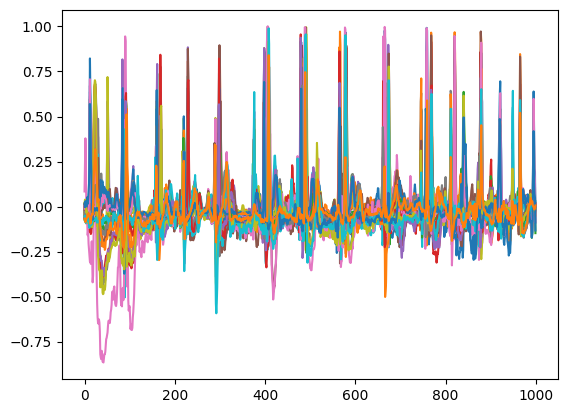

Epoch: 765 | Loss_D: 1.0992842362611555e-05 | Loss_G: 12.83275318145752 


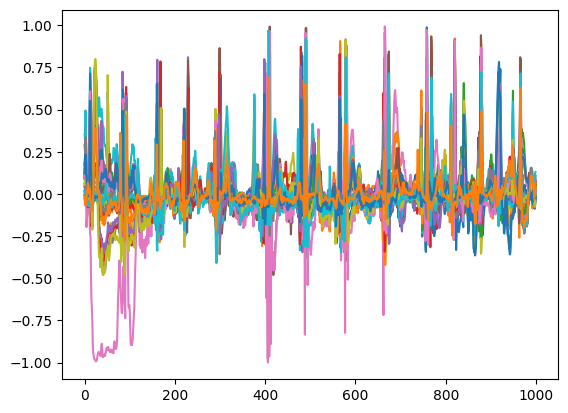

Epoch: 770 | Loss_D: 4.107712447876111e-05 | Loss_G: 13.19021224975586 


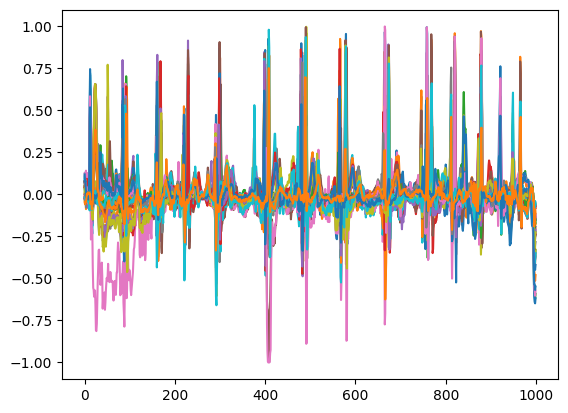

Epoch: 775 | Loss_D: 0.00015773925406392664 | Loss_G: 10.557416915893555 


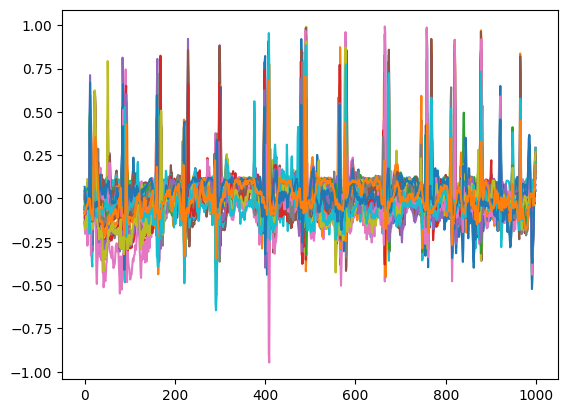

Epoch: 780 | Loss_D: 5.3364652558229864e-05 | Loss_G: 11.828520774841309 


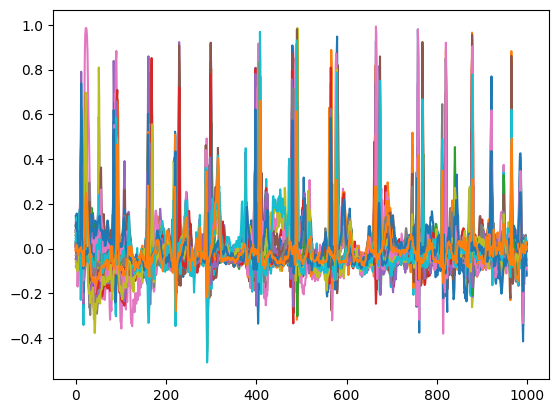

Epoch: 785 | Loss_D: 1.0754460163298063e-05 | Loss_G: 14.713983535766602 


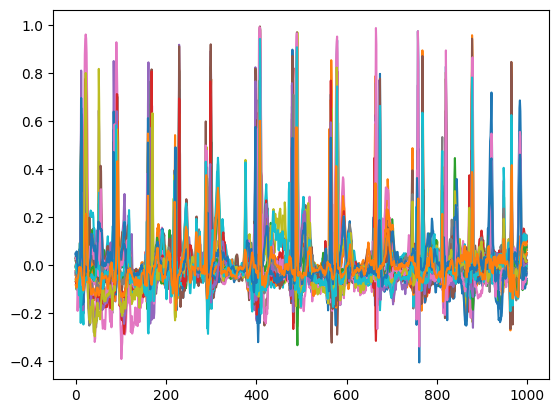

Epoch: 790 | Loss_D: 6.275539817579556e-06 | Loss_G: 14.637965202331543 


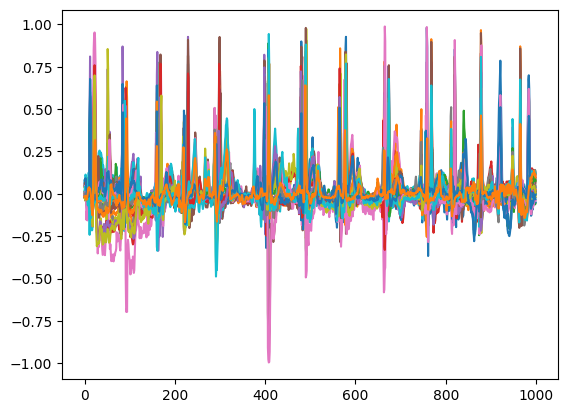

Epoch: 795 | Loss_D: 1.852020068326965e-05 | Loss_G: 13.108165740966797 


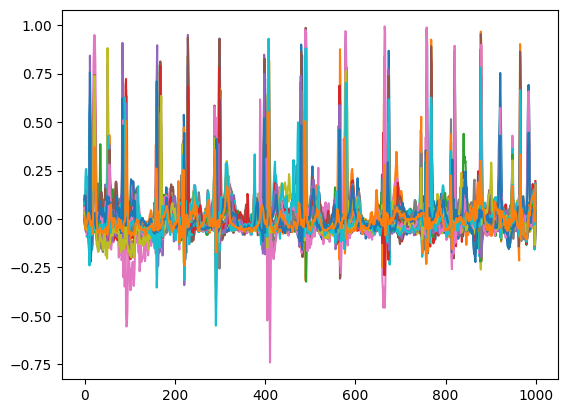

Epoch: 800 | Loss_D: 2.5843115508905612e-05 | Loss_G: 11.407283782958984 


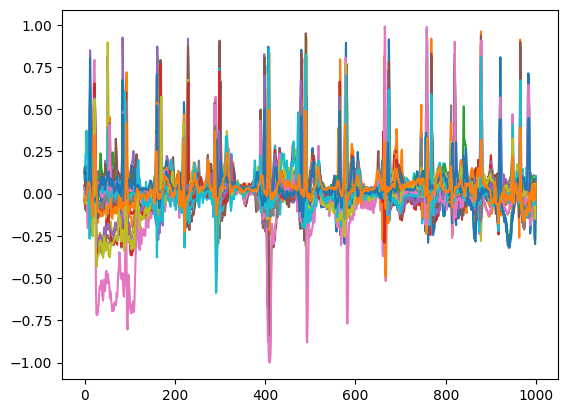

Epoch: 805 | Loss_D: 0.18185029923915863 | Loss_G: 8.899127960205078 


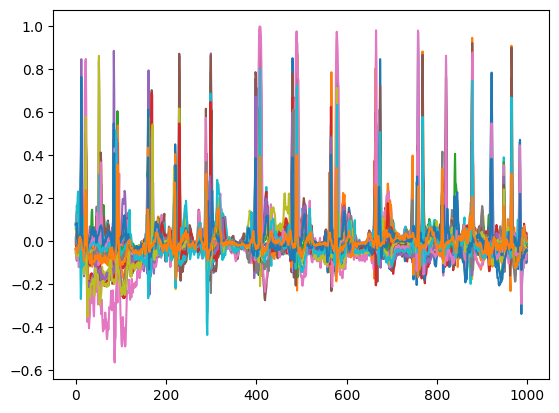

Epoch: 810 | Loss_D: 4.004031143267639e-05 | Loss_G: 13.801183700561523 


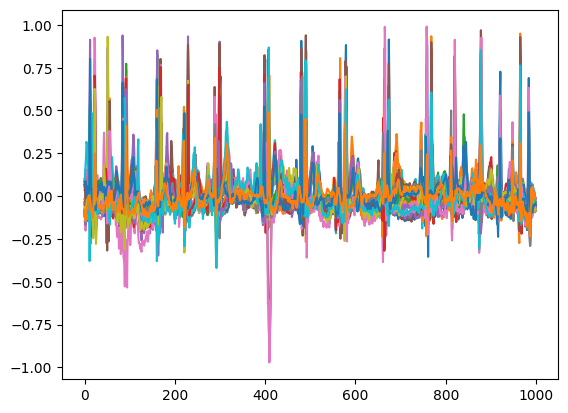

Epoch: 815 | Loss_D: 0.005341074895113707 | Loss_G: 8.734488487243652 


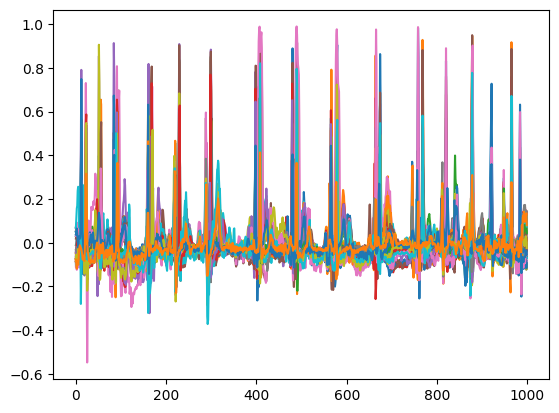

Epoch: 820 | Loss_D: 5.107417382532731e-05 | Loss_G: 11.44890308380127 


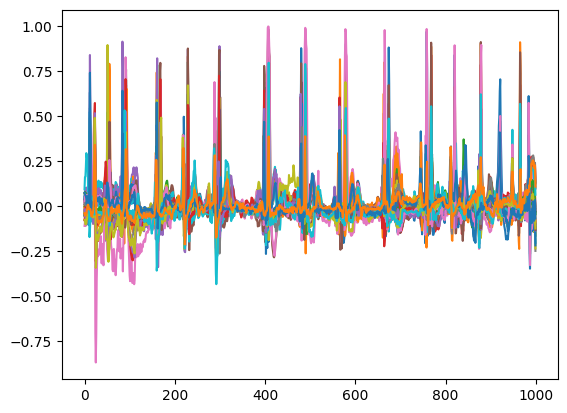

Epoch: 825 | Loss_D: 0.014995258301496506 | Loss_G: 5.4443135261535645 


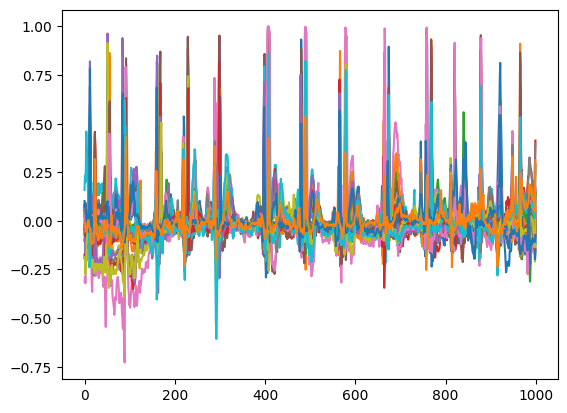

Epoch: 830 | Loss_D: 1.2329720448178705e-05 | Loss_G: 13.318866729736328 


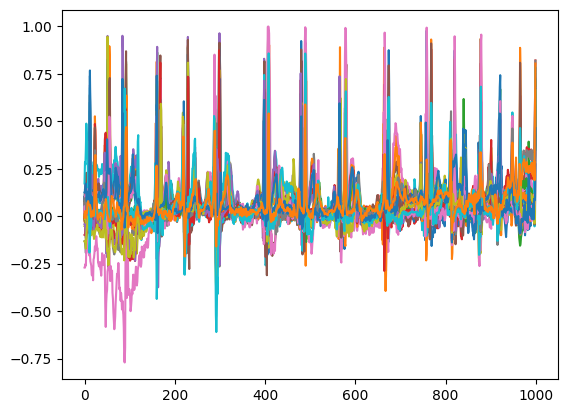

Epoch: 835 | Loss_D: 9.272818715544418e-06 | Loss_G: 13.202902793884277 


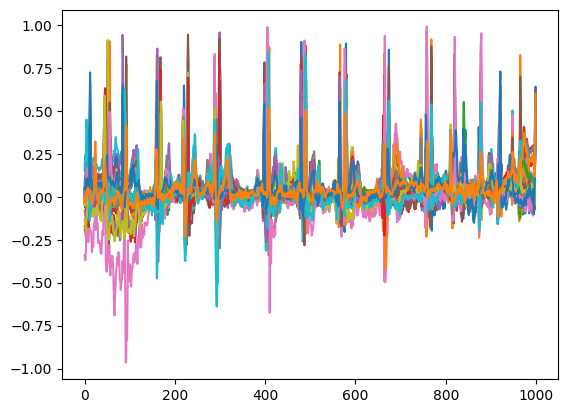

Epoch: 840 | Loss_D: 0.0005640605231747031 | Loss_G: 8.129779815673828 


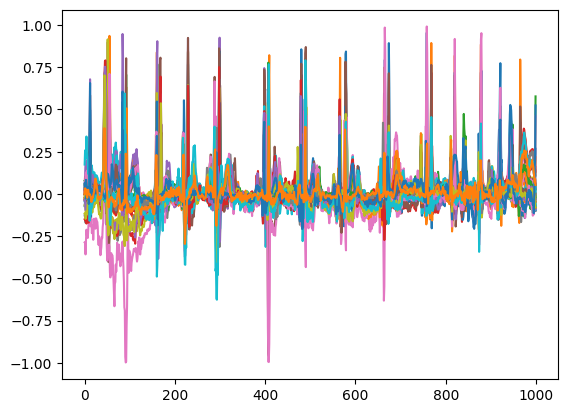

Epoch: 845 | Loss_D: 1.311312553298194e-05 | Loss_G: 14.595643043518066 


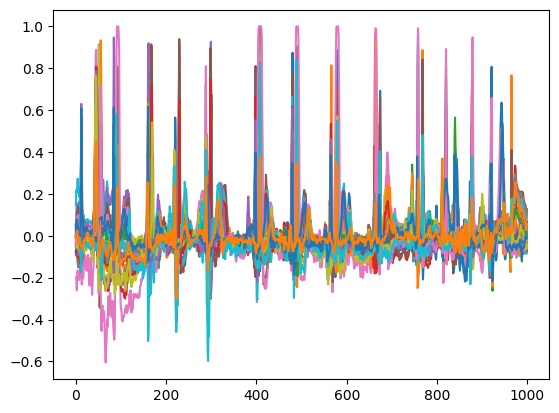

Epoch: 850 | Loss_D: 0.0005173940444365144 | Loss_G: 8.905527114868164 


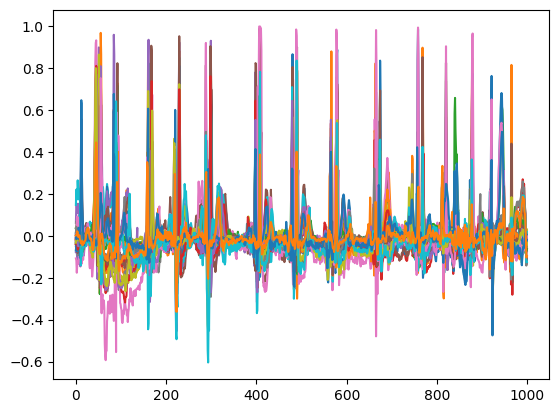

Epoch: 855 | Loss_D: 9.306883839599323e-06 | Loss_G: 13.72704792022705 


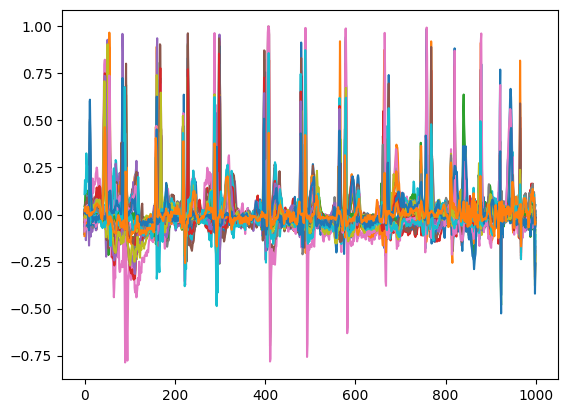

Epoch: 860 | Loss_D: 7.050402018649038e-06 | Loss_G: 12.980327606201172 


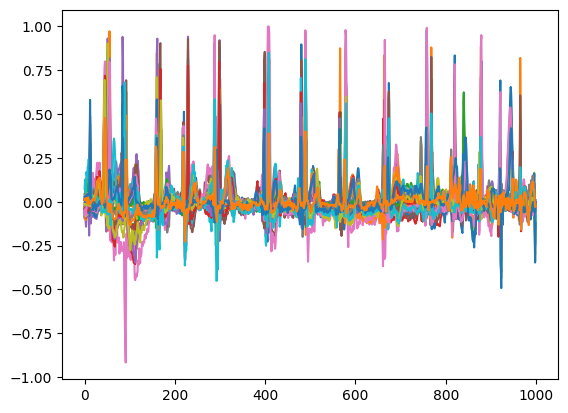

Epoch: 865 | Loss_D: 2.2479498511529528e-06 | Loss_G: 15.348627090454102 


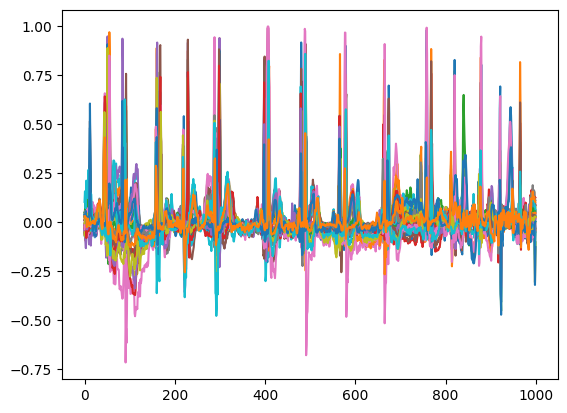

Epoch: 870 | Loss_D: 7.051579450489953e-05 | Loss_G: 9.926745414733887 


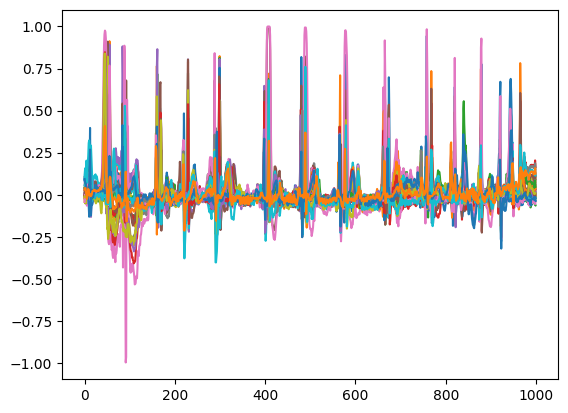

Epoch: 875 | Loss_D: 8.974800948635675e-06 | Loss_G: 12.655447959899902 


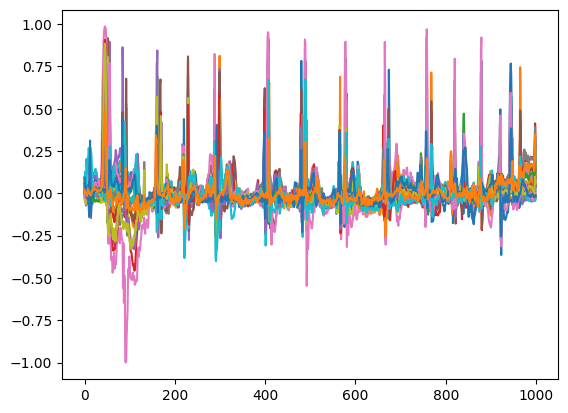

Epoch: 880 | Loss_D: 9.009316272567958e-05 | Loss_G: 11.309464454650879 


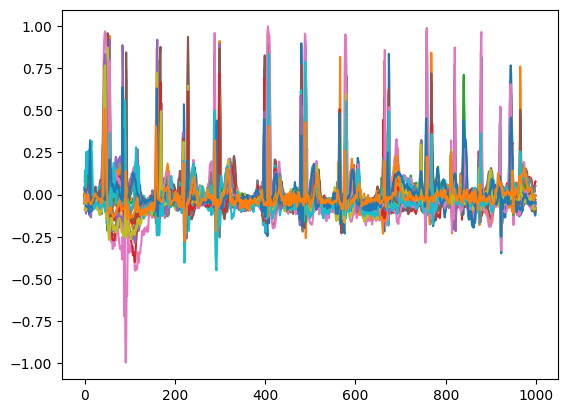

Epoch: 885 | Loss_D: 1.5105667444004212e-05 | Loss_G: 14.139152526855469 


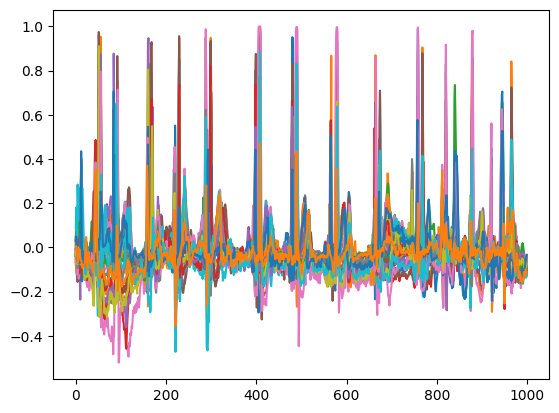

Epoch: 890 | Loss_D: 6.428804226743523e-06 | Loss_G: 13.218857765197754 


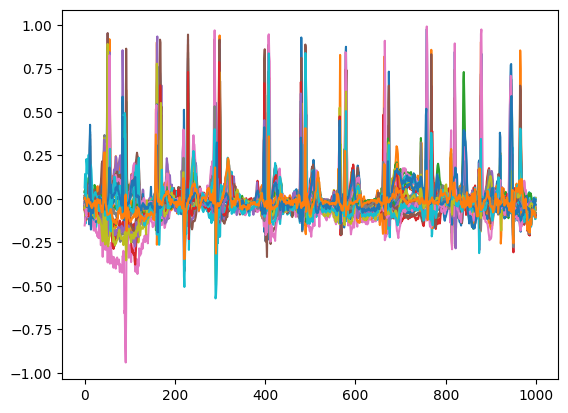

Epoch: 895 | Loss_D: 1.0371260941610672e-05 | Loss_G: 13.438916206359863 


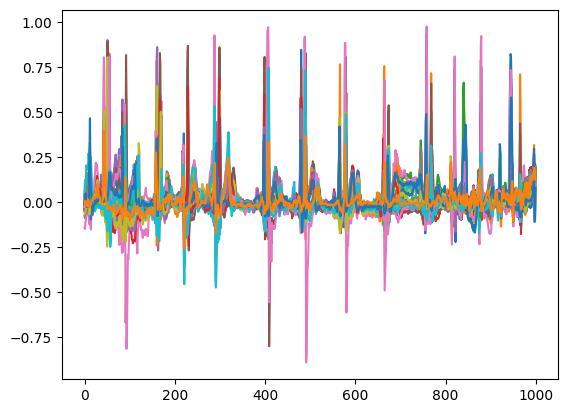

Epoch: 900 | Loss_D: 8.924830035539344e-05 | Loss_G: 9.985591888427734 


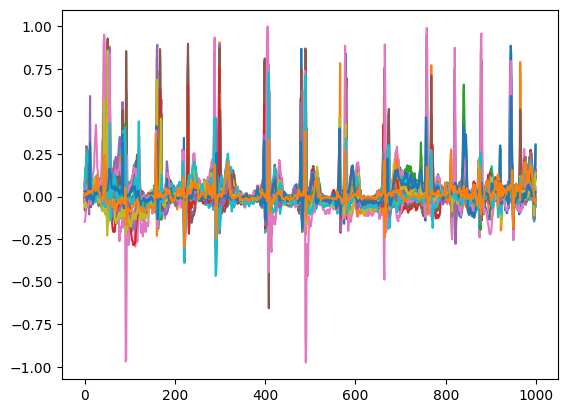

Epoch: 905 | Loss_D: 2.00528356799623e-05 | Loss_G: 11.62442398071289 


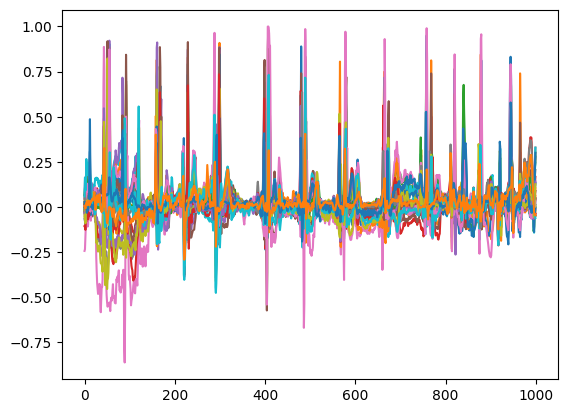

Epoch: 910 | Loss_D: 4.325603185861837e-06 | Loss_G: 14.203790664672852 


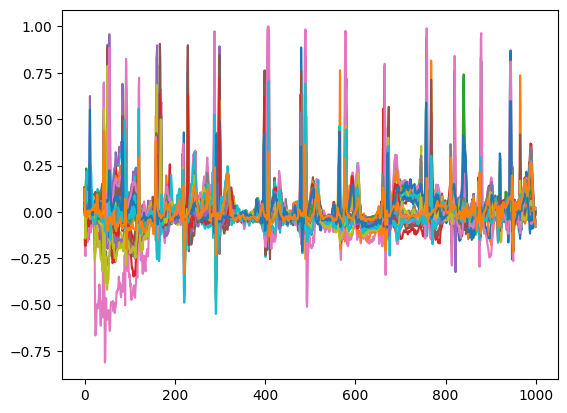

Epoch: 915 | Loss_D: 8.131803951982874e-06 | Loss_G: 13.567902565002441 


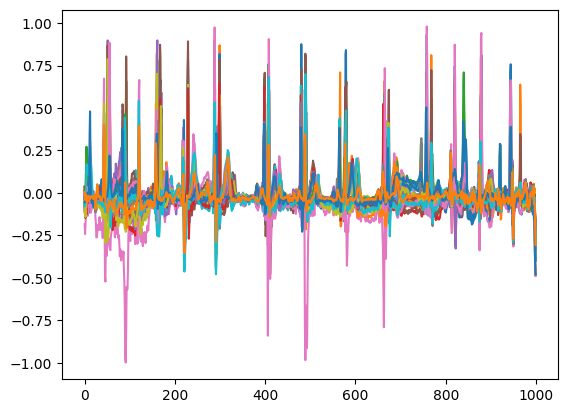

Epoch: 920 | Loss_D: 1.1231271855649538e-05 | Loss_G: 12.561739921569824 


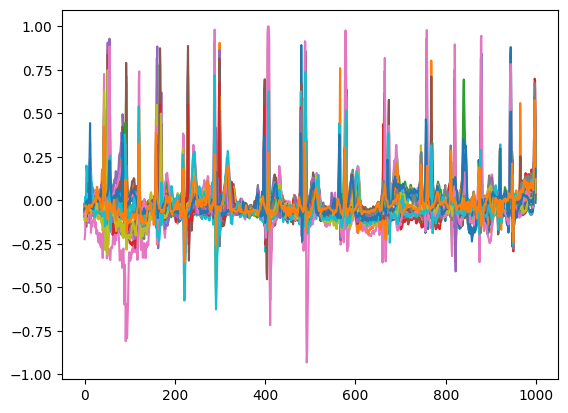

Epoch: 925 | Loss_D: 6.658709025941789e-06 | Loss_G: 13.05936050415039 


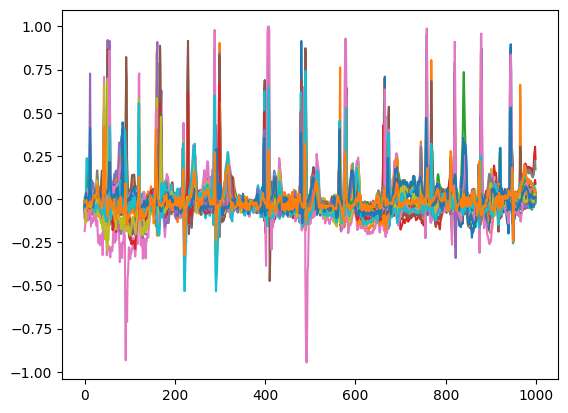

Epoch: 930 | Loss_D: 3.3038054425560404e-06 | Loss_G: 14.096489906311035 


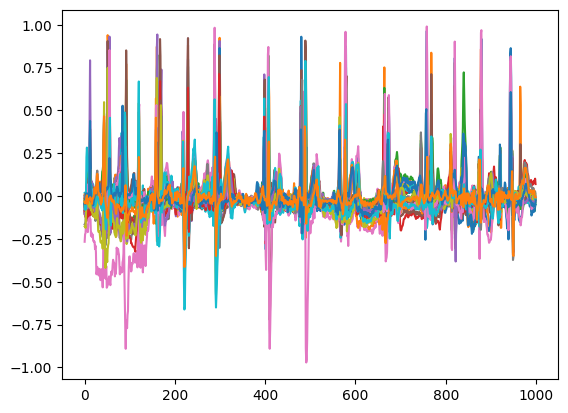

Epoch: 935 | Loss_D: 8.634189725853503e-06 | Loss_G: 12.243063926696777 


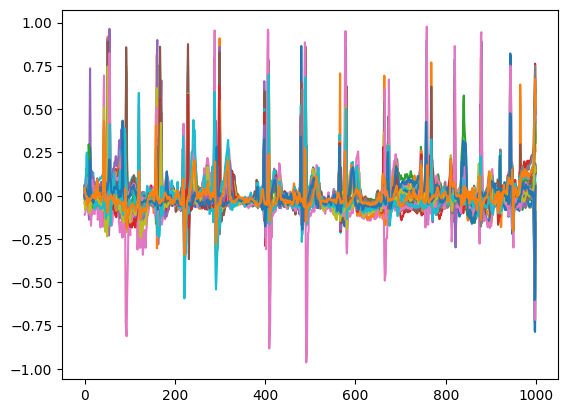

Epoch: 940 | Loss_D: 2.7478046831674874e-05 | Loss_G: 10.885448455810547 


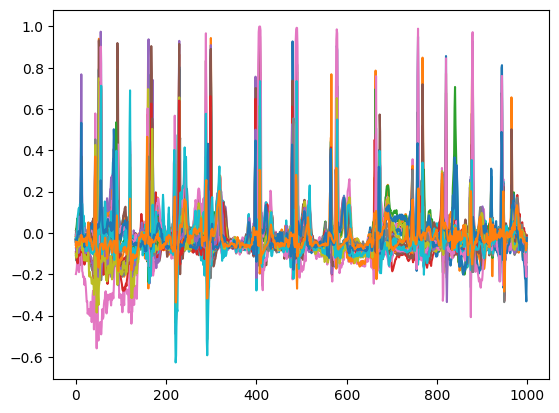

Epoch: 945 | Loss_D: 4.9131340347230434e-06 | Loss_G: 13.073848724365234 


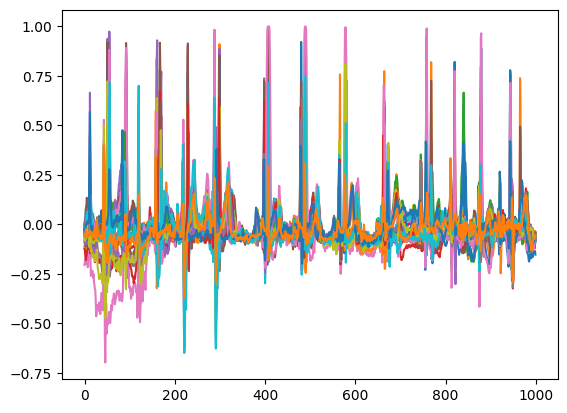

Epoch: 950 | Loss_D: 1.7276988728553988e-05 | Loss_G: 13.777359962463379 


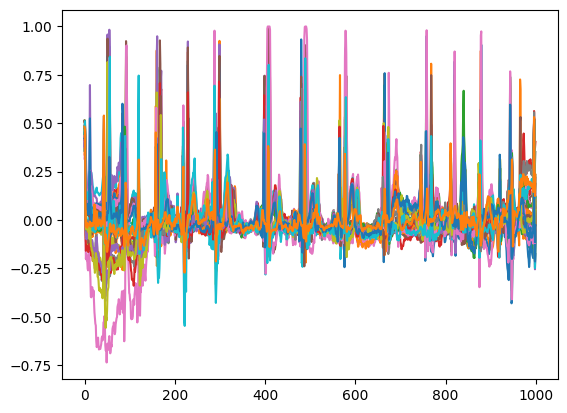

Epoch: 955 | Loss_D: 6.003058842907194e-06 | Loss_G: 14.152485847473145 


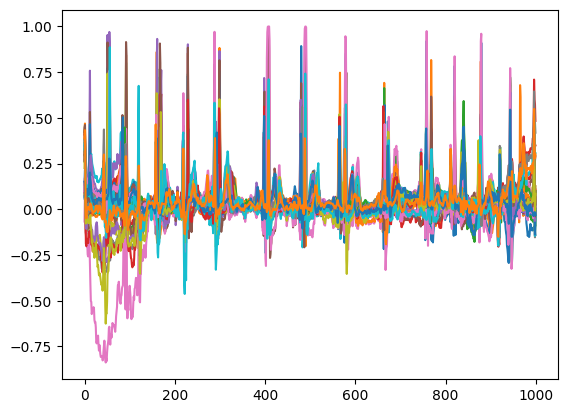

Epoch: 960 | Loss_D: 9.2983564172755e-06 | Loss_G: 12.559779167175293 


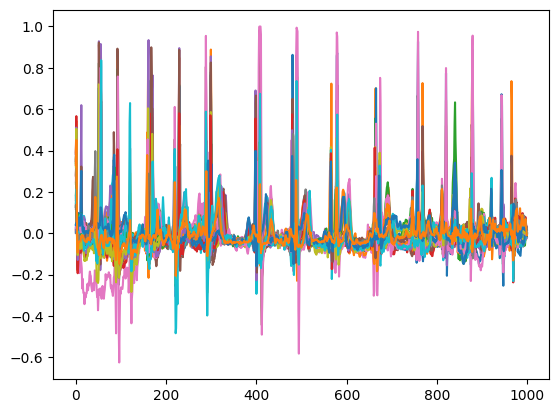

Epoch: 965 | Loss_D: 4.998287749913288e-06 | Loss_G: 13.965790748596191 


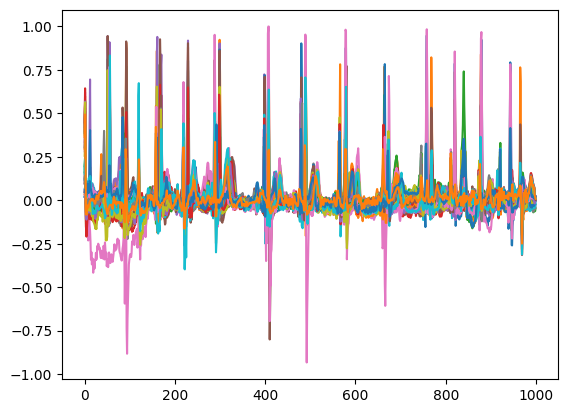

Epoch: 970 | Loss_D: 3.5677696814673254e-06 | Loss_G: 14.043750762939453 


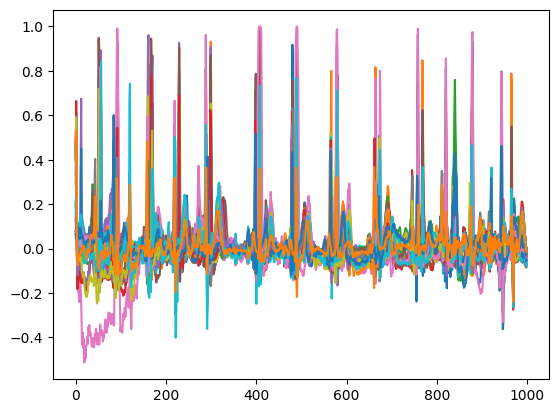

Epoch: 975 | Loss_D: 0.00020455056801438332 | Loss_G: 9.206953048706055 


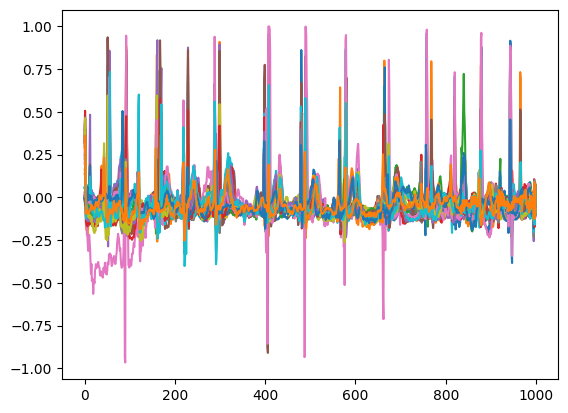

Epoch: 980 | Loss_D: 6.0605980252148584e-05 | Loss_G: 11.207914352416992 


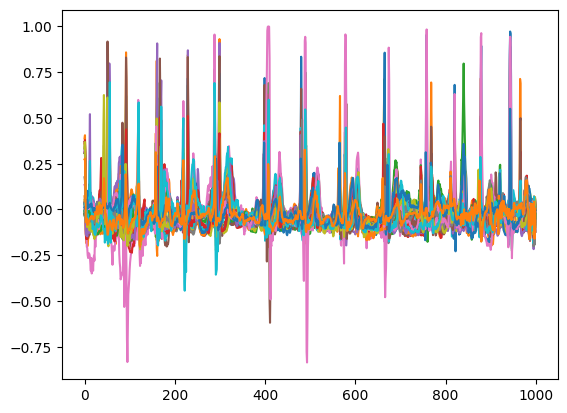

Epoch: 985 | Loss_D: 1.0797124559758231e-05 | Loss_G: 13.664899826049805 


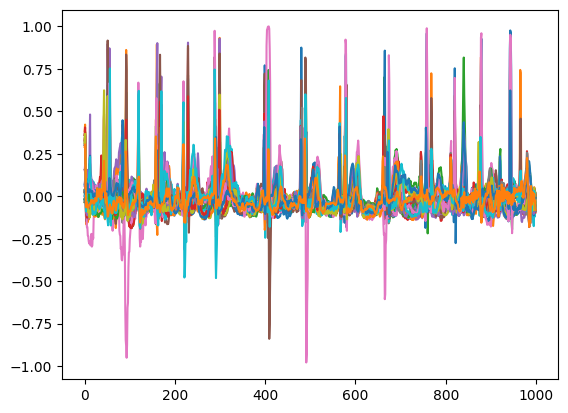

Epoch: 990 | Loss_D: 4.504423941398272e-06 | Loss_G: 13.928925514221191 


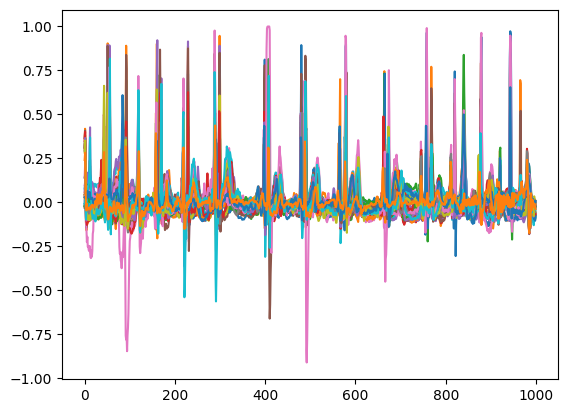

Epoch: 995 | Loss_D: 0.0002915470686275512 | Loss_G: 8.220244407653809 


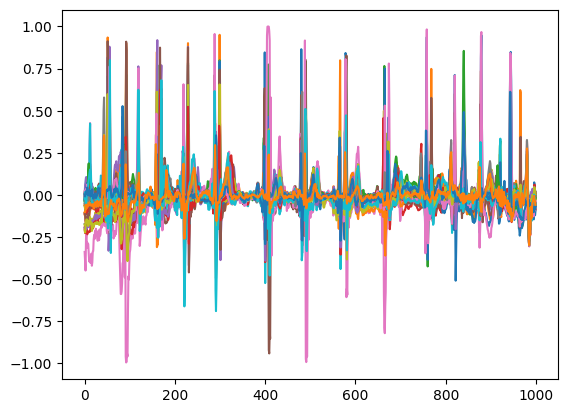

In [59]:
trainer = Trainer(
    generator=g,
    discriminator=d,
    batch_size=32,
    num_epochs=1000,
    label=1
)
trainer.run()

In [ ]:
import torch
torch.cuda.is_available()

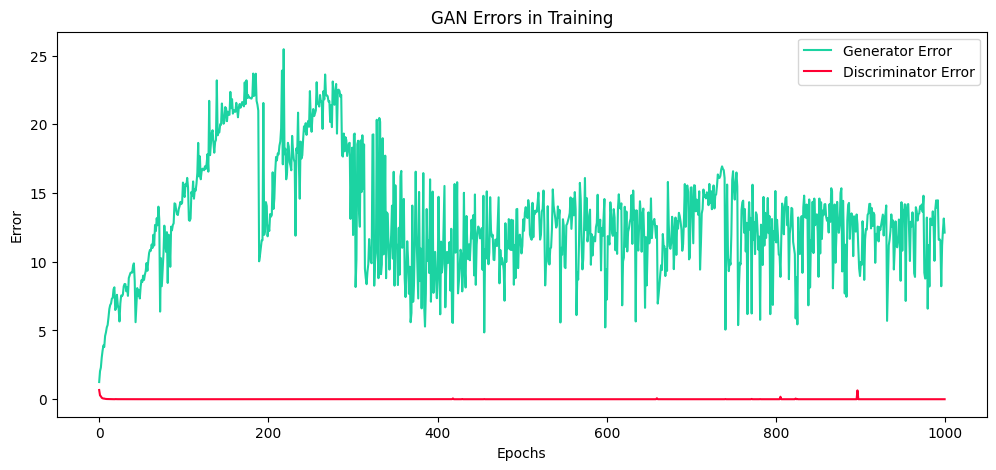

In [60]:
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 5))
plt.title("GAN Errors in Training")
plt.plot(trainer.g_errors, label='Generator Error', c='#1CD3A2')
plt.plot(trainer.d_errors, label='Discriminator Error', c='#FF0033')
plt.xlabel("Epochs")
plt.ylabel('Error')
_ = plt.legend()
plt.savefig('Gan_Losses 7.png', facecolor='w', edgecolor='w', format='png',
        transparent=False, bbox_inches='tight', pad_inches=0.1)
plt.savefig('Gan_Losses 7.svg', facecolor='w', edgecolor='w', format='svg',
        transparent=False, bbox_inches='tight', pad_inches=0.1)
plt.show()

In [47]:
noise = torch.randn(96, 1, 1000, device=device)

In [ ]:
g.to(device)
g.load_state_dict(torch.load('./weights/1/generator.pth'))
g.eval()

In [48]:
fake = g(noise)
fake.shape

torch.Size([96, 1, 1000])

In [49]:
index = np.random.choice(fake.shape[0], 1, replace=False) 
synthetic_samples = fake.detach().cpu().squeeze(1).numpy()[0].transpose()

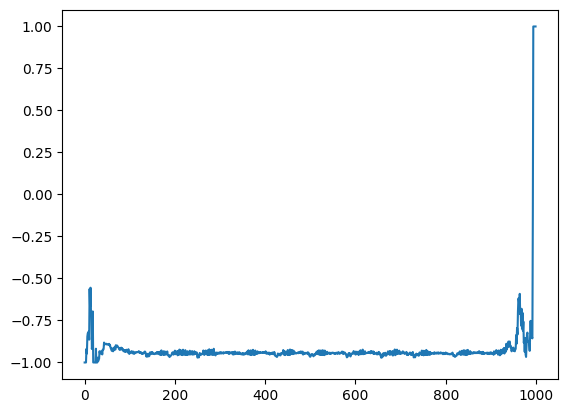

In [50]:
plt.plot(synthetic_samples)
plt.show()

tensor([[[-0.1190, -0.1160, -0.1200,  ...,  0.0690,  0.0860,  0.0220]],

        [[ 0.0040, -0.0200, -0.0530,  ...,  0.1210, -0.3260, -0.3480]],

        [[-0.0290, -0.0350, -0.0540,  ..., -0.0290, -0.0480, -0.0490]],

        ...,

        [[-0.0650, -0.0670, -0.0730,  ..., -0.0490, -0.0580, -0.0580]],

        [[ 0.1510,  0.1230,  0.0970,  ..., -0.1310, -0.1430, -0.1320]],

        [[ 0.2650,  0.2630,  0.2420,  ...,  0.2740,  0.2160,  0.1750]]],
       device='cuda:0')


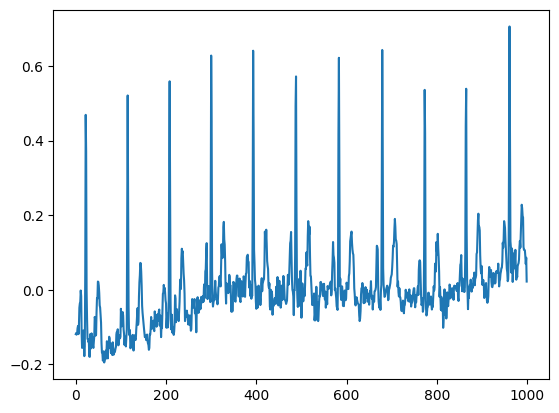

tensor([[[ 0.0340,  0.0350,  0.0410,  ..., -0.1050, -0.0840,  0.2790]],

        [[-0.0140, -0.0080, -0.0050,  ..., -0.0850, -0.0780,  0.0020]],

        [[ 0.0100,  0.0100,  0.0140,  ..., -0.0810, -0.0720, -0.0810]],

        ...,

        [[-0.0390, -0.0360, -0.0440,  ..., -0.0540, -0.0630, -0.0490]],

        [[ 0.0930,  0.1090,  0.1200,  ..., -0.0450, -0.0450, -0.0470]],

        [[ 0.0360,  0.0640,  0.0590,  ..., -0.0930, -0.0710, -0.0600]]],
       device='cuda:0')


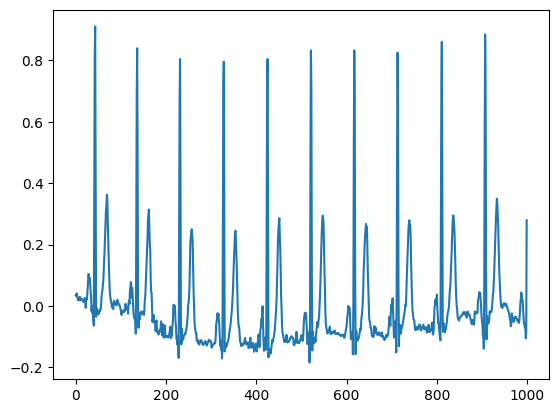

tensor([[[-0.0900, -0.0910, -0.0880,  ...,  0.0950,  0.1390,  0.1620]],

        [[ 0.0350,  0.0310,  0.0120,  ..., -0.0610, -0.0610, -0.0730]],

        [[-0.1250, -0.1230, -0.1210,  ...,  0.1800,  0.1420,  0.1190]],

        ...,

        [[-0.0390, -0.0300, -0.0180,  ..., -0.1010, -0.0960, -0.0740]],

        [[ 0.4030,  0.3770,  0.2920,  ...,  0.3420,  0.3470,  0.3260]],

        [[-0.0380, -0.0640, -0.0730,  ...,  0.0200,  0.0200,  0.0250]]],
       device='cuda:0')


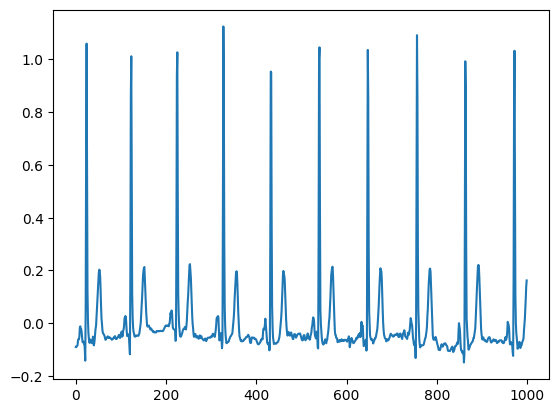

tensor([[[-0.2150, -0.1540,  0.2940,  ...,  0.0930,  0.0870,  0.0730]],

        [[ 0.1550,  0.1480,  0.1400,  ...,  0.0680,  0.0320,  0.0040]],

        [[ 0.0510, -0.0030,  0.0020,  ...,  0.0650,  0.0630,  0.0550]],

        ...,

        [[ 0.0750,  0.0780,  0.0840,  ...,  0.1030,  0.0230, -0.0290]],

        [[-0.0700, -0.0700, -0.0700,  ..., -0.1390, -0.1370, -0.1290]],

        [[-0.2320, -0.2440, -0.2150,  ..., -0.1970, -0.0170,  0.2680]]],
       device='cuda:0')


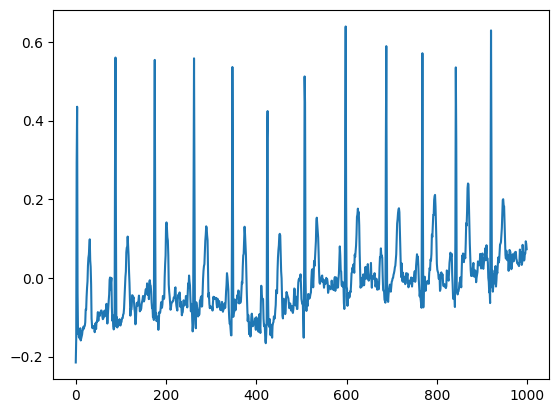

tensor([[[ 0.5050,  0.6870,  0.5650,  ...,  0.0250,  0.0080, -0.0210]],

        [[ 0.0680,  0.0730,  0.0920,  ..., -0.0360,  0.0090,  0.5020]],

        [[-0.2210, -0.2750, -0.2620,  ...,  0.0260,  0.0360,  0.0450]],

        ...,

        [[ 0.0640,  0.0400, -0.0110,  ..., -0.5730, -0.6070, -0.5760]],

        [[ 0.0330, -0.0060, -0.0330,  ...,  0.0220, -0.0560, -0.3500]],

        [[-0.2020, -0.1610, -0.1520,  ..., -0.1290, -0.0630, -0.0540]]],
       device='cuda:0')


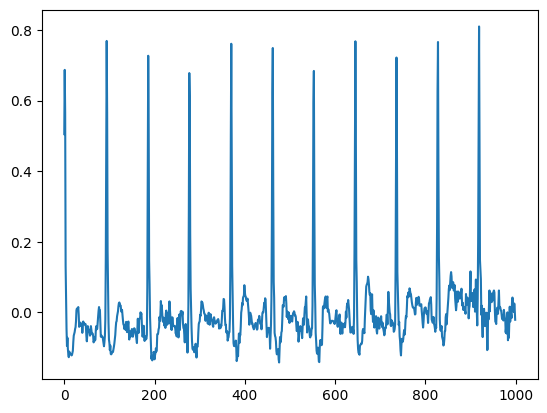

tensor([[[ 0.3410,  0.1760, -0.0320,  ..., -0.0210, -0.0510, -0.0730]],

        [[-0.0500, -0.0470, -0.0450,  ..., -0.0950, -0.1030, -0.0920]],

        [[-0.0150, -0.0160, -0.0170,  ...,  0.1410,  0.1800,  0.1980]],

        ...,

        [[ 0.1450,  0.1510,  0.1510,  ...,  0.0390,  0.0620,  0.0860]],

        [[-0.0750, -0.0730, -0.0690,  ..., -0.0240, -0.0290, -0.0380]],

        [[ 0.0480,  0.0320,  0.0120,  ..., -0.0130,  0.0030,  0.0020]]],
       device='cuda:0')


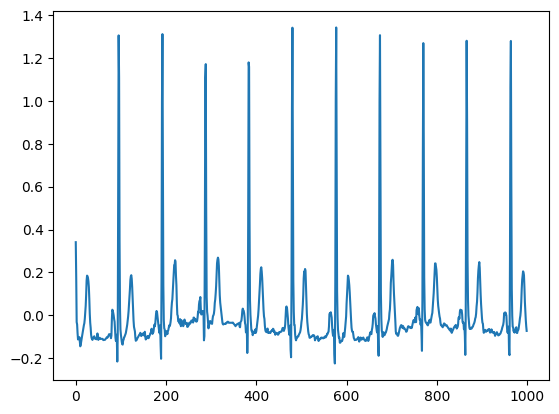

tensor([[[ 0.0300,  0.0350,  0.0350,  ..., -0.0480, -0.0450, -0.0440]],

        [[ 0.0450,  0.0450,  0.0350,  ..., -0.0800, -0.0810, -0.0770]],

        [[-0.0400, -0.0440, -0.0470,  ..., -0.1250, -0.0590, -0.0880]],

        ...,

        [[-0.1250, -0.1230, -0.1200,  ..., -0.0230,  0.0130,  0.0370]],

        [[-0.0780, -0.0450,  0.0100,  ...,  0.0810,  0.0540,  0.1200]],

        [[ 0.0100,  0.0020, -0.0020,  ...,  0.0040, -0.1650, -0.1010]]],
       device='cuda:0')


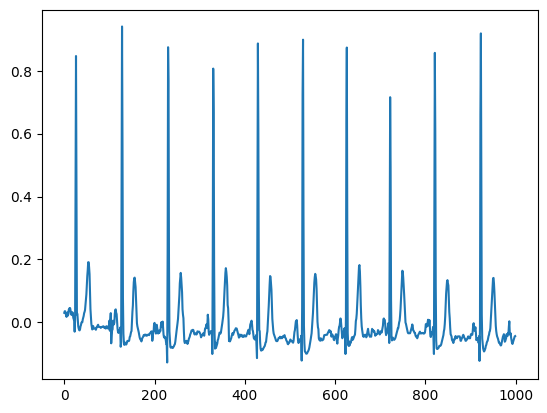

tensor([[[-0.0220, -0.0320, -0.0300,  ...,  0.0590, -0.0500,  0.0360]],

        [[ 0.0790,  0.0810,  0.0750,  ...,  0.0840,  0.6920,  0.7880]],

        [[ 0.0970,  0.0790,  0.0610,  ...,  0.1040,  0.1120,  0.1080]],

        ...,

        [[ 0.0170,  0.0250,  0.0340,  ...,  0.1390,  0.6610,  0.7540]],

        [[ 0.0350,  0.0350,  0.0350,  ..., -0.0050, -0.1030, -0.2650]],

        [[-0.0700, -0.1000, -0.1010,  ...,  0.1470,  0.0980,  0.0720]]],
       device='cuda:0')


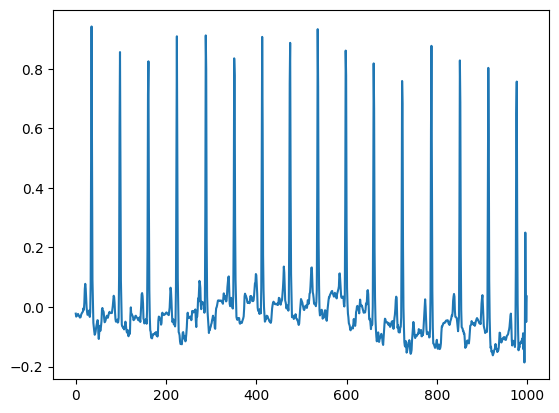

tensor([[[-0.0050,  0.0110,  0.0620,  ...,  0.2360,  0.2160,  0.1440]],

        [[-0.2550, -0.2580, -0.2650,  ..., -0.0610, -0.1380, -0.2100]],

        [[-0.1480, -0.1440, -0.1620,  ...,  0.0110,  0.0090,  0.0340]],

        ...,

        [[-0.0020, -0.0150, -0.0690,  ..., -0.0330, -0.0090,  0.0100]],

        [[-0.0670, -0.0460, -0.0330,  ..., -0.0070,  0.2310,  0.2770]],

        [[-0.2000, -0.1980, -0.0410,  ...,  0.0420,  0.0560,  0.0260]]],
       device='cuda:0')


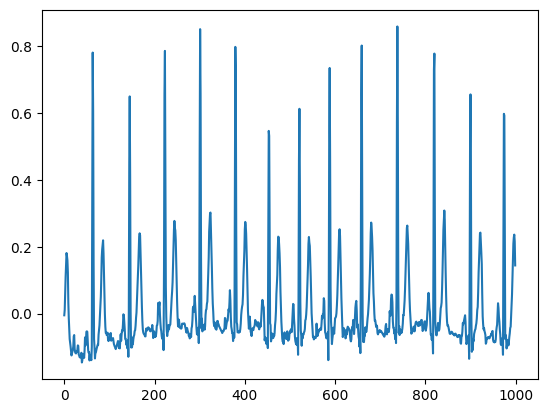

tensor([[[-0.3140, -0.3040, -0.3230,  ...,  1.4730,  0.6190,  0.1750]],

        [[-0.0850, -0.0850, -0.0850,  ..., -0.0680, -0.0740, -0.0490]],

        [[ 0.0730,  0.0550,  0.0560,  ...,  0.0090,  0.0030,  0.0200]],

        ...,

        [[ 0.0300, -0.0080, -0.0090,  ..., -0.0510, -0.0730,  0.1020]],

        [[-0.0950, -0.0720, -0.0800,  ..., -0.0410, -0.0840,  0.0960]],

        [[ 0.0200,  0.0500,  0.0730,  ...,  0.0430,  0.0560,  0.0670]]],
       device='cuda:0')


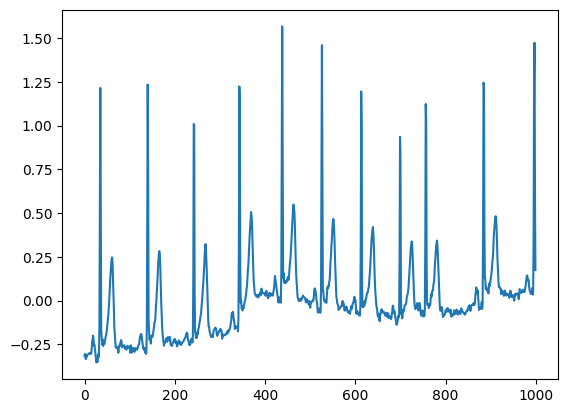

tensor([[[-0.0460, -0.0530, -0.0300,  ...,  0.0080,  0.0280,  0.0350]],

        [[ 0.0390,  0.0260, -0.0060,  ...,  0.0420,  0.0450,  0.0450]],

        [[-0.1000, -0.1020, -0.1040,  ..., -0.0390, -0.0530, -0.0480]],

        ...,

        [[ 0.1000,  0.0360,  0.0210,  ..., -0.0200, -0.0620,  0.0160]],

        [[ 0.3850,  0.3850,  0.3850,  ..., -0.1300, -0.1270, -0.1300]],

        [[ 0.1180,  0.0970,  0.0400,  ..., -0.1250, -0.1100, -0.1090]]],
       device='cuda:0')


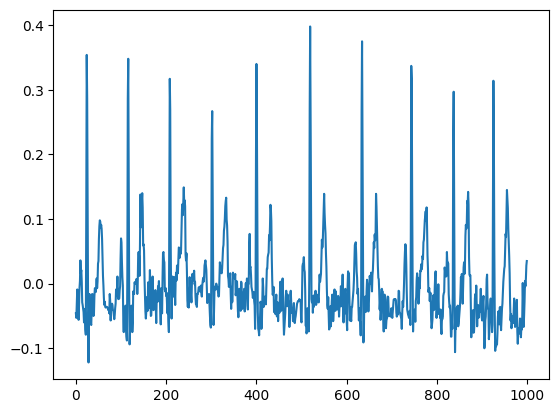

tensor([[[ 0.2250,  0.1910,  0.1950,  ..., -0.1650, -0.2040, -0.1510]],

        [[-0.1140, -0.1250, -0.1060,  ..., -0.0350, -0.0340, -0.0520]],

        [[ 0.0220,  0.0210,  0.0110,  ..., -0.0410, -0.1600,  0.1390]],

        ...,

        [[-0.0010, -0.0050, -0.0060,  ..., -0.0090, -0.0060,  0.1420]],

        [[-0.1180, -0.1150, -0.0820,  ..., -0.0120,  0.0130,  0.0420]],

        [[ 0.1030,  0.1270,  0.1380,  ..., -0.1090, -0.0970, -0.0870]]],
       device='cuda:0')


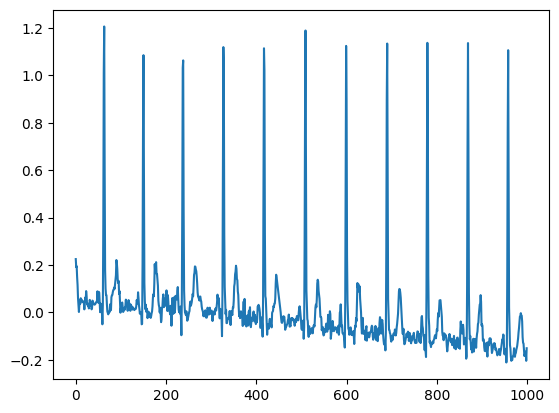

tensor([[[ 0.0790,  0.0740,  0.0660,  ...,  0.1060, -0.3270, -0.4020]],

        [[-0.0460, -0.0460, -0.0340,  ...,  0.0580,  0.1030,  0.1160]],

        [[ 0.1110,  0.1190,  0.1380,  ...,  0.6580,  0.4530,  0.0860]],

        ...,

        [[ 0.0440, -0.2660, -0.7930,  ..., -0.0650,  0.0640,  0.4830]],

        [[ 0.4230,  0.1680, -0.0800,  ..., -0.0840, -0.0760, -0.0810]],

        [[-0.0850, -0.1110, -0.0860,  ..., -0.0100,  0.0020, -0.0060]]],
       device='cuda:0')


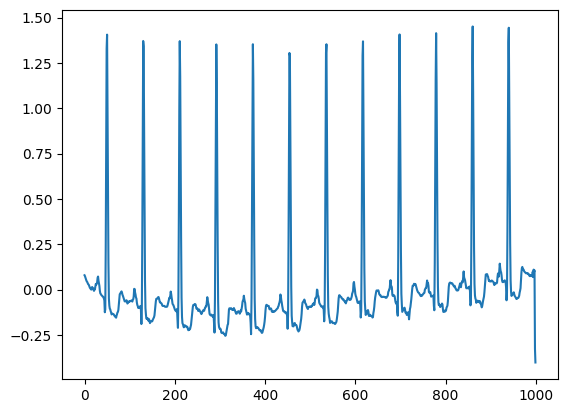

tensor([[[ 0.0610,  0.0610,  0.0580,  ..., -0.0770, -0.0620, -0.1370]],

        [[-0.0950, -0.0950, -0.0950,  ...,  0.0180,  0.0150,  0.0170]],

        [[-0.0520, -0.0800, -0.1010,  ...,  0.0320,  0.0840,  0.0460]],

        ...,

        [[ 0.0200,  0.0220,  0.0230,  ...,  0.0250,  0.0410,  0.0590]],

        [[ 0.1210,  0.1130,  0.0720,  ..., -0.1040, -0.0560, -0.0580]],

        [[-0.0490, -0.0710, -0.0750,  ..., -0.1170, -0.1270, -0.0990]]],
       device='cuda:0')


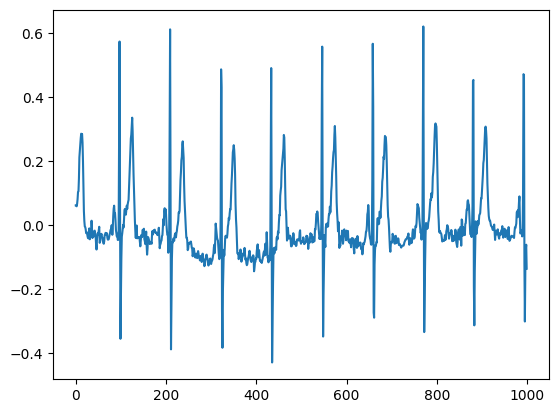

tensor([[[ 0.0460,  0.0400,  0.0360,  ..., -0.2490, -0.2420, -0.2450]],

        [[ 0.1300,  0.1580,  0.1970,  ..., -0.0740,  0.1810,  0.1270]],

        [[-0.0790, -0.0730, -0.0600,  ...,  0.0070, -0.0040,  0.0420]],

        ...,

        [[ 0.0030, -0.0100, -0.0190,  ...,  0.0440,  0.0400,  0.0330]],

        [[-0.0340, -0.0280, -0.0440,  ..., -0.0110, -0.0030, -0.0050]],

        [[-0.0090, -0.0050, -0.0030,  ..., -0.0620, -0.0630, -0.0110]]],
       device='cuda:0')


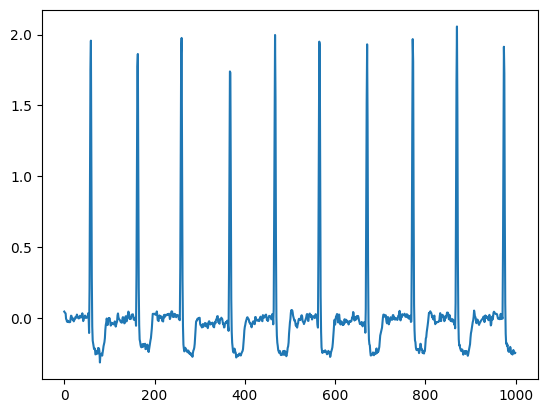

tensor([[[-0.1420, -0.1430, -0.1580,  ..., -0.1000, -0.0630, -0.0870]],

        [[-0.1270, -0.1270, -0.1310,  ...,  0.1280,  0.0330, -0.1200]],

        [[ 0.3430,  0.2200,  0.1200,  ..., -0.1150, -0.1140, -0.1130]],

        ...,

        [[ 0.0850,  0.0850,  0.0850,  ..., -0.0340,  0.0640, -0.3860]],

        [[ 0.1930,  0.0410, -0.1250,  ...,  0.0970,  0.0580,  0.0200]],

        [[-0.0320, -0.0210, -0.0100,  ..., -0.1150, -0.0950,  0.2020]]],
       device='cuda:0')


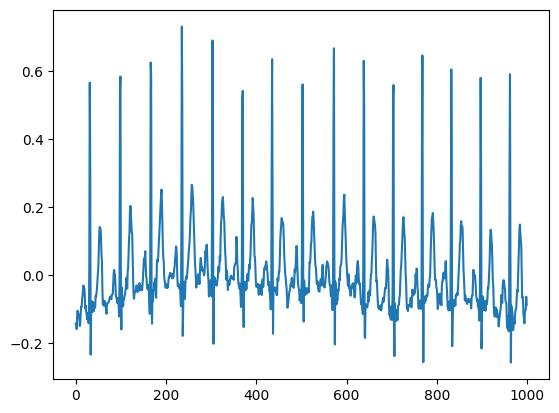

tensor([[[ 0.0100,  0.0170,  0.0360,  ...,  0.2230,  0.3430,  0.4180]],

        [[-0.1400, -0.1410, -0.1360,  ..., -0.0660, -0.0750, -0.0450]],

        [[-0.1440, -0.1420, -0.1370,  ...,  0.3840,  0.3710,  0.3530]],

        ...,

        [[ 0.0860,  0.0990,  0.1080,  ..., -0.0450, -0.0460, -0.0420]],

        [[-0.0570, -0.0690, -0.0640,  ..., -0.0710, -0.1030,  0.0260]],

        [[-0.0250, -0.0290, -0.0320,  ..., -0.0240,  0.2340,  0.4370]]],
       device='cuda:0')


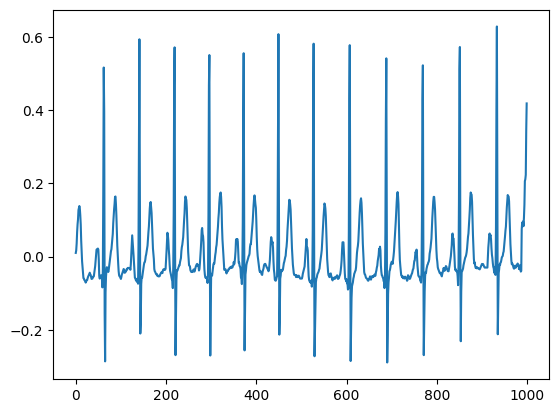

tensor([[[ 0.4840,  0.3200,  0.0730,  ...,  0.0540,  0.0510,  0.0270]],

        [[-0.0400, -0.0390, -0.0170,  ...,  0.0530,  0.1540,  0.2270]],

        [[ 0.0590,  0.0610,  0.0680,  ..., -0.0550, -0.0920, -0.0680]],

        ...,

        [[-0.1720, -0.1670, -0.1310,  ..., -0.1580, -0.1660, -0.1730]],

        [[-0.0840, -0.0820, -0.0750,  ...,  0.0200,  0.0130, -0.0080]],

        [[-0.1230, -0.0140,  0.4460,  ..., -0.0070,  0.0150,  0.0180]]],
       device='cuda:0')


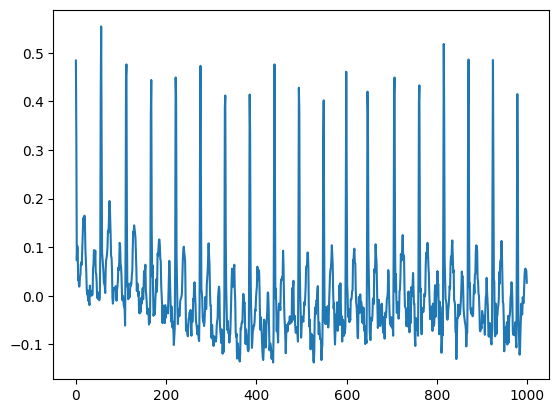

tensor([[[ 0.0180,  0.0160,  0.0250,  ..., -0.0940, -0.0530, -0.0130]],

        [[-0.0150, -0.0150, -0.0150,  ..., -0.0470, -0.0440, -0.0400]],

        [[ 0.0050,  0.0040,  0.0030,  ..., -0.0540, -0.0240, -0.0390]],

        ...,

        [[-0.1250, -0.1320, -0.1130,  ..., -0.0570, -0.0590, -0.0690]],

        [[ 0.3430,  0.3400,  0.3370,  ...,  0.0960,  0.1580,  0.4910]],

        [[-0.0400, -0.0100, -0.0090,  ..., -0.0590, -0.0670, -0.0590]]],
       device='cuda:0')


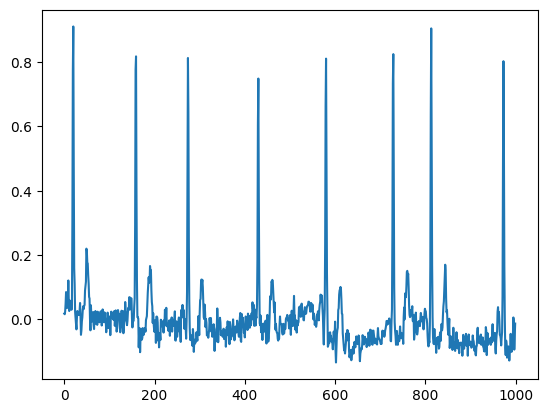

tensor([[[-0.1300, -0.1310, -0.1320,  ..., -0.0600, -0.0560, -0.0520]],

        [[ 0.0050,  0.0050,  0.0040,  ..., -0.1880, -0.2340, -0.2490]],

        [[-0.0550, -0.0590, -0.0690,  ..., -0.0250, -0.0380, -0.0330]],

        ...,

        [[-0.1480, -0.1250, -0.0880,  ...,  0.0410,  0.0290,  0.1290]],

        [[-0.0340, -0.0240, -0.0060,  ..., -0.0630, -0.0680, -0.1160]],

        [[ 0.1880,  0.2070,  0.2470,  ..., -0.0630, -0.0790,  0.0100]]],
       device='cuda:0')


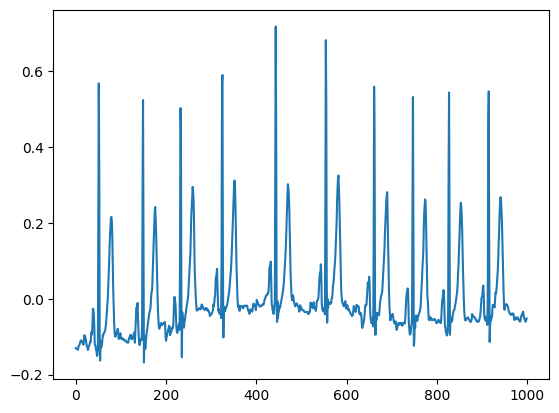

tensor([[[-0.0310, -0.0360, -0.0330,  ...,  0.0120,  0.0130,  0.0990]],

        [[ 0.0920,  0.0940,  0.0900,  ..., -0.2020, -0.2220, -0.1900]],

        [[ 0.0200,  0.0110, -0.0010,  ..., -0.0250, -0.0330, -0.0470]],

        ...,

        [[ 0.0580,  0.0980,  0.1460,  ..., -0.0070, -0.0080, -0.0300]],

        [[ 0.1600,  0.2020,  0.2300,  ..., -0.1330, -0.1630,  0.0550]],

        [[-0.0500, -0.0480, -0.0490,  ..., -0.0430, -0.0660, -0.0990]]],
       device='cuda:0')


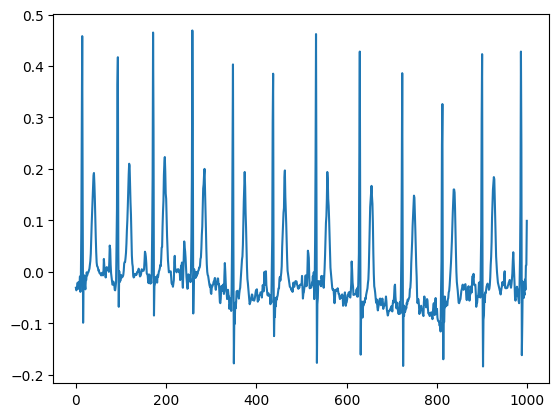

tensor([[[-0.0550, -0.0550, -0.0540,  ...,  0.3760,  0.0800, -0.0720]],

        [[-0.0350, -0.0390, -0.0460,  ..., -0.0850, -0.0950, -0.0970]],

        [[-0.1760, -0.1690, -0.1700,  ..., -0.1200, -0.1190, -0.0980]],

        ...,

        [[ 0.0050, -0.0130, -0.0220,  ..., -0.0500, -0.0370, -0.0050]],

        [[-0.0290, -0.0250, -0.0250,  ..., -0.1080, -0.1210, -0.1610]],

        [[-0.1880, -0.1870, -0.2110,  ..., -0.1510, -0.1940, -0.1720]]],
       device='cuda:0')


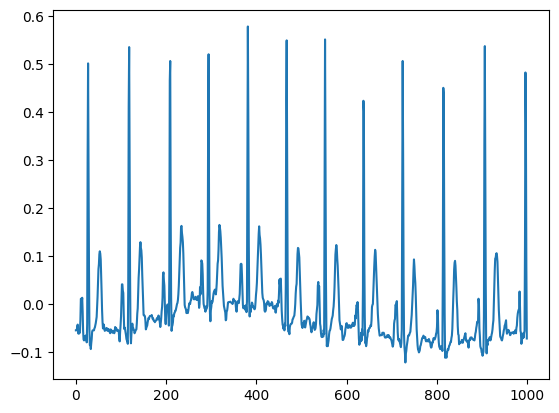

tensor([[[ 0.0300,  0.0420,  0.0670,  ...,  0.0110,  0.0140,  0.0170]],

        [[-0.0290, -0.0280, -0.0220,  ..., -0.0140, -0.0180, -0.0200]],

        [[-0.1140, -0.1180, -0.1310,  ..., -0.0620, -0.0710, -0.0960]],

        ...,

        [[-0.0450, -0.0450, -0.0450,  ..., -0.2030, -0.1920, -0.2070]],

        [[-0.3910, -0.3010, -0.1540,  ..., -0.0590,  0.0010, -0.0480]],

        [[-0.0510, -0.0350, -0.0430,  ..., -0.0220,  0.0050,  0.0060]]],
       device='cuda:0')


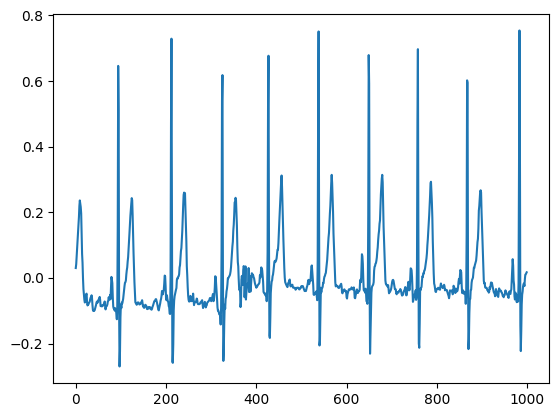

tensor([[[-0.0630, -0.0590, -0.0850,  ...,  0.0400,  0.0390, -0.0250]],

        [[-0.1050, -0.0880, -0.0570,  ..., -0.0230, -0.0210, -0.0300]],

        [[-0.0890, -0.0740, -0.0720,  ..., -0.1020, -0.1050, -0.1110]],

        ...,

        [[-0.1100, -0.1040, -0.1030,  ...,  0.0330,  0.0360,  0.1680]],

        [[ 0.0320,  0.0450,  0.0430,  ...,  0.2290,  0.2300,  0.1060]],

        [[ 0.0880,  0.0810,  0.0870,  ..., -0.0720, -0.1940, -0.2670]]],
       device='cuda:0')


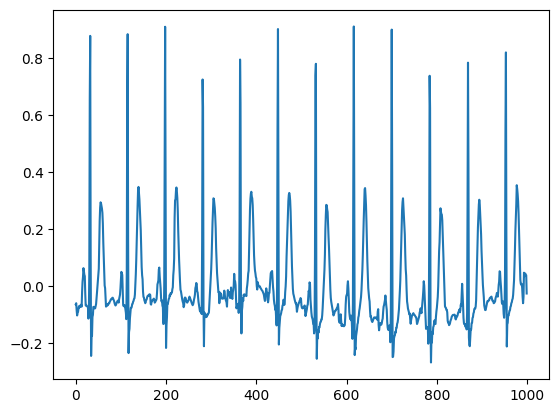

tensor([[[-0.0960, -0.0890, -0.0870,  ...,  1.2610,  1.9230,  1.8660]],

        [[-0.1340, -0.1400, -0.1480,  ...,  0.0790,  0.0900,  0.0800]],

        [[-0.0660, -0.0620, -0.0330,  ..., -0.1080, -0.1050, -0.0890]],

        ...,

        [[ 0.1540,  0.1540,  0.1760,  ...,  0.1940,  0.2010,  0.2080]],

        [[ 0.0430, -0.0900, -0.1490,  ..., -0.0550, -0.0670, -0.0510]],

        [[-0.0530, -0.0570, -0.0240,  ...,  0.0820,  0.0880,  0.1140]]],
       device='cuda:0')


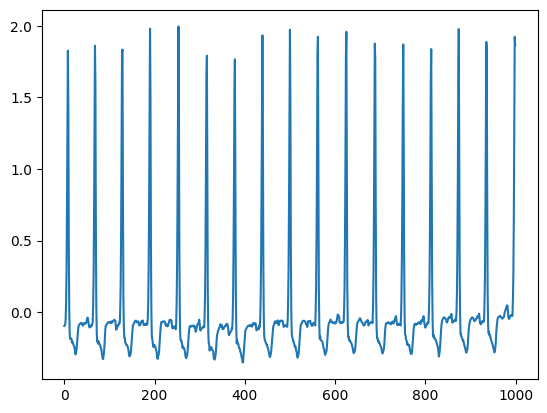

tensor([[[ 0.0130,  0.0090,  0.0140,  ..., -0.0060, -0.0310, -0.0070]],

        [[ 0.0060, -0.0030, -0.0130,  ...,  0.0730,  0.3730,  0.3430]],

        [[ 0.1600,  0.1450,  0.1250,  ...,  0.0970,  0.1180,  0.1290]],

        ...,

        [[-0.0500, -0.0490, -0.0410,  ..., -0.0290, -0.0140,  0.0650]],

        [[-0.0680, -0.1840, -0.3610,  ...,  0.2530,  0.3180,  0.2870]],

        [[-0.0330, -0.0650, -0.0900,  ..., -0.0490, -0.0200,  0.1110]]],
       device='cuda:0')


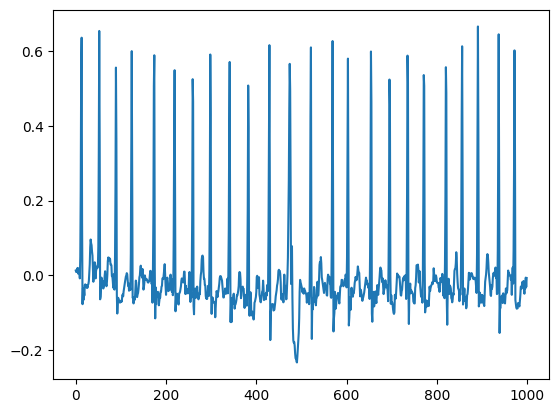

tensor([[[-0.2870, -0.2830, -0.2470,  ..., -0.2620, -0.2620, -0.2720]],

        [[-0.0300, -0.0300, -0.0300,  ...,  0.0820,  0.1640,  0.4120]],

        [[-0.1450, -0.1450, -0.1460,  ..., -0.0520, -0.0740, -0.0770]],

        ...,

        [[ 0.0030, -0.0030,  0.0150,  ..., -0.0910, -0.0560, -0.0470]],

        [[ 0.0230,  0.0260,  0.0220,  ...,  0.1040,  0.0990,  0.1830]],

        [[ 0.6630,  0.3540, -0.1080,  ..., -0.0380, -0.0310, -0.0020]]],
       device='cuda:0')


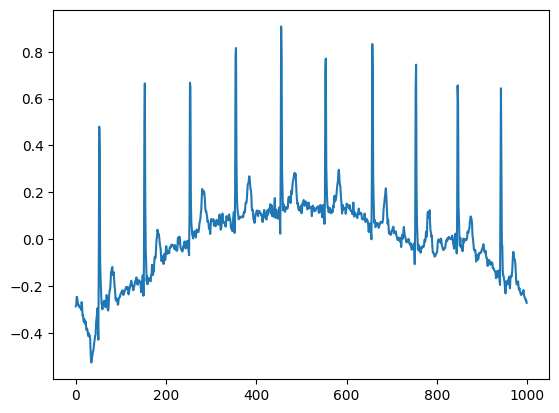

tensor([[[-0.0670, -0.0840, -0.0770,  ..., -0.0620, -0.0480, -0.0410]],

        [[ 0.0290,  0.0120, -0.0020,  ..., -0.0500, -0.1000, -0.1020]],

        [[ 0.0240,  0.0320,  0.0350,  ...,  0.0120,  0.4070,  0.6420]],

        ...,

        [[ 0.4530,  0.4890,  0.4860,  ..., -0.1330, -0.0990, -0.0900]],

        [[ 0.0010, -0.0020, -0.0180,  ..., -0.0020,  0.0450,  0.0710]],

        [[-0.0870, -0.0940, -0.1190,  ...,  0.0150, -0.0020, -0.0030]]],
       device='cuda:0')


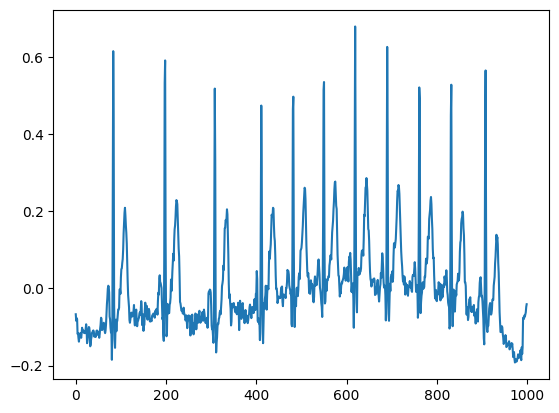

tensor([[[ 0.0390,  0.0260, -0.0180,  ..., -0.1110, -0.2220, -0.0430]],

        [[-0.1270, -0.1210, -0.1230,  ..., -0.0430, -0.0480, -0.0440]],

        [[-0.0980, -0.0830, -0.0730,  ...,  0.2080,  0.2270,  0.2710]],

        ...,

        [[ 0.1150,  0.1150,  0.1120,  ..., -0.0180, -0.0620, -0.0870]],

        [[-0.0040,  0.0030,  0.0060,  ...,  0.0120,  0.1460,  0.1760]],

        [[-0.0270, -0.0120, -0.0180,  ..., -0.0490, -0.0500, -0.0570]]],
       device='cuda:0')


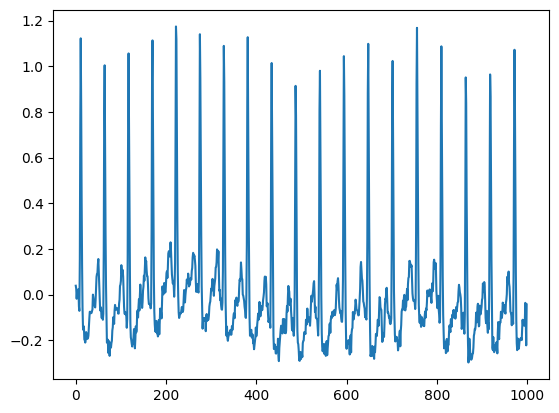

tensor([[[-0.0010, -0.0170, -0.0370,  ...,  0.0280,  0.0500,  0.0450]],

        [[ 0.1930,  0.1780,  0.1200,  ...,  0.0690,  0.1120,  0.0740]],

        [[-0.0020, -0.0040,  0.0040,  ...,  0.1350,  0.1070,  0.0940]],

        ...,

        [[ 0.0280,  0.0460,  0.0600,  ..., -0.0660, -0.1010, -0.0580]],

        [[ 0.0010,  0.0140,  0.0130,  ...,  0.0810, -0.0310,  0.2710]],

        [[-0.0550, -0.0550, -0.0580,  ...,  0.0970,  0.3310, -0.1470]]],
       device='cuda:0')


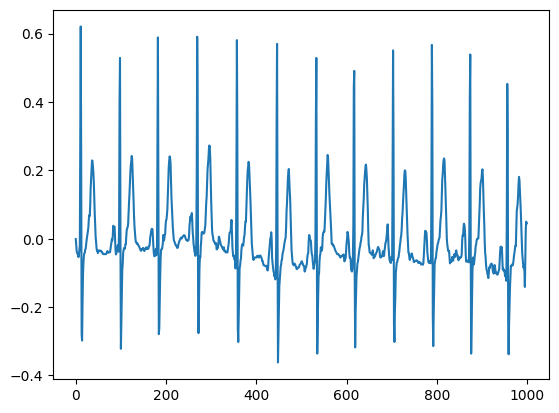

tensor([[[-0.2400, -0.3120, -0.3190,  ..., -0.1100, -0.0950, -0.1000]],

        [[-0.0060,  0.0000,  0.0070,  ..., -0.1190, -0.0610, -0.6040]],

        [[ 0.2590,  0.2640,  0.2670,  ..., -0.3370, -0.3310, -0.3770]],

        ...,

        [[-0.1500, -0.1500, -0.1500,  ..., -0.0400, -0.0400, -0.0400]],

        [[ 0.0400,  0.0390,  0.0430,  ...,  0.0600,  0.0670,  0.0630]],

        [[ 0.0410,  0.0230, -0.0090,  ..., -0.0130,  0.0210,  0.0440]]],
       device='cuda:0')


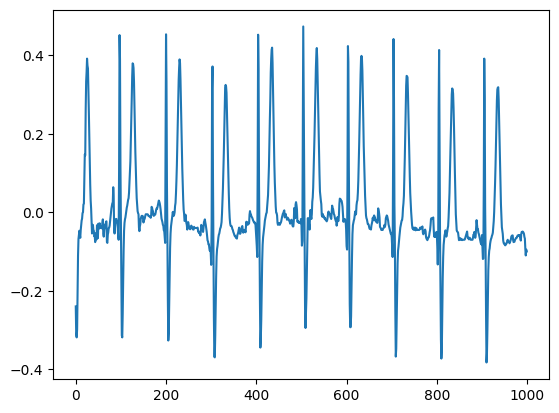

tensor([[[-0.0450, -0.0450, -0.0500,  ..., -0.0450, -0.0400, -0.0240]],

        [[-0.0350, -0.0350, -0.0350,  ..., -0.0080,  0.0210,  0.1330]],

        [[-0.3200, -0.3200, -0.3200,  ...,  0.1520,  0.1460,  0.1440]],

        ...,

        [[ 0.0070,  0.0420,  0.0880,  ..., -0.1150, -0.0990, -0.0870]],

        [[-0.0420, -0.0820, -0.0550,  ...,  0.1440,  0.2700,  0.2940]],

        [[ 0.0010,  0.0040, -0.0020,  ...,  0.1590,  0.1310,  0.1660]]],
       device='cuda:0')


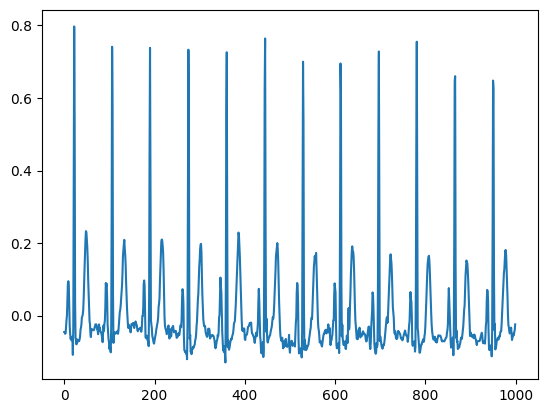

tensor([[[-0.1000, -0.1140, -0.1250,  ...,  0.0330,  0.0180,  0.0080]],

        [[ 0.0500,  0.0640,  0.0970,  ..., -0.0650, -0.0730, -0.0730]],

        [[-0.0450, -0.0500, -0.0570,  ...,  0.0070,  0.0520,  0.3090]],

        ...,

        [[-0.0750, -0.0730, -0.0660,  ..., -0.0160, -0.0110,  0.0170]],

        [[ 0.1140,  0.1000,  0.1040,  ..., -0.2930, -0.2850, -0.2890]],

        [[-0.1800, -0.1790, -0.1810,  ...,  0.3970,  0.3820,  0.3610]]],
       device='cuda:0')


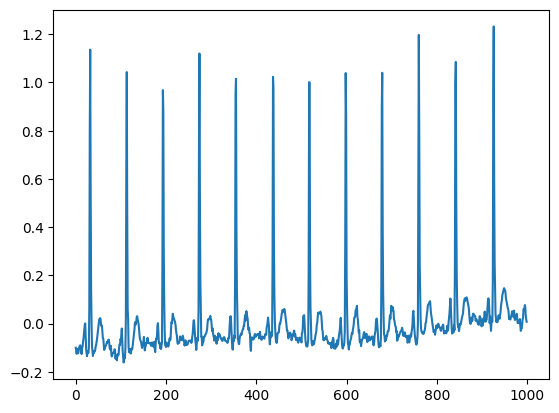

tensor([[[-0.0230, -0.0370,  0.0290,  ..., -0.1550, -0.1010, -0.1180]],

        [[ 0.0450,  0.0160, -0.0400,  ...,  0.0260,  0.0100,  0.0300]],

        [[ 0.0000,  0.0000, -0.0090,  ..., -0.0390, -0.1190, -0.2330]],

        ...,

        [[-0.0060, -0.0160, -0.0310,  ...,  0.0890,  0.0950,  0.0880]],

        [[ 0.0230,  0.0060, -0.0100,  ..., -0.0710, -0.0340, -0.0720]],

        [[-0.0200, -0.0210, -0.0240,  ..., -0.0390, -0.0380, -0.0320]]],
       device='cuda:0')


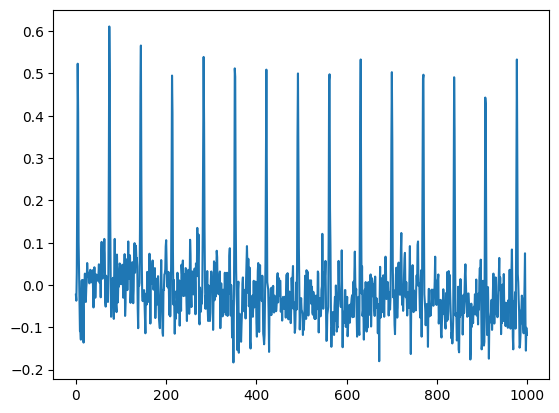

tensor([[[ 0.1450,  0.1450,  0.1440,  ..., -0.2720, -0.2830, -0.2900]],

        [[ 0.0170, -0.0050, -0.0180,  ...,  0.0270, -0.0300,  0.1120]],

        [[ 0.0100,  0.0100,  0.0100,  ...,  0.0760,  0.1040,  0.1320]],

        ...,

        [[-0.0690, -0.1290, -0.1230,  ..., -0.0720, -0.0670, -0.0650]],

        [[-0.1600, -0.1350, -0.0420,  ...,  0.1720, -0.1210, -0.1120]],

        [[-0.0250, -0.0370, -0.0090,  ..., -0.0670, -0.1080, -0.0390]]],
       device='cuda:0')


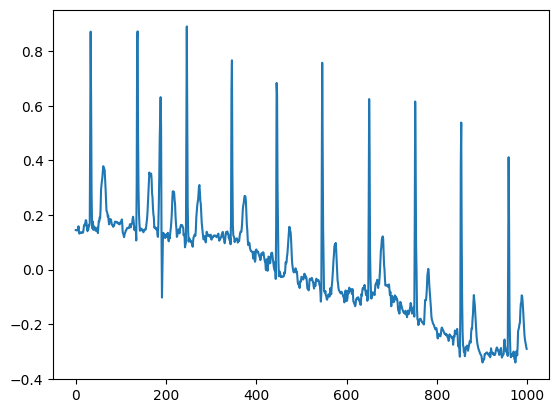

tensor([[[-0.0450, -0.0440, -0.0410,  ..., -0.0590, -0.1100, -0.0970]],

        [[-0.0360, -0.0310, -0.0080,  ..., -0.7960, -1.4440, -1.2570]],

        [[ 0.3000,  0.2970,  0.2660,  ..., -0.3930, -0.4000, -0.4000]],

        ...,

        [[-0.1250, -0.1180, -0.1070,  ..., -0.0410,  0.2080,  0.1570]],

        [[-0.1070, -0.0920, -0.1070,  ...,  0.3240, -0.0140, -0.1430]],

        [[ 0.0340,  0.0270,  0.0190,  ..., -0.0070, -0.0160,  0.0080]]],
       device='cuda:0')


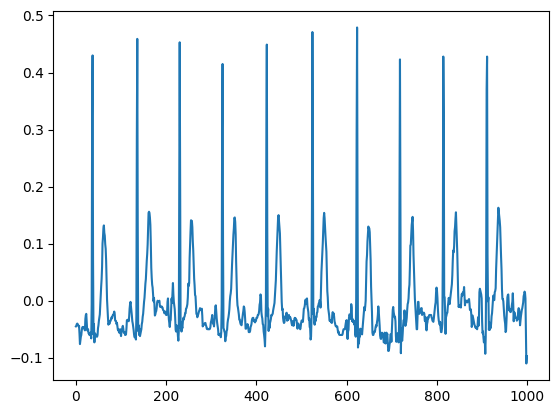

tensor([[[ 0.0350,  0.0430,  0.0620,  ..., -0.2620, -0.1980, -0.1490]],

        [[ 0.1260,  0.1020,  0.0760,  ...,  0.0830,  0.0650,  0.0670]],

        [[-0.1450, -0.1460, -0.1320,  ...,  0.0430,  0.0670,  0.0700]],

        ...,

        [[ 0.0920,  0.0720,  0.0670,  ..., -0.0600, -0.0410, -0.0350]],

        [[ 0.4640,  0.4500,  0.4310,  ...,  0.1100,  0.1060,  0.1040]],

        [[ 0.0200,  0.0200,  0.0200,  ...,  0.0730,  0.0780,  0.1130]]],
       device='cuda:0')


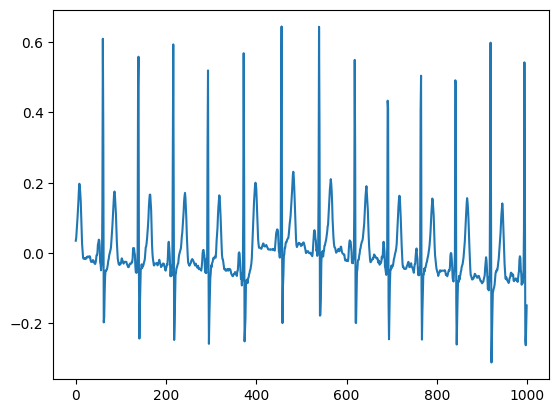

tensor([[[ 0.1440,  0.1250,  0.0980,  ...,  0.1270,  0.2140,  0.1520]],

        [[ 0.0030,  0.0100, -0.0150,  ...,  0.3520,  0.3330,  0.0830]],

        [[-0.0730, -0.0370,  0.0030,  ..., -0.0390, -0.0460, -0.3840]],

        ...,

        [[ 0.1110,  0.1160,  0.2070,  ..., -0.2590, -0.2400, -0.2200]],

        [[-0.0430, -0.0540, -0.0650,  ...,  0.0600, -0.0150,  0.0270]],

        [[-0.2310, -0.2300, -0.3020,  ..., -0.0590, -0.0600, -0.0500]]],
       device='cuda:0')


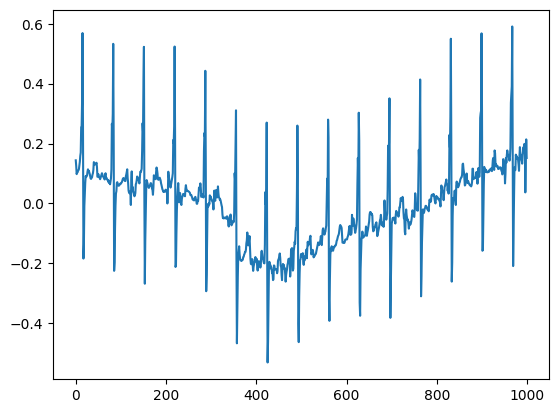

tensor([[[-0.0070,  0.0190,  0.0440,  ...,  0.0230,  0.0180,  0.0010]],

        [[-0.0210, -0.0110,  0.0100,  ...,  0.0890,  0.0650,  0.0570]],

        [[-0.0460, -0.0450, -0.0480,  ...,  0.0580,  0.0070,  0.0580]],

        ...,

        [[ 0.0010,  0.0060,  0.0070,  ..., -0.0630, -0.0560, -0.0320]],

        [[ 0.0710,  0.0420,  0.0290,  ..., -0.0450, -0.0370, -0.0420]],

        [[-0.0450, -0.0450, -0.0450,  ..., -0.1370, -0.1360, -0.1110]]],
       device='cuda:0')


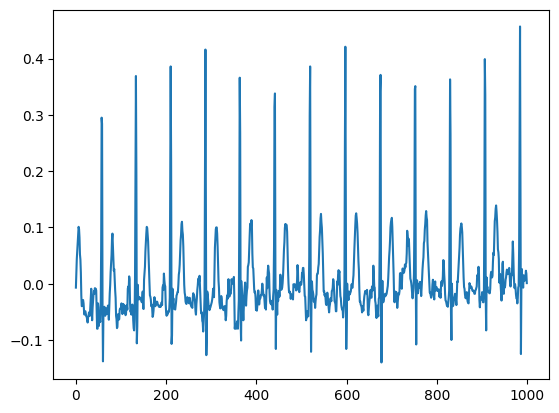

tensor([[[-0.1340, -0.1270, -0.1210,  ..., -0.0070, -0.0210, -0.0150]],

        [[-0.0290, -0.0240, -0.0170,  ..., -0.2030, -0.1770, -0.2000]],

        [[ 0.0740,  0.1050,  0.0920,  ...,  0.0330,  0.0330,  0.0580]],

        ...,

        [[-0.0300, -0.0290, -0.0490,  ..., -0.0890, -0.0620, -0.0350]],

        [[-0.0960, -0.1030, -0.1540,  ..., -0.0250, -0.0550, -0.0170]],

        [[-0.0770, -0.0740, -0.0790,  ..., -0.0440, -0.0430, -0.0310]]],
       device='cuda:0')


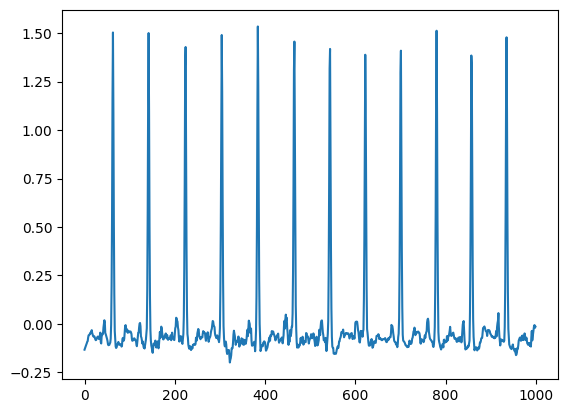

tensor([[[ 0.0030,  0.0350,  0.0730,  ...,  0.0020,  0.0240,  0.0340]],

        [[ 0.0360,  0.0490,  0.0660,  ...,  0.0820,  0.0340, -0.0500]],

        [[-0.0110, -0.0160, -0.0330,  ...,  0.0420,  0.0040, -0.0170]],

        ...,

        [[-0.0610, -0.0710, -0.1380,  ...,  0.0480,  0.0400,  0.0210]],

        [[-0.2840, -0.2750, -0.2780,  ..., -0.2110, -0.2460, -0.3370]],

        [[-0.0100, -0.0100, -0.0110,  ...,  0.0080, -0.0050,  0.0280]]],
       device='cuda:0')


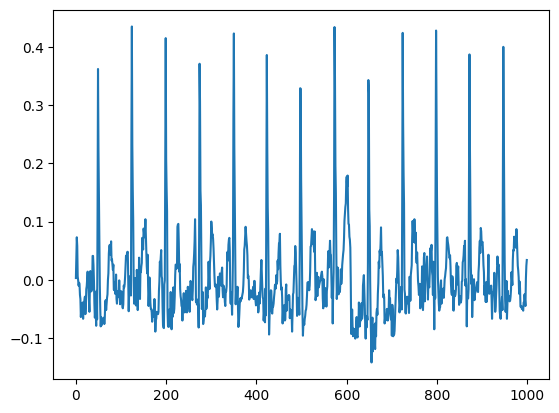

tensor([[[-0.1450, -0.1610, -0.2060,  ..., -0.0250,  0.3520,  0.8850]],

        [[-0.0300, -0.0290, -0.0270,  ..., -0.0930, -0.0850, -0.0850]],

        [[ 0.0000,  0.0030,  0.0040,  ...,  0.0010,  0.0690,  0.0350]],

        ...,

        [[-0.1100, -0.1070, -0.1030,  ..., -0.0520, -0.0560, -0.0400]],

        [[-0.0250, -0.0250, -0.0250,  ..., -0.0220, -0.0270, -0.0250]],

        [[ 0.0760,  0.0810,  0.0640,  ..., -0.0150, -0.0050, -0.0090]]],
       device='cuda:0')


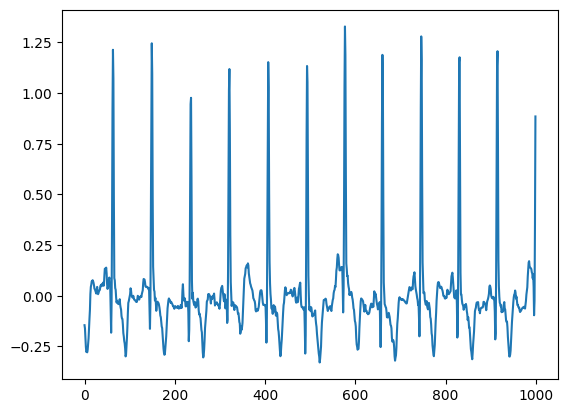

tensor([[[-0.1100, -0.1150, -0.1190,  ..., -0.0410, -0.0510, -0.0240]],

        [[ 0.0120,  0.0130,  0.0390,  ..., -0.0370, -0.0630, -0.0380]],

        [[-0.0140, -0.0060,  0.0080,  ..., -0.1330, -0.1150, -0.0090]],

        ...,

        [[-0.0450, -0.0440, -0.0430,  ..., -0.0320, -0.0250, -0.0230]],

        [[-0.0710, -0.0790, -0.0710,  ...,  0.0090,  0.0430,  0.0070]],

        [[-0.0070,  0.0180, -0.0070,  ...,  0.0440,  0.2690,  0.2220]]],
       device='cuda:0')


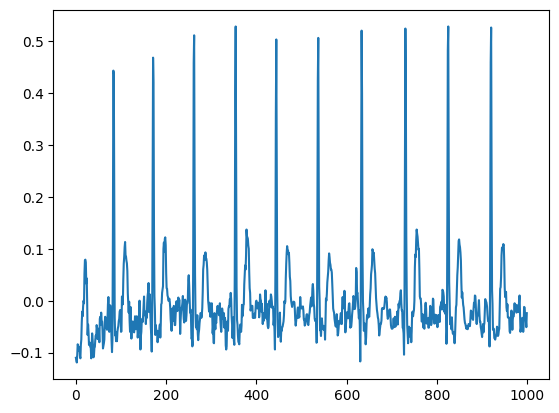

tensor([[[-0.0740, -0.0690, -0.0790,  ..., -0.1350, -0.0080, -0.2880]],

        [[ 0.0610,  0.0710,  0.0950,  ..., -0.9980, -1.9500, -1.7120]],

        [[-0.0050, -0.0050,  0.0020,  ..., -0.0500, -0.0370,  0.0430]],

        ...,

        [[-0.0560, -0.0600, -0.0600,  ...,  0.0290,  0.0500,  0.0400]],

        [[-0.2740, -0.1760, -0.0800,  ...,  0.0220,  0.0230,  0.0390]],

        [[-0.1150, -0.1200, -0.1220,  ..., -0.1340, -0.1290, -0.1460]]],
       device='cuda:0')


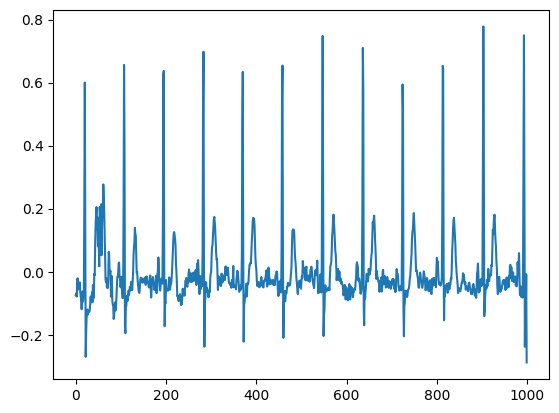

tensor([[[-0.0380, -0.0440, -0.0750,  ...,  0.0610,  0.0310, -0.0350]],

        [[ 0.0150,  0.0150, -0.0060,  ..., -0.0580, -0.2580, -0.6850]],

        [[-0.0770, -0.0850, -0.0800,  ..., -0.0970, -0.1790, -0.1110]],

        ...,

        [[-0.0160, -0.0220, -0.0210,  ...,  0.0120,  0.0060,  0.0000]],

        [[-0.0450, -0.0530, -0.0600,  ...,  0.0460,  0.0510,  0.0310]],

        [[-0.1110, -0.1340, -0.1580,  ..., -0.0390, -0.0570,  0.0600]]],
       device='cuda:0')


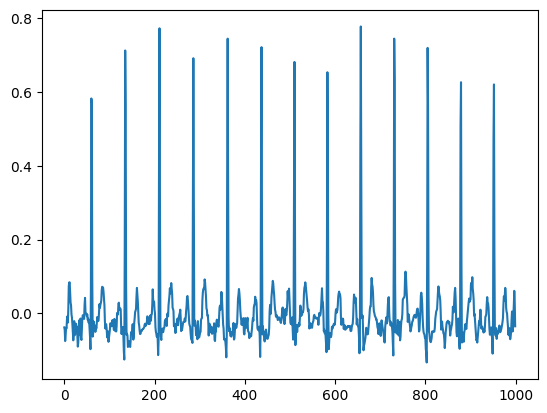

tensor([[[ 0.1090,  0.1030,  0.1050,  ..., -0.0110,  0.0240,  0.0110]],

        [[ 0.0670,  0.0710,  0.0480,  ...,  0.0050, -0.0380, -0.0500]],

        [[ 0.0970,  0.0690, -0.0070,  ..., -0.1370, -0.1670, -0.1910]],

        ...,

        [[-0.0770, -0.0780, -0.0640,  ..., -0.0110,  0.0000, -0.0140]],

        [[ 0.2170, -0.0060, -0.0850,  ...,  0.4110,  0.1730, -0.0550]],

        [[-0.0100, -0.0290, -0.0450,  ...,  0.1030,  0.4320,  0.6700]]],
       device='cuda:0')


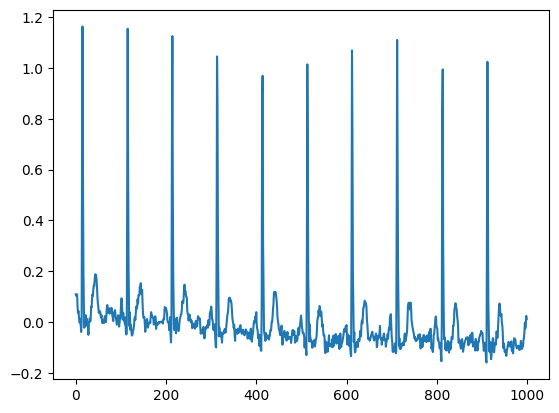

tensor([[[ 0.1220,  0.0670,  0.0100,  ...,  0.2330,  0.1480,  0.0070]],

        [[-0.0500, -0.0500, -0.0470,  ..., -0.0400, -0.0350,  0.0000]],

        [[-0.0050, -0.0080, -0.0100,  ...,  0.0430, -0.0120, -0.0480]],

        ...,

        [[ 0.0860,  0.0380,  0.0430,  ...,  0.0250,  0.0570,  0.0770]],

        [[ 0.0400,  0.0390,  0.0350,  ...,  0.0590,  0.0720,  0.0630]],

        [[-0.0060, -0.0270, -0.0590,  ..., -0.0500,  0.1390,  0.4710]]],
       device='cuda:0')


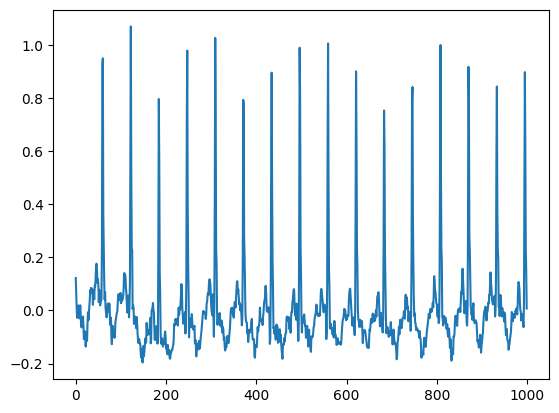

tensor([[[-0.0720, -0.0400, -0.0490,  ...,  0.7850,  0.5720,  0.0950]],

        [[ 0.0130,  0.0530,  0.0640,  ..., -0.0550, -0.1060, -0.1130]],

        [[-0.0780, -0.0780, -0.0940,  ..., -0.1850, -0.2180, -0.2230]],

        ...,

        [[ 0.0150,  0.0150,  0.0120,  ..., -0.1300, -0.1240, -0.1030]],

        [[ 0.0370,  0.0640,  0.0930,  ..., -0.0820, -0.1110, -0.0820]],

        [[ 0.0010,  0.0020,  0.0230,  ...,  0.0660,  0.0540,  0.0880]]],
       device='cuda:0')


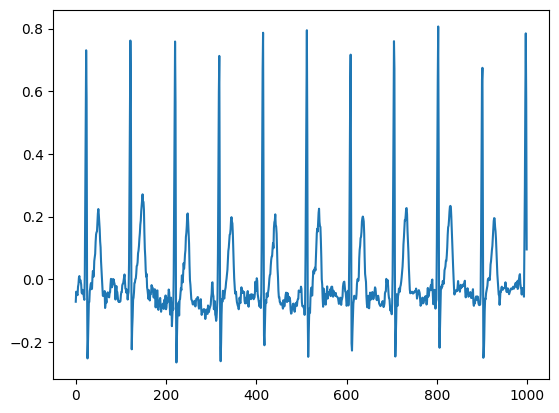

tensor([[[-0.0710, -0.1040, -0.1270,  ...,  0.0080, -0.0130, -0.0190]],

        [[-0.0250, -0.0250, -0.0250,  ..., -0.0220, -0.0200, -0.0360]],

        [[-0.0460, -0.0450, -0.0490,  ...,  0.0960,  0.0990,  0.1030]],

        ...,

        [[ 0.1060,  0.1160,  0.1060,  ..., -0.0750, -0.0710, -0.0530]],

        [[-0.0050,  0.0130, -0.0250,  ..., -0.0960, -0.1470, -0.0490]],

        [[ 0.0810,  0.3420,  0.6370,  ...,  0.0770,  0.0630,  0.0460]]],
       device='cuda:0')


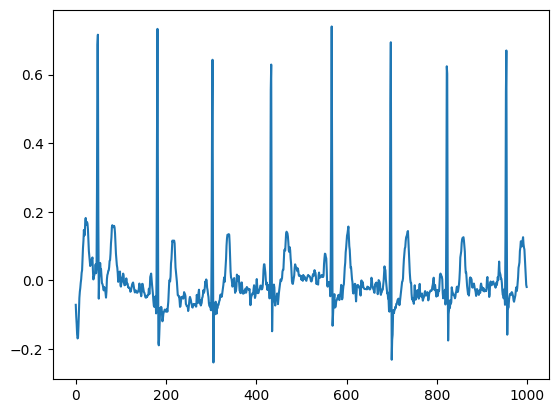

tensor([[[-0.0690, -0.0390,  0.0140,  ..., -0.0720, -0.0820, -0.0850]],

        [[-0.1170, -0.1310, -0.1450,  ..., -0.0310, -0.0250, -0.0190]],

        [[-0.1520, -0.1440, -0.1250,  ..., -0.1450, -0.0920, -0.0490]],

        ...,

        [[-0.0420, -0.0600, -0.0770,  ...,  0.0930,  0.0350, -0.0500]],

        [[ 0.0910,  0.0980,  0.0650,  ...,  0.6460,  0.7930,  0.2290]],

        [[ 0.3360,  0.1770,  0.0490,  ..., -0.0430, -0.0360, -0.0350]]],
       device='cuda:0')


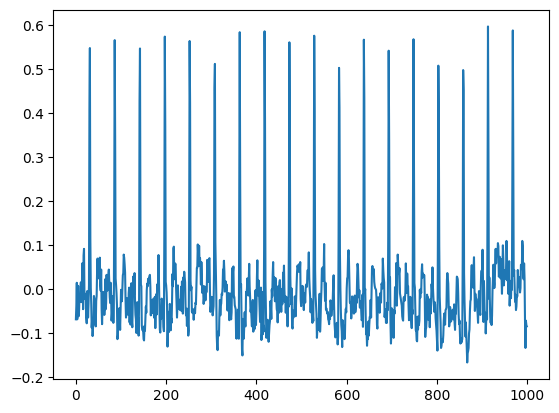

tensor([[[-0.0150, -0.0150, -0.0150,  ...,  0.0800,  0.0890,  0.0750]],

        [[ 0.0490,  0.0420,  0.0330,  ...,  0.0670,  0.4490,  0.7460]],

        [[ 0.0250,  0.0240,  0.0170,  ..., -0.0780, -0.0710, -0.0720]],

        ...,

        [[ 0.0150,  0.0150,  0.0120,  ...,  0.1530,  0.0720,  0.1030]],

        [[-0.0740, -0.0470, -0.0380,  ..., -0.2280, -0.2780, -0.2770]],

        [[-0.0310, -0.0380, -0.0270,  ..., -0.0130, -0.0180,  0.0000]]],
       device='cuda:0')


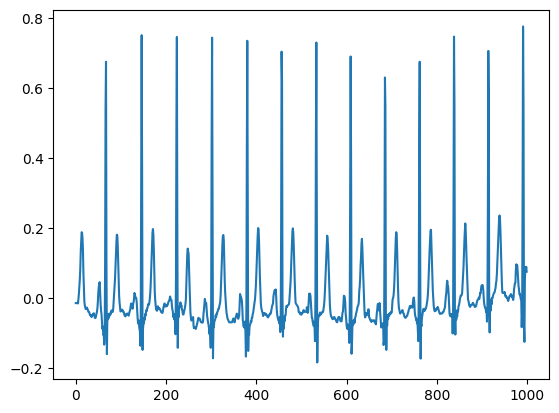

tensor([[[-0.0400, -0.0420, -0.0470,  ..., -0.0260,  0.0070,  0.0240]],

        [[ 0.0390,  0.0390, -0.0070,  ..., -0.0760, -0.0950, -0.1040]],

        [[-0.1500, -0.2100, -0.1200,  ..., -0.0720, -0.0700, -0.0790]],

        ...,

        [[ 0.1720,  0.1200,  0.0290,  ..., -0.0690, -0.0630,  0.0240]],

        [[-0.1970, -0.1610, -0.1950,  ...,  0.3020,  0.3210,  0.3300]],

        [[ 0.0900,  0.0880,  0.0810,  ..., -0.0010, -0.0110,  0.0060]]],
       device='cuda:0')


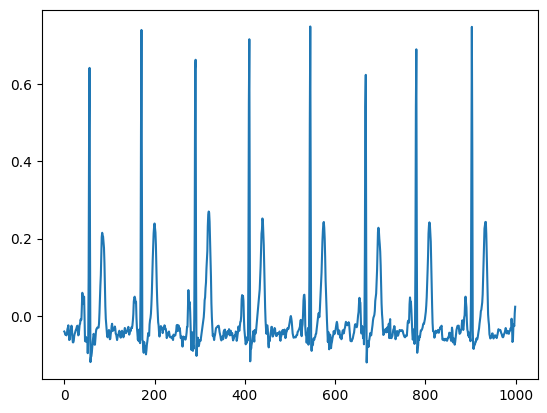

tensor([[[-0.0600, -0.0600, -0.0590,  ...,  0.0710, -0.0330, -0.1850]],

        [[ 0.0040, -0.0030, -0.0210,  ..., -0.0860, -0.0810, -0.0800]],

        [[ 0.1450,  0.1320,  0.1010,  ...,  0.0250, -0.0120, -0.0090]],

        ...,

        [[ 0.0400,  0.0320,  0.0110,  ..., -0.0850, -0.0760, -0.0830]],

        [[-0.1020, -0.0970, -0.0950,  ..., -0.0110,  0.0000, -0.0010]],

        [[-0.0850, -0.0820, -0.0750,  ..., -0.1870, -0.1600, -0.0240]]],
       device='cuda:0')


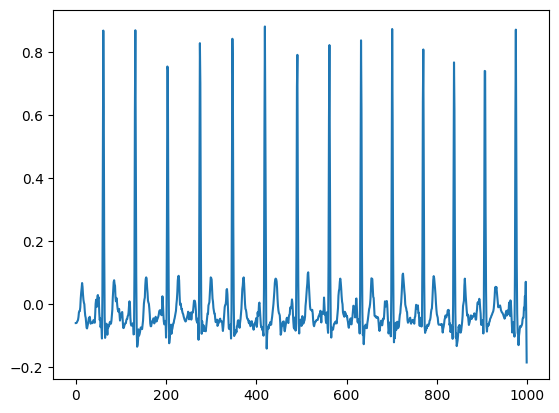

tensor([[[-0.1660, -0.0700,  0.0000,  ..., -0.0040,  0.0070, -0.0030]],

        [[ 0.0030, -0.0090, -0.0480,  ..., -0.0160, -0.1180, -0.3160]],

        [[-0.0470, -0.0600, -0.0630,  ...,  0.0840,  0.0610,  0.0610]],

        ...,

        [[-0.1670, -0.1430, -0.0870,  ..., -0.1340, -0.1770, -0.1400]],

        [[ 0.2580,  0.2230,  0.1790,  ..., -0.1440, -0.1530, -0.1600]],

        [[-0.0400, -0.0490, -0.0580,  ...,  0.5350,  0.3280,  0.0980]]],
       device='cuda:0')


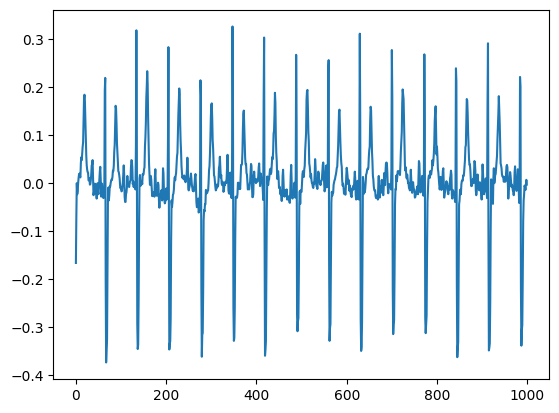

tensor([[[-0.0120, -0.0070, -0.0100,  ...,  0.2460,  0.2480,  0.2630]],

        [[ 0.0270,  0.0390,  0.0630,  ...,  0.0880,  0.3920,  0.3320]],

        [[ 0.6480,  0.8350,  0.7000,  ..., -0.0180, -0.0030,  0.0090]],

        ...,

        [[ 0.3900,  0.6360,  0.5200,  ...,  0.0060,  0.0060,  0.0210]],

        [[-0.2300, -0.2290, -0.2250,  ..., -0.1390, -0.1150, -0.1060]],

        [[ 0.0050, -0.0010, -0.0110,  ..., -0.0080, -0.0230, -0.0530]]],
       device='cuda:0')


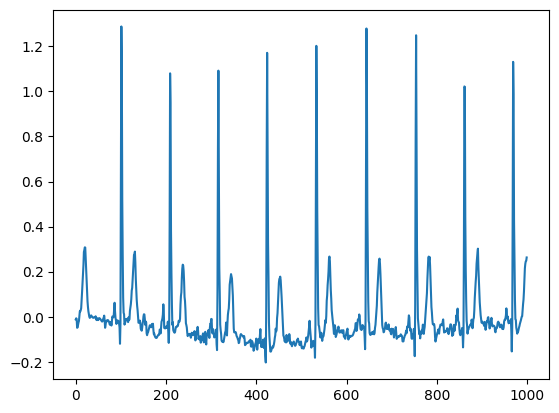

tensor([[[ 0.1310,  0.2670,  0.2370,  ...,  0.0360,  0.0850,  0.3230]],

        [[ 0.0300,  0.0220,  0.0070,  ..., -0.1690,  0.2170,  0.9270]],

        [[-0.0050, -0.0110, -0.0040,  ..., -0.1070,  0.0200, -0.4110]],

        ...,

        [[ 1.2450,  1.1220,  0.2050,  ...,  0.9310,  1.0480,  0.1050]],

        [[-0.0710, -0.0840, -0.1060,  ...,  0.0870,  0.0580,  0.0850]],

        [[-0.0990, -0.1270, -0.0440,  ...,  0.0220, -0.1160,  0.0940]]],
       device='cuda:0')


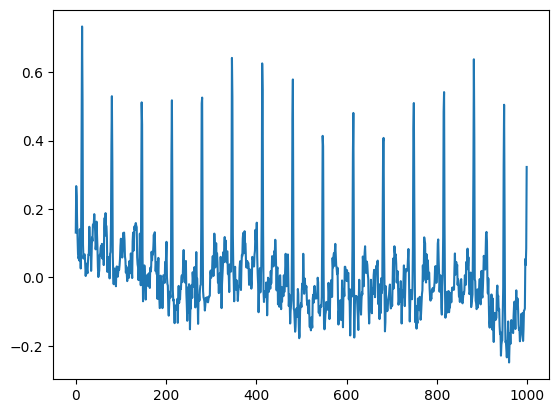

tensor([[[-0.1230, -0.1270, -0.1490,  ..., -0.0390, -0.0420, -0.0340]],

        [[-0.1600, -0.1620, -0.1650,  ..., -0.0410, -0.1220, -0.1090]],

        [[-0.0700, -0.0260, -0.0160,  ...,  0.0120, -0.0240,  0.0520]],

        ...,

        [[-0.0830, -0.0630, -0.0360,  ..., -0.0170, -0.0150,  0.0080]],

        [[-0.0310, -0.0330, -0.0440,  ...,  0.0130, -0.2120, -0.6790]],

        [[-0.1390, -0.1300, -0.1280,  ..., -0.0060,  0.5440,  1.0820]]],
       device='cuda:0')


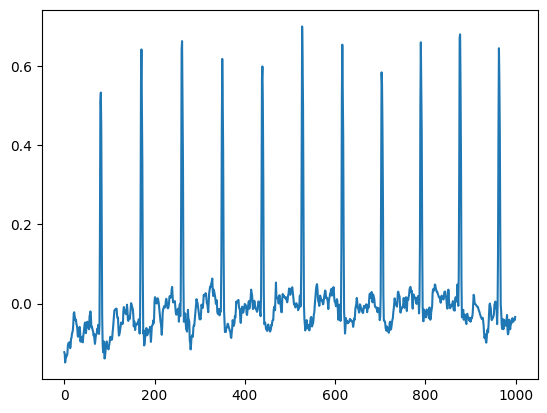

tensor([[[ 0.0620,  0.0930,  0.0670,  ...,  0.1240,  0.1110,  0.0850]],

        [[ 0.0080, -0.0120, -0.0680,  ...,  0.0050,  0.0050, -0.0120]],

        [[ 0.2710,  0.2570,  0.2150,  ..., -0.0600, -0.1420, -0.1490]],

        ...,

        [[-0.0500, -0.0620, -0.0850,  ..., -0.1450, -0.0910,  0.2740]],

        [[ 0.0830,  0.0670,  0.0370,  ..., -0.0060, -0.0040, -0.0030]],

        [[-0.0150, -0.0150, -0.0180,  ..., -0.0520, -0.0210,  0.0100]]],
       device='cuda:0')


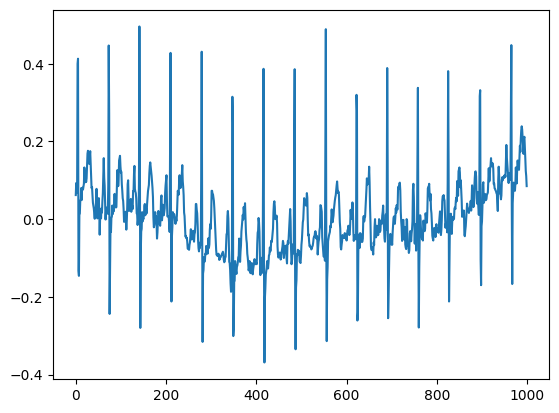

tensor([[[-0.0660, -0.0640, -0.0310,  ...,  0.0440,  0.0400,  0.0260]],

        [[ 0.0910,  0.1250,  0.1630,  ..., -0.0610, -0.2570,  0.0000]],

        [[-0.0390, -0.0540, -0.0830,  ...,  0.2280,  0.2290,  0.2190]],

        ...,

        [[-0.0200, -0.0260, -0.0440,  ..., -0.1170, -0.0300,  0.0920]],

        [[ 0.0000, -0.0030, -0.0090,  ..., -0.1740, -0.1580, -0.0140]],

        [[-0.0850, -0.0850, -0.0950,  ..., -0.0520, -0.0540, -0.0360]]],
       device='cuda:0')


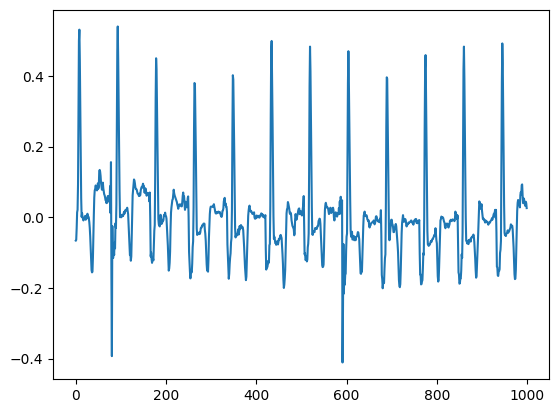

tensor([[[ 0.4140,  0.1340, -0.4900,  ..., -0.0290, -0.0510, -0.0150]],

        [[-0.0500, -0.0280, -0.0010,  ...,  0.0810,  0.0700,  0.0630]],

        [[-0.0300, -0.0300, -0.0300,  ...,  0.3050,  0.0300,  0.0800]],

        ...,

        [[-0.1550, -0.1640, -0.1700,  ...,  0.2690,  0.2080,  0.1530]],

        [[-0.0040, -0.0110, -0.0340,  ..., -0.0730, -0.0730, -0.0130]],

        [[-0.0350, -0.0510, -0.0630,  ...,  0.0930,  0.0580,  0.0860]]],
       device='cuda:0')


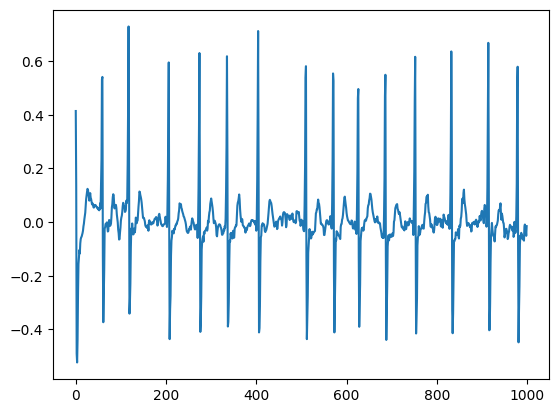

tensor([[[-0.0290, -0.0270, -0.0180,  ..., -0.0050, -0.0600, -0.0650]],

        [[-0.3230, -0.3070, -0.3310,  ...,  0.3680,  0.4180,  0.4070]],

        [[-0.0800, -0.0830, -0.0890,  ...,  0.0520,  0.0400,  0.0490]],

        ...,

        [[ 0.0060, -0.0260, -0.0330,  ...,  0.3450,  0.2560,  0.1840]],

        [[ 0.3070,  0.3130,  0.3530,  ..., -0.0390, -0.0480, -0.0570]],

        [[ 0.0290,  0.0200, -0.0090,  ..., -0.0040, -0.0040,  0.0250]]],
       device='cuda:0')


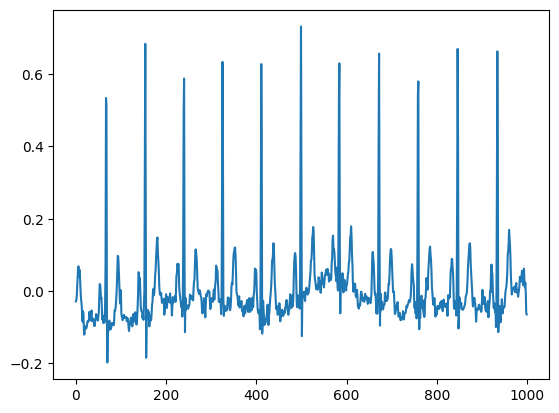

tensor([[[-0.0930, -0.0990, -0.1090,  ...,  0.2950,  0.2800,  0.2390]],

        [[-0.0250, -0.0240, -0.0230,  ..., -0.8830, -0.8480, -0.7360]],

        [[-0.0210, -0.0220, -0.0220,  ...,  0.1520,  0.1520,  0.1440]],

        ...,

        [[ 0.0430,  0.0260,  0.0020,  ...,  0.0570,  0.0810,  0.1070]],

        [[-0.2150, -0.1610, -0.1040,  ..., -0.0960, -0.0780, -0.0590]],

        [[ 0.0650,  0.0940,  0.1020,  ...,  0.2160, -0.0410,  0.0140]]],
       device='cuda:0')


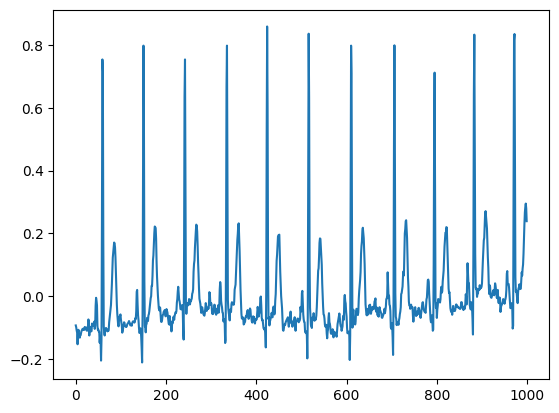

tensor([[[ 0.6130,  0.8090,  1.0120,  ..., -0.0920,  0.0230,  0.1980]],

        [[ 0.3040,  0.5240,  0.8290,  ..., -0.0230, -0.0040,  0.0240]],

        [[-0.1090, -0.0960, -0.0770,  ...,  0.0360,  0.0360,  0.0080]],

        ...,

        [[-0.0110, -0.0430, -0.0730,  ...,  0.0810,  0.1820,  0.2190]],

        [[-0.0080, -0.0050, -0.0180,  ..., -0.1770, -0.1640, -0.2390]],

        [[-0.1740, -0.1760, -0.1770,  ..., -0.1900, -0.1700, -0.1650]]],
       device='cuda:0')


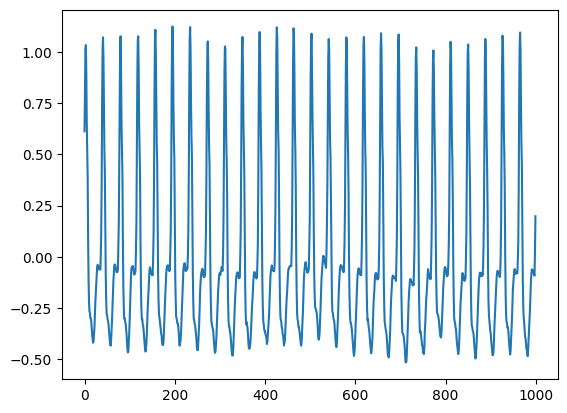

tensor([[[-0.1490, -0.1390, -0.1060,  ...,  0.0660,  0.0330,  0.0020]],

        [[-0.0550, -0.0350,  0.0550,  ..., -0.0560, -0.0430, -0.0460]],

        [[ 0.0150,  0.0180,  0.0200,  ..., -0.1000, -0.1470, -0.3660]],

        ...,

        [[-0.0350, -0.0350, -0.0350,  ...,  0.0760,  0.0780,  0.0660]],

        [[-0.1050, -0.1270, -0.1210,  ...,  0.1580,  0.1490,  0.1810]],

        [[ 0.0250,  0.0240,  0.0130,  ..., -0.0440, -0.0390,  0.0100]]],
       device='cuda:0')


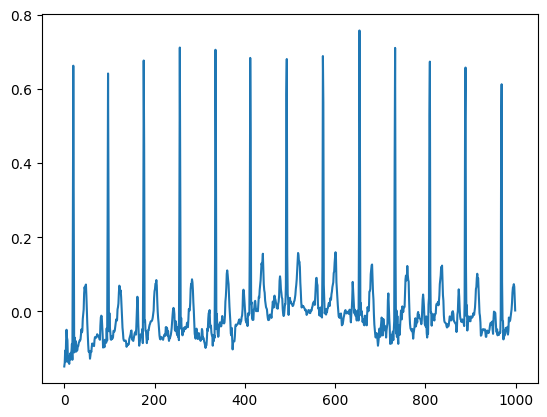

tensor([[[-0.0560, -0.0610, -0.0660,  ..., -0.0780, -0.1930, -0.0430]],

        [[ 0.0540,  0.0450,  0.0340,  ..., -0.0810, -0.0790, -0.0850]],

        [[ 0.0570,  0.0270, -0.0780,  ..., -0.1610, -0.2170, -0.2850]],

        ...,

        [[ 0.1140,  0.1170,  0.1200,  ...,  0.0140,  0.0030,  0.0000]],

        [[-0.3050, -0.3020, -0.2940,  ...,  0.9780,  0.1790, -0.1600]],

        [[ 0.1180,  0.1630,  0.1900,  ...,  0.0760,  0.1200,  0.1610]]],
       device='cuda:0')


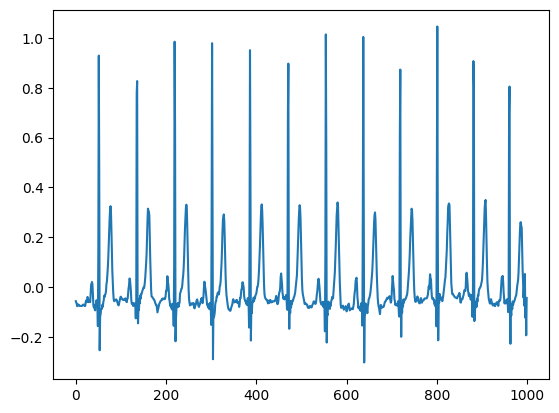

tensor([[[-0.1620, -0.1430, -0.1340,  ..., -0.0130, -0.0490, -0.0080]],

        [[ 0.0640,  0.0710,  0.0910,  ..., -0.1460, -0.0900, -0.0860]],

        [[-0.0970, -0.1240, -0.1660,  ...,  0.1040,  0.1330,  0.1330]],

        ...,

        [[-0.2700, -0.2930, -0.2790,  ...,  0.9740,  0.4920, -0.0770]],

        [[ 0.0410,  0.0470,  0.0280,  ..., -0.1180, -0.1320, -0.0610]],

        [[-0.0750, -0.0680, -0.0380,  ...,  0.0010, -0.0010,  0.0010]]],
       device='cuda:0')


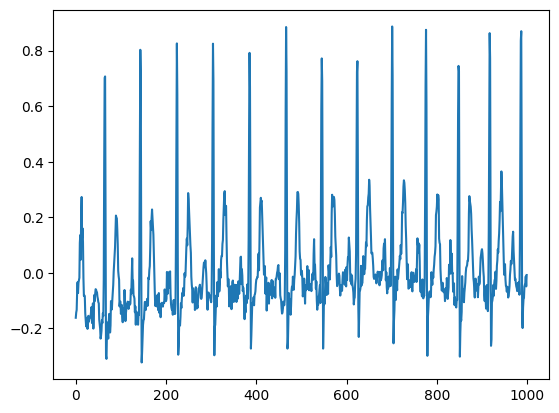

tensor([[[ 0.0200,  0.0200,  0.0250,  ..., -0.0390, -0.0390, -0.0460]],

        [[-0.0990, -0.1040, -0.1050,  ..., -0.0450, -0.0580, -0.0490]],

        [[ 0.3990,  0.3840,  0.3270,  ..., -0.0800, -0.1390, -0.1710]],

        ...,

        [[-0.0290, -0.0240, -0.0190,  ..., -0.3310,  0.1430, -0.0450]],

        [[-0.0350, -0.0350, -0.0350,  ...,  0.1530,  0.5990,  0.6940]],

        [[-0.1010, -0.1610, -0.1850,  ...,  0.2380, -0.1470, -0.3320]]],
       device='cuda:0')


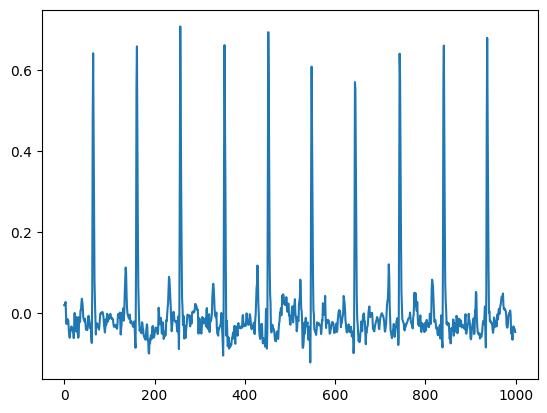

tensor([[[ 0.0310,  0.0180,  0.0120,  ..., -0.0890,  0.0890,  0.1770]],

        [[ 1.1760,  0.9320,  0.2540,  ..., -0.0550, -0.0570, -0.0670]],

        [[-0.0310, -0.0370, -0.0440,  ...,  0.2110,  0.2290,  0.2470]],

        ...,

        [[-0.0200,  0.2450,  0.6280,  ...,  0.0110,  0.0110,  0.0370]],

        [[ 0.0600,  0.0400,  0.0050,  ..., -0.0080, -0.1140, -0.1060]],

        [[-0.0910, -0.0960, -0.0950,  ..., -0.1560, -0.0280,  0.1440]]],
       device='cuda:0')


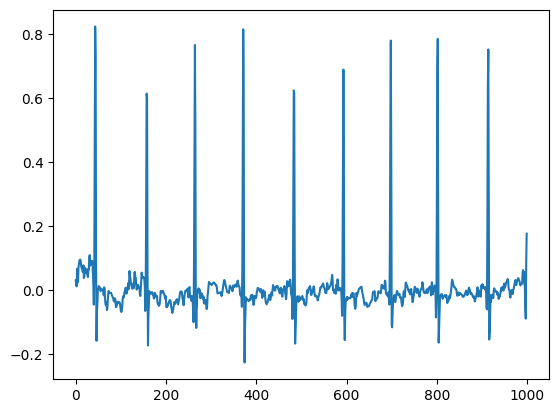

tensor([[[ 0.0070, -0.0260, -0.0480,  ..., -0.0280,  0.0150,  0.0490]],

        [[-0.0790, -0.0790, -0.0990,  ..., -0.0050, -0.0080, -0.0110]],

        [[ 0.1700,  0.1870,  0.2250,  ...,  0.2140, -0.0530, -0.1910]],

        ...,

        [[-0.2390, -0.2380, -0.2310,  ...,  0.2590,  0.2360,  0.2480]],

        [[ 0.0900,  0.1110,  0.1130,  ...,  0.2130,  0.5110,  0.2690]],

        [[-0.0580, -0.0480, -0.0400,  ..., -0.0160, -0.0040,  0.0440]]],
       device='cuda:0')


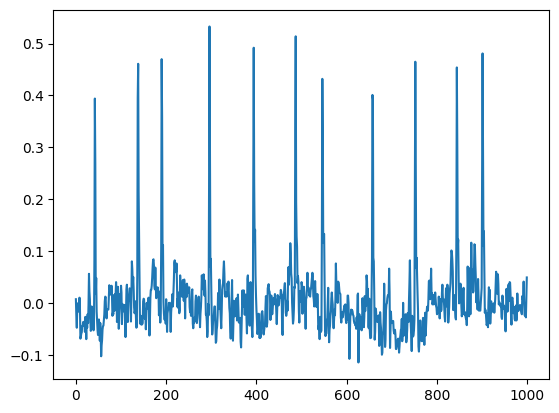

tensor([[[ 0.0380,  0.0280,  0.0220,  ..., -0.0040, -0.0250, -0.0110]],

        [[-0.0550, -0.0510, -0.0320,  ...,  0.1270,  0.1410,  0.1640]],

        [[-0.0440, -0.0490, -0.0300,  ...,  0.0580, -0.0370,  0.0190]],

        ...,

        [[-0.0430, -0.0490, -0.0230,  ...,  0.0590,  0.0940,  0.0680]],

        [[-0.0250, -0.0230, -0.0180,  ..., -0.0220,  0.0090,  0.0990]],

        [[ 1.4380,  1.4530,  1.1090,  ..., -0.0630, -0.0800, -0.0760]]],
       device='cuda:0')


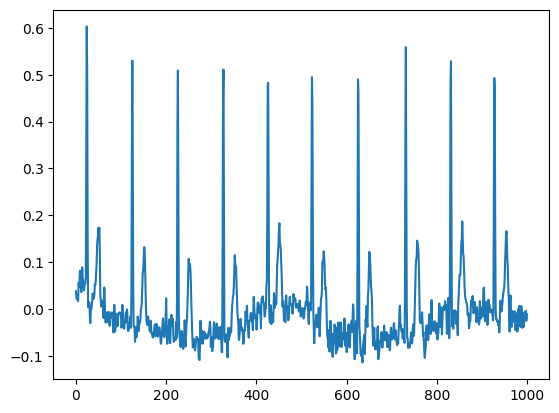

tensor([[[ 0.0500,  0.0660,  0.1020,  ...,  0.0020,  0.0060,  0.0100]],

        [[ 0.0000,  0.0000,  0.0000,  ..., -0.2200,  0.1890,  0.5540]],

        [[-0.1050, -0.1040, -0.0990,  ...,  0.0160, -0.0470,  0.1890]],

        ...,

        [[-0.1470, -0.1150, -0.0640,  ..., -0.0170,  0.0770,  0.0190]],

        [[-0.0670, -0.0350,  0.0460,  ..., -0.2670, -0.2010, -0.1610]],

        [[ 0.0550,  0.0410,  0.0320,  ..., -0.0450, -0.0400, -0.0670]]],
       device='cuda:0')


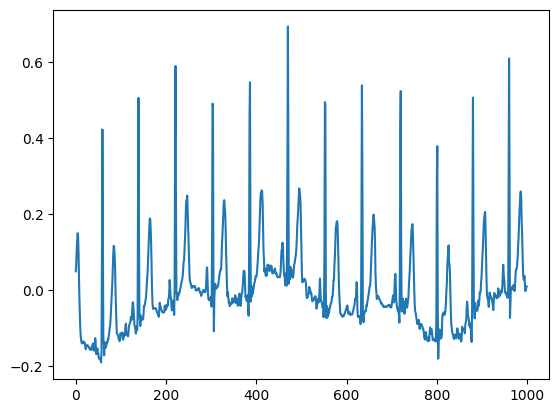

tensor([[[ 0.0440,  0.0520,  0.0700,  ..., -0.2210, -0.2230, -0.2100]],

        [[-0.0090, -0.0120, -0.0150,  ..., -0.1020, -0.1020, -0.1130]],

        [[-0.0020, -0.0270, -0.0380,  ...,  0.1330,  0.0560,  0.0720]],

        ...,

        [[ 0.2930,  0.0320, -0.1140,  ...,  0.0870,  0.1140,  0.1230]],

        [[-0.0160, -0.0190, -0.0280,  ..., -0.0420, -0.0530, -0.0450]],

        [[-0.0030, -0.0260, -0.0500,  ..., -0.0280, -0.0320, -0.0360]]],
       device='cuda:0')


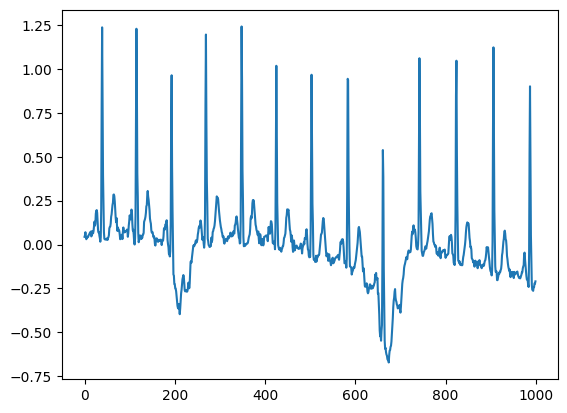

tensor([[[ 0.0330,  0.0330,  0.0270,  ...,  0.0390, -0.0060,  0.0370]],

        [[-0.0460, -0.0410, -0.0230,  ..., -0.8180, -0.8230, -0.3210]],

        [[-0.0500, -0.0500, -0.0490,  ...,  0.0430,  0.0370,  0.0150]],

        ...,

        [[-0.0050,  0.0060,  0.0030,  ..., -0.0930, -0.0790, -0.0660]],

        [[-0.0140, -0.0230, -0.0420,  ..., -0.0010,  0.0610,  0.0080]],

        [[-0.0400, -0.0390, -0.0520,  ...,  0.1150, -0.0340, -0.1140]]],
       device='cuda:0')


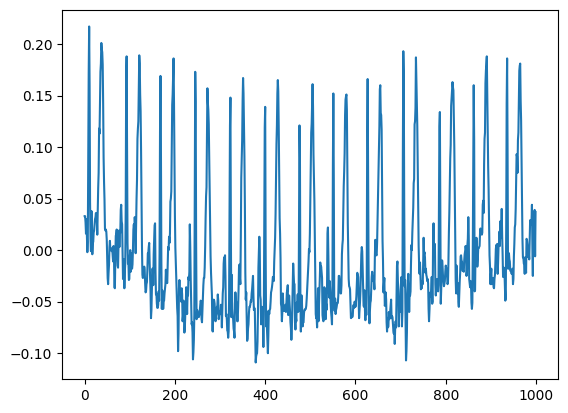

tensor([[[-0.1430, -0.1670, -0.1710,  ...,  0.0340, -0.2060, -0.1790]],

        [[-0.0140, -0.0080, -0.0030,  ...,  1.3060,  0.9880,  0.4450]],

        [[ 0.1600, -0.0160, -0.0600,  ..., -0.0920, -0.0850, -0.0860]],

        ...,

        [[-0.1320, -0.1170, -0.1280,  ..., -0.1330, -0.2690, -0.1990]],

        [[-0.1080, -0.0980, -0.0830,  ..., -0.0190, -0.0150,  0.0240]],

        [[-0.0450, -0.0420, -0.0260,  ...,  0.1430, -0.4460, -0.1660]]],
       device='cuda:0')


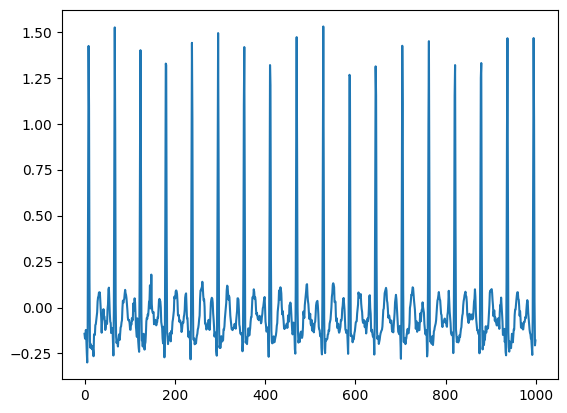

tensor([[[ 0.0070,  0.0100, -0.0080,  ..., -0.0120, -0.0050,  0.0030]],

        [[-0.0520, -0.0580, -0.0340,  ...,  0.0260,  0.0190, -0.0230]],

        [[-0.0090, -0.0050,  0.0070,  ..., -0.0340, -0.0250,  0.0050]],

        ...,

        [[-0.0080,  0.0060,  0.0020,  ...,  0.4490,  0.3720,  0.3890]],

        [[-0.0490, -0.0240, -0.0240,  ..., -0.0800,  0.0690,  0.3070]],

        [[ 0.0140,  0.0130,  0.0300,  ..., -0.1030, -0.0990, -0.0830]]],
       device='cuda:0')


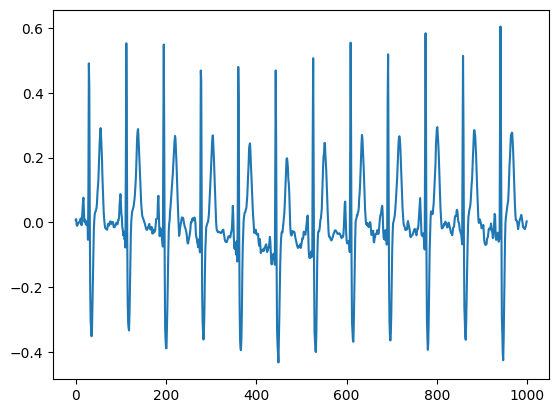

tensor([[[-0.0590, -0.0660, -0.0770,  ..., -0.0310, -0.0260,  0.0360]],

        [[ 0.0350,  0.0490,  0.0070,  ..., -0.0130, -0.0230,  0.0200]],

        [[-0.0770, -0.0830, -0.0850,  ...,  0.0080,  0.0010,  0.0180]],

        ...,

        [[-0.1500, -0.1480, -0.1420,  ...,  0.0410,  0.0390,  0.0010]],

        [[-0.0540, -0.0450, -0.0520,  ..., -0.0570, -0.0310,  0.0020]],

        [[ 0.0250, -0.0150,  0.0230,  ...,  0.1730,  0.1380,  0.0930]]],
       device='cuda:0')


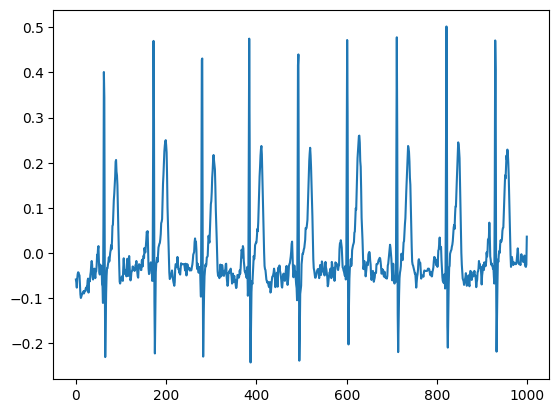

tensor([[[ 0.0600,  0.0500,  0.0330,  ..., -0.0600, -0.0780, -0.0880]],

        [[-0.0850, -0.0920, -0.1020,  ..., -0.1110, -0.1100, -0.1270]],

        [[-0.0200, -0.0200, -0.0110,  ..., -0.0150, -0.0650, -0.0420]],

        ...,

        [[-0.0510, -0.0330, -0.0090,  ...,  0.0260, -0.6320, -0.9430]],

        [[-0.0300, -0.0180, -0.0310,  ..., -0.0260, -0.0470, -0.0770]],

        [[-0.0330, -0.0460, -0.0410,  ..., -0.0860, -0.1260, -0.0880]]],
       device='cuda:0')


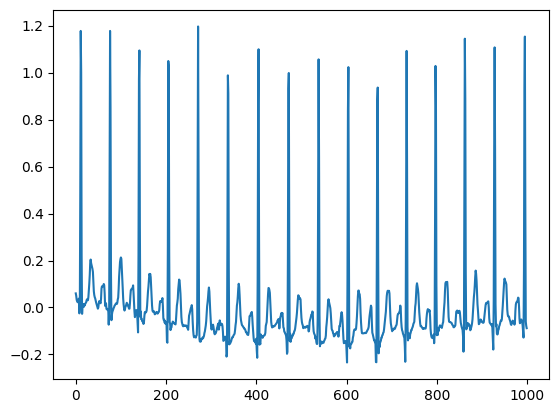

tensor([[[-0.0200, -0.0200, -0.0230,  ..., -0.2370, -0.0050, -0.0010]],

        [[ 0.2610,  0.2710,  0.2990,  ..., -0.0160, -0.0140,  0.0090]],

        [[-0.0780, -0.0630, -0.0790,  ...,  0.0410,  0.0160, -0.0030]],

        ...,

        [[-0.2050, -0.2030, -0.2000,  ...,  0.1170,  0.5920,  0.8430]],

        [[-0.0040,  0.0310,  0.1640,  ...,  0.0680,  0.0520,  0.0400]],

        [[-0.0600, -0.0570, -0.0540,  ...,  0.0220,  0.0190,  0.0200]]],
       device='cuda:0')


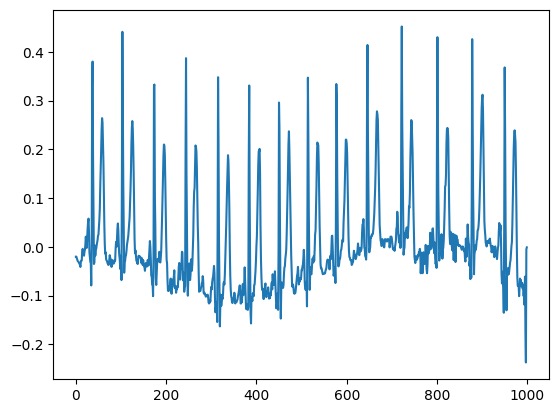

tensor([[[-0.0160, -0.0150, -0.0140,  ...,  0.0580,  0.0520,  0.0210]],

        [[ 0.0940,  0.0970,  0.1190,  ...,  0.1240,  0.1630,  0.1660]],

        [[ 0.2150,  0.2030,  0.1230,  ...,  0.0430,  0.0350,  0.0400]],

        ...,

        [[ 0.0080,  0.0000,  0.0030,  ...,  0.4270,  0.4510,  0.4630]],

        [[-0.1240, -0.0800, -0.0360,  ...,  0.0270,  0.0130, -0.0560]],

        [[-0.1190, -0.1080, -0.0840,  ..., -0.0080, -0.0470, -0.1860]]],
       device='cuda:0')


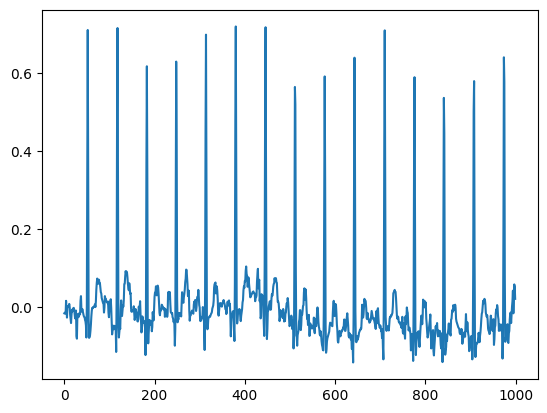

tensor([[[-0.0360, -0.0550, -0.0630,  ...,  0.0550,  0.0140,  0.0260]],

        [[-0.0010, -0.0050, -0.0050,  ...,  0.1900,  0.1570,  0.1450]],

        [[-0.0650, -0.0660, -0.0890,  ...,  0.0050,  0.0270,  0.0770]],

        ...,

        [[-0.0390, -0.0380, -0.0190,  ..., -0.1340, -0.1290, -0.1450]],

        [[ 0.0690,  0.0500,  0.0210,  ..., -0.0160, -0.0410, -0.0470]],

        [[-0.0170,  0.0700,  0.1050,  ..., -0.0720, -0.0720, -0.0480]]],
       device='cuda:0')


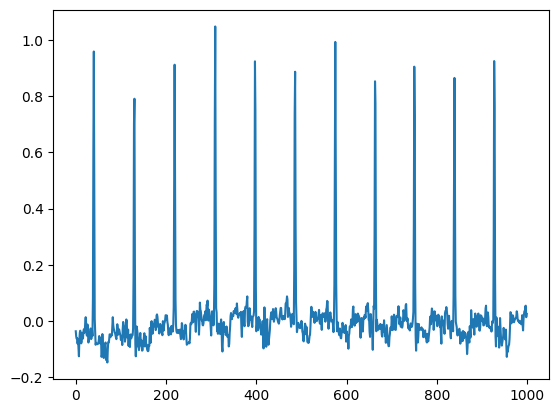

tensor([[[ 0.0200,  0.0380,  0.0600,  ..., -0.1000, -0.1480, -0.1030]],

        [[-0.0040,  0.0070,  0.0250,  ..., -0.0250, -0.0350, -0.0370]],

        [[-0.3000, -0.3050, -0.3070,  ..., -0.2260, -0.2090, -0.1700]],

        ...,

        [[ 0.0040,  0.0080,  0.0080,  ...,  0.0160,  0.0130,  0.0210]],

        [[-0.0050, -0.0030,  0.0030,  ...,  0.0560,  0.0170, -0.0090]],

        [[-0.1990, -0.2060, -0.2210,  ...,  0.0890,  0.0710,  0.0560]]],
       device='cuda:0')


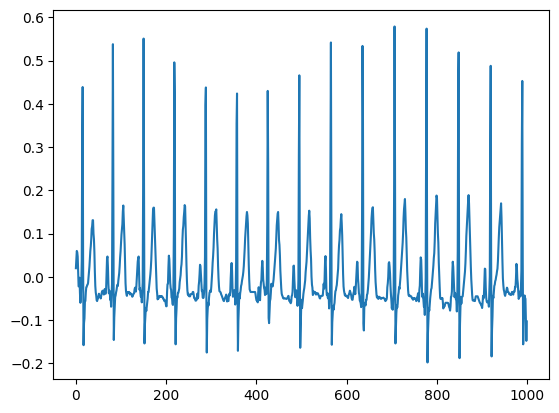

tensor([[[-0.1790, -0.1680, -0.1520,  ...,  1.4690,  1.5110,  1.4960]],

        [[ 0.2430,  0.0890, -0.1100,  ..., -0.0250, -0.0130,  0.0280]],

        [[-0.1500, -0.1490, -0.1600,  ...,  0.0170,  0.0170,  0.0100]],

        ...,

        [[-0.2190, -0.2160, -0.2370,  ...,  0.3760,  0.2690,  0.3770]],

        [[-0.0120,  0.0400,  0.0350,  ...,  0.1210,  0.0990,  0.0930]],

        [[ 0.0030,  0.0020,  0.0050,  ..., -0.0230, -0.0590, -0.0780]]],
       device='cuda:0')


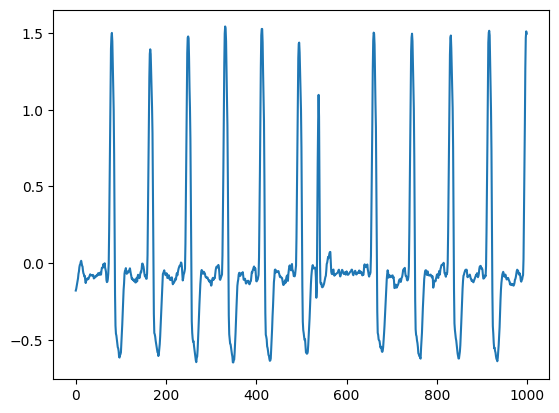

tensor([[[ 0.0630,  0.1020,  0.0750,  ...,  0.2060,  0.2320,  0.2260]],

        [[ 0.1050,  0.1020,  0.1060,  ..., -0.0530, -0.0550, -0.0360]],

        [[-0.0450, -0.0440, -0.0410,  ..., -0.0270, -0.0610, -0.0730]],

        ...,

        [[-0.0730, -0.0660, -0.0350,  ...,  0.0480,  0.0180,  0.0860]],

        [[ 0.0200,  0.0220,  0.0270,  ..., -0.0450, -0.0520, -0.0550]],

        [[ 0.0000,  0.0020,  0.0080,  ..., -0.4570, -0.2700,  0.0150]]],
       device='cuda:0')


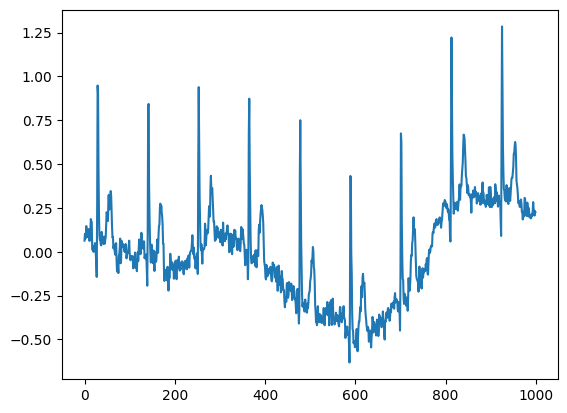

tensor([[[-0.0050, -0.0050, -0.0050,  ..., -0.0280, -0.0170, -0.0320]],

        [[ 0.0030,  0.0030,  0.0320,  ...,  0.0290,  0.0320, -0.0350]],

        [[ 0.0270,  0.0230,  0.0270,  ..., -0.0810, -0.1160, -0.0990]],

        ...,

        [[ 0.2150,  0.2440,  0.3020,  ...,  0.0830,  0.0880,  0.0970]],

        [[-0.2010, -0.2080, -0.2080,  ..., -0.1260, -0.0930, -0.0740]],

        [[ 0.1000,  0.0920,  0.0700,  ...,  0.0250,  0.0210,  0.0340]]],
       device='cuda:0')


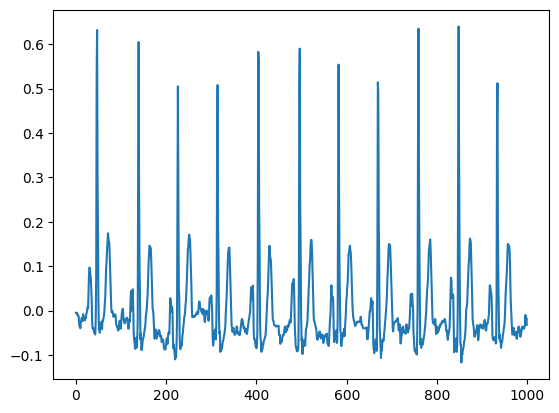

tensor([[[-0.0460, -0.0440, -0.0280,  ..., -0.0920, -0.1130, -0.0970]],

        [[ 0.0260,  0.0680,  0.0610,  ...,  0.0370,  0.0340,  0.0400]],

        [[ 0.7020,  0.5490,  0.2870,  ..., -0.0070, -0.0060, -0.0090]],

        ...,

        [[-0.1260, -0.1280, -0.1280,  ..., -0.0850, -0.1590, -0.2220]],

        [[ 0.0290,  0.0350,  0.0480,  ...,  0.3380,  0.4370,  0.0970]],

        [[-0.1180, -0.0980, -0.0880,  ..., -0.3470, -0.3080,  0.2670]]],
       device='cuda:0')


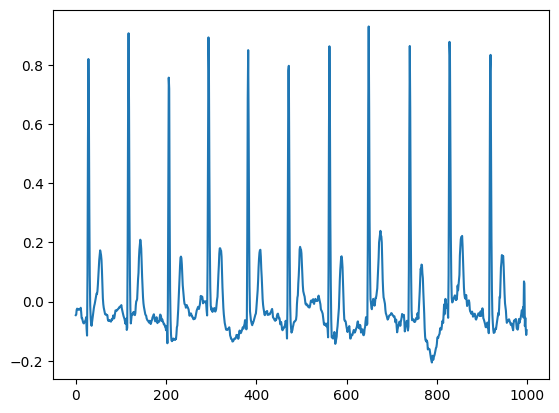

tensor([[[-0.1590, -0.1400, -0.1150,  ...,  0.1870,  0.2420,  0.1560]],

        [[ 0.0210,  0.0470,  0.0760,  ...,  0.0220,  0.1150,  0.0410]],

        [[-0.1000, -0.1020, -0.1050,  ...,  0.2700,  0.0290, -0.0880]],

        ...,

        [[-0.0360, -0.0840, -0.0940,  ...,  0.0090, -0.0120, -0.0890]],

        [[-0.0510, -0.0510, -0.0460,  ..., -0.0770, -0.0400,  0.1030]],

        [[-0.0530, -0.0430, -0.0480,  ..., -0.0590, -0.0600, -0.0740]]],
       device='cuda:0')


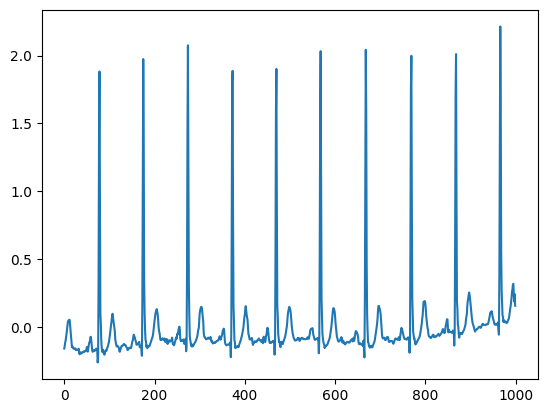

tensor([[[-0.3140, -0.3110, -0.3070,  ..., -0.2080, -0.1770, -0.1550]],

        [[ 0.1900,  0.1690,  0.1410,  ...,  0.0470,  0.0240,  0.0250]],

        [[-0.0120, -0.0180, -0.0040,  ...,  0.0200, -0.0320,  0.0180]],

        ...,

        [[-0.4560, -0.3180, -0.1750,  ..., -0.0630, -0.0070,  0.0570]],

        [[-0.0490, -0.0590, -0.0610,  ..., -0.1640, -0.1560, -0.1350]],

        [[-0.1100, -0.1100, -0.1100,  ..., -0.2460, -0.1180, -0.0450]]],
       device='cuda:0')


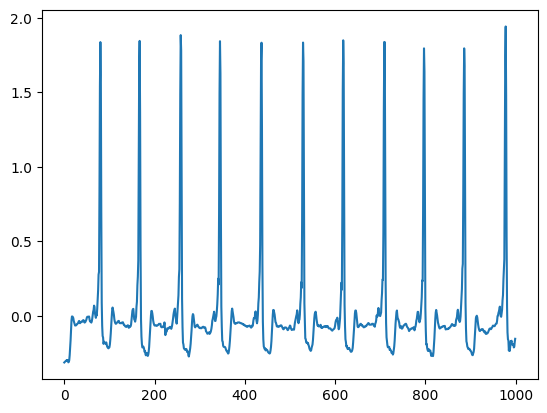

tensor([[[-0.0530, -0.0600, -0.0800,  ...,  0.0560,  0.2750,  0.1250]],

        [[ 0.0470,  0.0540,  0.1130,  ..., -0.0730, -0.0810, -0.0800]],

        [[ 0.0160,  0.0150,  0.0170,  ..., -0.0810, -0.0870, -0.0730]],

        ...,

        [[ 0.6700,  0.5530,  0.3640,  ...,  0.0640,  0.0620,  0.0480]],

        [[-0.0400, -0.0430, -0.0400,  ..., -0.0200, -0.0580, -0.1640]],

        [[-0.0460, -0.0450, -0.0400,  ..., -0.1140, -0.1090, -0.0010]]],
       device='cuda:0')


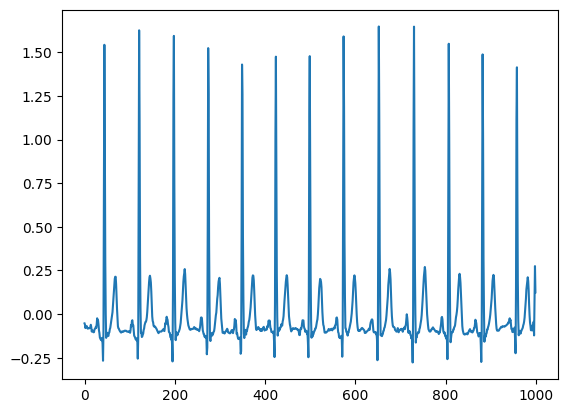

tensor([[[-0.0510, -0.0560, -0.0640,  ..., -0.2240, -0.2760,  0.0430]],

        [[ 0.0790,  0.0670,  0.0710,  ..., -0.0120, -0.0380,  0.0140]],

        [[-0.0400, -0.0520, -0.0530,  ..., -0.0200, -0.0680, -0.0330]],

        ...,

        [[-0.0200, -0.0180, -0.0220,  ..., -0.0170, -0.0580, -0.0020]],

        [[-0.1420, -0.0150,  0.5290,  ..., -0.1460, -0.1550, -0.1630]],

        [[-0.1220, -0.4290, -0.3650,  ...,  0.0150,  0.0060, -0.0930]]],
       device='cuda:0')


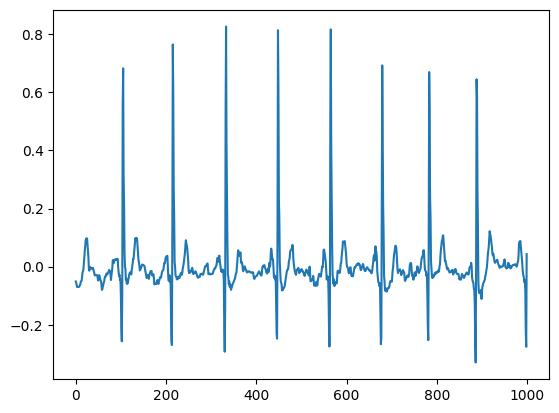

tensor([[[-0.0690, -0.0650, -0.0630,  ..., -0.0410, -0.0540, -0.0640]],

        [[ 0.2860,  0.2290,  0.1570,  ..., -0.0480, -0.0180, -0.0330]],

        [[-0.1280, -0.0830, -0.0790,  ...,  0.1390,  0.1270,  0.0570]],

        ...,

        [[ 0.0560,  0.0570,  0.0550,  ..., -0.0390,  0.0700, -0.0160]],

        [[-0.0540, -0.0510, -0.0450,  ...,  0.0260,  0.0230,  0.0440]],

        [[ 0.0130, -0.0020,  0.0050,  ...,  0.0790,  0.0170, -0.0030]]],
       device='cuda:0')


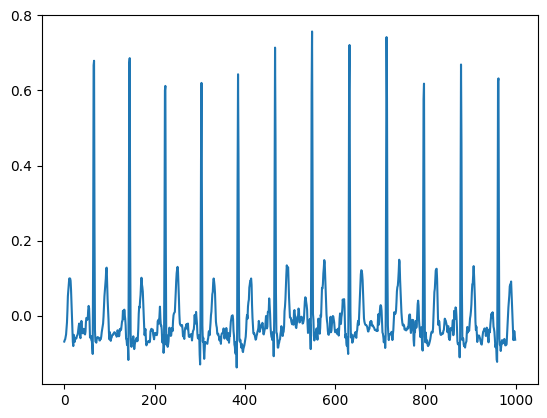

tensor([[[-0.1150, -0.1120, -0.1140,  ..., -0.0400, -0.0100, -0.0100]],

        [[ 0.0540,  0.0410,  0.0700,  ..., -0.0710, -0.0930, -0.0880]],

        [[ 0.1570,  0.1720,  0.1740,  ..., -0.0440, -0.1020, -0.0950]],

        ...,

        [[-0.0380, -0.0580, -0.0430,  ...,  0.1120,  0.1020,  0.0800]],

        [[-0.0170, -0.0270, -0.0240,  ..., -0.0890, -0.1210, -0.2010]],

        [[-0.0700, -0.0860, -0.0650,  ..., -0.0100,  0.0830,  0.1160]]],
       device='cuda:0')


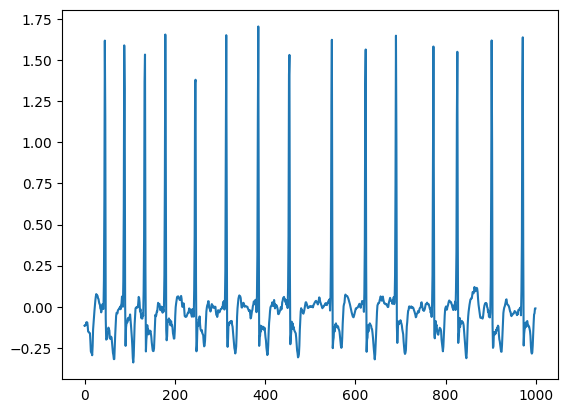

tensor([[[ 0.1200,  0.1200,  0.1200,  ...,  0.0130,  0.0070, -0.0670]],

        [[-0.0120,  0.0030, -0.0020,  ...,  0.4440,  0.2930,  0.0490]],

        [[ 0.0240,  0.0260,  0.0330,  ..., -0.0980,  0.0250, -0.0670]],

        ...,

        [[ 0.0290,  0.0270,  0.0420,  ...,  0.2480,  0.3310,  0.2760]],

        [[-0.0550, -0.0540, -0.0510,  ...,  0.0950,  0.1080,  0.0990]],

        [[ 0.0600,  0.0430,  0.0080,  ..., -0.0340, -0.2310, -0.2950]]],
       device='cuda:0')


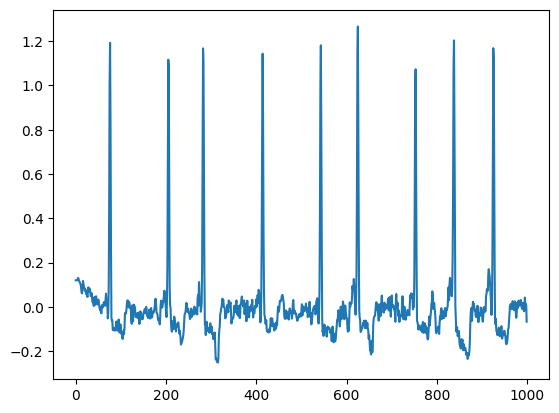

tensor([[[-8.0000e-03, -2.0000e-03, -2.0000e-02,  ..., -4.1000e-02,
          -5.0000e-02, -7.2000e-02]],

        [[ 7.3000e-02,  3.0000e-02, -4.9000e-02,  ...,  3.0000e-02,
           5.0000e-02,  7.8000e-02]],

        [[-7.4000e-02, -6.3000e-02, -7.7000e-02,  ..., -5.3000e-02,
          -1.4400e-01, -1.9300e-01]],

        ...,

        [[ 7.6000e-02,  9.6000e-02,  1.0100e-01,  ..., -1.0100e-01,
          -1.0500e-01, -1.9700e-01]],

        [[ 4.6500e-01,  9.1800e-01,  1.3440e+00,  ...,  2.0000e-02,
          -1.0000e-03,  4.8000e-02]],

        [[-2.0000e-02, -1.9000e-02, -1.4000e-02,  ...,  1.3400e-01,
           1.3500e-01,  1.4800e-01]]], device='cuda:0')


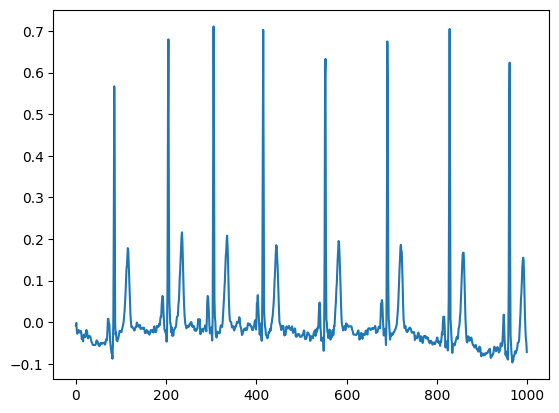

tensor([[[ 0.0900,  0.0630,  0.0700,  ..., -0.0080, -0.0010,  0.0030]],

        [[-0.0460, -0.0240,  0.0150,  ...,  0.0510,  0.0640,  0.0410]],

        [[ 0.0340,  0.0490,  0.1610,  ..., -0.0170,  0.0010,  0.0370]],

        ...,

        [[ 0.4630,  0.2280,  0.0980,  ...,  0.0140, -0.0370, -0.0060]],

        [[-0.1000, -0.1030, -0.1000,  ...,  0.0550,  0.0810,  0.0610]],

        [[ 0.1750,  0.1500,  0.1230,  ..., -0.2220, -0.2240, -0.2410]]],
       device='cuda:0')


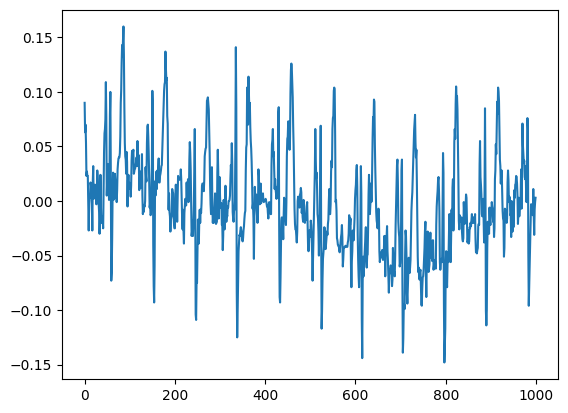

tensor([[[-0.0790, -0.0730, -0.0820,  ..., -0.0810, -0.0510, -0.0540]],

        [[-0.1150, -0.1230, -0.1230,  ...,  0.0690,  0.0220, -0.0040]],

        [[ 0.1790,  0.1760,  0.1710,  ..., -0.0030, -0.0010, -0.0080]],

        ...,

        [[-0.0040, -0.0170, -0.0130,  ...,  0.0170, -0.1060, -0.2240]],

        [[ 0.2250,  0.2290,  0.2500,  ..., -0.1680, -0.1530, -0.1420]],

        [[-0.0290, -0.0470, -0.0790,  ..., -0.0690, -0.0890, -0.0800]]],
       device='cuda:0')


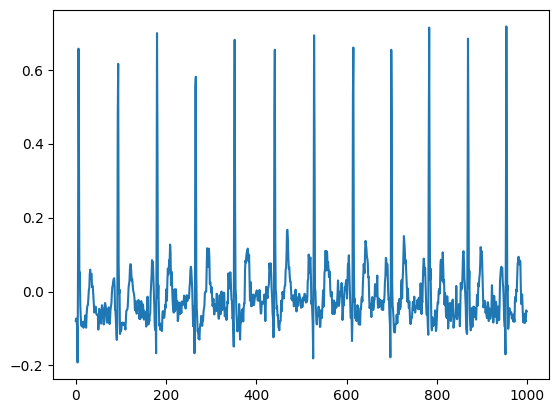

tensor([[[-0.0560, -0.0150, -0.0360,  ..., -0.0180, -0.0710, -0.1880]],

        [[ 0.1680,  0.1570,  0.1500,  ...,  0.1050,  0.0900,  0.0230]],

        [[ 0.0990,  0.1100,  0.0770,  ...,  0.1110,  0.5890,  0.4770]],

        ...,

        [[ 0.1660,  0.1570,  0.1790,  ...,  0.7060,  0.4200,  0.0100]],

        [[-0.0750, -0.0660, -0.1060,  ...,  0.0040,  0.0040,  0.0050]],

        [[ 0.0160,  0.0100, -0.0060,  ..., -0.0450, -0.0480, -0.0510]]],
       device='cuda:0')


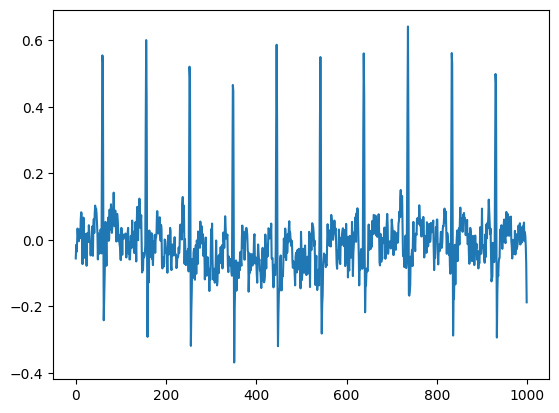

tensor([[[-0.2730, -0.2930, -0.3110,  ...,  0.0350, -0.0300, -0.1000]],

        [[-0.0380, -0.0490, -0.0840,  ..., -0.0150, -0.0060, -0.0400]],

        [[ 0.0760,  0.1090,  0.0900,  ..., -0.0040,  0.0050, -0.0570]],

        ...,

        [[ 0.0080, -0.0150, -0.0380,  ...,  0.1600,  0.1510,  0.1840]],

        [[ 0.0690,  0.0760,  0.0570,  ...,  0.0460,  0.0380, -0.0730]],

        [[-0.0150, -0.0250, -0.0490,  ..., -0.4540,  0.0250, -0.0840]]],
       device='cuda:0')


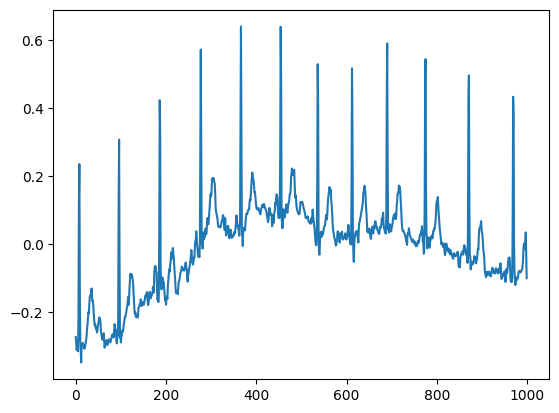

tensor([[[-0.0890, -0.0900, -0.1120,  ..., -0.0170, -0.0190, -0.0500]],

        [[ 0.1830,  0.1280,  0.0110,  ...,  0.0160,  0.0140, -0.0030]],

        [[-0.1430, -0.1470,  0.0010,  ..., -0.2970, -0.3350, -0.3420]],

        ...,

        [[ 0.0210,  0.0210,  0.0220,  ..., -0.0350, -0.0140, -0.0300]],

        [[-0.0550, -0.0850, -0.0760,  ...,  0.0840,  0.0710,  0.0670]],

        [[-0.0070, -0.0100, -0.0410,  ...,  0.1210, -0.2130, -0.7200]]],
       device='cuda:0')


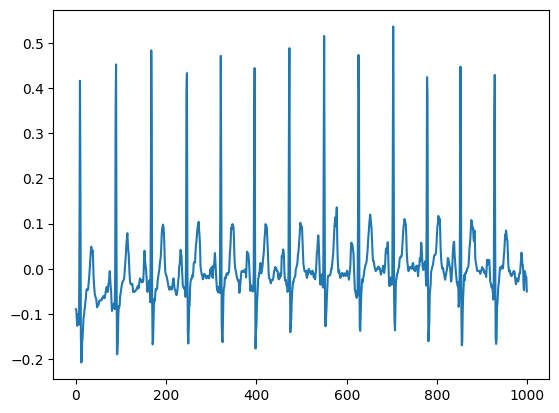

tensor([[[-0.0810, -0.0830, -0.0610,  ...,  0.0590,  0.0860,  0.0410]],

        [[-0.1190, -0.1240, -0.1930,  ...,  0.0080, -0.0190, -0.0450]],

        [[ 0.0550,  0.1060,  0.1160,  ...,  0.1410,  0.1160,  0.1090]],

        ...,

        [[ 0.0180,  0.0160, -0.0060,  ...,  0.0250,  0.0050,  0.0920]],

        [[ 0.3080,  0.1530, -0.1300,  ..., -0.1540, -0.1720, -0.1340]],

        [[-0.0240, -0.0060,  0.0060,  ...,  0.0280,  0.0210,  0.0140]]],
       device='cuda:0')


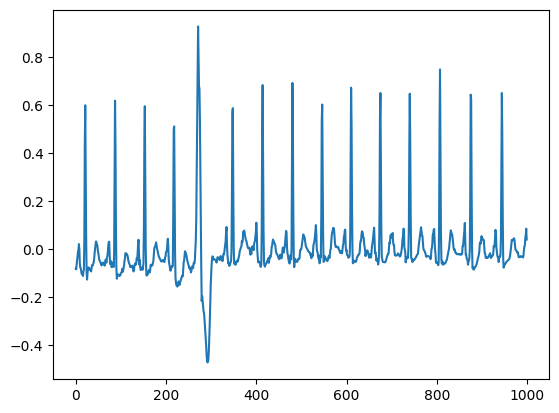

tensor([[[-0.0750, -0.0790, -0.0870,  ..., -0.0400, -0.0250, -0.0240]],

        [[-0.0740, -0.0810, -0.0600,  ...,  0.0630,  0.0330,  0.0510]],

        [[ 0.3010,  0.3090,  0.3250,  ...,  0.5490,  0.4910,  0.5320]],

        ...,

        [[-0.0520,  0.0870,  0.4970,  ...,  0.0060, -0.0620, -0.1840]],

        [[-0.0870, -0.0720, -0.0610,  ...,  0.0230,  0.0350,  0.0380]],

        [[ 0.0300,  0.0350,  0.0390,  ...,  0.0190,  0.0620,  0.0520]]],
       device='cuda:0')


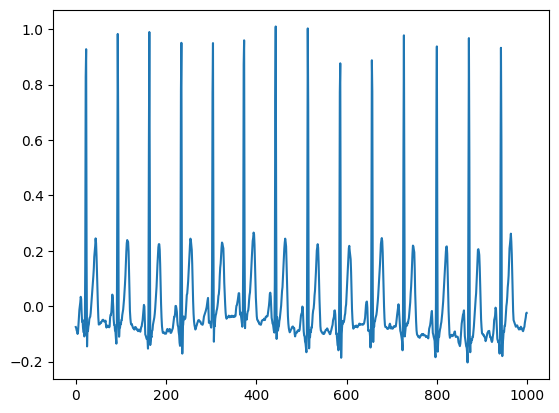

tensor([[[-0.0410, -0.0500, -0.0510,  ...,  0.0580,  0.0680,  0.0820]],

        [[-0.0390, -0.0510, -0.0810,  ..., -0.0490, -0.0230, -0.0240]],

        [[ 0.0140, -0.0390, -0.0270,  ..., -0.0260, -0.0340, -0.0320]],

        ...,

        [[-0.0880, -0.1150, -0.1090,  ..., -0.0250,  0.0640,  0.2220]],

        [[-0.1100, -0.0840, -0.0970,  ..., -0.0840, -0.1220, -0.1020]],

        [[-0.0800, -0.0840, -0.0900,  ...,  0.0200, -0.0470,  0.1220]]],
       device='cuda:0')


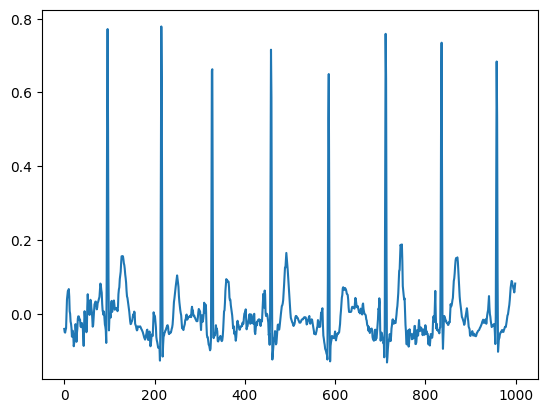

tensor([[[ 0.3480,  0.4580,  0.5330,  ..., -0.0110,  0.0010,  0.0240]],

        [[-0.0490, -0.0550, -0.0200,  ...,  0.0450,  0.0160,  0.0240]],

        [[ 0.0210,  0.0510,  0.0490,  ...,  0.1450,  0.2590,  0.2400]],

        ...,

        [[ 0.0200,  0.0190,  0.0220,  ..., -0.0750, -0.0830, -0.0860]],

        [[-0.1540, -0.1060,  0.0460,  ...,  0.0540,  0.1550,  0.3690]],

        [[-0.0810, -0.1120, -0.1570,  ...,  0.0010,  0.0120,  0.0210]]],
       device='cuda:0')


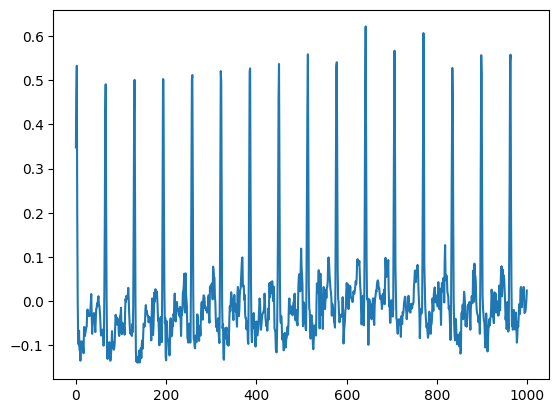

tensor([[[ 0.3340,  0.3020,  0.2380,  ..., -0.1480,  0.2250,  1.0140]],

        [[ 0.0110,  0.0030, -0.0240,  ...,  0.6150,  0.5820,  0.6610]],

        [[-0.1240,  0.0220, -0.0640,  ...,  0.0140,  0.0410,  0.1210]],

        ...,

        [[-0.0100, -0.0090, -0.0070,  ..., -0.0420,  0.0460,  0.0920]],

        [[-0.0360, -0.0540, -0.0560,  ..., -0.1500, -0.1480, -0.1690]],

        [[ 0.0050,  0.0130,  0.0270,  ..., -0.0130, -0.0340, -0.0980]]],
       device='cuda:0')


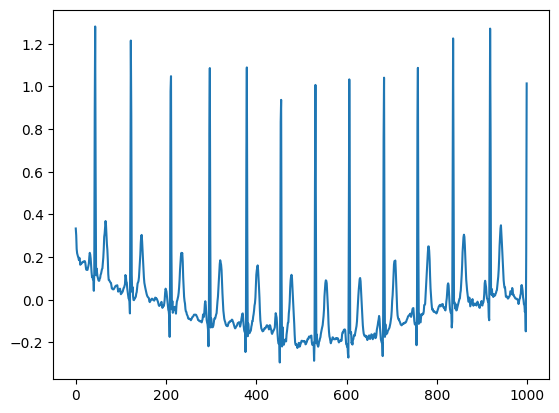

tensor([[[ 0.0230,  0.0230,  0.0370,  ...,  0.0610,  0.1700,  0.1300]],

        [[-0.0250, -0.0250, -0.0250,  ...,  0.0310,  0.2550,  0.2720]],

        [[ 0.3690,  0.3610,  0.2920,  ..., -0.0100,  0.0320,  0.0190]],

        ...,

        [[ 0.2480,  0.2550,  0.2780,  ..., -0.1450, -0.1280, -0.1080]],

        [[-0.0430, -0.0330, -0.0290,  ..., -0.0130,  0.0190,  0.0150]],

        [[-0.1300, -0.1300, -0.1330,  ...,  0.0400,  0.0230,  0.0200]]],
       device='cuda:0')


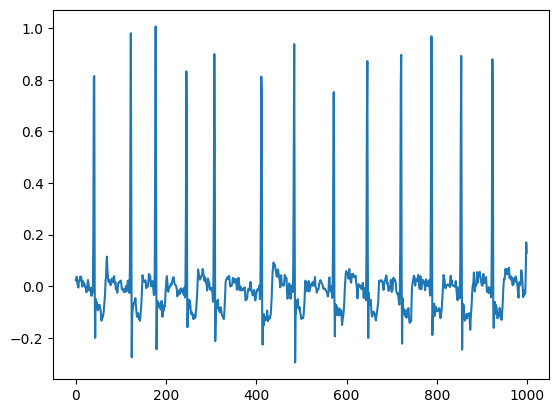

tensor([[[-0.2220, -0.2360, -0.2380,  ...,  0.1260,  0.0890,  0.0800]],

        [[-0.1030, -0.0500,  0.0810,  ..., -0.0220, -0.0060, -0.0010]],

        [[ 0.5090,  0.2840, -0.1150,  ..., -0.0510, -0.0560, -0.0470]],

        ...,

        [[-0.0400, -0.0420, -0.0490,  ...,  0.0460,  0.2060,  0.5770]],

        [[-0.0710, -0.0690, -0.1130,  ..., -0.0080, -0.0350, -0.0540]],

        [[-0.0350, -0.0390, -0.0550,  ..., -0.0650, -0.0760, -0.1160]]],
       device='cuda:0')


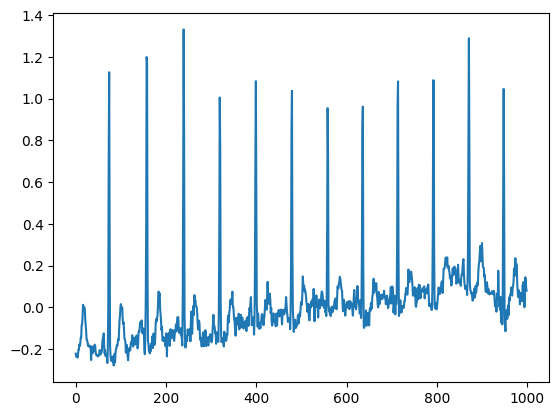

tensor([[[-2.1900e-01, -2.1300e-01, -2.0900e-01,  ...,  1.5200e-01,
           6.2200e-01,  8.0400e-01]],

        [[-1.6700e-01, -1.9200e-01, -1.8200e-01,  ...,  2.9500e-01,
           1.1560e+00,  1.4690e+00]],

        [[ 2.1000e-02,  2.5000e-02,  2.5000e-02,  ..., -5.3000e-02,
          -6.1000e-02, -2.4000e-02]],

        ...,

        [[-7.6000e-02, -8.3000e-02, -7.8000e-02,  ...,  1.1000e-02,
           1.0000e-03, -1.9600e-01]],

        [[-1.3600e-01, -1.0900e-01, -8.6000e-02,  ..., -2.4000e-02,
           1.4000e-02,  1.0000e-03]],

        [[ 3.0000e-02,  3.3000e-02,  5.3000e-02,  ...,  7.7000e-02,
           9.7000e-02,  1.2900e-01]]], device='cuda:0')


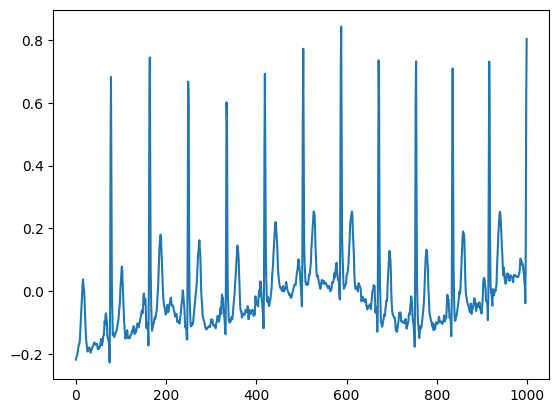

tensor([[[-0.0550, -0.0260, -0.0220,  ...,  0.0330,  0.0230,  0.0380]],

        [[ 0.0210,  0.0220,  0.0150,  ..., -0.0410, -0.0520, -0.0460]],

        [[-0.1660, -0.1160, -0.0730,  ..., -0.0350, -0.1260, -0.2890]],

        ...,

        [[-0.1290, -0.1240, -0.1160,  ...,  0.0090,  0.0290,  0.0410]],

        [[ 0.0370,  0.0340,  0.1230,  ..., -0.3620, -0.0320,  0.0810]],

        [[-0.0560, -0.0590, -0.0550,  ..., -0.0750, -0.0650, -0.0880]]],
       device='cuda:0')


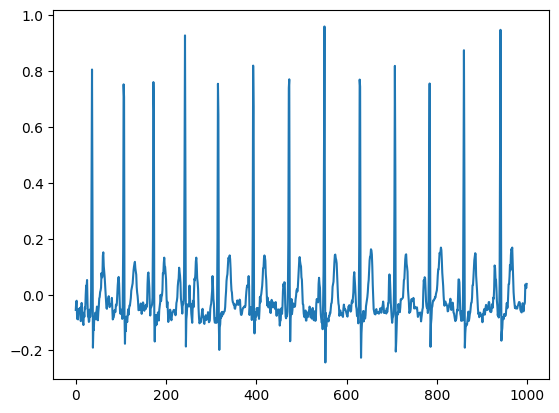

tensor([[[-0.0200, -0.0210, -0.0230,  ...,  0.1400,  0.0330,  0.0420]],

        [[ 0.1990,  0.2300,  0.2550,  ..., -0.1040, -0.0690, -0.0180]],

        [[-0.0730, -0.0790, -0.1040,  ...,  0.1080,  0.0790,  0.0480]],

        ...,

        [[ 0.0010,  0.0050,  0.0080,  ..., -0.0430, -0.0930,  0.0010]],

        [[ 0.2500,  0.2450,  0.2270,  ..., -0.2080,  0.0390,  0.0590]],

        [[-0.1200, -0.1370, -0.1800,  ..., -0.1430, -0.1460, -0.1120]]],
       device='cuda:0')


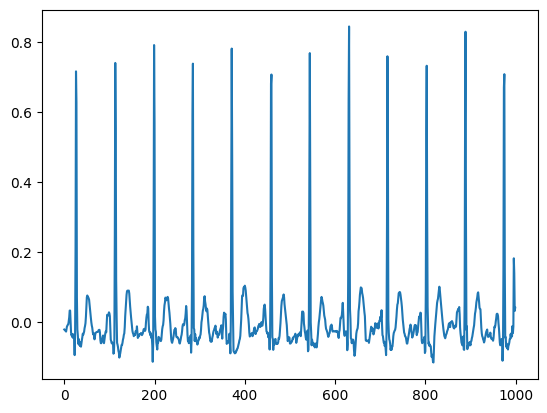

tensor([[[-0.0370, -0.0120, -0.0400,  ..., -0.0160, -0.0470, -0.0240]],

        [[-0.0700, -0.0690, -0.0670,  ..., -0.0810, -0.1360, -0.1570]],

        [[ 0.0510,  0.0310,  0.0510,  ...,  0.0610,  0.1100,  0.0800]],

        ...,

        [[-0.0400, -0.0400, -0.0400,  ...,  0.0830,  0.0710,  0.1300]],

        [[-0.0380, -0.0200, -0.0210,  ..., -0.0630, -0.0190,  0.0130]],

        [[ 0.0740,  0.0760,  0.0920,  ..., -0.0980, -0.0510, -0.1450]]],
       device='cuda:0')


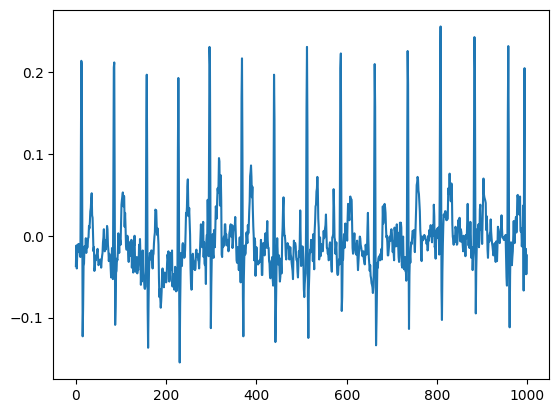

tensor([[[ 0.6010,  0.3170, -0.0100,  ..., -0.0580, -0.0670, -0.0770]],

        [[ 0.0890,  0.0670,  0.0380,  ..., -0.0740, -0.0560, -0.0390]],

        [[-0.0510, -0.0530, -0.0530,  ...,  0.1590,  0.2090,  0.2240]],

        ...,

        [[-0.0970, -0.0440, -0.0540,  ..., -0.0800, -0.0720, -0.1720]],

        [[ 0.1290,  0.1440,  0.1520,  ...,  0.0680, -0.0350, -0.0550]],

        [[-0.0850, -0.0900, -0.0660,  ...,  0.0420,  0.0070, -0.0200]]],
       device='cuda:0')


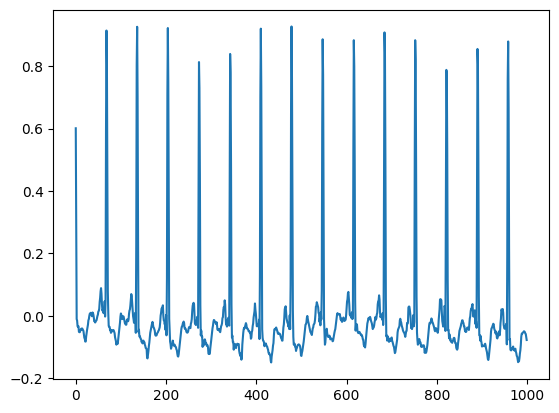

tensor([[[-0.1100, -0.1260, -0.0730,  ...,  0.0160,  0.0070,  0.0100]],

        [[ 0.0460,  0.0520,  0.0610,  ..., -0.0660, -0.0550, -0.0830]],

        [[-0.1690, -0.1730, -0.1910,  ...,  0.0310,  0.0310,  0.0720]],

        ...,

        [[-0.0170, -0.0340, -0.0450,  ...,  0.3960,  0.8690,  0.5820]],

        [[ 0.2080,  0.1950,  0.1840,  ...,  0.0960,  0.1080,  0.1110]],

        [[-0.0660, -0.0970, -0.0860,  ...,  0.1000,  0.1360,  0.1330]]],
       device='cuda:0')


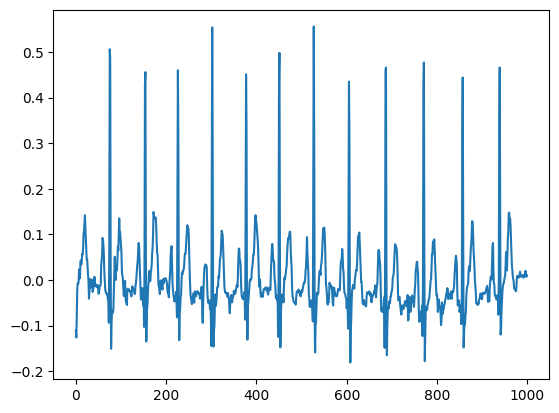

tensor([[[-0.0050, -0.0050, -0.0050,  ..., -0.0390, -0.1020, -0.1040]],

        [[ 0.0280,  0.0410,  0.0290,  ..., -0.0050,  0.0160,  0.0470]],

        [[-0.1350, -0.1350, -0.1350,  ...,  0.1090,  0.1060,  0.1160]],

        ...,

        [[-0.2990, -0.2940, -0.2920,  ..., -0.1560, -0.1550, -0.1970]],

        [[ 0.1990,  0.1790,  0.1440,  ...,  0.0140,  0.0140,  0.0220]],

        [[-0.0130, -0.0180, -0.0100,  ...,  0.0640,  0.0550,  0.0300]]],
       device='cuda:0')


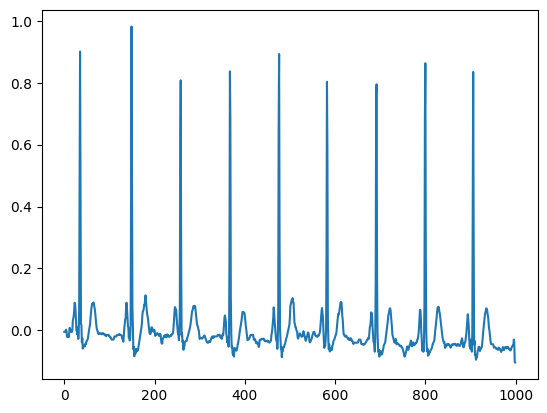

tensor([[[-0.0750, -0.1070, -0.0780,  ...,  0.0520,  0.0440,  0.0190]],

        [[ 0.0020,  0.0210,  0.0520,  ..., -0.0040, -0.0120, -0.0500]],

        [[-0.0440, -0.0350, -0.0280,  ..., -0.0470, -0.0540, -0.0510]],

        ...,

        [[-0.0420, -0.0350, -0.0220,  ...,  0.0630, -0.0570, -0.0040]],

        [[ 0.1600,  0.4280,  0.8990,  ..., -0.0770, -0.0550, -0.0630]],

        [[ 0.1640,  0.1530,  0.1360,  ..., -0.0590, -0.0160, -0.0240]]],
       device='cuda:0')


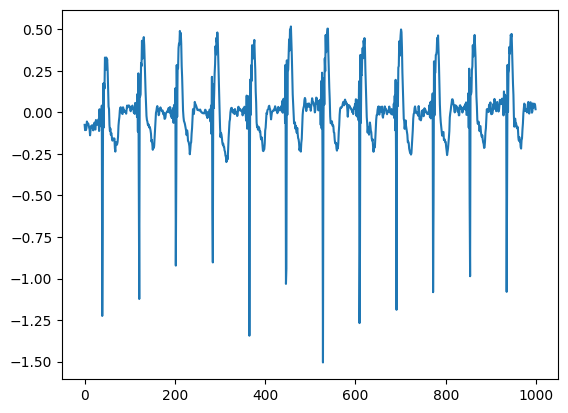

tensor([[[-0.1840, -0.1790, -0.1730,  ...,  0.1030,  0.1210,  0.1170]],

        [[ 0.1510,  0.1270,  0.0130,  ..., -0.0110, -0.0320, -0.0450]],

        [[-0.0480, -0.0380, -0.0400,  ...,  0.0580,  0.0490,  0.0430]],

        ...,

        [[-0.0890, -0.0890, -0.1020,  ..., -0.0440, -0.0450, -0.0170]],

        [[ 0.1200,  0.1180,  0.1270,  ..., -0.2370, -0.2230, -0.2060]],

        [[-0.1050, -0.1020, -0.0920,  ...,  0.1890,  0.7060,  0.9770]]],
       device='cuda:0')


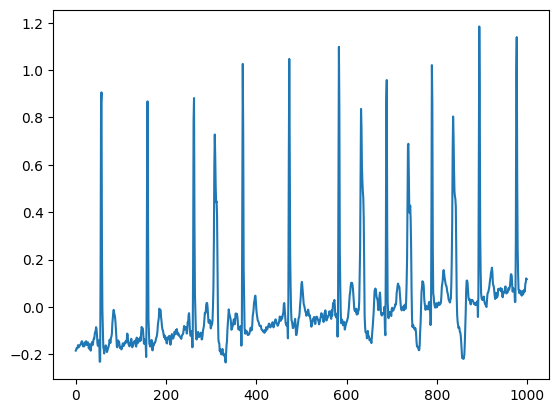

tensor([[[ 0.6390,  0.3760,  0.1540,  ...,  0.3820,  0.2810, -0.0530]],

        [[ 0.1610,  0.1150,  0.0590,  ..., -0.0120, -0.0180, -0.0040]],

        [[-0.0150, -0.0150, -0.0150,  ...,  0.8020,  0.9290,  0.4010]],

        ...,

        [[-0.0600, -0.0560, -0.0510,  ...,  0.0260,  0.0370,  0.0360]],

        [[-0.1220, -0.1230, -0.1150,  ...,  0.0490,  0.0620,  0.0790]],

        [[-0.1130, -0.1060, -0.0880,  ...,  0.0350,  0.0240,  0.0570]]],
       device='cuda:0')


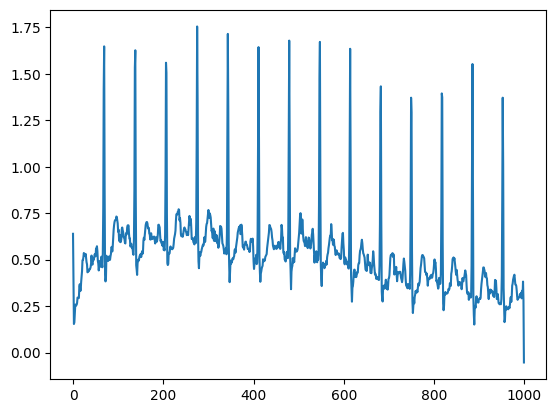

tensor([[[-0.0400, -0.0400, -0.0400,  ..., -0.0360, -0.0300, -0.0340]],

        [[ 0.0160,  0.0140,  0.0570,  ...,  0.0710,  0.0400,  0.0200]],

        [[ 0.3290,  0.3400,  0.3570,  ..., -0.0560, -0.0220, -0.0380]],

        ...,

        [[-0.1850, -0.2250, -0.2030,  ..., -0.0370, -0.0530, -0.0710]],

        [[ 0.0470,  0.0480,  0.0450,  ..., -0.0610, -0.0830, -0.1680]],

        [[-0.0150, -0.0200, -0.0180,  ..., -0.0970, -0.1080, -0.1270]]],
       device='cuda:0')


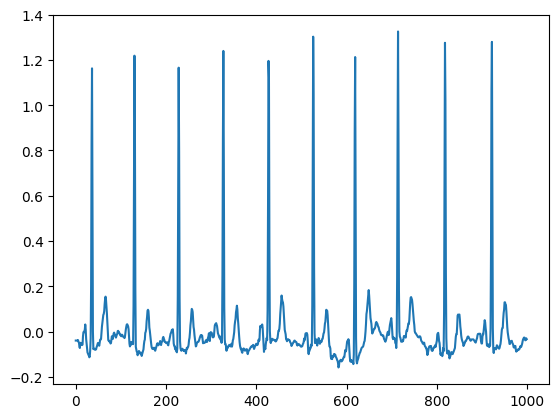

tensor([[[ 0.0090, -0.0030, -0.0040,  ...,  0.2250,  0.1870, -0.0840]],

        [[ 0.0600,  0.0520,  0.0420,  ..., -0.0560, -0.0460, -0.0480]],

        [[-0.5180, -0.5200, -0.5570,  ...,  1.2600,  1.0040,  0.7000]],

        ...,

        [[-0.1870, -0.1200, -0.0220,  ..., -0.1240, -0.1320, -0.1180]],

        [[ 0.0700,  0.0790,  0.1040,  ...,  0.1230,  0.1350,  0.1070]],

        [[-0.1790, -0.1780, -0.1730,  ..., -0.2110, -0.2370, -0.2150]]],
       device='cuda:0')


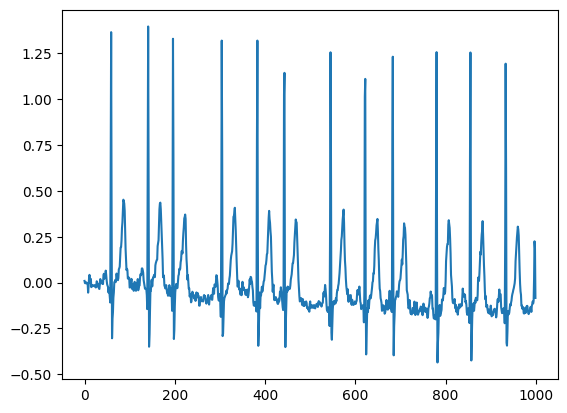

tensor([[[-0.0230, -0.0110, -0.0300,  ...,  0.0020, -0.0220, -0.0380]],

        [[ 0.0120,  0.0100,  0.0180,  ..., -0.0850, -0.0920, -0.0810]],

        [[-0.0170, -0.0370, -0.0440,  ..., -0.1440, -0.1520, -0.1500]],

        ...,

        [[-0.0840, -0.0670, -0.0610,  ..., -0.1220,  0.0710,  0.7140]],

        [[-0.1470, -0.1830, -0.1230,  ..., -0.0660, -0.0870, -0.1030]],

        [[-0.0490, -0.0450, -0.0470,  ..., -0.0160,  0.3730,  0.3580]]],
       device='cuda:0')


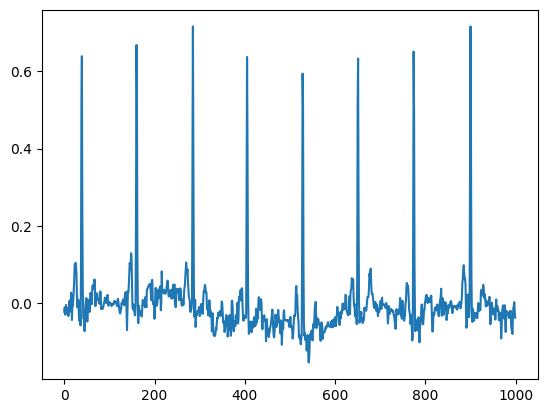

tensor([[[ 0.2000,  0.2100,  0.2180,  ..., -0.3100, -0.3090, -0.3090]],

        [[-0.1500, -0.1520, -0.1540,  ...,  0.0490,  0.0470,  0.0470]],

        [[ 0.0130,  0.0100,  0.0490,  ..., -0.0480, -0.0410, -0.0460]],

        ...,

        [[-0.0650, -0.0640, -0.0500,  ..., -0.1340, -0.1250, -0.1400]],

        [[-0.0040,  0.0030,  0.0060,  ...,  0.0650,  0.0350, -0.0700]],

        [[ 0.0170,  0.0350,  0.0440,  ..., -0.2710, -0.0850,  0.2760]]],
       device='cuda:0')


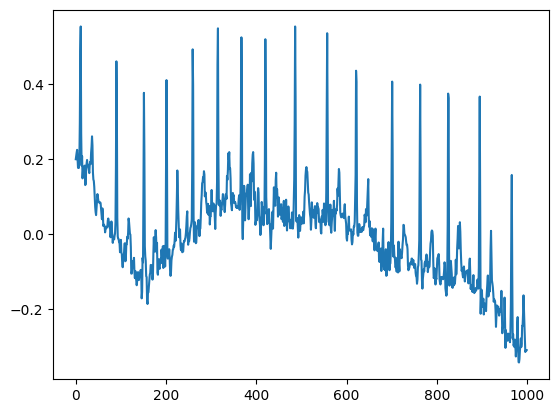

tensor([[[-0.0310, -0.0230, -0.0090,  ...,  0.0880,  0.0580,  0.0210]],

        [[ 0.0300,  0.0240,  0.0150,  ...,  0.1000,  0.1910,  0.1650]],

        [[-0.0550, -0.0520, -0.0430,  ..., -0.2200, -0.1790, -0.1380]],

        ...,

        [[-0.0580, -0.0190, -0.0210,  ..., -0.0640, -0.2210, -0.1270]],

        [[-0.0310, -0.0420, -0.0590,  ...,  0.0010,  0.0030,  0.0110]],

        [[ 0.0750,  0.1110,  0.1070,  ...,  0.0080,  0.0320,  0.0710]]],
       device='cuda:0')


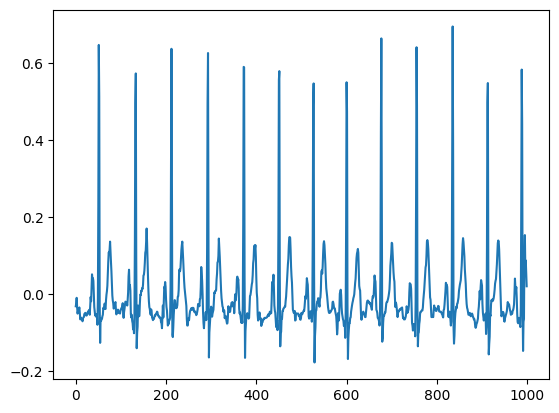

tensor([[[ 0.0090,  0.0050,  0.0050,  ..., -0.0360, -0.0380, -0.0290]],

        [[ 0.0330,  0.0200,  0.0180,  ..., -0.0670, -0.0530, -0.0340]],

        [[-0.0090, -0.0760, -0.1220,  ..., -0.1050, -0.1040, -0.1010]],

        ...,

        [[-0.2130, -0.2090, -0.2020,  ...,  0.1400,  0.0780,  0.0390]],

        [[ 0.1390,  0.1330,  0.0110,  ..., -0.0210, -0.0150,  0.0050]],

        [[ 0.0430,  0.0730,  0.1460,  ...,  0.0280,  0.0150,  0.0150]]],
       device='cuda:0')


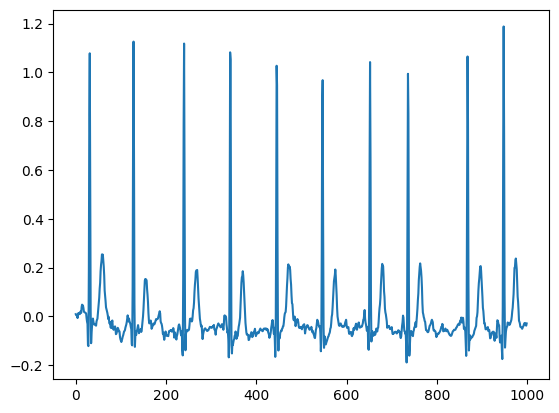

tensor([[[ 0.0400,  0.0470,  0.0530,  ...,  0.0130,  0.0100,  0.0120]],

        [[ 0.0590,  0.0190, -0.0180,  ...,  0.1140,  0.1400,  0.1670]],

        [[ 0.1590,  0.4640,  0.8900,  ..., -0.0760, -0.0730,  0.2860]],

        ...,

        [[-0.1600, -0.1650, -0.1770,  ..., -0.2020, -0.0470,  0.4130]],

        [[-0.1870, -0.2030, -0.2350,  ...,  0.0560,  0.0360,  0.0500]],

        [[ 0.1200,  0.1080,  0.0680,  ..., -0.1570, -0.1570, -0.1470]]],
       device='cuda:0')


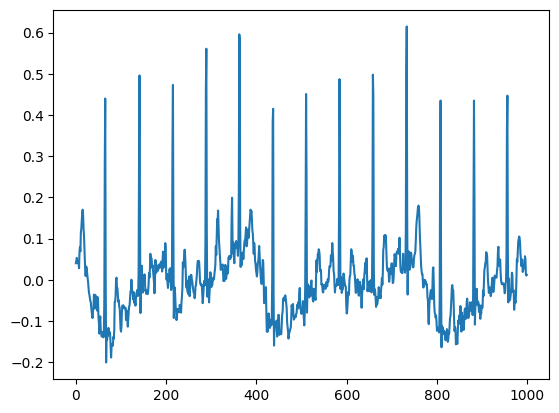

tensor([[[-0.0690, -0.0580, -0.0320,  ..., -0.0060, -0.0020,  0.0070]],

        [[ 0.0650,  0.0640,  0.0640,  ...,  0.1880,  0.1900,  0.1610]],

        [[ 0.0100,  0.0170,  0.0350,  ..., -0.1520, -0.1520, -0.1440]],

        ...,

        [[-0.1050, -0.1050, -0.1010,  ..., -0.1910, -0.1040,  0.0350]],

        [[-0.0260, -0.0350, -0.0320,  ..., -0.0430, -0.0430, -0.0310]],

        [[-0.0790, -0.0970, -0.0930,  ...,  0.0250,  0.0070, -0.0010]]],
       device='cuda:0')


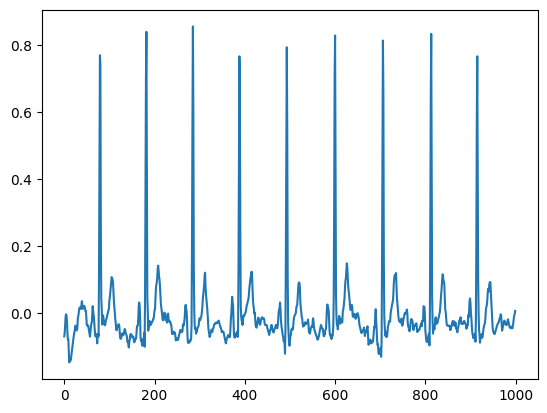

tensor([[[ 0.1310,  0.1560,  0.2160,  ..., -0.1550, -0.1570, -0.1670]],

        [[-0.0380, -0.0460, -0.0620,  ...,  0.1080,  0.1590,  0.1860]],

        [[-0.0220, -0.0330, -0.0660,  ...,  0.1490, -0.0080,  0.0130]],

        ...,

        [[-0.0730, -0.0850, -0.1220,  ...,  0.0030,  0.0020, -0.0570]],

        [[-0.0200,  0.0060,  0.0260,  ...,  0.0860, -0.0940,  0.0890]],

        [[-0.1570, -0.1690, -0.1470,  ..., -0.0220, -0.0840, -0.0840]]],
       device='cuda:0')


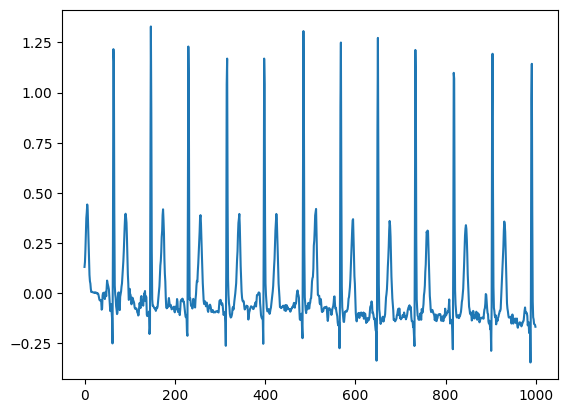

tensor([[[-0.0340, -0.0320, -0.0260,  ..., -0.0130, -0.0170, -0.0190]],

        [[ 0.2290,  0.2390,  0.2670,  ..., -0.3330, -0.4170, -0.4580]],

        [[-0.1350, -0.1380, -0.1470,  ...,  0.0050,  0.0120,  0.0070]],

        ...,

        [[ 0.6750,  0.6440,  0.2880,  ..., -0.0420, -0.0390, -0.0410]],

        [[ 0.0360,  0.0140, -0.0110,  ...,  0.0380,  0.0320,  0.1000]],

        [[-0.1850, -0.1850, -0.1850,  ...,  0.1730,  0.2350,  0.4300]]],
       device='cuda:0')


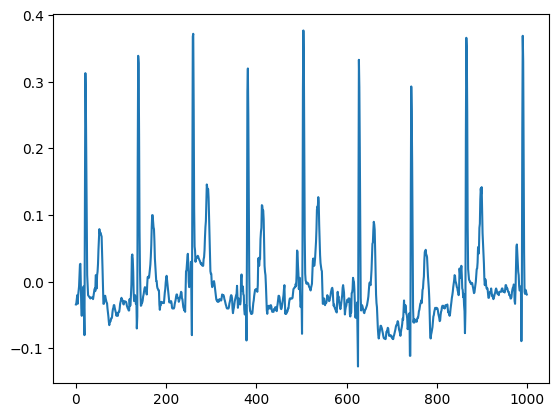

tensor([[[ 0.0220,  0.0160,  0.0510,  ..., -0.1670, -0.0580,  0.1190]],

        [[-0.4330, -0.5090, -0.5350,  ..., -0.2800, -0.2900, -0.3750]],

        [[ 0.0450,  0.0510,  0.0510,  ...,  0.0470,  0.0520,  0.0520]],

        ...,

        [[-0.0740, -0.0630, -0.0430,  ..., -0.0420, -0.0410, -0.0530]],

        [[-0.0500, -0.0490, -0.0450,  ..., -0.0350, -0.0290, -0.0550]],

        [[-0.0210, -0.0170, -0.0130,  ..., -0.0360,  0.0710,  0.0130]]],
       device='cuda:0')


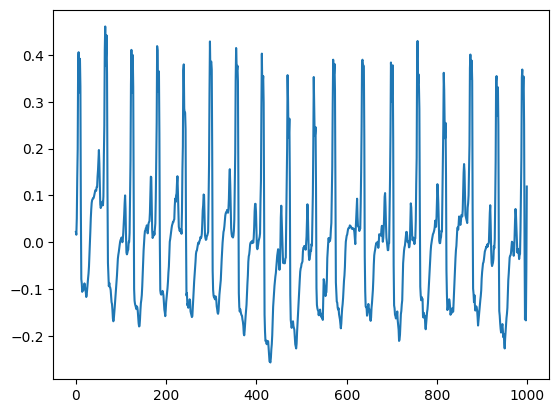

tensor([[[ 0.0510,  0.0360,  0.0130,  ...,  0.2880,  0.2790,  0.2900]],

        [[-0.0580, -0.0440, -0.0400,  ..., -0.0400,  0.3490,  0.3930]],

        [[-0.0040,  0.0040,  0.0080,  ..., -0.2120, -0.2200, -0.1790]],

        ...,

        [[ 0.1170,  0.0720,  0.0890,  ...,  0.0340,  0.0080,  0.0230]],

        [[ 0.0700,  0.0800,  0.0960,  ...,  0.0240,  0.0220, -0.0160]],

        [[-0.0730, -0.0730, -0.1260,  ...,  0.5020,  0.1480, -0.0240]]],
       device='cuda:0')


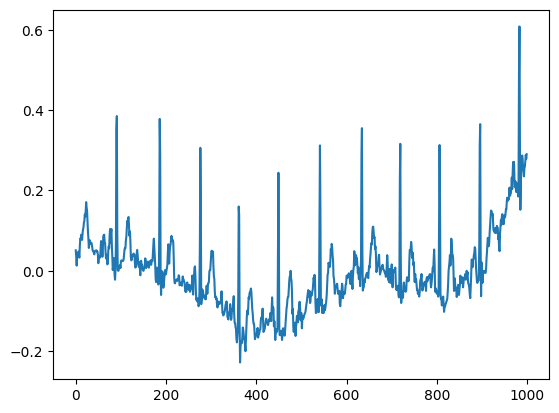

tensor([[[-0.0200, -0.0260, -0.0330,  ..., -0.1180, -0.1020, -0.1240]],

        [[-0.0570, -0.0750, -0.0910,  ..., -0.0680, -0.0080, -0.0560]],

        [[-0.0200, -0.0110, -0.0200,  ..., -0.1110, -0.1130, -0.1160]],

        ...,

        [[ 0.0410,  0.0460,  0.0540,  ..., -0.0510, -0.1970, -0.1870]],

        [[-0.0560, -0.0470, -0.0320,  ..., -0.1090, -0.2350, -0.1900]],

        [[ 0.8100,  0.4910, -0.0220,  ..., -0.0710, -0.0760, -0.0720]]],
       device='cuda:0')


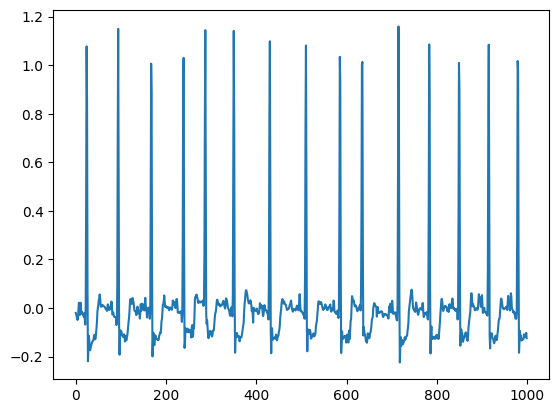

tensor([[[-0.0540, -0.0430, -0.0280,  ..., -0.0550, -0.0060, -0.0620]],

        [[ 0.0000, -0.0050, -0.0120,  ...,  0.0030,  0.1790,  0.5260]],

        [[ 0.0270,  0.0330,  0.0080,  ..., -0.1440, -0.2370, -0.2200]],

        ...,

        [[ 0.1470,  0.1040,  0.0550,  ..., -0.0550, -0.0470, -0.0330]],

        [[ 0.0340,  0.0310,  0.0310,  ..., -0.0950, -0.0620, -0.0470]],

        [[-0.0010,  0.0000,  0.0090,  ..., -0.1010, -0.0860,  0.2000]]],
       device='cuda:0')


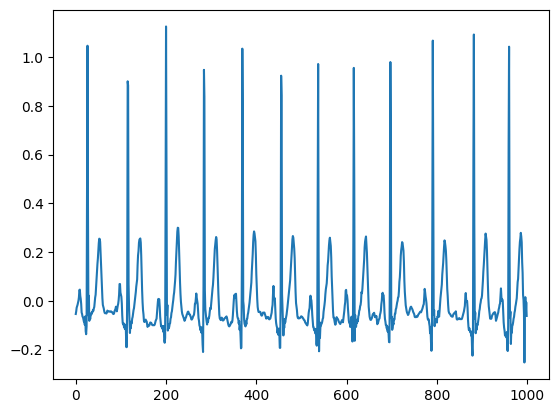

tensor([[[ 0.0360,  0.0440,  0.0650,  ...,  0.1150,  0.0830,  0.0650]],

        [[-0.0150, -0.0150, -0.0150,  ...,  0.0420,  0.0550,  0.0800]],

        [[-0.2920, -0.2870, -0.2440,  ..., -0.1180, -0.1400, -0.1330]],

        ...,

        [[-0.1210, -0.1520, -0.1040,  ..., -0.0260, -0.0050,  0.0610]],

        [[-0.0550, -0.0450, -0.0270,  ..., -0.1120, -0.1520,  0.2030]],

        [[-0.0650, -0.0650, -0.0650,  ...,  0.1140,  0.0930,  0.1560]]],
       device='cuda:0')


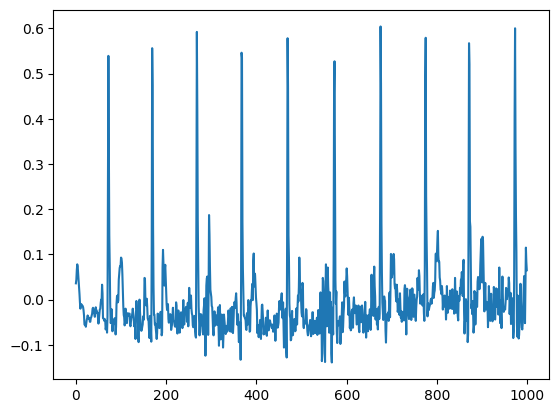

tensor([[[-0.0640, -0.0530, -0.0320,  ...,  0.1330, -0.0650, -0.2850]],

        [[-0.4510, -0.4670, -0.4380,  ..., -0.0960, -0.0940, -0.1010]],

        [[-0.0850, -0.0850, -0.0710,  ..., -0.0060,  0.0170,  0.0820]],

        ...,

        [[-0.0450, -0.0570, -0.0840,  ...,  0.1330,  0.0790,  0.0280]],

        [[ 0.0610,  0.0660,  0.0700,  ...,  0.0620,  0.0790,  0.0740]],

        [[-0.0500, -0.0460, -0.0390,  ...,  0.0070, -0.0030, -0.0020]]],
       device='cuda:0')


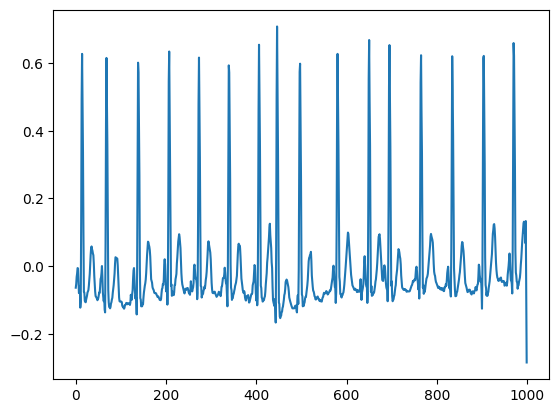

tensor([[[-0.2300, -0.2240, -0.2170,  ..., -0.0430, -0.0630,  0.0780]],

        [[ 0.1240,  0.4180,  0.8480,  ..., -0.0750, -0.0950, -0.0970]],

        [[-0.1220, -0.1250, -0.1460,  ..., -0.3030, -0.2690, -0.2890]],

        ...,

        [[ 0.0750,  0.0790,  0.0720,  ..., -0.0040, -0.0130, -0.0030]],

        [[-0.0870, -0.1080, -0.1170,  ..., -0.1560, -0.1250, -0.1020]],

        [[-0.0350, -0.0330, -0.0270,  ...,  0.0940,  0.0710,  0.1970]]],
       device='cuda:0')


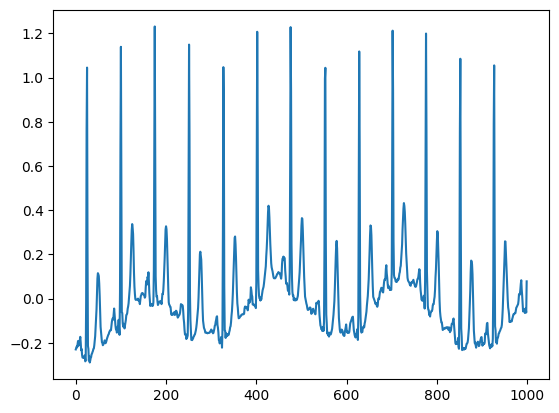

tensor([[[ 0.1470, -0.0210, -0.1390,  ...,  0.0270,  0.0380,  0.0520]],

        [[ 0.1000,  0.1000,  0.1030,  ...,  0.0720,  0.0220, -0.1470]],

        [[-0.0050, -0.0080, -0.0140,  ..., -0.0220,  0.0340, -0.0090]],

        ...,

        [[ 0.0990,  0.0620,  0.0090,  ..., -0.0650, -0.0920, -0.1100]],

        [[ 0.0030, -0.0220, -0.0100,  ...,  0.0240,  0.0060,  0.0290]],

        [[ 0.0460,  0.0680,  0.1110,  ..., -0.0300,  0.0200,  0.0380]]],
       device='cuda:0')


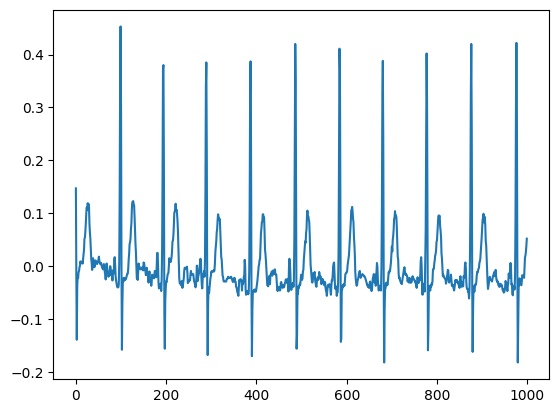

tensor([[[-0.0110,  0.0010,  0.0500,  ...,  0.1270,  0.1260,  0.0800]],

        [[-0.0290, -0.0240, -0.0160,  ..., -0.0850, -0.0830, -0.0710]],

        [[-0.0150,  0.0130,  0.0170,  ...,  0.1260,  0.1030,  0.0750]],

        ...,

        [[ 0.0290,  0.1070,  0.0660,  ..., -0.0030,  0.1410, -0.1570]],

        [[ 0.2420,  0.2620,  0.2950,  ...,  0.0290,  0.0200, -0.0010]],

        [[-0.0320, -0.0360, -0.0380,  ..., -0.0810, -0.1990, -0.0200]]],
       device='cuda:0')


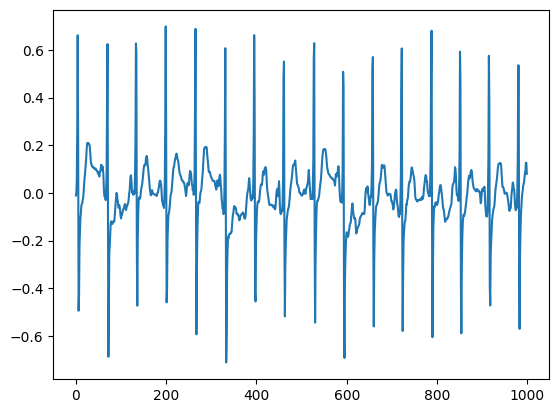

tensor([[[ 0.1820,  0.4120,  0.4750,  ..., -0.0310, -0.0300, -0.0200]],

        [[ 0.0750,  0.0790,  0.0330,  ..., -0.1130, -0.0970,  0.0100]],

        [[-0.0530, -0.0550, -0.0760,  ..., -0.0060, -0.0060, -0.0070]],

        ...,

        [[-0.0250, -0.0200, -0.0080,  ..., -0.0770, -0.0910, -0.0690]],

        [[ 0.0600,  0.0530,  0.0630,  ..., -0.0840, -0.0660, -0.1140]],

        [[ 0.0160,  0.0260,  0.0320,  ...,  0.1520,  0.0660, -0.0840]]],
       device='cuda:0')


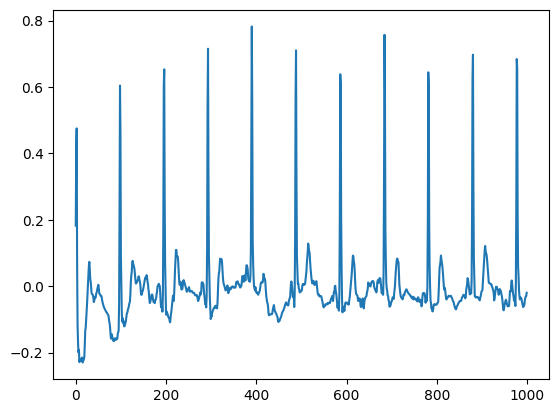

tensor([[[-0.0590,  0.0800,  0.5610,  ...,  0.0380,  0.0690,  0.0880]],

        [[ 0.0250,  0.0290,  0.0180,  ...,  0.9120,  0.5490,  0.0060]],

        [[-0.0560, -0.0550, -0.0680,  ..., -0.0480, -0.0140,  0.0370]],

        ...,

        [[-0.2050, -0.2030, -0.1970,  ...,  0.0910,  0.0880,  0.0770]],

        [[-0.0940, -0.0840, -0.0680,  ..., -0.0550, -0.0600, -0.1790]],

        [[-0.0830, -0.1180, -0.1330,  ..., -0.2140,  0.1340,  0.2450]]],
       device='cuda:0')


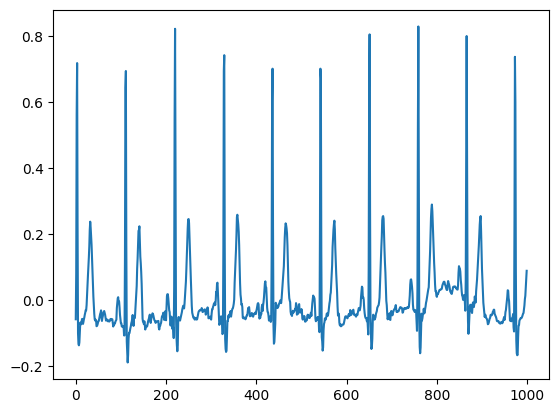

tensor([[[-0.0700, -0.0580, -0.0270,  ..., -0.1790, -0.2300, -0.1110]],

        [[-0.1480, -0.1390, -0.1520,  ...,  1.3420,  1.5440,  1.0350]],

        [[-0.1050, -0.0950, -0.0820,  ..., -0.0030,  0.1230,  0.4600]],

        ...,

        [[-1.2690, -1.2680, -1.2640,  ..., -1.2050, -1.2050, -1.2030]],

        [[-0.0940, -0.0420, -0.0110,  ..., -0.0170,  0.0100, -0.0150]],

        [[-0.1300, -0.1300, -0.1270,  ...,  0.0290, -0.0360, -0.0460]]],
       device='cuda:0')


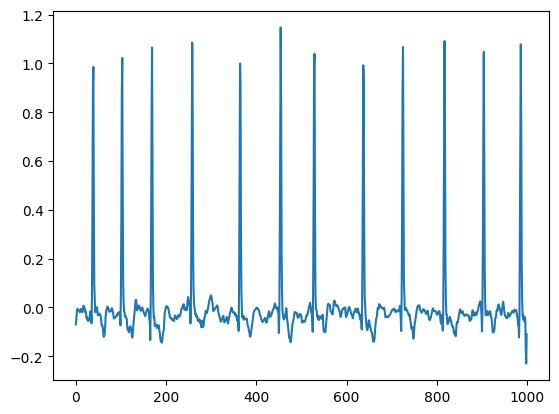

tensor([[[-0.0450, -0.0940, -0.0900,  ..., -0.0230, -0.0210, -0.0120]],

        [[-0.4750, -0.4650, -0.4830,  ...,  0.0610,  0.0310,  0.0600]],

        [[ 0.0610,  0.0580,  0.0620,  ..., -0.1090, -0.0680, -0.2160]],

        ...,

        [[-0.1060, -0.1100, -0.0950,  ..., -0.0960, -0.0820, -0.0630]],

        [[ 0.0060,  0.0000, -0.0290,  ..., -0.0650, -0.0790, -0.0830]],

        [[ 0.2650,  0.7960,  1.0950,  ..., -0.0910, -0.0650, -0.0580]]],
       device='cuda:0')


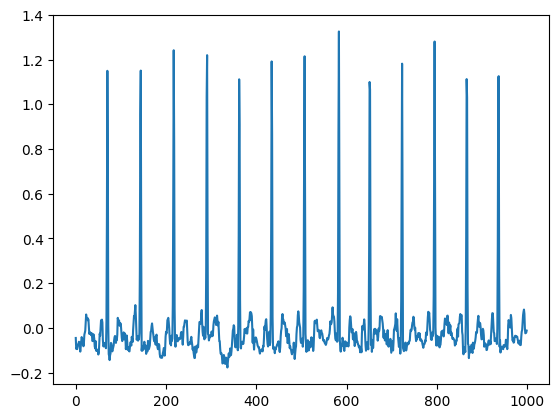

tensor([[[-0.1420, -0.1080, -0.0900,  ...,  0.0080, -0.0620, -0.0550]],

        [[ 0.0010, -0.0060, -0.0220,  ..., -0.1140, -0.1210, -0.1190]],

        [[-0.2500, -0.2450, -0.2330,  ..., -0.1180, -0.1030, -0.1000]],

        ...,

        [[ 0.0240,  0.0160,  0.0400,  ..., -0.0610, -0.0690, -0.0610]],

        [[ 0.0240,  0.0690,  0.0080,  ...,  0.0420, -0.0820, -0.0760]],

        [[-0.0050, -0.0050, -0.0050,  ..., -0.1040, -0.1150, -0.1000]]],
       device='cuda:0')


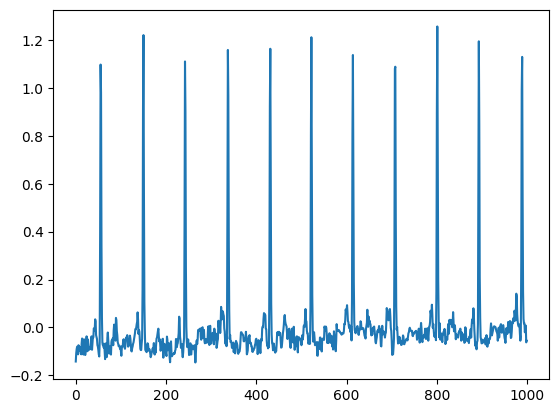

tensor([[[-0.0100,  0.0010,  0.0150,  ..., -0.0330, -0.0250,  0.0220]],

        [[ 0.0310,  0.0440,  0.0730,  ..., -0.0750, -0.0750, -0.0750]],

        [[ 0.2940,  0.2880,  0.2810,  ..., -0.0300, -0.0250, -0.0640]],

        ...,

        [[-0.0260, -0.0350, -0.0350,  ...,  0.0530,  0.0760,  0.0980]],

        [[ 0.0110,  0.0170,  0.0090,  ..., -0.0200, -0.0220, -0.0300]],

        [[-0.0510, -0.0470, -0.0250,  ..., -0.0200,  0.1500,  0.1830]]],
       device='cuda:0')


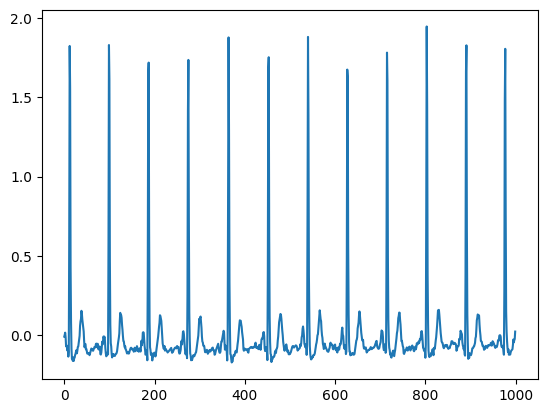

tensor([[[-0.1760, -0.2080, -0.2160,  ...,  0.0080, -0.0120,  0.0000]],

        [[-0.2300, -0.2100, -0.2030,  ...,  0.1430,  0.1770,  0.1620]],

        [[-0.0950, -0.0940, -0.0900,  ..., -0.0400, -0.0410, -0.0460]],

        ...,

        [[ 0.4660,  0.0380, -0.2060,  ..., -0.0750, -0.0550, -0.0650]],

        [[ 0.0090, -0.0130, -0.0500,  ...,  0.1910,  0.2130,  0.2160]],

        [[ 0.0640,  0.0670, -0.0090,  ...,  0.0070, -0.1930, -1.1870]]],
       device='cuda:0')


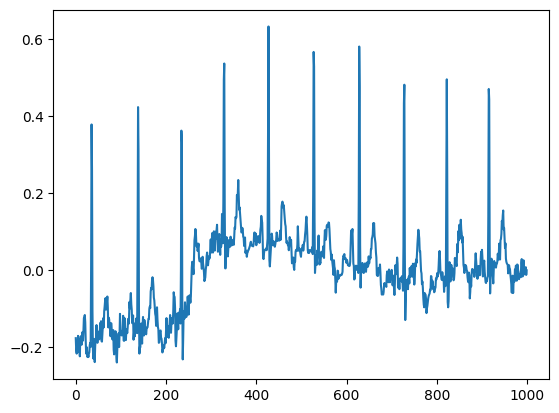

tensor([[[-0.0990, -0.1040,  0.1340,  ..., -0.1250, -0.0610, -0.0540]],

        [[ 0.0150,  0.0140,  0.0150,  ...,  0.0370, -0.0250, -0.0910]],

        [[-0.0030, -0.0090, -0.0420,  ..., -0.0080,  0.0240,  0.0320]],

        ...,

        [[-0.0360, -0.0200, -0.0060,  ...,  0.0290,  0.0410,  0.0290]],

        [[-0.0340, -0.0240, -0.0050,  ..., -0.1520,  0.2280,  0.1630]],

        [[ 0.0000,  0.0000,  0.0020,  ..., -0.0760, -0.0540, -0.0940]]],
       device='cuda:0')


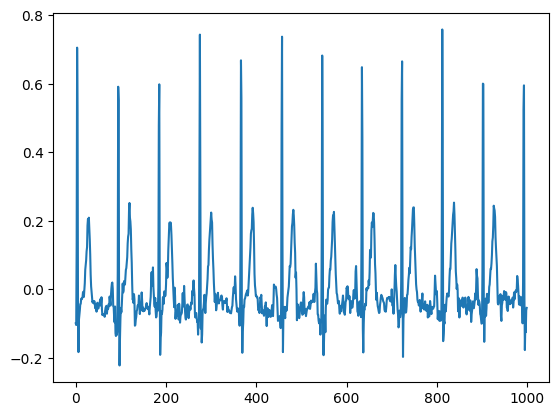

tensor([[[-0.0290, -0.0300, -0.0450,  ..., -0.0460, -0.0660, -0.1450]],

        [[ 0.0570,  0.0350, -0.0140,  ...,  0.0180,  0.0220,  0.0790]],

        [[-0.0290, -0.0220, -0.0340,  ..., -0.0250,  0.0030, -0.0030]],

        ...,

        [[ 0.1680,  0.1600,  0.1220,  ..., -0.0140, -0.0110, -0.0190]],

        [[-0.0330, -0.0460, -0.0710,  ..., -0.0510, -0.0370, -0.0580]],

        [[ 0.1410,  0.1070,  0.0500,  ..., -0.0380, -0.0220,  0.0180]]],
       device='cuda:0')


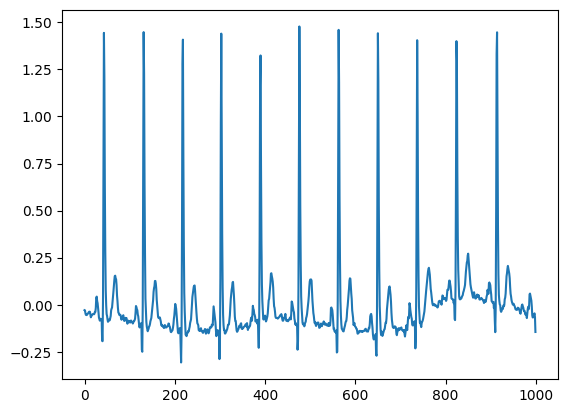

tensor([[[-0.0630, -0.0330,  0.0020,  ..., -0.1450, -0.0490, -0.3160]],

        [[ 0.0460,  0.0790,  0.0150,  ..., -0.1170, -0.1220, -0.1370]],

        [[ 0.0720,  0.0440,  0.0200,  ...,  0.2700,  0.0970, -0.0710]],

        ...,

        [[-0.0010,  0.0140,  0.0280,  ..., -0.0560, -0.0610, -0.1950]],

        [[-0.0990, -0.0730, -0.0460,  ..., -0.0690, -0.0640, -0.0490]],

        [[-0.0940,  0.0190,  0.4540,  ..., -0.1790, -0.1930, -0.2310]]],
       device='cuda:0')


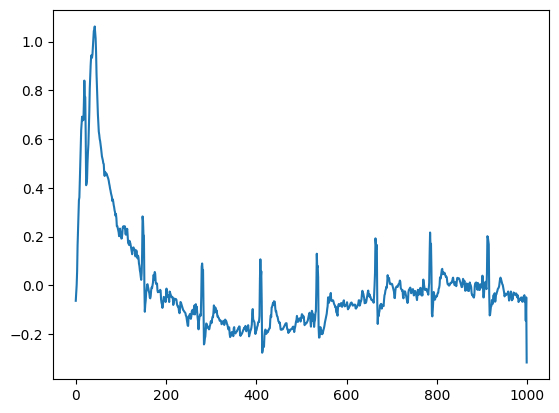

tensor([[[-0.0370, -0.0380, -0.0370,  ..., -0.0010,  0.0850,  0.0690]],

        [[-0.0200, -0.0200, -0.0200,  ..., -0.0550, -0.0560, -0.0520]],

        [[-0.0400, -0.0190, -0.0300,  ...,  0.0080,  0.0040, -0.0050]],

        ...,

        [[-0.1550, -0.1760, -0.1820,  ..., -0.1250, -0.0880,  0.0930]],

        [[-0.0100, -0.0090, -0.0080,  ...,  0.3620,  0.6940,  0.4840]],

        [[ 0.2770,  0.4720,  0.5830,  ..., -0.0070,  0.0020, -0.0330]]],
       device='cuda:0')


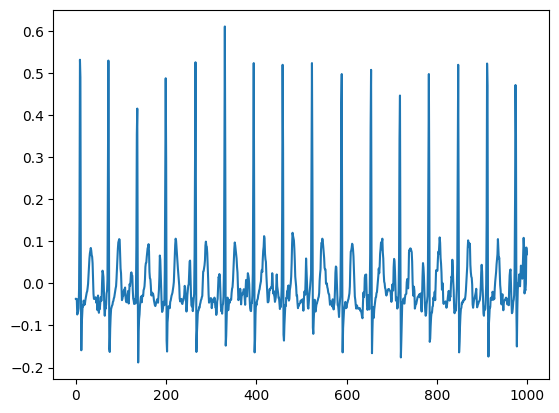

tensor([[[-0.0420, -0.0190, -0.0020,  ..., -0.0610, -0.0780, -0.0810]],

        [[ 0.2280,  0.4340,  0.5830,  ..., -0.0550, -0.0750, -0.0640]],

        [[ 0.0970,  0.1010,  0.0680,  ..., -0.0560, -0.0330, -0.0130]],

        ...,

        [[ 0.0920,  0.0820,  0.0500,  ...,  0.0060,  0.0060,  0.1880]],

        [[ 0.1420,  0.1540,  0.1630,  ...,  0.7360,  0.3570,  0.2610]],

        [[ 0.0250,  0.0360,  0.0450,  ...,  0.1360,  0.1320, -0.1060]]],
       device='cuda:0')


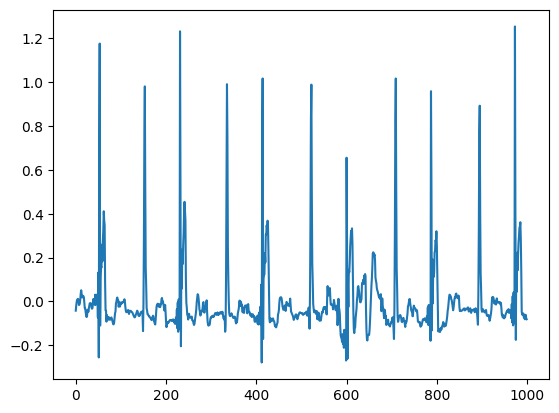

tensor([[[ 0.0900,  0.0380, -0.0100,  ..., -0.0570, -0.0640, -0.0470]],

        [[-0.0150, -0.0120, -0.0060,  ..., -0.0690, -0.0710, -0.0920]],

        [[ 0.0700,  0.0690,  0.0660,  ..., -0.2150, -0.2390, -0.2400]],

        ...,

        [[-0.0700, -0.0710, -0.0850,  ...,  0.0210, -0.0180, -0.0390]],

        [[-0.1030, -0.0890, -0.0870,  ..., -0.0450, -0.0450, -0.1090]],

        [[-0.0100, -0.0100, -0.0100,  ..., -1.3380, -0.7800, -0.1990]]],
       device='cuda:0')


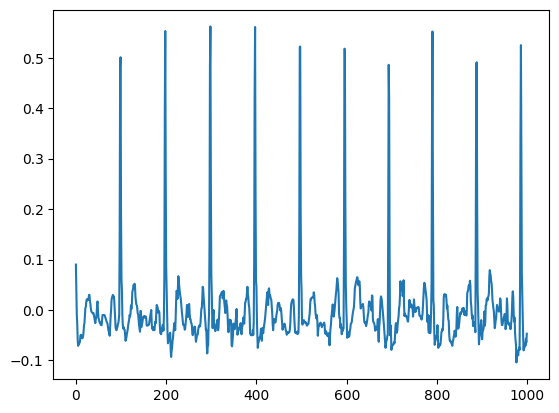

tensor([[[ 0.0000, -0.0070, -0.0180,  ..., -0.0760, -0.0800, -0.0660]],

        [[-0.0220, -0.0380, -0.0480,  ..., -0.0050, -0.0230,  0.0640]],

        [[ 0.1440,  0.1910,  0.1400,  ..., -0.0670, -0.0630, -0.0430]],

        ...,

        [[ 0.0120,  0.0180,  0.0350,  ..., -0.0280, -0.0310, -0.0350]],

        [[-0.1590, -0.1820, -0.1340,  ...,  0.2240,  0.2480,  0.2810]],

        [[-0.0700, -0.0880, -0.1130,  ...,  0.1350,  0.1040, -0.0830]]],
       device='cuda:0')


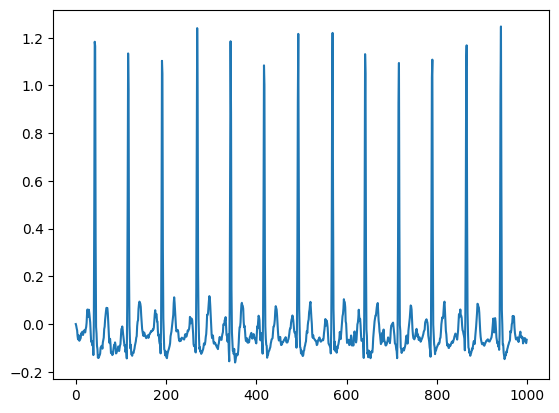

tensor([[[ 0.0050,  0.0210,  0.0000,  ..., -0.0320,  0.5600,  1.1600]],

        [[ 0.0350,  0.0410,  0.0820,  ...,  0.0150, -0.1910, -0.0140]],

        [[ 0.6710,  0.4930,  0.2150,  ...,  0.7160,  0.5810,  0.2400]],

        ...,

        [[ 0.0290,  0.0470,  0.0500,  ...,  0.0350,  0.0100,  0.0120]],

        [[-0.1140, -0.1400, -0.1450,  ...,  0.0540, -0.1890, -0.0710]],

        [[ 0.0840,  0.0640,  0.0350,  ...,  0.0000,  0.0100, -0.0600]]],
       device='cuda:0')


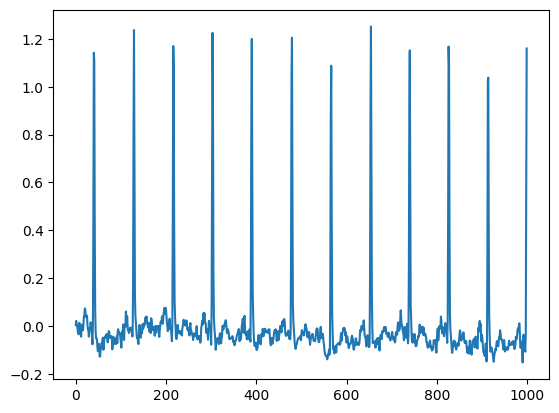

tensor([[[-0.0350, -0.0350, -0.0350,  ..., -0.1520,  0.0050, -0.1170]],

        [[-0.1110, -0.0830,  0.1040,  ..., -0.0960, -0.0790, -0.1100]],

        [[-1.0170, -0.9930, -0.9620,  ..., -0.0250, -0.0080, -0.0080]],

        ...,

        [[-0.3240, -0.3140, -0.3250,  ...,  0.3020,  0.3410,  0.3450]],

        [[-0.0350, -0.0340, -0.0360,  ...,  0.0870, -0.0130,  0.0960]],

        [[ 0.0640,  0.0980,  0.0550,  ..., -0.1340, -0.1220, -0.1400]]],
       device='cuda:0')


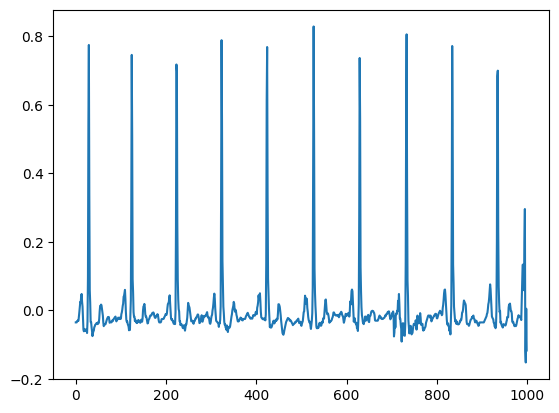

tensor([[[-0.2950, -0.2950, -0.2960,  ..., -0.4070, -0.3840, -0.4110]],

        [[-0.0610, -0.0750, -0.0950,  ..., -0.1810, -0.6790, -0.3050]],

        [[-0.0850, -0.0850, -0.0820,  ...,  0.0180,  0.0010,  0.0110]],

        ...,

        [[-0.0660, -0.0850, -0.1000,  ..., -0.1020, -0.0790, -0.0880]],

        [[ 0.2510,  0.4150,  0.5160,  ..., -0.1120, -0.1130, -0.1070]],

        [[-0.0460, -0.0490, -0.0460,  ..., -0.0430, -0.0540, -0.0900]]],
       device='cuda:0')


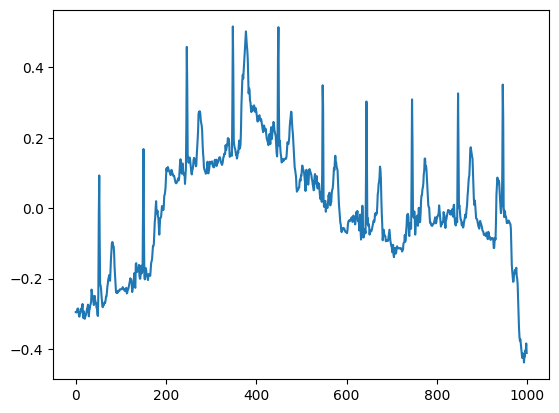

tensor([[[-0.0830, -0.0870, -0.0610,  ..., -0.0120, -0.0040, -0.0090]],

        [[-0.1750, -0.1740, -0.1600,  ...,  0.0220,  0.0460,  0.0380]],

        [[-0.0760, -0.0870, -0.0980,  ...,  0.2630,  0.1550, -0.1450]],

        ...,

        [[ 0.0310,  0.0040, -0.0050,  ..., -0.0910, -0.0940, -0.0810]],

        [[-0.0520, -0.0720, -0.0760,  ..., -0.0450,  0.0080, -0.0540]],

        [[ 0.0960,  0.0710,  0.0660,  ...,  0.2970,  0.9210,  0.8450]]],
       device='cuda:0')


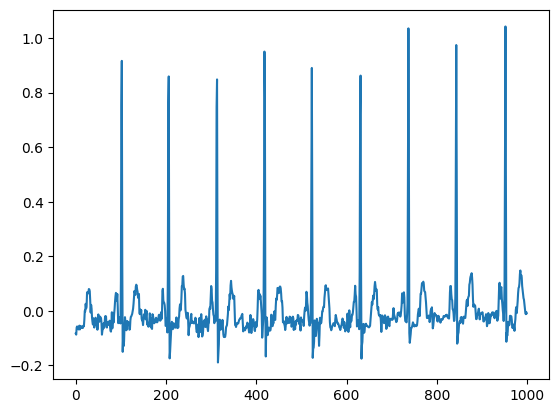

tensor([[[ 0.0040,  0.0330,  0.0180,  ..., -0.0070,  0.0000, -0.0160]],

        [[-0.0040, -0.0320, -0.0450,  ..., -0.0670, -0.0500, -0.0400]],

        [[ 0.0460,  0.0610,  0.0790,  ..., -0.7370,  0.3420,  0.0430]],

        ...,

        [[ 0.0550,  0.0810,  0.0440,  ..., -0.0340, -0.0140,  0.2800]],

        [[ 0.0340,  0.0320,  0.0440,  ..., -0.1340, -0.1110, -0.1170]],

        [[-0.0140, -0.0120, -0.0120,  ...,  0.3600,  0.2490,  0.0920]]],
       device='cuda:0')


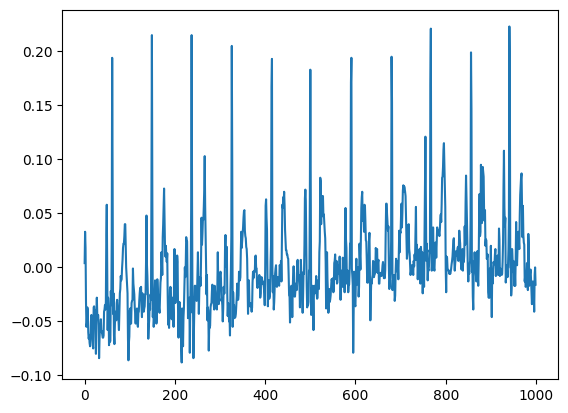

tensor([[[ 0.0700,  0.0370,  0.0170,  ...,  0.0530,  0.0450,  0.0330]],

        [[-0.1050, -0.1030, -0.0970,  ...,  0.0740,  0.1090,  0.0930]],

        [[ 0.1790,  0.1610,  0.1250,  ..., -0.3020, -0.1890,  0.1040]],

        ...,

        [[-0.0430, -0.0360, -0.0220,  ..., -0.1040, -0.0170,  0.0780]],

        [[-0.0550, -0.0310, -0.0020,  ..., -0.0220, -0.0020,  0.0030]],

        [[-0.0300, -0.0390, -0.0390,  ..., -0.0490, -0.0370, -0.0340]]],
       device='cuda:0')


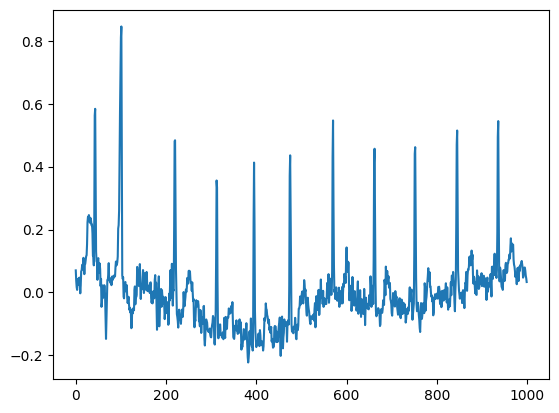

tensor([[[ 0.0210,  0.0400,  0.0600,  ..., -0.0350,  0.0290,  0.1090]],

        [[-0.0010, -0.0260,  0.0150,  ...,  0.2130, -0.0830,  0.1740]],

        [[-0.1130, -0.1020, -0.0780,  ...,  0.5090,  0.4420, -0.0200]],

        ...,

        [[ 0.0730,  0.0680,  0.0500,  ..., -0.0150, -0.0490, -0.0110]],

        [[-0.0910, -0.0690, -0.0200,  ..., -0.0560, -0.0570,  0.0030]],

        [[ 0.0680,  0.0770,  0.0830,  ..., -0.1710, -0.1590, -0.2420]]],
       device='cuda:0')


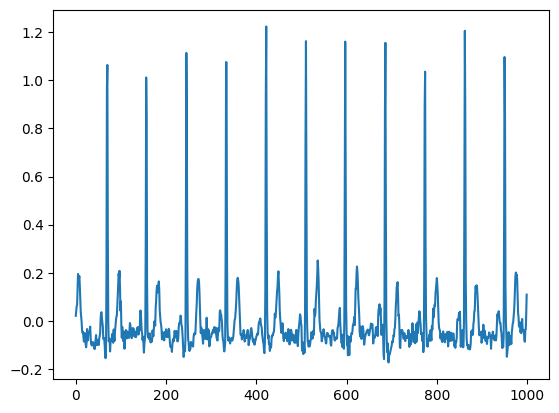

tensor([[[ 0.0570,  0.0680,  0.0720,  ..., -0.0310,  0.0000,  0.1540]],

        [[-0.0390, -0.0370, -0.0440,  ..., -0.0530, -0.0420, -0.0300]],

        [[-0.0050, -0.0060, -0.0070,  ..., -0.0040, -0.1140, -0.1090]],

        ...,

        [[ 0.0190,  0.0080,  0.0010,  ..., -0.1430, -0.2250,  0.0050]],

        [[ 0.0150,  0.0120,  0.0030,  ...,  0.0660,  0.2270,  0.3370]],

        [[ 0.4560,  0.4440,  0.3980,  ..., -0.1050, -0.1210, -0.1240]]],
       device='cuda:0')


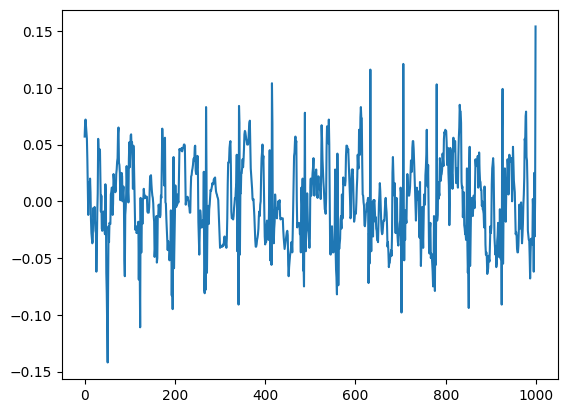

tensor([[[-0.0800, -0.0790, -0.0720,  ..., -0.1750, -0.2380, -0.2340]],

        [[-0.0200, -0.0230, -0.0340,  ..., -0.0750, -0.0640, -0.0400]],

        [[-0.1570, -0.1540, -0.1440,  ..., -0.0540, -0.0210,  0.1830]],

        ...,

        [[-0.0090, -0.0130, -0.0190,  ...,  0.4190,  0.5660, -0.0070]],

        [[ 0.0220,  0.0210,  0.0160,  ..., -0.0240, -0.1090,  0.0350]],

        [[-0.1060, -0.0220,  0.0220,  ..., -0.0670,  0.0470, -0.0070]]],
       device='cuda:0')


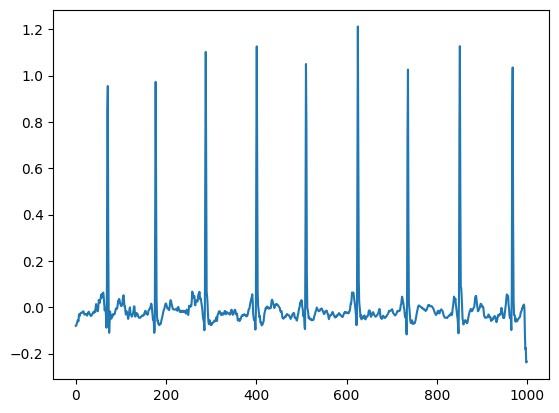

tensor([[[-0.1270, -0.0880, -0.0540,  ..., -0.0140, -0.0020, -0.0140]],

        [[-0.0400, -0.0400, -0.0710,  ..., -0.1030, -0.1030, -0.1210]],

        [[-0.0440,  0.0470,  0.2270,  ...,  0.0330, -0.0230,  0.0330]],

        ...,

        [[-0.1250, -0.1250, -0.1240,  ...,  0.0160,  0.0150,  0.0150]],

        [[-0.0260, -0.0160, -0.0540,  ..., -0.0790, -0.1060, -0.1290]],

        [[-0.1370, -0.1520, -0.1560,  ..., -0.0600, -0.0610, -0.0260]]],
       device='cuda:0')


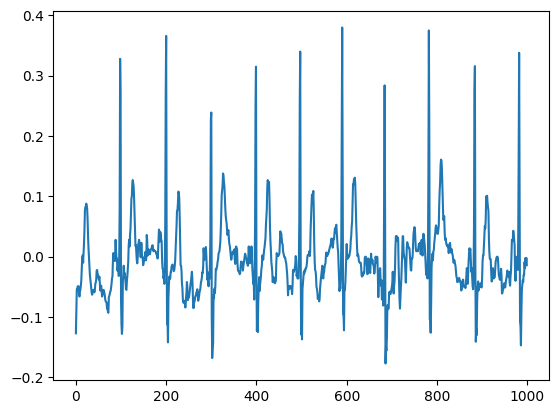

tensor([[[-0.0340, -0.0730, -0.0040,  ..., -0.1840, -0.1830, -0.1790]],

        [[-0.0650, -0.0650, -0.0650,  ..., -0.0490, -0.0360, -0.0420]],

        [[-0.0100,  0.0040,  0.0150,  ..., -0.0620, -0.0630, -0.0820]],

        ...,

        [[-0.0700, -0.0580, -0.0310,  ..., -0.0380, -0.0410, -0.0420]],

        [[ 0.0020,  0.0020, -0.0180,  ..., -0.0990, -0.0920, -0.1120]],

        [[ 0.0940,  0.1190,  0.1700,  ..., -0.0460, -0.0350,  0.0630]]],
       device='cuda:0')


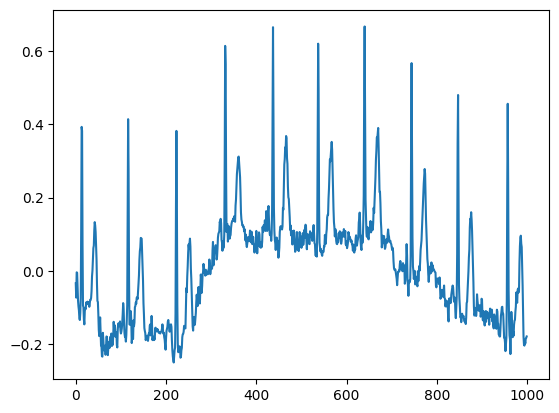

tensor([[[ 0.0350,  0.0370,  0.0460,  ...,  0.0670,  0.0060,  0.0000]],

        [[ 1.5910,  1.2560,  1.9210,  ..., -1.6360, -1.9260, -2.1680]],

        [[-0.3470, -0.3600, -0.3860,  ..., -0.0680, -0.0540, -0.0400]],

        ...,

        [[ 0.0560,  0.0440,  0.0160,  ...,  0.0290, -0.3090, -0.4620]],

        [[-0.0400, -0.0380, -0.0640,  ..., -0.0460, -0.0190,  0.1110]],

        [[-0.0650, -0.0770, -0.0950,  ...,  0.0320,  0.0220,  0.0170]]],
       device='cuda:0')


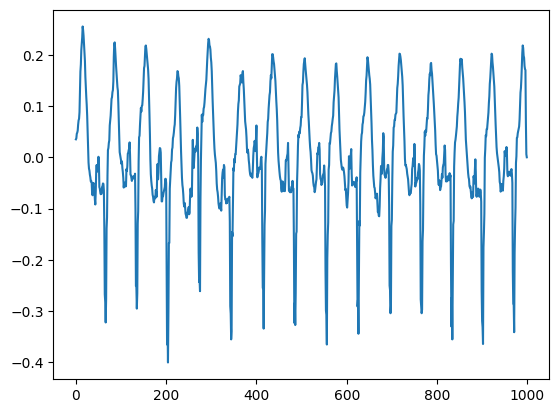

tensor([[[ 0.0030, -0.0200, -0.0240,  ...,  0.0180,  0.0670,  0.0830]],

        [[-0.0200, -0.0050, -0.0040,  ...,  0.3950, -0.0910,  0.1320]],

        [[-0.0330, -0.0470, -0.0410,  ..., -0.0910, -0.1300, -0.0910]],

        ...,

        [[-0.0340, -0.0350, -0.0390,  ...,  0.0040,  0.0010,  0.0060]],

        [[-0.0450, -0.0750, -0.0240,  ..., -0.1210, -0.1230, -0.0560]],

        [[-0.0360, -0.0790, -0.1370,  ...,  0.0370, -0.0030,  0.0340]]],
       device='cuda:0')


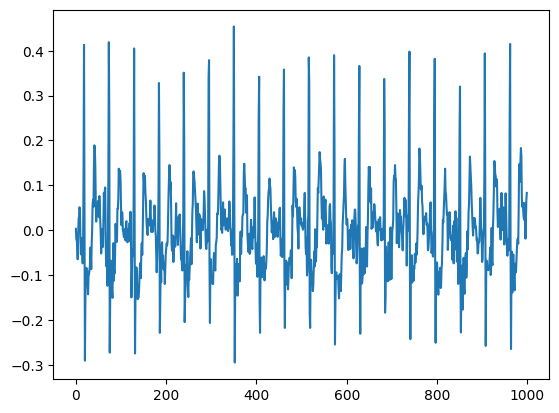

tensor([[[ 0.1230,  0.0330, -0.0530,  ..., -0.0760, -0.0740, -0.0730]],

        [[ 0.0380,  0.0240,  0.0010,  ..., -0.0750, -0.0510, -0.0470]],

        [[-0.0470, -0.0450, -0.0170,  ..., -0.0020, -0.0020,  0.0160]],

        ...,

        [[-0.0430, -0.0340, -0.0210,  ...,  0.0080,  0.0020, -0.0010]],

        [[ 0.0040,  0.0090,  0.0220,  ..., -0.0670, -0.0520, -0.0360]],

        [[-0.0470, -0.0350,  0.0060,  ..., -0.2360, -0.0160,  0.0670]]],
       device='cuda:0')


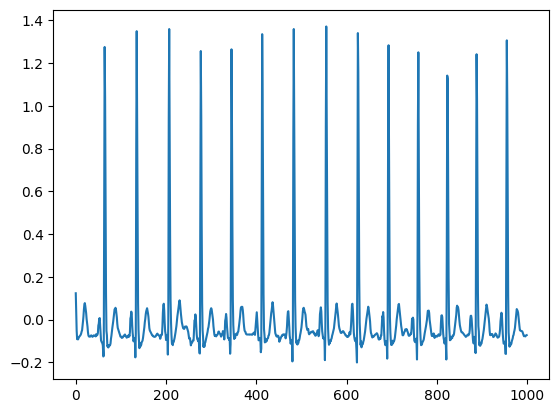

tensor([[[ 0.2090,  0.4420,  0.6760,  ..., -0.0160, -0.0160, -0.0110]],

        [[-1.2360, -1.2210, -1.2220,  ..., -0.1110, -0.1130, -0.0850]],

        [[ 0.3360,  1.3960,  0.0760,  ..., -0.0270, -0.0350, -0.0300]],

        ...,

        [[ 0.0290,  0.0070, -0.0170,  ...,  0.0110,  0.0460,  0.0710]],

        [[-0.0390, -0.0600, -0.0300,  ..., -0.0500, -0.0720, -0.0070]],

        [[ 0.2560,  0.2640,  0.2680,  ..., -0.0260, -0.0260, -0.0210]]],
       device='cuda:0')


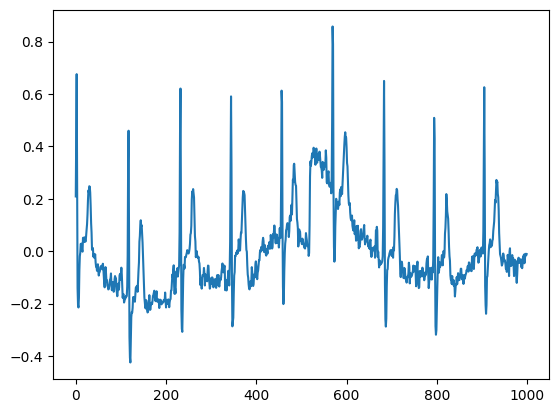

tensor([[[-0.0570, -0.0690, -0.0710,  ...,  0.0250,  0.0040,  0.0620]],

        [[-0.0800, -0.0740, -0.0630,  ..., -0.1640, -0.2200,  0.1530]],

        [[-0.0460, -0.0540, -0.0570,  ...,  0.5670,  0.2790,  0.2640]],

        ...,

        [[-0.0430, -0.0400, -0.0350,  ...,  0.0030,  0.0610,  0.1000]],

        [[-0.0560, -0.0280, -0.0360,  ...,  0.1210, -0.0730,  0.0590]],

        [[ 0.0510,  0.0580,  0.0540,  ..., -0.0470, -0.0500, -0.0640]]],
       device='cuda:0')


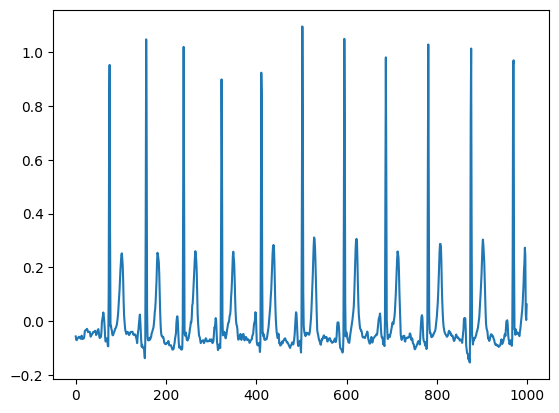

tensor([[[-0.0450, -0.0370, -0.0360,  ..., -0.0630, -0.0450, -0.0370]],

        [[-0.0560, -0.0600, -0.0630,  ..., -0.0760, -0.1270, -0.1340]],

        [[-0.0420, -0.0630, -0.0400,  ...,  0.0250, -0.0240, -0.0470]],

        ...,

        [[-0.0550, -0.0600, -0.0550,  ...,  0.8550,  0.4180,  0.0570]],

        [[ 0.0360,  0.0340,  0.0210,  ..., -0.1820, -0.2870, -0.1580]],

        [[ 0.0210,  0.0410,  0.0550,  ..., -0.0250, -0.0700, -0.0360]]],
       device='cuda:0')


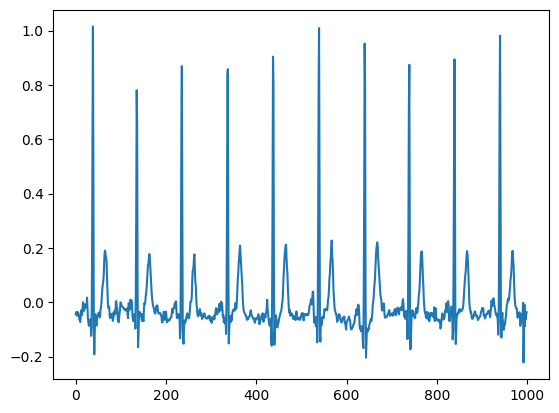

tensor([[[ 0.0300,  0.0350,  0.0390,  ..., -0.0040,  0.0110,  0.0270]],

        [[-0.1630, -0.1650, -0.1740,  ..., -0.0320, -0.0700, -0.0970]],

        [[-0.0090,  0.0010,  0.0040,  ..., -0.0560, -0.0680, -0.0790]],

        ...,

        [[ 0.0010, -0.0140, -0.0160,  ...,  0.0260,  0.0230,  0.0100]],

        [[ 0.1760,  0.1940,  0.2330,  ...,  0.0180,  0.0610,  0.1020]],

        [[ 0.0380,  0.0170, -0.0030,  ..., -0.0170, -0.0200, -0.0150]]],
       device='cuda:0')


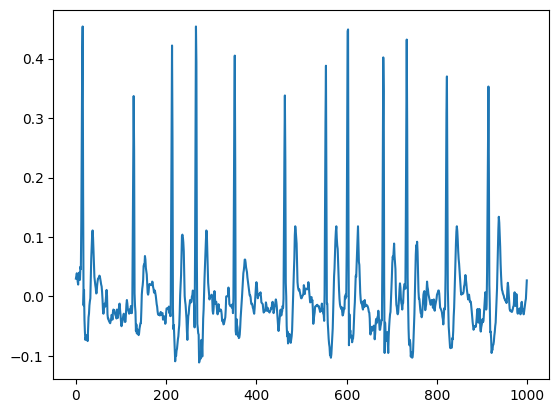

tensor([[[ 0.1090,  0.0970,  0.0540,  ..., -0.0090, -0.0130,  0.0610]],

        [[-0.0540, -0.0530, -0.0480,  ..., -0.0770, -0.0790, -0.1070]],

        [[-0.0400, -0.0450, -0.0570,  ...,  0.2190,  0.1660, -0.1070]],

        ...,

        [[-0.0550, -0.0550, -0.0560,  ...,  0.1430,  0.1900,  0.1740]],

        [[-0.0120, -0.0480, -0.1080,  ..., -0.2020, -0.0490,  0.1570]],

        [[ 0.0540,  0.0660,  0.0890,  ..., -0.0220,  0.0100,  0.0790]]],
       device='cuda:0')


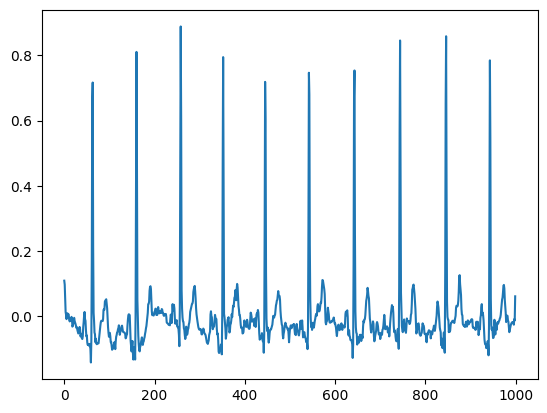

tensor([[[-0.0410, -0.0420, -0.0520,  ..., -0.0310, -0.0290,  0.0160]],

        [[-0.0050, -0.0050, -0.0050,  ...,  0.0340,  0.2440,  0.3880]],

        [[-0.0630, -0.0550, -0.0450,  ..., -0.0500, -0.1410, -0.2820]],

        ...,

        [[ 0.0100,  0.0080,  0.0070,  ...,  0.0170, -0.0080, -0.0110]],

        [[-0.0360, -0.0180, -0.0230,  ...,  0.0330,  0.0160,  0.1290]],

        [[-0.0410, -0.0510, -0.0680,  ..., -0.0480, -0.0890, -0.0810]]],
       device='cuda:0')


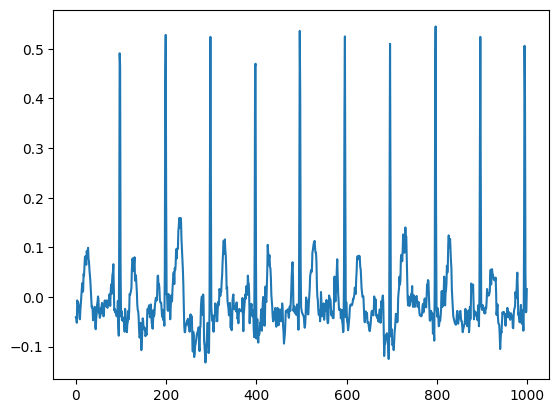

tensor([[[ 0.0830,  0.2850,  0.8280,  ...,  0.1700,  0.6440,  1.0320]],

        [[-0.1330, -0.1240, -0.1260,  ..., -0.0840,  0.4020,  1.0400]],

        [[-0.0110, -0.0170, -0.0200,  ..., -0.0680, -0.0610, -0.0920]],

        ...,

        [[-0.0580, -0.0470, -0.0530,  ..., -0.0930, -0.0120, -0.1030]],

        [[-0.0950, -0.0950, -0.0950,  ..., -0.0710, -0.0380, -0.0430]],

        [[ 0.0000, -0.0160, -0.0270,  ...,  0.0030, -0.0940, -0.3870]]],
       device='cuda:0')


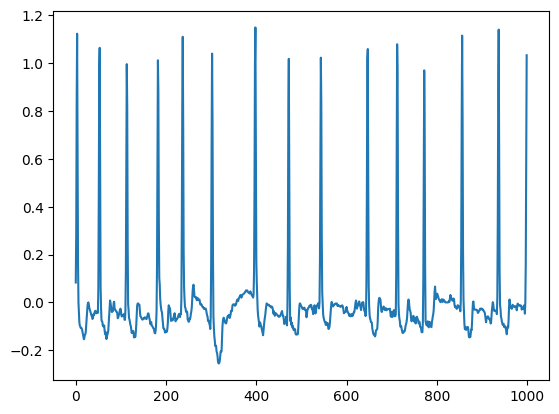

tensor([[[-0.0460, -0.0400, -0.0310,  ..., -0.0570, -0.0700, -0.0870]],

        [[-0.1250, -0.1140, -0.0800,  ..., -0.0150,  0.0070,  0.0470]],

        [[-0.1820, -0.1780, -0.1580,  ..., -0.1340, -0.1370, -0.1270]],

        ...,

        [[ 0.0600,  0.0600,  0.0610,  ...,  0.0190,  0.0340,  0.0050]],

        [[-0.0070, -0.0230, -0.0260,  ..., -0.1810, -0.2060, -0.0550]],

        [[ 0.0100,  0.0260,  0.0460,  ...,  0.0410,  0.0600, -0.0200]]],
       device='cuda:0')


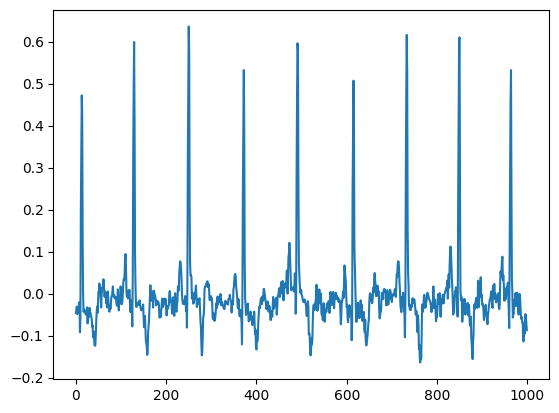

tensor([[[ 0.0080,  0.0260,  0.0290,  ...,  0.0180,  0.0070,  0.0030]],

        [[-0.0140, -0.0030,  0.0030,  ..., -0.1140, -0.0920,  0.0750]],

        [[-0.0040,  0.0030,  0.0140,  ..., -0.0210, -0.0190, -0.0230]],

        ...,

        [[ 0.0380,  0.0780, -0.0140,  ..., -0.1060, -0.0450,  0.4630]],

        [[-0.0570, -0.0410,  0.0030,  ...,  0.0330,  0.0270, -0.0060]],

        [[-0.0490, -0.0490, -0.0590,  ...,  0.0910,  0.1750,  0.1660]]],
       device='cuda:0')


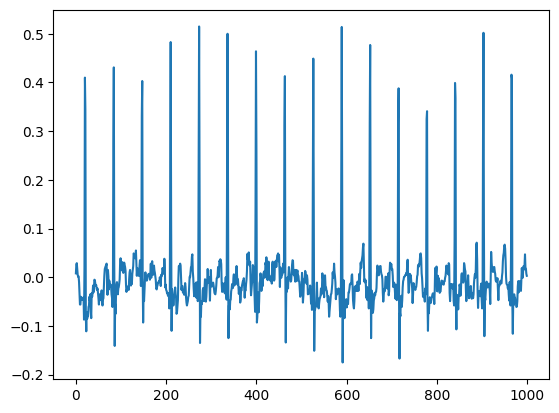

In [38]:
 for i, data in enumerate(dataloader, 0):
            real_data = data[0].to(device)
            print(real_data)
            rd = real_data.detach().cpu().squeeze(1).numpy()[0].transpose()
            plt.plot(rd)
            plt.show()

In [ ]:
torch.save(trainer.netD.state_dict(), f"discriminator_2.pth")

In [ ]:
print(torch.__version__)